# Advanced Statistics for Physics Analysis - Final Project



# Bayesian Analysis of ARPAV time series: temperatures and precipitations

- Menti Luca - 2063594
- Monti Sebastiano - 2052399
- Saleh Giovanna - 2019058

01/07/2022

# INTRODUCTION

In this project we permofed a Bayesian analysis about the possible increase of temperature  from 1993 to 2021 in some cities of Veneto, in particular in Porto Tolle, Castelfranco Veneto, Auronzo di Cadore and Roverchiara. We decided to pick these four cities because the are allocated in differente parts of the region where the environment is quiet different (Porto Tolle near the sea, Auronzo in mountain and Roverchiara and Castelfranco in plain).  

We analised the ARPAV data using some tools such as Markov Chain Monte Carlo simulation. \
We also compared them with the results of SNPA ( Sistema Nazionale per la Protezione dell'Ambiente) concerning  Italy.

In order to have a clear analysis we discussed in details just Porto Tolle's dataset while for the other cities we presented just the final results. Although this, all the plot of other dataset are reported in appendix.

Moreover we analysed also the trend of daily precipitations measured in Cavanis (Venice) metereological station between 1900 and 2021. 

# STRUCTURE OF THE ANALYSIS

We will focus first on temperature trends (Part 1 and Part 2), and then we will proceed to precipitations analysis (Part 3).

The analysis related to temperature trends will be developed and presented in full details for a single weather station (Porto Tolle). 
In **_Appendix 1_** the results of the same analysis on the data coming from the other weather stations are exposed.

In **_Appendix 2_**, then, the analysis is performed on the data obtained by averaging the minimum, maximum and average temperatures over the different stations, in order to have an idea of the global trends in Veneto.

Data on precipitations are available only for the city of Venice (Cavanis weather station), so the analysis is carried out only for that area.


## TEMPERATURE


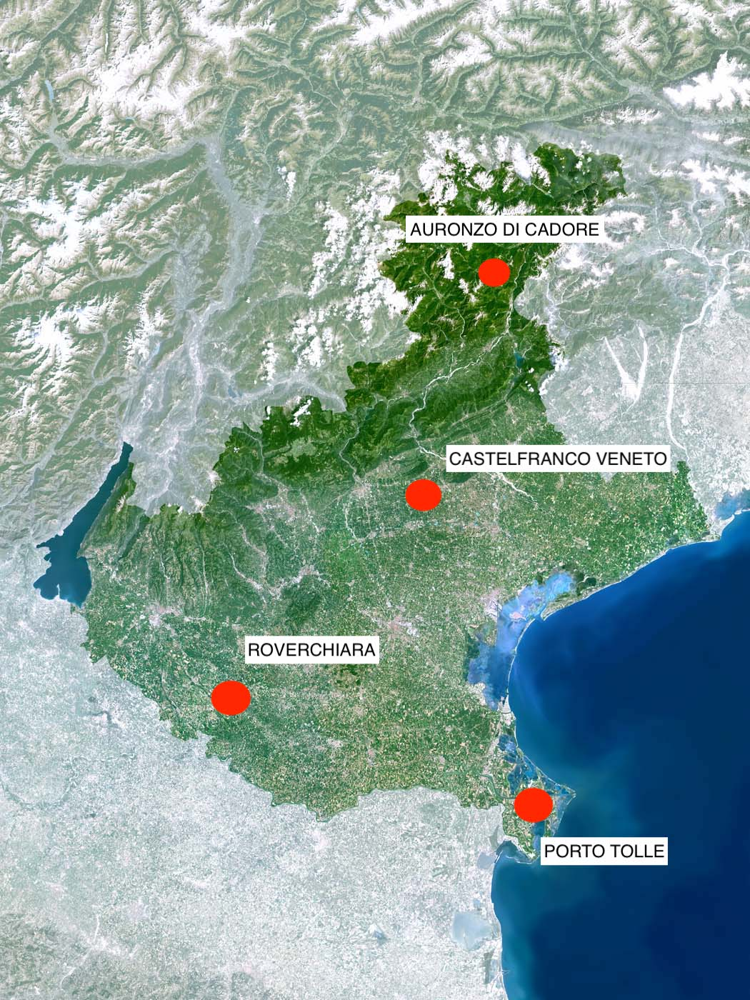

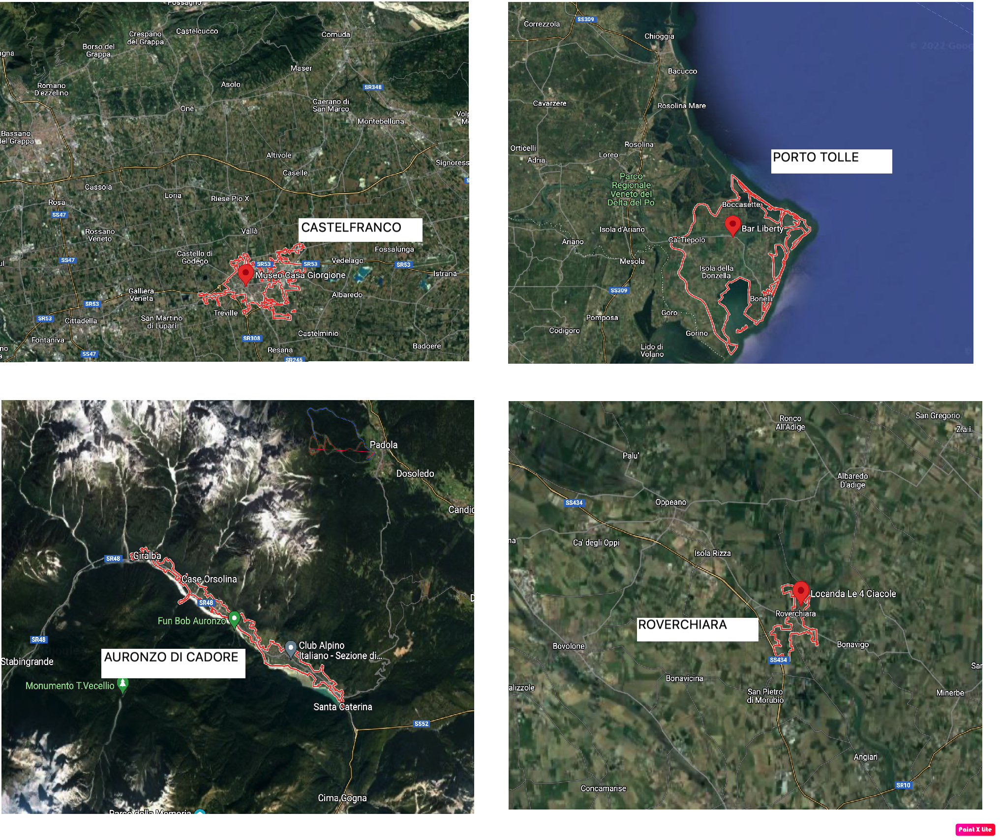

In [13]:
library("IRdisplay")
display_png(file="mappa_veneto.jpeg",width=500,height=500)
display_png(file="mappa_progetto.png",width=500,height=500)


After an overview of the data trends, the analysis is developed in two main sections.

### PART 1: 

### ANALYSIS OF THE EVOLUTION OF THE ANNUAL MEAN OF MIN, MAX AND AVERAGE TEMPERATURE OVER THE YEARS (1993-2021)

In this part we will consider the trend of annual means of minimum, maximum and average temperature. 
The idea is to check whether these distributions can be considered constant over time (no rising temperatures), or whether they show a rising trend.

In particular, for each time series the following analysis is performed:

- Bayesian linear regression (JAGS)
- Comparison with constant regression (JAGS)
- Hypothesis testing to check wehther or not we can affirm that the temperature is rising.
- Comparison of JAGS results with standard (frequentist) regression results






### PART 2

### ANALYSIS OF THE EVOLUTION OF THE YERLY DIFFERENCE OF THE ANNUAL MEAN OF MIN, MAX AND AVERAGE TEMPERATURE OVER THE YEARS (1993-2021)

In this part we consider the yearly difference  between the minimum, maximum and average temperature.

In particular we:


- perform some MCMC simulations with RJAGS in order to infer from the dataset how much average,max and min temperatures increased over 4 years period
-  make some future prediction from MCMC  simulations
- compare the results obtained with SNPA's results of Italy's temperatures to check if, in the place where the data has been collected, the increase of temperature is higher or not compare to that computed by SNPA.
- perform also a prevision using FORECAST library to check how the prevision itself changes if we change the approach


## PRECIPITATION

### PART 3

In this Part precipitations data are analyze looking for the distribution of the most intense events over time.
The FORECAST library is used in order to predict 20 years of later data and to introduce some useful functions of this library. 



# EMPLOYED PACKAGES

In [2]:
library(bayesboot)
library(mcmcOutput)
library(lubridate)
library(tibble)
library(magrittr)
library(dplyr)   
library(lubridate)
library(tidyverse)
library(coda)
library(gridExtra)
library(nortest)
library(lattice)
library(RColorBrewer)
library(mcmcplots)
library(rjags)
library(forecast)
library(ggplot2)
library(bayesplot)
library(grid)
library(R2jags)
library(bayesplot)
library(hexbin)
library(plot3D)
library(magrittr)
library(openxlsx)
library(TTR)
library(repr)
library(plotly)


# TEMPERATURES TIME SERIES ANALYSIS

### DATA IMPORT AND PREPARATION

Row data are imported in a data.frame structure: the first rows are shown in order to clarify the structure of the dataftame.

In [3]:
#Import row data

import_data<-function(filename)
{ 
    df<- read.csv(filename)
    df$date <- as.Date(df$date)
    df<-subset(df, date >= as.Date('1993-01-01') & date <= as.Date('2021-12-31'))
    df<-data.frame(Date=df$date,"Max_Temperature"=df$TMAX, "Min_Temperature"=df$TMIN, "Mean_Temperature"=df$TMED)
    df$Year = lubridate::year(df$Date)
    df$Month = lubridate::month(df$Date)
    df$Week = lubridate::week(df$Date)
    df$Temperature_range <-apply(df[,2:3],1,diff)
    df$Temperature_range<-abs(df$Temperature_range)
  
    return(df)
}


In [4]:
file<-"./Dati_temp_progetto/Porto_Tolle.csv"
df<-import_data(file)
head(df)

,Date,Max_Temperature,Min_Temperature,Mean_Temperature,Year,Month,Week,Temperature_range
,<date>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1993-01-01,4.7,-0.3,2.6604,1993,1,1,5.0
2,1993-01-02,0.7,-2.3,-1.1208,1993,1,1,3.0
3,1993-01-03,1.2,-1.5,-0.4698,1993,1,1,2.7
4,1993-01-04,2.0,-4.4,-1.1708,1993,1,1,6.4
5,1993-01-05,2.7,-5.8,-2.6427,1993,1,1,8.5
6,1993-01-06,5.1,-7.3,-2.3875,1993,1,1,12.4


Two additional dataframes with aggregate data are built from the original one:
- df1: containing monthly means (for every year) of min, max and average temperature.
- df2: containing annual means of min, max and average temperatures.

In [5]:
# Aggregate data to extract additional information

aggregate_data<-function(df)
{
    #Dataframe with mean value, month by month (for every year)
    df1<- aggregate(cbind(df$Min_Temperature,df$Max_Temperature, df$Mean_Temperature), 
                    by=list("Month"=df$Month, "Year"=df$Year), 
                    FUN= "mean")
    colnames(df1)[3:5] <- c("Mean_min_temp_month", "Mean_max_temp_month", "Mean_average_temp_month")
   
    #Dataframe with annual mean values
    df2<-aggregate( .~Year, data=df, mean)
    df2<-data.frame("Year"=df2$Year,
                    "Mean_Max_Temperature"=df2$Max_Temperature,
                    "Mean_Min_Temperature"=df2$Min_Temperature,
                    "Mean_Temperature_range"=df2$Temperature_range,
                    "Mean_Average_Temperature"=df2$Mean_Temperature
                    )
    
    return(list(df1,df2))
}


In [6]:
aggregated<-aggregate_data(df)

df1<-aggregated[[1]]
df2<-aggregated[[2]]

In [7]:
head(df1)

,Month,Year,Mean_min_temp_month,Mean_max_temp_month,Mean_average_temp_month
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,1993,-0.7870968,5.500000,1.982635
2,2,1993,-3.6337821,8.909075,1.947561
3,3,1993,1.4129032,11.470968,6.085652
4,4,1993,6.4600000,16.250000,11.445513
5,5,1993,11.8612903,24.045161,18.055177
6,6,1993,15.8866667,26.313333,21.331813


In [8]:
head(df2)

,Year,Mean_Max_Temperature,Mean_Min_Temperature,Mean_Temperature_range,Mean_Average_Temperature
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1993,17.54104,7.757067,9.783973,12.51324
2,1994,18.66493,9.738356,8.926575,14.13309
3,1995,17.76385,8.406893,9.356954,12.96684
4,1996,17.47213,8.739891,8.732240,13.09098
5,1997,18.47233,8.947397,9.524932,13.62204
6,1998,18.45393,8.584111,9.869815,13.41631


### MAIN TRENDS: QUALITATIVE DISCUSSION



#### 1. MONTHLY MEANS TREND, YEAR BY YEAR

The following three plots show the evolution in time of monthly means of min, max and average temperatures respectively.

The color represents the year, from blue (1993) to red (2021):
temperatures increasing in time would translate to a distribution with red dots on top of blue dots.


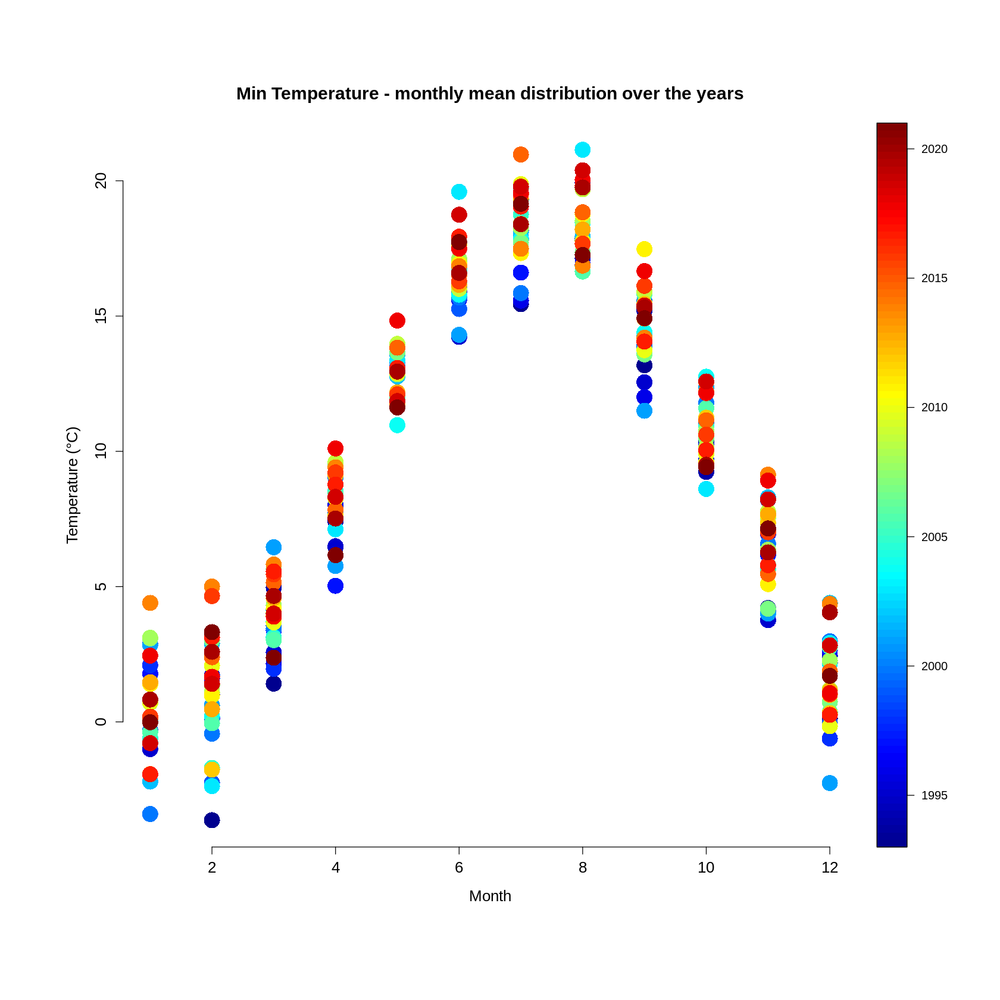

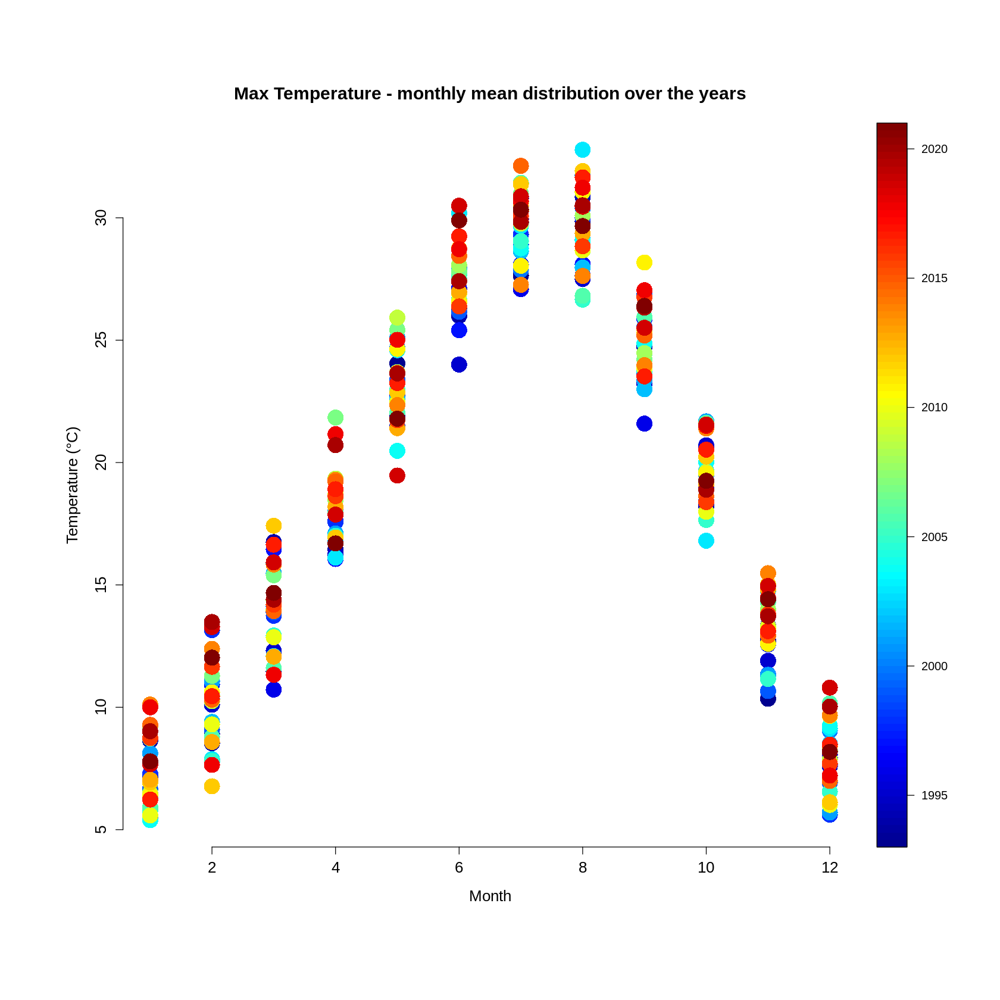

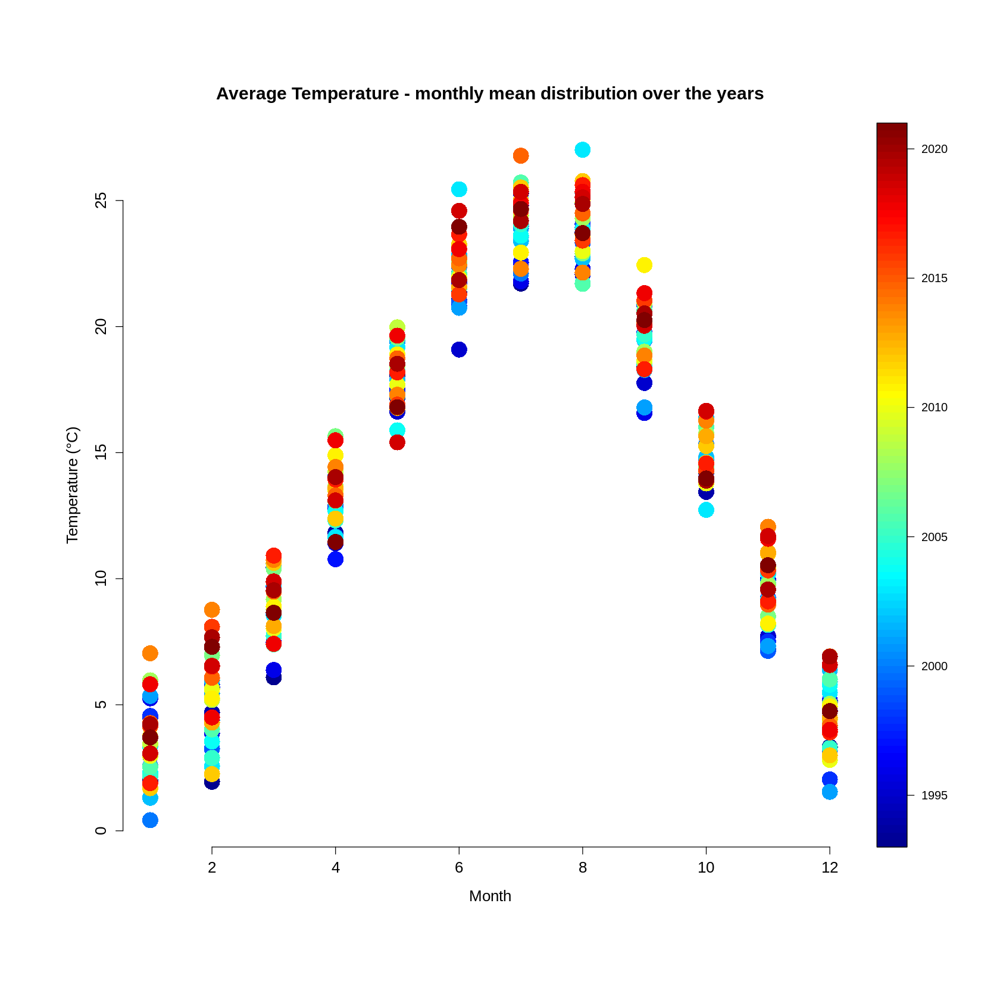

In [9]:

preliminary_plots1<-function(df1)
{
    options(repr.plot.width=14, repr.plot.height=14)
    
    scatter2D(df1$Month, df1$Mean_min_temp_month, #Min
              type ="p",
              colvar= df1$Year,
              main= "Min Temperature - monthly mean distribution over the years",
              xlab = "Month",
              ylab= "Temperature (°C)",  
              cex.main = 1.5, cex.lab = 1.3, cex.axis=1.3,
              pch = 16, bty ="n", lwd=3, cex=3)
    
    
    
    scatter2D(df1$Month, df1$Mean_max_temp_month, #Max
              colvar= df1$Year,
              type ="p",
              main= "Max Temperature - monthly mean distribution over the years",
              xlab = "Month",
              ylab= "Temperature (°C)",  
              cex.main = 1.5, cex.lab = 1.3, cex.axis=1.3,
              pch = 16, bty ="n", lwd=3, cex=3)
    
    
    scatter2D(df1$Month, df1$Mean_average_temp_month, #Average
              colvar= df1$Year,
              type ="p",
              main= "Average Temperature - monthly mean distribution over the years",
              xlab = "Month",
              ylab= "Temperature (°C)",  
              cex.main = 1.5, cex.lab = 1.3, cex.axis=1.3,
              pch = 16, bty ="n", lwd=3, cex=3)
    
    
    
}

preliminary_plots1(df1)

#### 2. ANNUAL MEANS TREND IN TIME

Here annual means of min, max and average temperature are plotted as a function of the year. 

Additionally, the annual mean of the daily max-min differences are plotted, to check whether this quantity shows an interesting trend in time. 

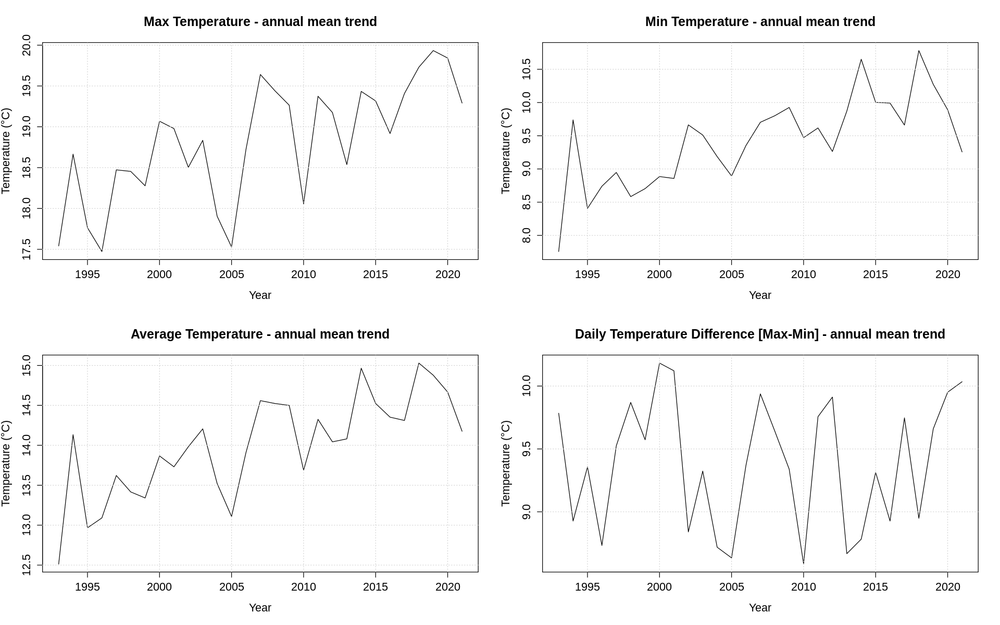

In [10]:

preliminary_plots2<-function(df2)
{
    
    options(repr.plot.width=16, repr.plot.height=10)
    par(mfrow = c(2, 2))

    plot(df2$Year,df2$Mean_Max_Temperature,
         type="l",
         main = "Max Temperature - annual mean trend",
         xlab = "Year",
         ylab= "Temperature (°C)",
         cex.main = 1.5, cex.lab = 1.3, cex.axis=1.3)
    grid()
    
    
    plot(df2$Year,df2$Mean_Min_Temperature,
         type="l",
         main = "Min Temperature - annual mean trend",
         xlab = "Year",
         ylab= "Temperature (°C)",
         cex.main = 1.5, cex.lab = 1.3, cex.axis=1.3)
    grid()
    
    
    plot(df2$Year,df2$Mean_Average_Temperature,
         type="l",
         main = "Average Temperature - annual mean trend",
         xlab = "Year",
         ylab= "Temperature (°C)",
         cex.main = 1.5, cex.lab = 1.3, cex.axis=1.3)
    grid()
    
    
    plot(df2$Year,df2$Mean_Temperature_range,
         type="l",
         main = "Daily Temperature Difference [Max-Min] - annual mean trend",
         xlab = "Year",
         ylab= "Temperature (°C)",
         cex.main = 1.5, cex.lab = 1.3, cex.axis=1.3)
    grid()

}

preliminary_plots2(df2)



# PART 1: ANALYSIS OF THE EVOLUTION OF THE ANNUAL MEAN OF MIN, MAX AND AVERAGE TEMPERATURE OVER THE YEARS (1993-2021)

## A. DETAILED ANALYSIS OF AVERAGE TEMPERATURES (ANNUAL MEANS)

### BAYESIAN LINEAR REGRESSION WITH JAGS

In [11]:
#Build dataframe with only the columns of interest (year and annual mean of average temperature)
dataf <- df2[,c("Year", "Mean_Average_Temperature")]
names(dataf)<-c("Year", "Temp")
head(dataf)

#Convert data to format requested by jags
data <- with(dataf, list(Year = Year, Temp = Temp, N = length(Year)))


,Year,Temp
,<dbl>,<dbl>
1,1993,12.51324
2,1994,14.13309
3,1995,12.96684
4,1996,13.09098
5,1997,13.62204
6,1998,13.41631



The following linear regression is based on the assumption that the data (Temperatures) are random samples from gaussian distributions with equal variance and a mean which is a linear function of the independent variable (Years). The assumed model is therefore a linear function with gaussian noise:


\begin{equation}
y=\alpha + \beta*x    \ \ \ \ \ \ \ \ \ \  \text{(with gaussian noise)}
\end{equation}


The fit is performed using a Markov Chain Monte Carlo (JAGS) to determine the shape of the posterior distribution for the parameters.

In [12]:

bayesian_linear_regression_jags<-function(data)
{ 
    #Model
    mod <- function()
    {

        tau <- 1 / (sigma*sigma) #Precision (1 / variance) - parameter required by R2JAGS model
        # Likelihood: Gaussian distribution around means which are linearly distributed
        for (i in 1:N)
        {
            Temp[i] ~ dnorm(mu[i], tau) 
            mu[i] <- alpha + beta * Year[i] 
        }
        # Priors:
        alpha ~ dnorm(0, 0.001) # intercept 
        beta ~ dnorm(0, 0.01) # slope 

        sigma ~ dunif(0,5) # standard deviation

    }

    #Initial guess on the parameters  
    init_values <- function()
    {
        list(alpha = 0, beta = 0, sigma = 1)   
    }
    params <- c("alpha", "beta", "sigma")

    #MCMC
    set.seed(123)
    fit <- jags(data = data, inits = init_values, parameters.to.save = params, model.file = mod,
                n.chains = 3, n.iter = 12000, n.burnin = 2000, n.thin = 10, DIC = T, quiet=T)

    print(fit)
    
    return(fit)
}

fit<-bayesian_linear_regression_jags(data)

Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e588951df.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect     2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -70.496  18.041 -102.860 -83.058 -71.284 -59.031 -32.859 1.001  3000
beta       0.042   0.009    0.023   0.036   0.042   0.048   0.058 1.001  3000
sigma      0.451   0.069    0.338   0.403   0.444   0.492   0.607 1.001  3000
deviance  34.372   3.752   29.494  31.597  33.597  36.318  43.623 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 7.0 and DIC = 41.4
DIC is an estimate of expected predictive error (lower deviance is better).


**Comments to results**

Already from here we can notice that the value $\beta = 0 $ lays out from the two tailed 95% CI of the posterior from the $beta$ parameter. This suggests that the null hypotesis "the temperatures are constant" can be rejected at $\alpha=5\%$. This point will be further developed later.

**The role of the prior**

The prior on the slope $\beta$ is chosen as a gaussian distibution centered in $\mu=0$ so as to avoid introducing biases in favour of the hypotesis of rising trend. 

The gaussian shape reflects the intuition that the probability for $\beta$ goes down with $|\beta|$.

The same MCMC fit has been performed assuming, instead, a wide uniform distribution for $\beta$, still centered in $\beta=0$: $U(-10,10)$. 
In this case, the simulation requires much more iterations to converge: at least one order of magnitude more than with the gaussian prior. The best results with this prior have been ottained performing 120.000 total iterations, with 70.000 burnin and a thinning parameter of 1 out of 250 (n.iter = 120.000, n.burnin = 50.000, n.thin = 250). Still the three chains were not completely overlapping.

    
    
    

#### CHECK OF THE STABILITY OF THE CHAINS



Trace and density are plotted chain by chain, so as to check the overlap of the three chains, and consequently the stability of the simulation.

   

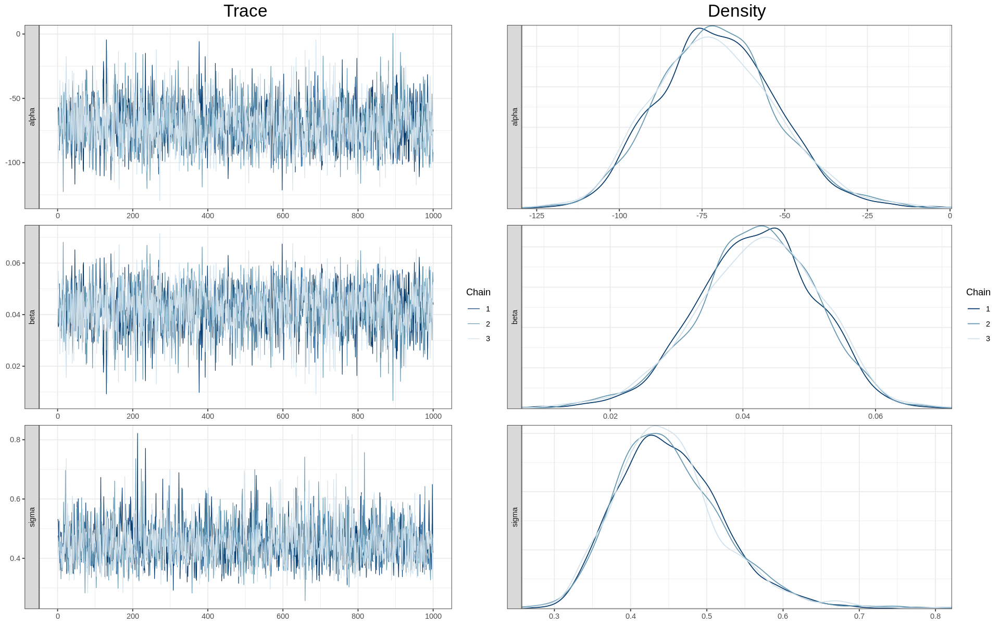

In [13]:
stability_check_generic_fit<-function(fit_jags_output)
{
    
    mcmc <- as.mcmc(fit_jags_output)
  
    theme_set(theme_bw())
    My_Theme = theme(
    axis.title.x = element_text(size = 25),
    plot.title=element_text(size = 20))
    
    pars<- fit_jags_output$parameters.to.save[1:(length(fit_jags_output$parameters.to.save)-1)]
    
    #Trace
    trace<-mcmc_trace(mcmc, pars=pars, facet_args = list(ncol = 1, strip.position = "left"))+
                     ggtitle("Trace")+
                     theme(plot.title = element_text(hjust = 0.5))+
                     My_Theme
    
    #Density
    density<-mcmc_dens_overlay(mcmc, pars, facet_args = list(ncol = 1, strip.position = "left"))+
                           ggtitle("Density")+
                           theme(plot.title = element_text(hjust = 0.5))+ 
                           My_Theme
    
    grid.arrange(trace,density,ncol=2)
   
}


stability_check_generic_fit(fit)

### COMPARISON WITH CONSTANT REGRESSION


The distribution is now fitted with a constant, representing the assumption that the data (Temperatures) are random samples from gaussian distributions with equal variance and a mean which is constant (not depending on tyme). The assumed model is therefore a constant function with gaussian noise:


\begin{equation}
y=\alpha     \ \ \ \ \ \ \ \ \ \  \text{(with gaussian noise)}
\end{equation}


The fit is again performed using a Markov Chain Monte Carlo (JAGS) to determine the shape of the posterior distribution for the parameters.

In [14]:
# Bayesian fit with constant

bayesian_flat_regression_jags<-function(data)
{
    #Model
    mod0 <- function()
    {
        tau <- 1 / (sigma*sigma) #Precision (1 / variance) 
        # Likelihood: Gaussian distribution around means which follow flat (constant) distribution
        for (i in 1:N){
            Temp[i] ~ dnorm(mu[i], tau) 
            mu[i] <- alpha 
        }
        # Priors:
        alpha ~ dnorm(0, 0.001) # intercept 

        sigma ~ dunif(0,5) # standard deviation

    }

    #Initial guess on the parameters
    init_values <- function()
    {
        list(alpha = 0, sigma = 1)     
    }
    params <- c("alpha", "sigma")

    #MCMC
    set.seed(123)
    fit0 <- jags(data = data, inits = init_values, parameters.to.save = params, model.file = mod0,  digits=7,
                n.chains = 3, n.iter = 12000, n.burnin = 2000, n.thin = 10, DIC = T,quiet=T )

    print(fit0)

    return(fit0)
}

fit0<-bayesian_flat_regression_jags(data)



Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e7e553d39.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     13.997   0.123 13.753 13.915 13.996 14.075 14.244 1.001  3000
sigma      0.658   0.094  0.508  0.591  0.651  0.712  0.881 1.002  1600
deviance  56.325   2.196 54.205 54.792 55.631 57.084 62.397 1.002  1300

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.4 and DIC = 58.7
DIC is an estimate of expected predictive error (lower deviance is better).


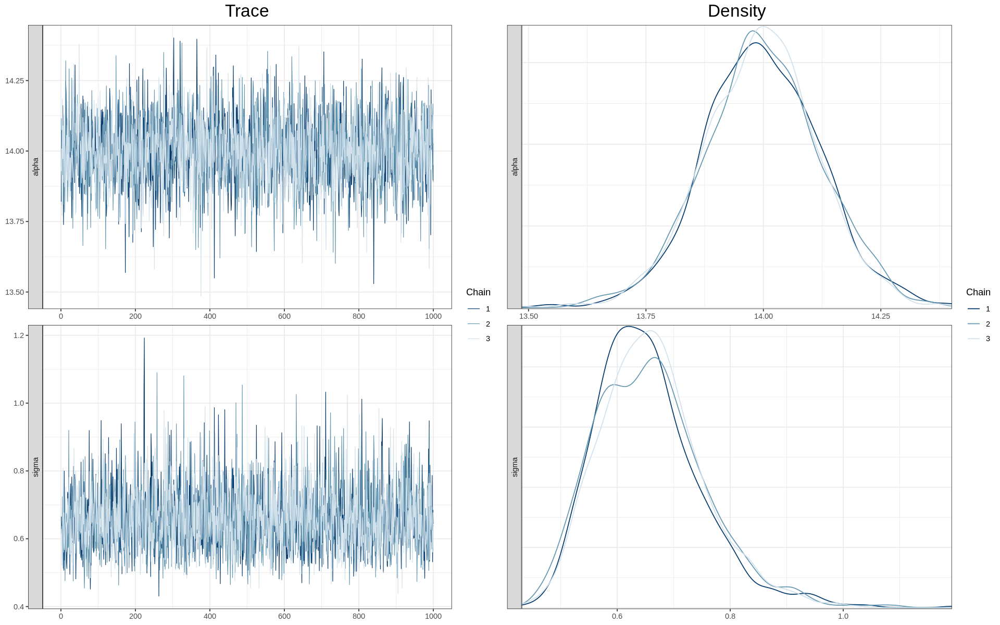

In [15]:
stability_check_generic_fit(fit0)

### MODEL COMPARISON: THE SUITABILITY OF LINEAR MODEL

In the bayesian framework, the suitability of two models ($M_1, M_2$) to describe a certain data distribution ($D$) can be compared using the Bayes Factor, which is defined as the ratio of the two marginalized likelihoods.

\begin{equation}
BF = \frac{P(D|M_1)}{P(D|M_2)}
\end{equation}

In which each term is in the form
\begin{equation}
P(D|M) = \int P(D|\theta,M) P(\theta|M) d\theta
\end{equation}

Where $P(D|\theta,M)$ is the likelihood and $P(\theta|M)$ the prior probability of the parameters.

In our case, though, we are not considering two generic models, but two nested models (constant is nested in linear model): in this specific case, the Bayes Factor reduces to the Savage-Dickey ratio:

\begin{equation}
BF_{SD} = \frac{\int d\phi P(\phi,\psi^*|D)}{\pi_2(\psi^*)}
\end{equation}

In which $\psi$ is the additional parameter (present in $M2$ and not in $M_1$), and $\psi^*$ is the value for which $M_2 \rightarrow M_1$.

In the case of

$M_1$ = constant $\rightarrow y= \alpha$

$M_2$ = linear $\rightarrow y=\alpha+ \beta*x \Rightarrow \beta^* =0$

\begin{equation}
BF_{SD} = \frac{\int d\alpha P_2(\alpha, \beta=0|D)}{\pi_2(\beta=0)}
\end{equation}

Since the parameter estimation was performed via MCMC, though, the evidence is not available, nor an analytical (and therefore integrable) expression of the posterior.

In this condition, it is not possible to calculate the Bayes Factor from the definition.



Two weaker alternatives to perform model comparison in this situation are the
Deviance Information Criterion and the frequentist Likelihood ratio.


#### DIC

This parameter is an approximation of AIC, which estimates the relative amount of information lost by a given model: the less information a model loses, the higher the quality of that model.

DIC is calculated as $DIC = p_D + \overline{D(\theta)}$, with $p_D = f(\overline{D(\theta)})$ and $D(\theta) = -2log(p(y|\theta))$ the deviance. In our case, it is calculated directly by JAGS.

In [16]:

DIC_constant<-fit0$BUGSoutput$DIC
cat("DIC from constant regression: ", round(DIC_constant, 1), "\n")

DIC_linear<-fit$BUGSoutput$DIC
cat("DIC from linear regression: ", round(DIC_linear, 1))



DIC from constant regression:  58.7 
DIC from linear regression:  41.4

Smaller DIC means more suitable model: this criterion tells us that the linear model is the more suitable than the constant one to describe the data.

#### FREQUENTIST LIKELIHOOD RATIO

**Note:**
Differently from the marginal posteriors ratio, this inference completely relays on the best-fitting parameter and doesn’t take the uncertainty of the estimates into account.

Analytical calculation of the likelihood is performed: the ratio of the two likelihood gives information of the suitability of the models.

In [17]:
freq_lik_ratio<-function(dataf, fit0,fit)
{

    likelihood_flat<-function(dataf,fit0)
    {
        alpha_mcmc<-(fit0$BUGSoutput)$mean$alpha[[1]]
        sigma_mcmc<-(fit0$BUGSoutput)$mean$sigma[[1]]

        exponent<-0
        for (i in 1:length(dataf$Year))
        {
            exponent= exponent + ((dataf$Temp[i]-alpha_mcmc)**2)/(2*sigma_mcmc**2)
        }
        #I neglect 2pi factors, since they cancel when computing the ratio
        lik<-(1/(sigma_mcmc))*exp(-exponent)

        cat("Likelihood constant =",lik, "\n")

        return(lik)

    }

    likelihood_linear<-function(dataf,fit)
    {
        alpha_mcmc<-(fit$BUGSoutput)$mean$alpha[[1]]
        beta_mcmc<-(fit$BUGSoutput)$mean$beta[[1]]
        sigma_mcmc<-(fit$BUGSoutput)$mean$sigma[[1]]

        exponent<-0
        for (i in 1:length(dataf$Year))
        {
            exponent= exponent + ((dataf$Temp[i]-(alpha_mcmc+beta_mcmc*dataf$Year[i]))**2)/(2*sigma_mcmc**2)
        }
        #I neglect 2pi factors, since they cancel when computing the ratio
        lik<-(1/(sigma_mcmc))*exp(-exponent)

        cat("Likelihood linear =",lik, "\n")

        return(lik)

    }

    likeli_flat<-likelihood_flat(dataf,fit0)
    likeli_linear<-likelihood_linear(dataf,fit)

    ratio<- likeli_linear/likeli_flat

    cat("Frequentist likelihood ratio (linear/constant) = ", round(ratio, 2), "\n\n")
    if(ratio>1) {cat("Linear model is more suitable than constant!")}
    
    return(ratio)

}



In [18]:
freq_lik_ratio_const_lin<-freq_lik_ratio(dataf, fit0,fit)

Likelihood constant = 4.782458e-06 
Likelihood linear = 1.003178e-05 
Frequentist likelihood ratio (linear/constant) =  2.1 

Linear model is more suitable than constant!

### HYPOTESIS TESTING 

The following hypothesis can be discussed:

$H0$: The temperature distribution is constant ($\beta_0=0$)

$H1$: The temperature distribution is NOT constant ($\beta \neq 0$)


In the following plots this hypothesis test is performed: if the value $\beta_0=0$ lays out from the two tailed $95\%$ CI of the posterior distribution for $\beta$, the null hypothesis can be rejected at $\alpha=5\%$.

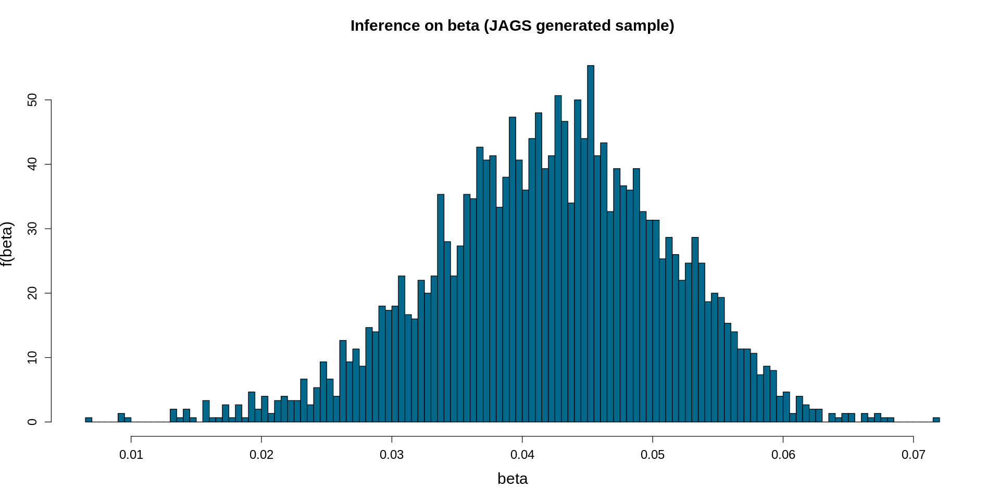

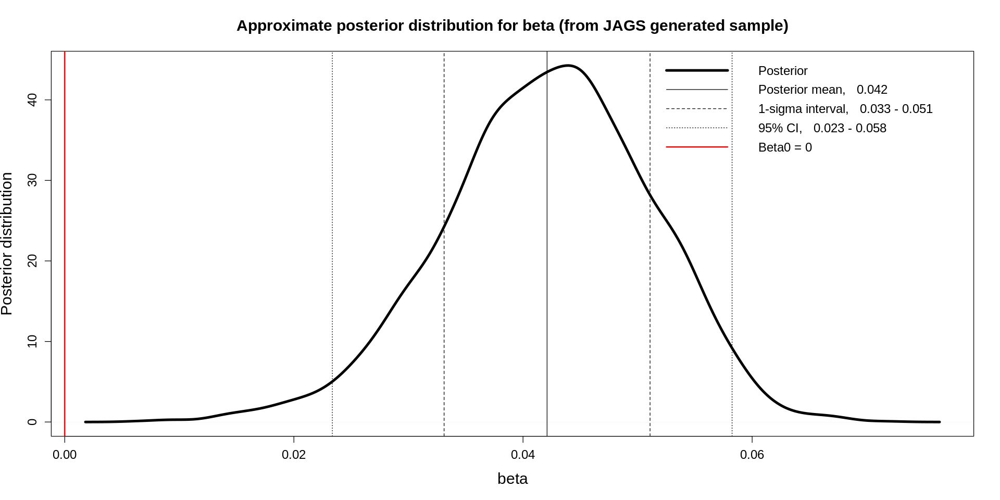

In [19]:
two_side_ht_plot<-function(fit)
{
    options(repr.plot.width=16, repr.plot.height=8)

    beta_sample_mcmc<-fit$BUGSoutput$sims.list$beta
    beta_mcmc<-fit$BUGSoutput$mean$beta[[1]]
    sigma_beta_mcmc<-fit$BUGSoutput$sd$beta[[1]]
    ci_jags<-fit$BUGSoutput$summary[2,c(3,7)]

    #Beta inference result: JAGS generated sample
    hist(beta_sample_mcmc, 
         nc=100, 
         prob=TRUE, 
         main="Inference on beta (JAGS generated sample)",
         xlab="beta",
         ylab="f(beta)",
         cex.lab=1.5, cex.axis=1.2, cex.main=1.5, 
         col="deepskyblue4")

    #Approximate posterior distribution from JAGS generated sample with calculated mean, sigma and 95% ci
    plot(density(beta_sample_mcmc), 
         main="Approximate posterior distribution for beta (from JAGS generated sample)",
         xlab="beta",
         ylab="Posterior distribution",
         cex.lab=1.5, cex.axis=1.2, cex.main=1.5, 
         col="black", type="l", lwd=4)
    abline(v=beta_mcmc, col="black")
    abline(v=beta_mcmc-sigma_beta_mcmc,lty=2, col="black")
    abline(v=beta_mcmc+sigma_beta_mcmc,lty=2, col="black")
    abline(v=ci_jags[1],lty=3, col = "black")
    abline(v=ci_jags[2],lty=3, col = "black")
    abline(v=0, lwd=2, col="red")

    legend("topright", inset =c(-0.3,0), 
       legend=c("Posterior", 
                paste("Posterior mean,  ", round(beta_mcmc,3)), 
                paste("1-sigma interval,  ", round(beta_mcmc-sigma_beta_mcmc,3), "-", round(beta_mcmc+sigma_beta_mcmc,3)), 
                paste("95% CI,  ",round(ci_jags[1],3), "-", round(ci_jags[2],3)),
                "Beta0 = 0 "),
       col=c("black", "black","black","black", "red"),
       lty=c(1, 1,2,3,1),
       lwd=c(4,1,1,1,2),
       cex=1.2,
       bty = "n")
    
}

two_side_ht_plot(fit)
    

Alternatively the following hypothesis can be discussed:

$H0$: The temperature distribution is NOT rising ($\beta_0<=0$)

$H1$: The temperature distribution is rising ($\beta > 0$)

If we had an anaytical form for the posterior, we could integrate it from -Inf to zero in order to get the pvalue. 
The empirical way to perform this integration in the case of posterior found via MCMC is to check how many times the slope was $\beta_i \leq 0$ out of the total number of iterations:

\begin{equation}
pvalue = \frac{\# \beta_i \leq 0}{\# \beta_i}
\end{equation}



In the following plots this hypothesis test is performed: if the value $\beta_0=0$ lays out from the two tailed $95\%$ CI of the posterior distribution for $\beta$, the null hypothesis can be rejected at $\alpha=5\%$.

In [20]:
ht_linear<-function(fit)
{
    beta_values_mcmc<-fit$BUGSoutput$sims.list$beta

    tot_iterations <- length(beta_values_mcmc)
    cat("Total number of sampled betas:", tot_iterations, "\n")

    n_iterations_beta_leq_zero<-length(beta_values_mcmc[beta_values_mcmc<=0])
    cat("Number of times beta<0:", n_iterations_beta_leq_zero, "\n")

    pvalue<-n_iterations_beta_leq_zero/tot_iterations
    cat("Pvalue:", pvalue)

}
ht_linear(fit)

Total number of sampled betas: 3000 
Number of times beta<0: 0 
Pvalue: 0

### COMMENT: IS THE GROWTH MORE THAN LINEAR?

####  QUADRATIC BAYESIAN REGRESSION

Assumed model: a quadratic function with gaussian noise:


\begin{equation}
y=\alpha + \beta*x + \gamma*x^2    \ \ \ \ \ \ \ \ \ \  \text{(with gaussian noise)}
\end{equation}


The fit is performed again using a Markov Chain Monte Carlo (JAGS) to determine the shape of the posterior distribution for the parameters.



In [21]:
bayesian_quadratic_regression_jags<-function(data)
{
    #Model
    mod2 <- function()
    {
        tau <- 1 / (sigma*sigma) #Precision (1 / variance) 
        # Likelihood: Gaussian distribution around means which follow quadratic distribution
        for (i in 1:N){
            Temp[i] ~ dnorm(mu[i], tau) 
            mu[i] <- alpha + beta * Year[i] + gamma * Year[i] * Year[i]
        }
        # Priors:
        alpha ~ dnorm(0, 0.001) # intercept 
        beta ~ dnorm(0, 0.01) # linear term 
        gamma ~ dnorm(1, 0.1) # quadratic term

        sigma ~ dunif(0,5) # standard deviation

    }

    #Initial guess on the parameters
    init_values <- function()
    {
        list(alpha = 0, beta = 0, gamma=1, sigma = 1)     
    }
    params <- c("alpha", "beta", "gamma", "sigma")

    #MCMC
    set.seed(123)
    fit2 <- jags(data = data, inits = init_values, parameters.to.save = params, model.file = mod2,  digits=7,
                n.chains = 3, n.iter = 12000, n.burnin = 2000, n.thin = 10, DIC = T, quiet = T)
    print(fit2)

    return(fit2)
}

fit2<-bayesian_quadratic_regression_jags(data)


Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e40cf644e.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%    50%    75%  97.5%  Rhat n.eff
alpha     -1.133  32.374 -64.636 -22.762 -1.203 20.335 63.294 1.002  1700
beta      -0.041   0.034  -0.109  -0.064 -0.041 -0.018  0.022 1.001  2400
gamma      0.000   0.000   0.000   0.000  0.000  0.000  0.000 1.000     1
sigma      0.434   0.062   0.334   0.390  0.427  0.470  0.573 1.001  3000
deviance  32.271   2.632  29.290  30.343 31.637 33.422 38.908 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 3.5 and DIC = 35.7
DIC is an estimate of expected predictive error (lower deviance is better).


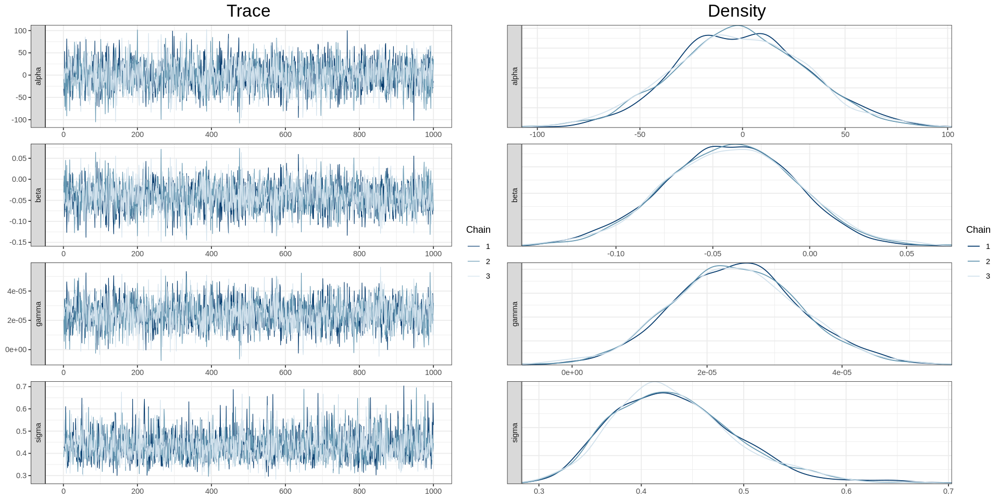

In [22]:
stability_check_generic_fit(fit2)

The results of the fit show:
- Negative linear term $o(10^{-2})$;
- Positive quadratic term $o(10^{-5})$.

Since the sample is taken at $x\approx 2000$, the small quadratic terms becomes comparable with the linear one, giving an overall rising trend.

Considering a larger time range, though, this model is not realistic.

Since there is not a strong quadratic dependence, and since we have no physical model to justify the choice of a parabola to describe the trend, we decide to discard these results and **go on in the analysis with the linear model**.

This choice is also supported by the huge noise affecting the data, which prevents us from properly describing the trend beyond first order.

### PLOT OF THE DATA WITH BAYESIAN LINEAR FIT RESULTS

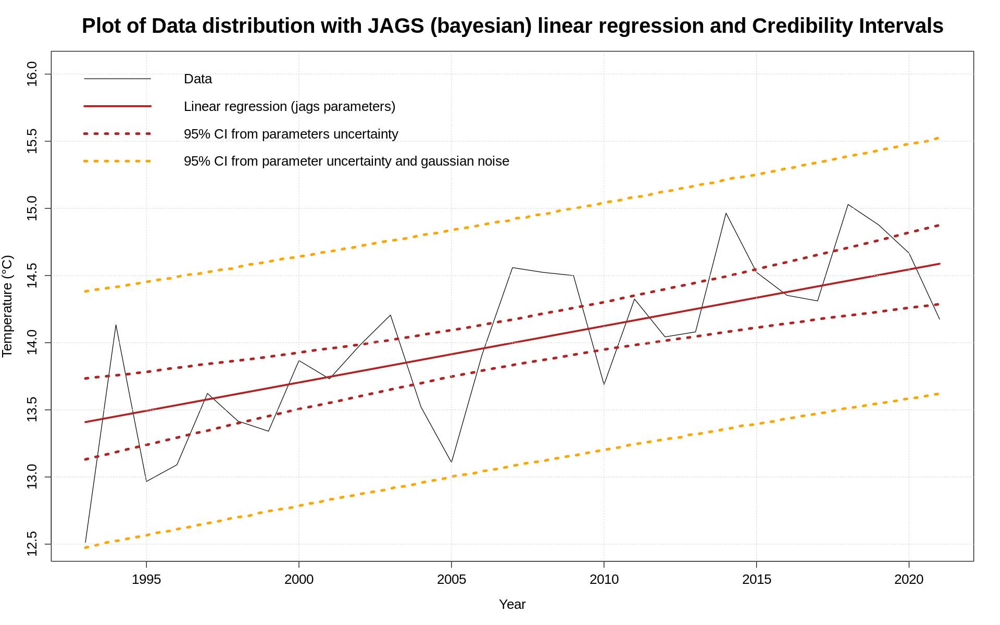

In [23]:
plot_annual_means_with_linear_fit_function<-function(data,fit)

{
    alpha_mcmc<-(fit$BUGSoutput)$mean$alpha[[1]]
    beta_mcmc<-(fit$BUGSoutput)$mean$beta[[1]]

    #To plot the fit function
    #Create a new sequence of xi and calculate the corresponding yi=a+b*xi
    nvalues <- 100
    Year_new <- seq(min(data$Year), max(data$Year), length.out = nvalues)
    pred_mean_mean <- alpha_mcmc + Year_new * beta_mcmc


    # Determines the upper and lower bounds of this 95% credible interval for each of the 100 years/temperatures:
    niter_cumul <-length(fit$BUGSoutput$sims.list$beta)
    pred_mean_dist <- matrix(NA, nrow = niter_cumul, ncol = nvalues) #Empty matrix

    alpha_values_mcmc<-fit$BUGSoutput$sims.list$alpha
    beta_values_mcmc<-fit$BUGSoutput$sims.list$beta

    for (i in 1:nrow(pred_mean_dist)) #Fill the matrix row by row
    {
        #Row (vector) [y] <- scalar + vector*scalar  [a+bx]  
        pred_mean_dist[i,] <-  alpha_values_mcmc[i]+ Year_new * beta_values_mcmc[i]
        #Each row give the y of the points laying on the line having as parameters 
        #those found by the single iteration of the MCMC
    }
   
    
    #95% CI due to uncertainty on parameters values
    
    #I consider all the elements having a certain x: I have a distribution of vaues along y! 
    #I evaluate the qualtiles of this distribution
    credible_lower <- apply(pred_mean_dist, MARGIN = 2, quantile, prob = 0.025)
    credible_upper <- apply(pred_mean_dist, MARGIN = 2, quantile, prob = 0.975)



    #95% CI total:
    #due to uncertainty on parameters values 
    #AND the gaussian error (distribution of the y values around the mean with non-zero sigma)

    nsampl<-100
    mcmc <- as.mcmc(fit)
    mcmc_comb <- as.mcmc(rbind(mcmc[[1]], mcmc[[2]], mcmc[[3]]))
    mcmc_comb_rep <- do.call(rbind, rep(list(mcmc_comb), nsampl)) # replication
   
    # Draw random values for all parameter combinations (rows) and x (columns):
    pred_data_dist <- matrix(NA, nrow = nrow(mcmc_comb_rep), ncol = nvalues)
    for (i in 1:nrow(pred_data_dist))
    {
        #Row (vector) [y] <- scalar + vector*scalar + vector  [a+bx+ v] 
        norm_disp <- rnorm(nvalues, mean = 0, sd = mcmc_comb_rep[i, "sigma"])
        pred_data_dist[i,] <- mcmc_comb_rep[i,"alpha"] + Year_new * mcmc_comb_rep[i,"beta"] + norm_disp
    }

    # Calculate quantiles:
    uncertain_lower <- apply(pred_data_dist, MARGIN = 2, quantile, prob = 0.025)
    uncertain_upper <- apply(pred_data_dist, MARGIN = 2, quantile, prob = 0.975)



    #Plot
    options(repr.plot.width=16, repr.plot.height=10)
    plot(Temp ~ Year, data = data, 
         type="l",
         main = "Plot of Data distribution with JAGS (bayesian) linear regression and Credibility Intervals",
         xlab = "Year",
         ylab = "Temperature (°C)",
         cex.main = 2, cex.lab = 1.3, cex.axis=1.3,
         ylim=c(min(data$Temp), max(data$Temp)+1)
        )

    lines(Year_new, pred_mean_mean, lwd=3,col= "firebrick")
    lines(Year_new, credible_lower, lty = "dotted", lwd=4, col = "firebrick")
    lines(Year_new, credible_upper, lty = "dotted", lwd=4, col="firebrick")
    lines(Year_new, uncertain_lower, lty = "dotted", lwd=4, col = "orange")
    lines(Year_new, uncertain_upper, lty = "dotted", lwd=4, col = "orange")
    grid()
    legend("topleft",
       legend=c("Data", 
                "Linear regression (jags parameters)",
                "95% CI from parameters uncertainty",
                "95% CI from parameter uncertainty and gaussian noise"),
       col=c("black", "firebrick", "firebrick", "orange"),
       lty=c(1,1,3,3),lwd=c(1,3,4,4),cex=1.3 ,
       bty = "n")

    
    return(list(credible_lower,credible_upper))
    
}

trend_plot <-plot_annual_means_with_linear_fit_function(data,fit)


credible_lower<-trend_plot[[1]]
credible_upper<-trend_plot[[2]]



### STANDARD (FREQUENTIST) LINEAR REGRESSION

A standard linear regression is performed, in order to compare the results for the best-fitting parameters with those found via MCMC.

In [24]:
freq_lin_regr<-function(data)
{
    lin_regr <-lm(data$Temp ~ data$Year)

    alpha_freq<-lin_regr$coefficients[[1]]
    sd_alpha_freq<-summary(lin_regr)$coefficients[1 ,2]
    
    beta_freq<-lin_regr$coefficients[[2]]
    sd_beta_freq<-summary(lin_regr)$coefficients[2 ,2]
    
    cat("Results from standard (frequentist) linear fit: \n")
    cat("Intercept: alpha = ", round(alpha_freq,2), "+-", round(sd_alpha_freq,2))
    cat("\n")
    cat("Slope: beta = ", round(beta_freq,4), "+-", round(sd_beta_freq,4))
    
}

freq_lin_regr(dataf)

Results from standard (frequentist) linear fit: 
Intercept: alpha =  -98.41 +- 18.42
Slope: beta =  0.056 +- 0.0092

### FREQUENTIST-BAYESIAN LINEAR REGRESSION COMPARISON

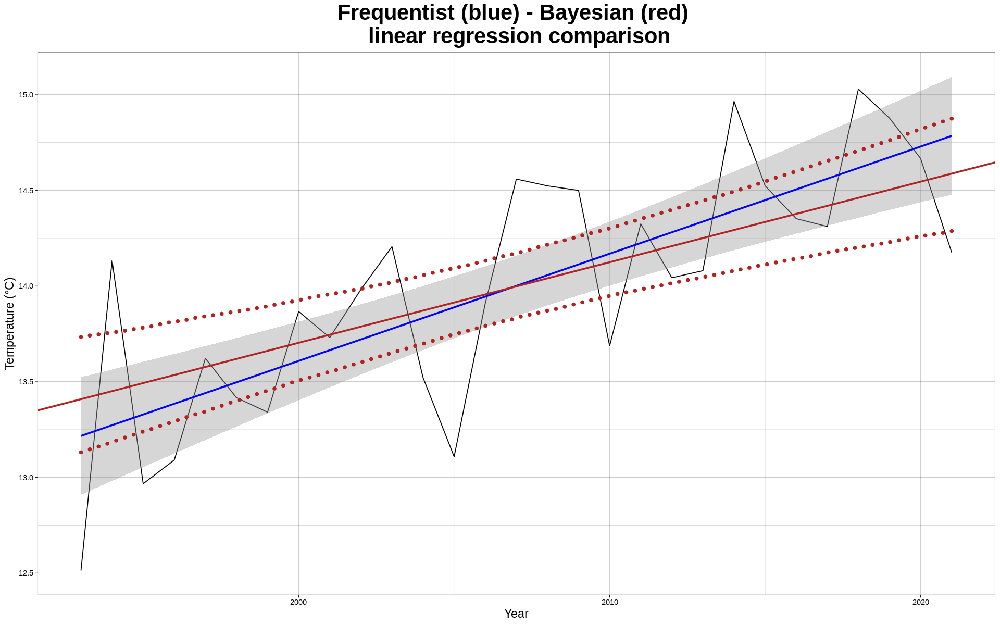

In [25]:

bay_freq_comparison_plot<-function(data, fit, credible_lower, credible_upper)
{
    nvalues <- 100
    Year_new <- seq(min(data$Year), max(data$Year), length.out = nvalues)

    alpha_mcmc<-(fit$BUGSoutput)$mean$alpha[[1]]
    beta_mcmc<-(fit$BUGSoutput)$mean$beta[[1]]

    lower_from_jags<-data.frame(Year_new, credible_lower)
    upper_from_jags<-data.frame(Year_new, credible_upper)


    options(repr.plot.width=16, repr.plot.height=10)
    pl<-ggplot(data=data, aes(Year, Temp)) +
      geom_line() +
      stat_smooth(method = lm, formula = y ~ x, size = 1, color="blue", fullrange = TRUE, level = 0.95)+ 
      geom_abline(intercept=alpha_mcmc,slope=beta_mcmc, color="firebrick", size=1, )+ 
      geom_point(data = lower_from_jags, mapping = aes(x= Year_new,y=credible_lower), color="firebrick")+
      geom_point(data = upper_from_jags, mapping = aes(x= Year_new,y=credible_upper), color="firebrick")+
      theme_linedraw()+guides(fill="none") +
      ggtitle("Frequentist (blue) - Bayesian (red) \n linear regression comparison")+
      labs(y= "Temperature (°C)", x = "Year")+
      theme(
        plot.title = element_text(size=25, hjust = 0.5, face="bold"),
        axis.title.x = element_text(size=14),
        axis.title.y = element_text(size=14)
        )   
    pl
      
      
}

bay_freq_comparison_plot(dataf,fit, credible_lower, credible_upper)


## Function that resumes the major results of the presented analysis:

In [26]:


complete_analysis_annual_means_trend<-function(dataf)
{
    #Convert data to format requested by jags
    data <- with(dataf, list(Year = Year, Temp = Temp, N = length(Year)))

    #BAYESIAN LINEAR REGRESSION WITH JAGS
    cat("\n===============================================================================================\n")
    cat("BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)\n")
    cat("===============================================================================================\n")
    fit<-bayesian_linear_regression_jags(data)
    

    #BAYESIAN CONSTANT REGRESSION WITH JAGS
    cat("\n===============================================================================================\n")
        cat("BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = alpha)\n")
    cat("===============================================================================================\n")
    fit0<-bayesian_flat_regression_jags(data)


    #MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
    cat("\n===============================================================================================\n")
    cat("MODEL COMPARISON: SUITABILITY OF LINEAR MODEL\n")
    cat("===============================================================================================\n")
    freq_lik_ratio_const_lin<-freq_lik_ratio(dataf, fit0,fit)

    #HYPOTESIS TESTING: CONFIRMATION OF LINEAR GROWTH
    cat("\n===============================================================================================\n")
    cat("HYPOTESIS TESTING: CONFIRMATION OF LINEAR GROWTH\n")
    cat("===============================================================================================\n")
    ht_linear(fit)
     
    
    #STANDARD (FREQUENTIST) LINEAR FIT
    cat("\n===============================================================================================\n")
    cat("STANDARD (FREQUENTIST) LINEAR FIT \n")
    cat("===============================================================================================\n")
    freq_lin_regr(dataf)


    #PLOTS
    cat("\n\n===============================================================================================\n")
    cat("FINAL PLOTS \n")
    cat("===============================================================================================\n")
    
    #0. TWO SIDE HYPOTHESIS TEST
    two_side_ht_plot(fit)
    
    #1. PLOT OF DATA DISTRIBUTION WITH JAGS (BAYESIAN) LINEAR REGRESSION AND CREDIBILITY INTERVAL
    trend_plot <-plot_annual_means_with_linear_fit_function(data,fit)
    credible_lower<-trend_plot[[1]]
    credible_upper<-trend_plot[[2]]

    
    #2.FREQUENTIST-BAYESIAN LINEAR REGRESSION COMPARISON
    bay_freq_comparison_plot(dataf,fit, credible_lower, credible_upper)
}

## B. DETAILED ANALYSIS OF MIN TEMPERATURES (ANNUAL MEANS)

In [27]:
#Build dataframe with only the columns of interest (year and annual mean of max temperature)
dataf <- df2[,c("Year", "Mean_Min_Temperature")]
names(dataf)<-c("Year", "Temp")
head(dataf)

,Year,Temp
,<dbl>,<dbl>
1,1993,7.757067
2,1994,9.738356
3,1995,8.406893
4,1996,8.739891
5,1997,8.947397
6,1998,8.584111



BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e7a99e863.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect     2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -71.586  20.137 -110.327 -85.026 -72.175 -58.684 -29.206 1.001  3000
beta       0.040   0.010    0.019   0.034   0.041   0.047   0.060 1.001  3000
sigma      0.507   0.076    0.383   0.452   0.497   0.552   0.679 1.002  1600
deviance  41.216   3.953   35.900  38.218  40.503  43.388  50.859 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 7.8 and DIC = 49.0
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e29e791f3.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha      9.425   0.133  9.161  9.336  9.426  9.512  9.693 1.001  3000
sigma      0.703   0.098  0.542  0.635  0.690  0.760  0.923 1.002  1200
deviance  60.289   2.155 58.198 58.749 59.645 61.099 66.072 1.002  1900

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.3 and DIC = 62.6
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 4.012395e-06 
Likelihood linear = 8.210394e-06 
Frequentist likelihood ratio (linear/constant) =  2.05 

Linear model is more suitable than constant!
HYPOTE

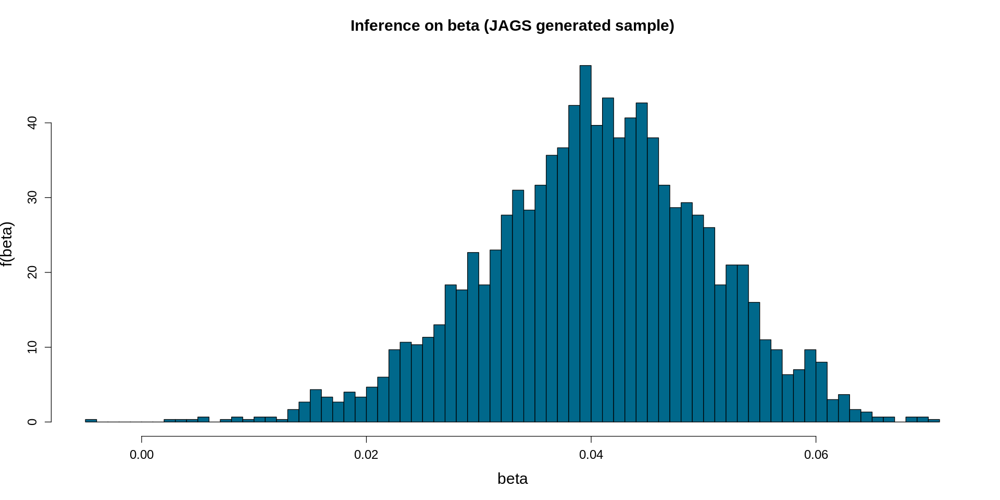

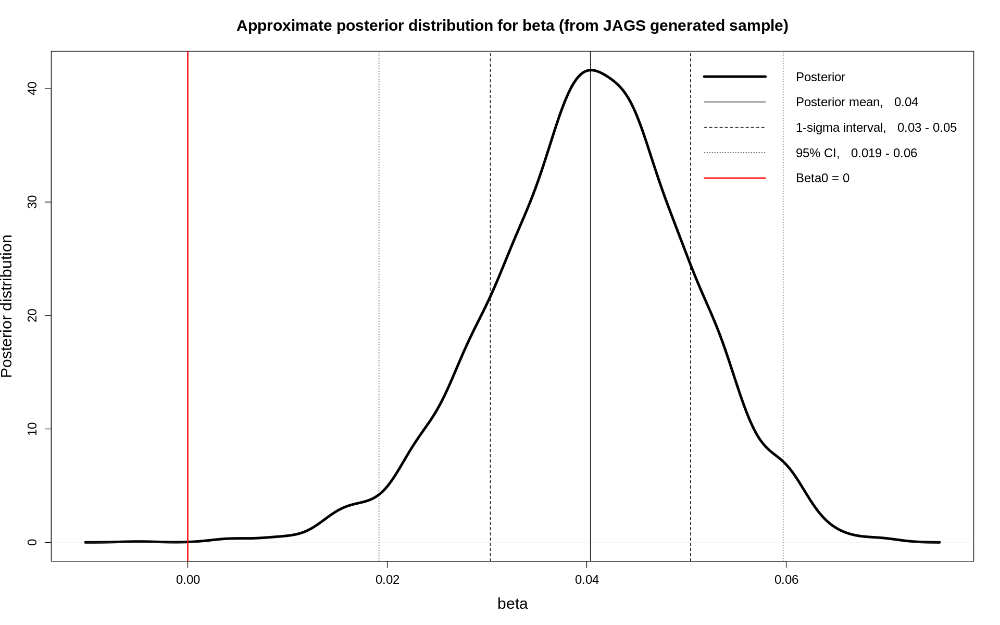

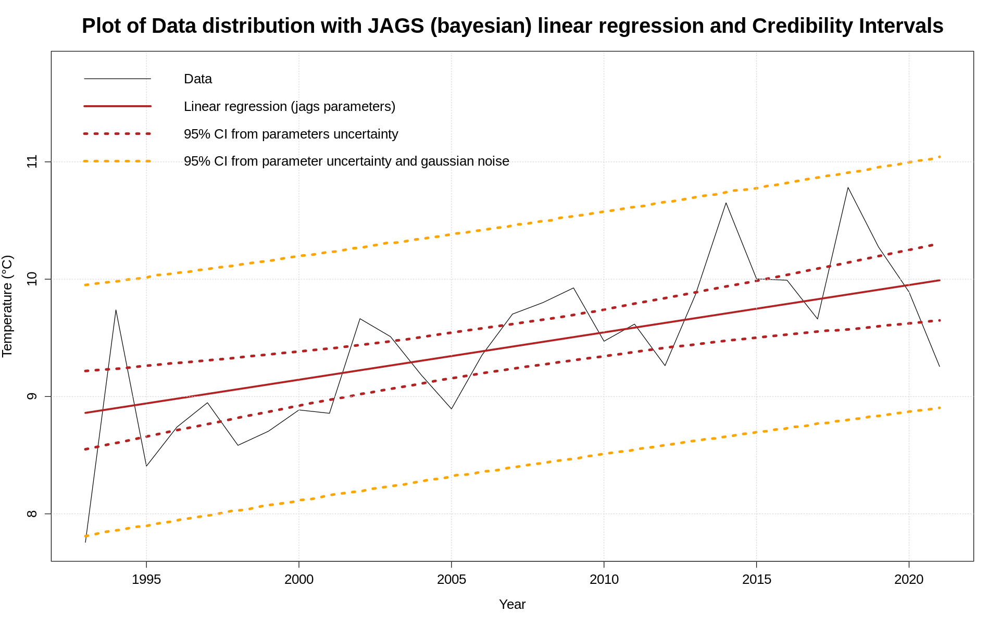

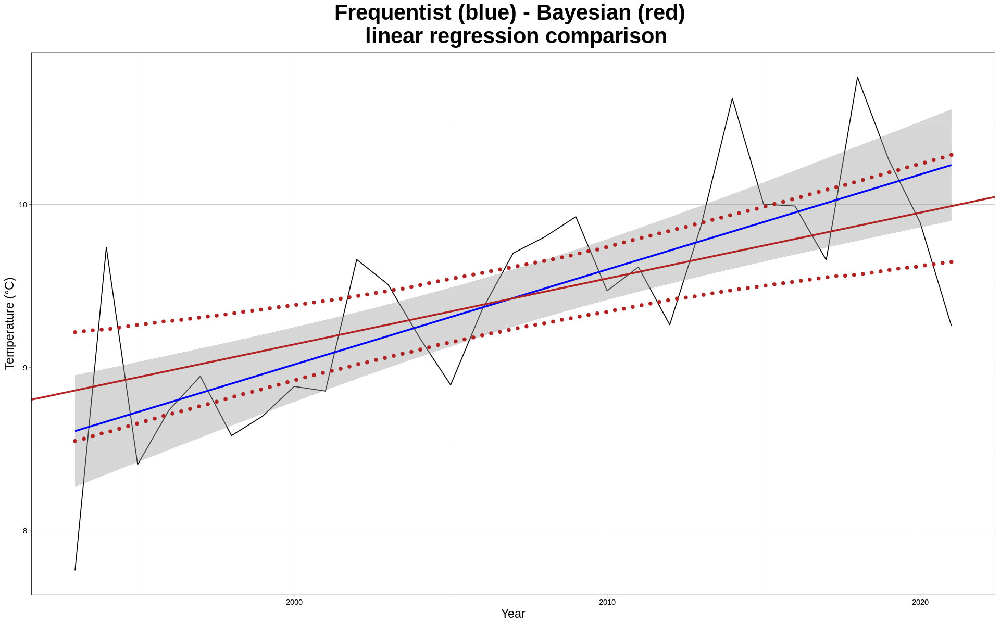

In [28]:
complete_analysis_annual_means_trend(dataf)

## C. DETAILED ANALYSIS OF MAX TEMPERATURES (ANNUAL MEANS)

In [29]:
#Build dataframe with only the columns of interest (year and annual mean of max temperature)
dataf <- df2[,c("Year", "Mean_Max_Temperature")]
names(dataf)<-c("Year", "Temp")
head(dataf)

,Year,Temp
,<dbl>,<dbl>
1,1993,17.54104
2,1994,18.66493
3,1995,17.76385
4,1996,17.47213
5,1997,18.47233
6,1998,18.45393



BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e10a2dd31.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect     2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -63.582  21.016 -102.836 -77.643 -64.041 -50.362 -19.513 1.001  3000
beta       0.041   0.010    0.019   0.034   0.041   0.048   0.061 1.001  3000
sigma      0.564   0.085    0.426   0.502   0.552   0.615   0.758 1.001  3000
deviance  47.259   3.762   42.209  44.517  46.501  49.223  56.536 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 7.1 and DIC = 54.3
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e1492b3de.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     18.813   0.142 18.535 18.718 18.812 18.908 19.088 1.001  3000
sigma      0.754   0.110  0.577  0.678  0.741  0.817  1.007 1.001  3000
deviance  64.447   2.194 62.271 62.874 63.765 65.301 70.261 1.002  1900

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.4 and DIC = 66.9
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 3.854598e-06 
Likelihood linear = 7.40853e-06 
Frequentist likelihood ratio (linear/constant) =  1.92 

Linear model is more suitable than constant!
HYPOTES

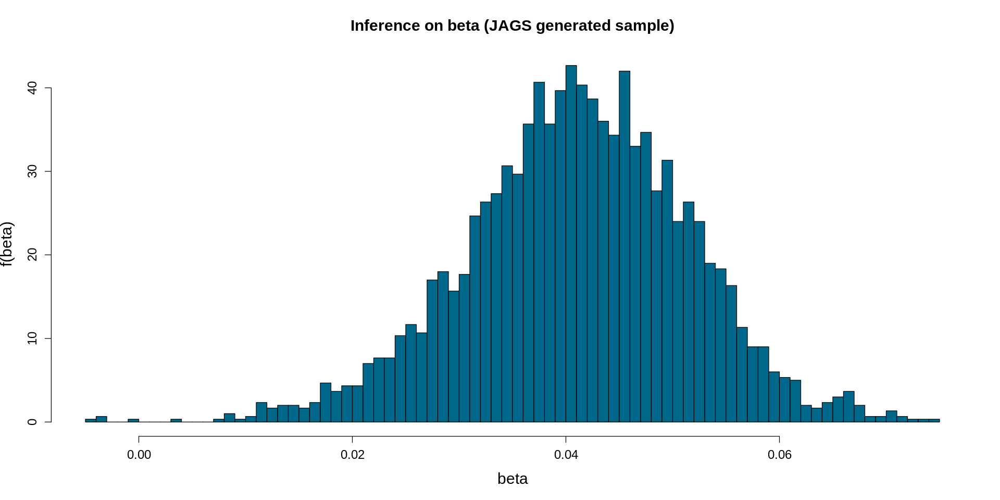

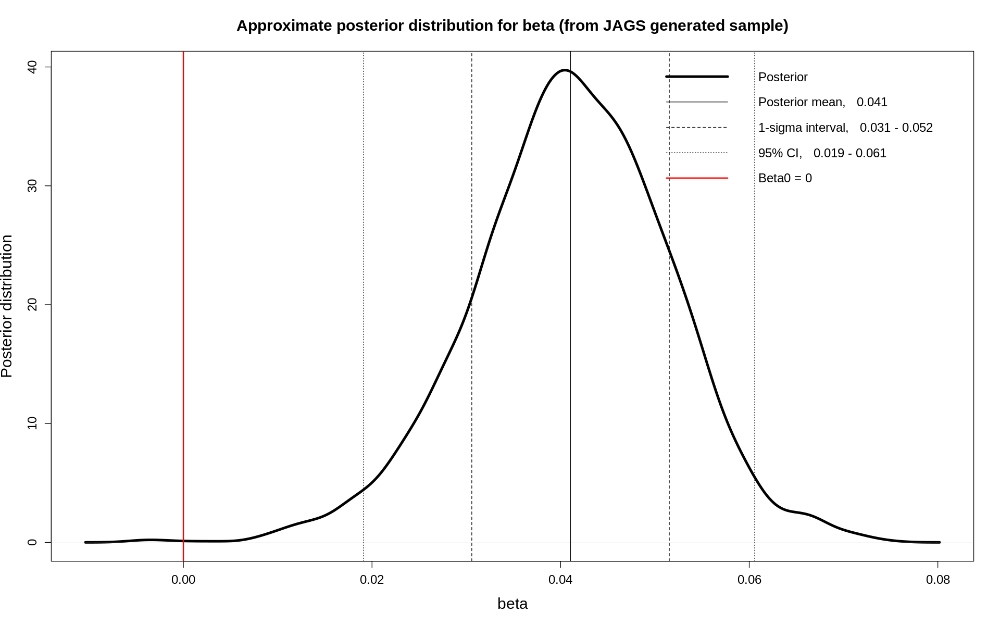

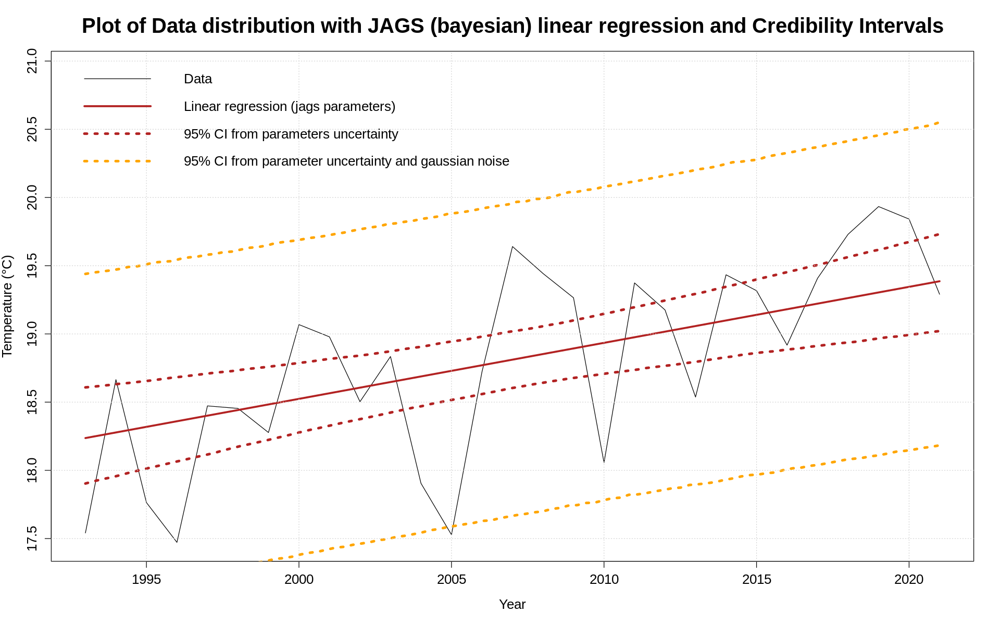

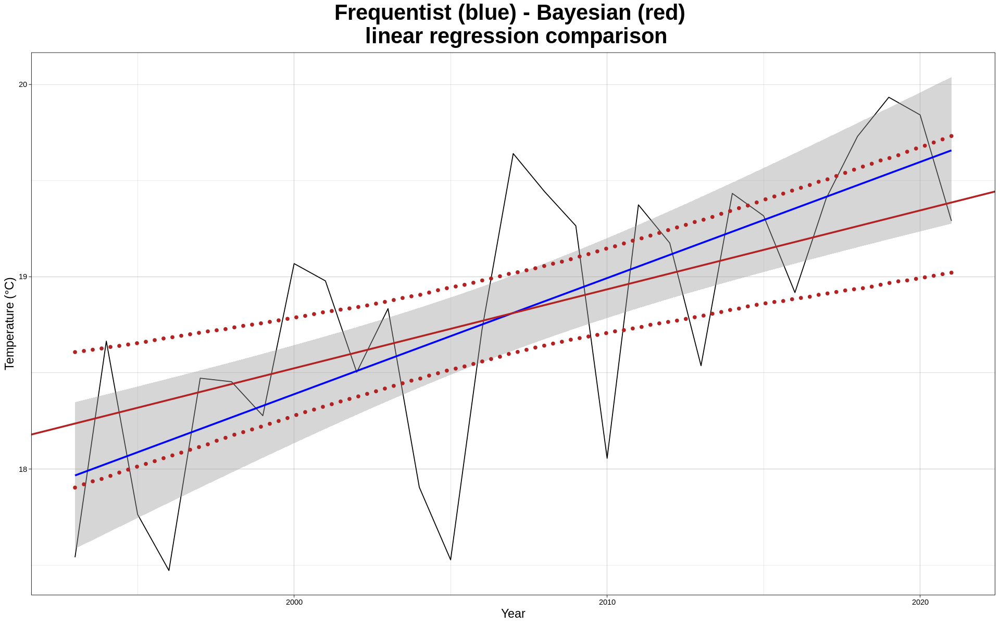

In [30]:
complete_analysis_annual_means_trend(dataf)

## CONCLUSIONS PART 1

The trends of the annual means of min, max and average temperatures have been studied.

All the tests and analysis confirm that these temperature are rising. The trends are not compatible with a constant distribution: the hypothesis of the distributions being constant can be rejected at $\alpha=0.05$ for all the samples.


# PART 2: ANALYSIS OF ANNUAL TEMPERATURE DIFFERENCES FOR MIN, MAX AND AVERAGE (1993-2021)

After checking the fact that in the last 28 years the temperature increased, we decided to compute how much  it increased considering 4 years intervals, to make some previsions about the possible increase in the next years and to compare them with results presented by SNPA  (link to the article $\longrightarrow$ https://www.snpambiente.it/wp-content/uploads/2021/06/Rapporto-SNPA-21_2021.pdf).

In particular in this part we are going to:
- perform some MCMC simulations with RJAGS in order to infer from the dataset how much average,max and min temperature increased over 4 years period
-  make some future prediction from MCMC  simulations
- compare the results obtained with SNPA's results of Italy's temperature to check if in the place where the data has been collected the increaseof tempersture is higher or not compare to Italy's itself
- perform also a prevision using FORECAST library to check how the prevision itself changes if we change the approach



## THE DATASET

In order to make an analysis considering 4 years period we first aggregated daily data in yearly data. Then we computed the difference between the temperature of each couple of consecutive years ($Year_i - Year_{i-1}$) and then we aggregated these yearly differences into  blocks of 4 years each.

In [31]:
#function to compute the difference between values and add the column in the df
f_difference<-function(df2_)
{
    df2_<-df2_ %>%  mutate(Max_Temperature_diff = Mean_Max_Temperature- lag(Mean_Max_Temperature))
    df2_<-df2_ %>%  mutate(Min_Temperature_diff = Mean_Min_Temperature- lag(Mean_Min_Temperature))
    df2_<-df2_ %>%  mutate(Means_measure_diff =Mean_Average_Temperature - lag(Mean_Average_Temperature ))

}
#porto
df2p<-f_difference(df2)

#function to aggregate four years
four_years1<-function(df2_){

df2t<-df2_ %>% mutate(period = cut(df2p$Year,seq(1993,2021,by=4),right=F)) %>% 
 group_by( period) %>% summarise(Mean_Average_Temperature = mean(Mean_Average_Temperature), Mean_Min_Temperature = mean(Mean_Min_Temperature),Mean_Max_Temperature = mean(Mean_Max_Temperature))

df2t<-df2t[-8,]
df2t<-as.data.frame(df2t)

df2t<-f_difference(df2t)
df2t
    
    }

#create the dataframe
df2p_3<-four_years1(df2p)
#show df last 2 rows
df2p_3[6:7,]

,period,Mean_Average_Temperature,Mean_Min_Temperature,Mean_Max_Temperature,Max_Temperature_diff,Min_Temperature_diff,Means_measure_diff
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
6,"[2013,2017)",14.48033,10.12876,19.05130,0.08374197,0.55937977,0.3414820
7,"[2017,2021)",14.72115,10.15166,19.72833,0.67702745,0.02290201,0.2408144


## MCMC WITH RJAGS

After the aggregation of  the data we performed MCMC simulation. In particular we considered the measuraments coming from a gaussian distribution with unknown mean $\mu$ and $\sigma$ in our model.

First of all, in order to justify this assumption we checked the distribution of the data plotting the histograms.

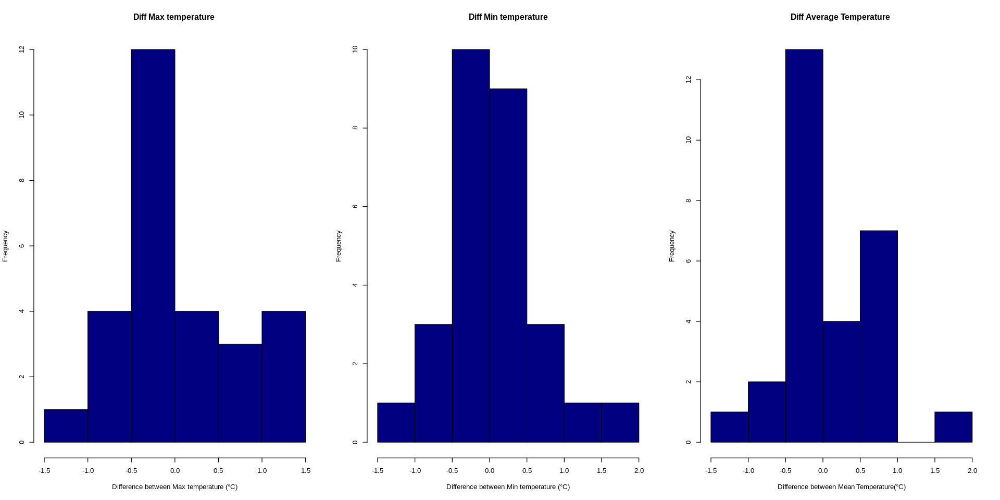

In [32]:
# function to check normality of difference

hist_norm_check<- function(df2_)
    {
    options(repr.plot.width = 16, repr.plot.height =8)
    par(mfrow=c(1,3))
    #histogram 
    hist(df2_$Max_Temperature_diff,
         col="navy",
         breaks=7,
         xlab="Difference between Max temperature (°C)",
         ylab="Frequency",
         main="Diff Max temperature " )
    
    hist(df2_$Min_Temperature_diff,
         col="navy",
         breaks=7,
         xlab="Difference between Min temperature (°C)",
         ylab="Frequency",
         main="Diff Min temperature" )
    
    hist(df2_$Means_measure_diff ,
        col="navy",
        breaks=7,
        xlab="Difference between Mean Temperature(°C)",
        ylab="Frequency",
        main="Diff Average Temperature " )
    
    
}

hist_norm_check(df2p)

As shown in the plot, they have a little shape of gaussianity but it is not evident. 

So we performed a Kolmogorov-Smirnov Goodness-of-Fit Test just to have an information about the distribution itself.

In particular Kolmogorov-Smirnov Test is a type of non-parametric test of the equality of discontinuous and continuous of a 1D probability distribution that is used to compare the sample with the reference probability test (known as one-sample K-S Test) or among two samples (known as two-sample K-S test). A K-S Test quantifies a distance between the cumulative distribution function of the given reference distribution and the empirical distributions of given two samples, or between the empirical distribution of given two samples.

In [33]:
#kolmogorv. function
ks<-function(df21,columns,a,b){
   data<-df21[ , columns]
    ks.test(data,pnorm)
}

cat("=============================================================================================","\n")
cat("\n")
cat("=========== KOLMOGOROV-SMIRNOV-GOODNESS-OF-FIT TEST FOR DIFFERENCE OF TEMPERATURE ===========","\n")

cat("Average Temperature","\n")
ks(df2p,columns=c("Means_measure_diff"))

cat("Max Temperature","\n")
ks(df2p,columns=c("Max_Temperature_diff"))

cat("Min Temperature","\n")
ks(df2p,columns=c("Min_Temperature_diff"))

cat("\n")
cat("=============================================================================================","\n")


=========== KOLMOGOROV-SMIRNOV-GOODNESS-OF-FIT TEST FOR DIFFERENCE OF TEMPERATURE =========== 
Average Temperature 



	One-sample Kolmogorov-Smirnov test

data:  data
D = 0.20455, p-value = 0.1668
alternative hypothesis: two-sided


Max Temperature 



	One-sample Kolmogorov-Smirnov test

data:  data
D = 0.1545, p-value = 0.4696
alternative hypothesis: two-sided


Min Temperature 



	One-sample Kolmogorov-Smirnov test

data:  data
D = 0.22269, p-value = 0.1061
alternative hypothesis: two-sided


As shown from the test the gaussian distribution for the data may be possible (with $\alpha$= 5%).

So we performed  MCMC simulations with a BUGS model with a gaussian likelihood $  \sim N( \mu ,\tau) $ and  priors  $\mu$ $\sim $ $N(0,10^{-6})$ and   $ \tau \sim \Gamma(1,10^{-4}) $ where  $\sigma  \sim  \frac{1}{\sqrt( \tau)} $.

## DIFFERENCE BETWEEN AVERAGE TEMPERATURES 

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

         Mean      SD  Naive SE Time-series SE
Y     0.25761 0.11227 0.0006482      0.0006482
mu    0.25737 0.04238 0.0002447      0.0002466
sigma 0.09927 0.03182 0.0001837      0.0002152

2. Quantiles for each variable:

         2.5%    25%     50%    75%  97.5%
Y     0.03362 0.1895 0.25706 0.3254 0.4855
mu    0.17294 0.2316 0.25772 0.2825 0.3424
sigma 0.05852 0.0778 0.09261 0.1130 0.1786



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.



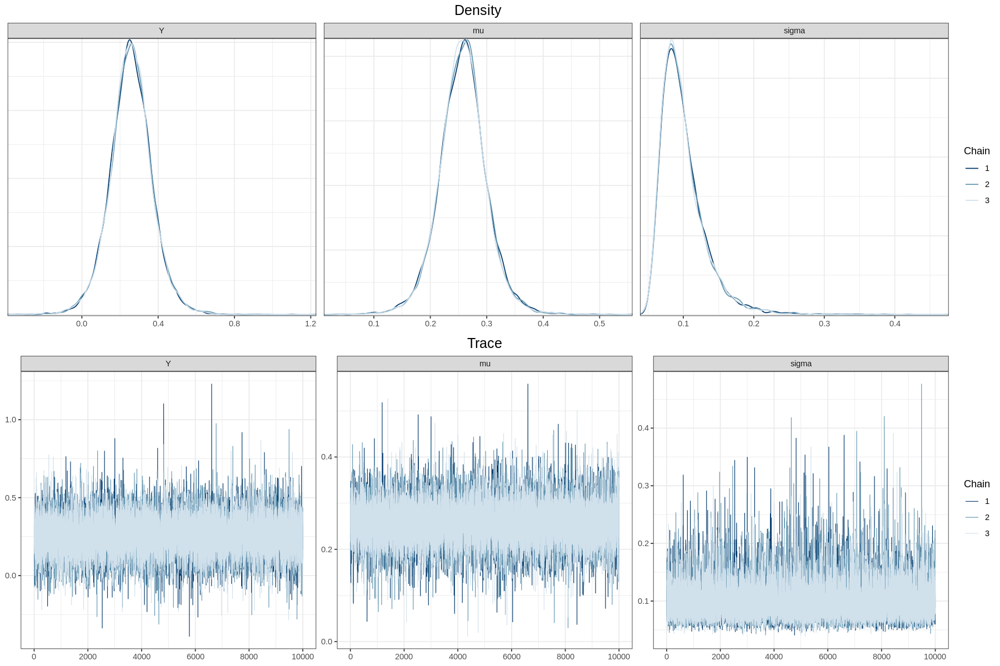

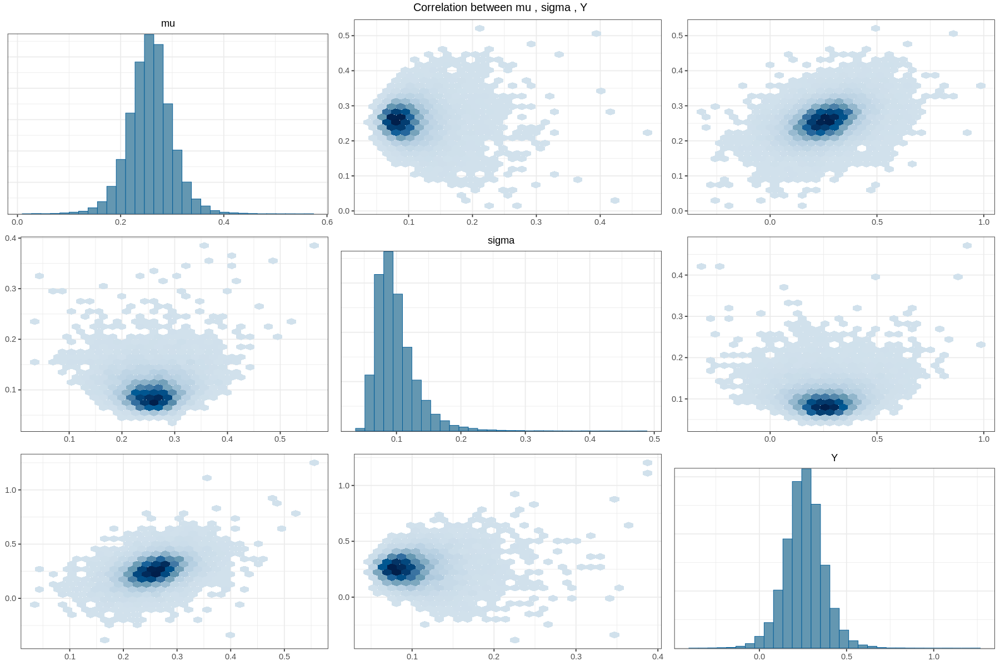

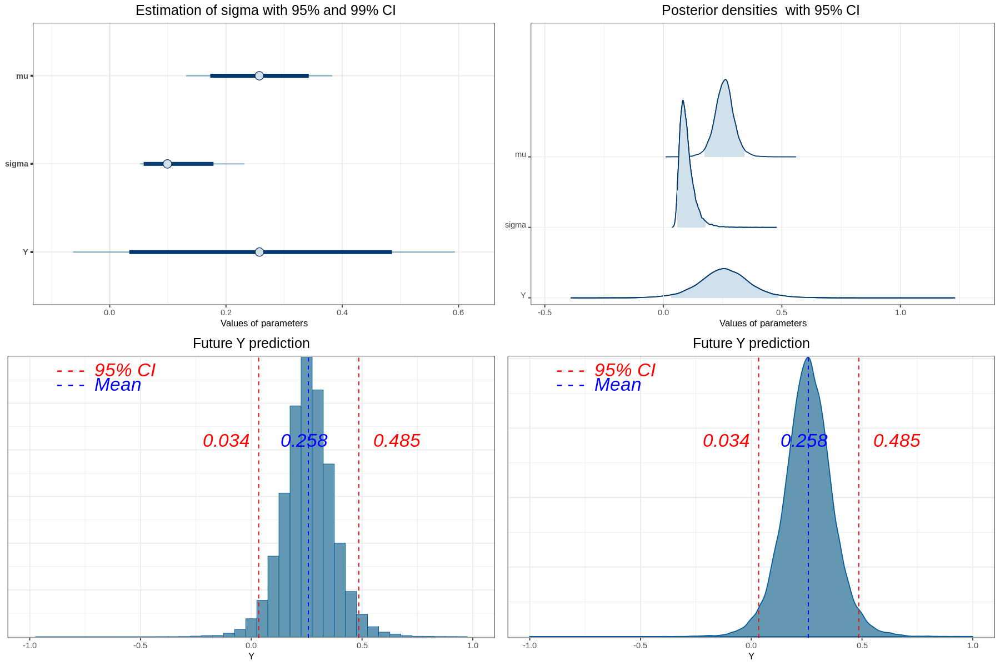

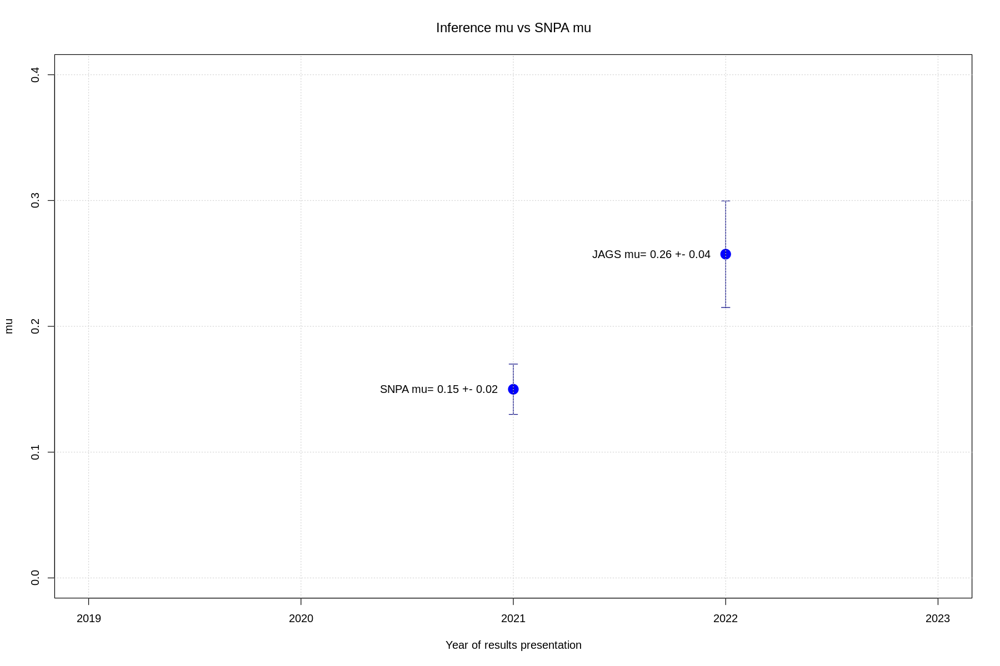

In [34]:
#jags function and plots


jags_mean<- function(df21,columns,mean_0,std0) 
    {

    
    model_string<-"model{
    for (i in 1:length(X)) {
    X[i] ~ dnorm(mu, tau);                  
    }
    mu ~ dnorm(0.0, 1.0E-6);
    tau ~ dgamma(1, 1.0E-4);
    sigma <- 1.0/sqrt(tau);
    # future observation
   Y ~ dnorm(mu, tau);
   
    }"

    data_obs<-df21[ , columns]
    # Our data for the model
    data <- NULL
    data$X <- data_obs 

    model <- jags.model(file = textConnection(model_string), 
                    data = data,
                    n.chains=3,
                       quiet=TRUE)

   # Update the Markov chain (Burn-in)
    update(model, 10000)
    chain <- coda.samples(model, c("mu", "sigma","Y"), n.iter=10000)
     
    cat("=========================================================","\n")

    cat("JAGS results:","\n")

    cat("=========================================================","\n")


  print(summary(chain))
   

  model_summary_object <- summary(chain)
  model_summary_object$quantiles[,c('2.5%','97.5%')]

    

    # plot the results
       
    options(repr.plot.width = 15, repr.plot.height =10)
    theme_set(theme_bw())
    My_Theme = theme(
    axis.title.x = element_text(size = 10),
    plot.title=element_text(size = 15))
    
    
   
    # Create a text
   grob <- grobTree(textGrob("- - -  95% CI", x=0.1,  y=0.95, hjust=0,
   gp=gpar(col="red", fontsize=20, fontface="italic",size = 1.5)))
   grob2 <- grobTree(textGrob("- - -  Mean", x=0.1,  y=0.9, hjust=0,
   gp=gpar(col="blue", fontsize=20, fontface="italic",size = 1.5)))
   grob3 <- grobTree(textGrob(round(model_summary_object$statistics[1],3), x=0.56,  y=0.7, hjust=0,
   gp=gpar(col="blue", fontsize=20, fontface="italic",size = 1.5)))
   grob4 <- grobTree(textGrob(round(model_summary_object$quantiles[1,c('2.5%')],3), x=0.4,  y=0.7, hjust=0,
   gp=gpar(col="red", fontsize=20, fontface="italic",size = 1.5)))    
   grob5 <- grobTree(textGrob(round(model_summary_object$quantiles[1,c('97.5%')],3), x=0.75,  y=0.7, hjust=0,
   gp=gpar(col="red", fontsize=20, fontface="italic",size = 1.5)))    
    
    
    #analysis plot
      
    po<-mcmc_hist(chain,"Y",binwidth=0.05)+
                           ggtitle("Future Y prediction")+
                           theme(plot.title = element_text(hjust = 0.5))+ 
                           My_Theme+ 
                           geom_vline(xintercept= model_summary_object$statistics[1],,color="blue", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('2.5%')],color="red", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('97.5%')],color="red", linetype="dashed", size=0.5 )+ 
                           annotation_custom(grob)+
                           annotation_custom(grob2)+
                           annotation_custom(grob3)+
                           annotation_custom(grob4)+
                           annotation_custom(grob5)+
                           xlim(-1, 1)
     
     po1<-mcmc_dens(chain,"Y")+
                           ggtitle("Future Y prediction")+
                           theme(plot.title = element_text(hjust = 0.5))+ 
                           My_Theme+ 
                           geom_vline(xintercept= model_summary_object$statistics[1],,color="blue", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('2.5%')],color="red", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('97.5%')],color="red", linetype="dashed", size=0.5 )+ 
                           annotation_custom(grob)+
                           annotation_custom(grob2)+
                           annotation_custom(grob3)+
                           annotation_custom(grob4)+
                           annotation_custom(grob5)+
                           xlim(-1, 1)
    
     p1<-mcmc_dens_overlay(chain)+
                           ggtitle("Density")+
                           theme(plot.title = element_text(hjust = 0.5))+ 
                           My_Theme


    
     p2<- mcmc_trace(chain)+
                     ggtitle("Trace")+
                     theme(plot.title = element_text(hjust = 0.5))+
                     My_Theme
    
   
    #corr plot
    p3<-  mcmc_pairs(chain,
               pars=c("mu","sigma","Y"),
               off_diag_fun="hex",
               grid_args = list(top="Correlation between mu , sigma , Y"))
    
    
    
    
    
    #intervals plot
    p4<-mcmc_intervals(
                       chain,
                       pars = c("mu"),
                       prob = 0.95, 
                       prob_outer = 0.99,
                       point_est = c( "mean")
                       )+
                       theme(plot.title = element_text(hjust = 0.5))+
                       ggtitle(" Estimation of mu with 95% and 99% CI")+ 
                       xlab("mu")+ 
                       My_Theme
    
   #intervals plot
   p5<-mcmc_intervals(
                       chain,
                       pars = c("mu","sigma","Y"),
                       prob = 0.95, 
                       prob_outer = 0.99,
                       point_est = c( "mean")
                       )+
                      theme(plot.title = element_text(hjust = 0.5))+
                      ggtitle(" Estimation of sigma with 95% and 99% CI")+ 
                      xlab("Values of parameters")+ 
                      My_Theme
                    


    #parameters post shape
    p6<-mcmc_areas_ridges(chain,
                          pars = c("mu","sigma","Y"),
                          prob = 0.95,
                          bw = "SJ") +
                          ggtitle("Posterior densities  with 95% CI ")+
                          theme(plot.title = element_text(hjust = 0.5))+
                          xlab("Values of parameters")+ 
                          My_Theme
                          
    grid.arrange(p1,p2,nrow=2)
    grid.arrange(p3,nrow=1)
    grid.arrange(p5,p6,po,po1,nrow=2)
   

    
    
    #plot to compare result
    x<-c(2021,2022)
    y<-c(mean_0,model_summary_object$statistics[2])
    sd<-c(std0,model_summary_object$statistics[5])
    
   plot (x,
         y,
         xlim=c(2019,2023),
         ylim=c(0,0.4),
        pch=19,
        cex=2,
        font.main = 1,
        col="blue",
         ylab="mu",
         xlab="Year of results presentation",
         main="Inference mu vs SNPA mu",
         xaxt = "n")
   axis(1, at = c(2019, 2020,2021,2022,2023),
     labels = c("2019", "2020","2021","2022","2023"))
   segments(x,y-sd,x,y+sd,col="navy")
   epsilon <- 0.02
   segments(x-epsilon,y-sd,x+epsilon,y-sd,col="navy")
   segments(x-epsilon,y+sd,x+epsilon,y+sd,col="navy")
   text(x=2021.65,y=model_summary_object$statistics[2],labels=paste("JAGS mu=",round(model_summary_object$statistics[2],2), "+-",round(model_summary_object$statistics[5],2)), col ='black', font=1)
   text(x=2020.65,y=mean_0,labels=paste("SNPA mu=",mean_0, "+-",std0), col ='black', font=1)
     grid()

   
    
   }

jags_mean(df2p_3,columns=c("Means_measure_diff"),0.15,0.02)




## DIFFERENCE BETWEEN MAX TEMPERATURES 

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD  Naive SE Time-series SE
Y     0.3096 0.3350 0.0019340      0.0019551
mu    0.3118 0.1265 0.0007301      0.0007431
sigma 0.2945 0.0955 0.0005514      0.0006490

2. Quantiles for each variable:

          2.5%    25%    50%    75%  97.5%
Y     -0.35659 0.1083 0.3096 0.5092 0.9815
mu     0.05726 0.2361 0.3114 0.3878 0.5649
sigma  0.17422 0.2302 0.2743 0.3350 0.5305



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.



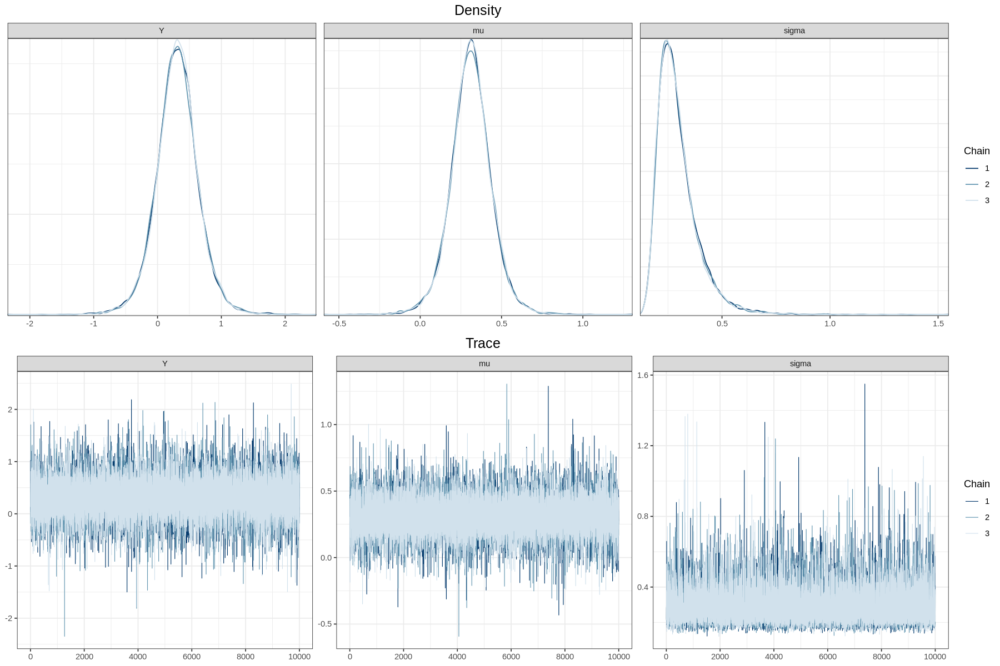

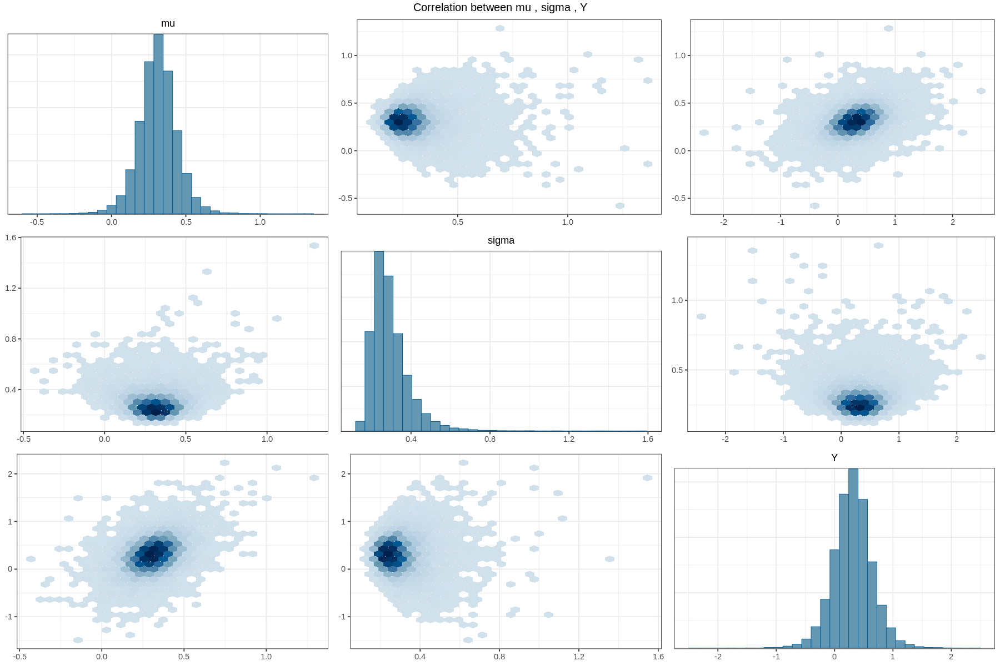

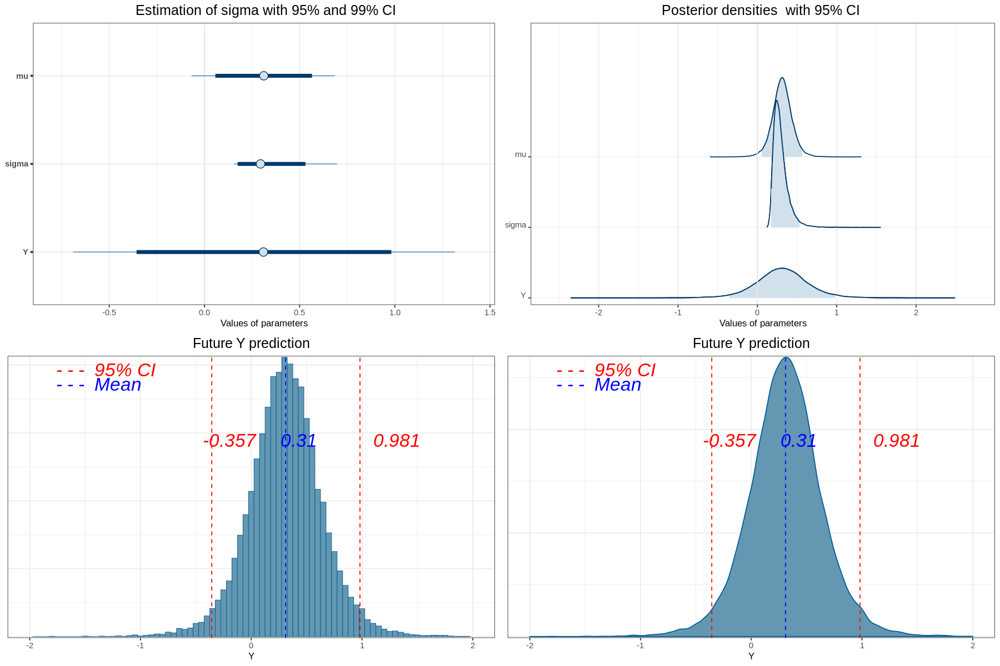

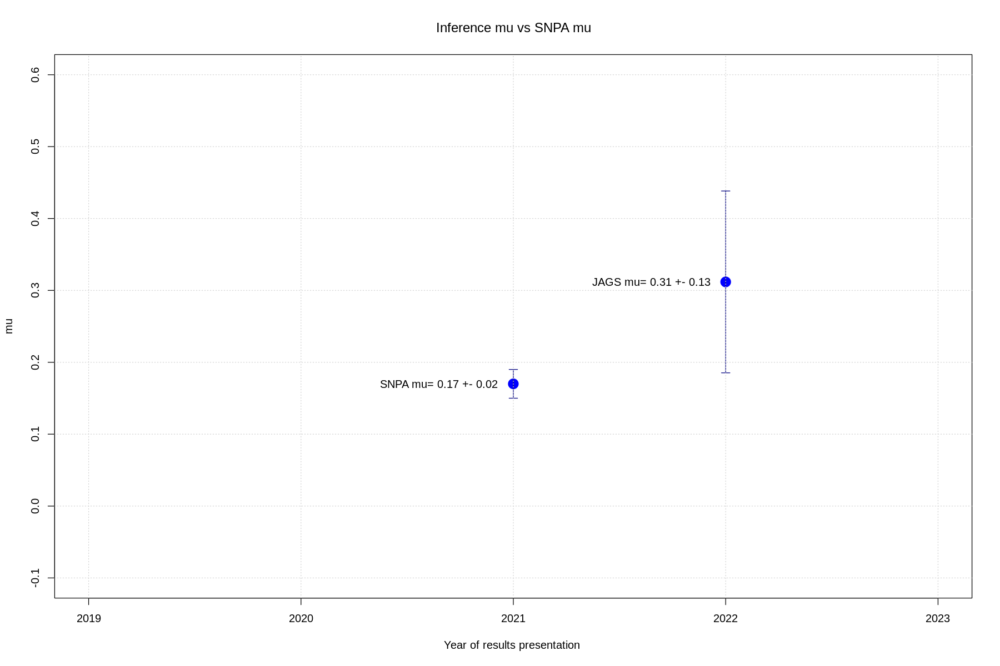

In [35]:
#jags function and plots

jags_max_min<- function(df21,columns,mean_0,std0) 
    {

    
    model_string<-"model{
    for (i in 1:length(X)) {
    X[i] ~ dnorm(mu, tau);                  
    }
    mu ~ dnorm(0.0, 1.0E-6);
    tau ~ dgamma(1, 1.0E-4);
    sigma <- 1.0/sqrt(tau);
    # future observation
   Y ~ dnorm(mu, tau);
   
    }"

    data_obs<-df21[ , columns]
    # Our data for the model
    data <- NULL
    data$X <- data_obs 

    model <- jags.model(file = textConnection(model_string), 
                    data = data,
                    n.chains=3,
                       quiet=TRUE)

   # Update the Markov chain (Burn-in)
    update(model, 10000)
    chain <- coda.samples(model, c("mu", "sigma","Y"), n.iter=10000)
     
    cat("=========================================================","\n")

    cat("JAGS results:","\n")

    cat("=========================================================","\n")


  print(summary(chain))
   

  model_summary_object <- summary(chain)
  model_summary_object$quantiles[,c('2.5%','97.5%')]

    

    # plot the results
       
    options(repr.plot.width = 15, repr.plot.height =10)
    theme_set(theme_bw())
    My_Theme = theme(
    axis.title.x = element_text(size = 10),
    plot.title=element_text(size = 15))
    
    
   
    # Create a text
   grob <- grobTree(textGrob("- - -  95% CI", x=0.1,  y=0.95, hjust=0,
   gp=gpar(col="red", fontsize=20, fontface="italic",size = 1.5)))
   grob2 <- grobTree(textGrob("- - -  Mean", x=0.1,  y=0.9, hjust=0,
   gp=gpar(col="blue", fontsize=20, fontface="italic",size = 1.5)))
   grob3 <- grobTree(textGrob(round(model_summary_object$statistics[1],3), x=0.56,  y=0.7, hjust=0,
   gp=gpar(col="blue", fontsize=20, fontface="italic",size = 1.5)))
   grob4 <- grobTree(textGrob(round(model_summary_object$quantiles[1,c('2.5%')],3), x=0.4,  y=0.7, hjust=0,
   gp=gpar(col="red", fontsize=20, fontface="italic",size = 1.5)))    
   grob5 <- grobTree(textGrob(round(model_summary_object$quantiles[1,c('97.5%')],3), x=0.75,  y=0.7, hjust=0,
   gp=gpar(col="red", fontsize=20, fontface="italic",size = 1.5)))    
    
    
    #analysis plot
      
    po<-mcmc_hist(chain,"Y",binwidth=0.05)+
                           ggtitle("Future Y prediction")+
                           theme(plot.title = element_text(hjust = 0.5))+ 
                           My_Theme+ 
                           geom_vline(xintercept= model_summary_object$statistics[1],,color="blue", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('2.5%')],color="red", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('97.5%')],color="red", linetype="dashed", size=0.5 )+ 
                           annotation_custom(grob)+
                           annotation_custom(grob2)+
                           annotation_custom(grob3)+
                           annotation_custom(grob4)+
                           annotation_custom(grob5)+
                           xlim(-2, 2)
     
     po1<-mcmc_dens(chain,"Y")+
                           ggtitle("Future Y prediction")+
                           theme(plot.title = element_text(hjust = 0.5))+ 
                           My_Theme+ 
                           geom_vline(xintercept= model_summary_object$statistics[1],,color="blue", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('2.5%')],color="red", linetype="dashed", size=0.5 )+
                           geom_vline(xintercept = model_summary_object$quantiles[1,c('97.5%')],color="red", linetype="dashed", size=0.5 )+ 
                           annotation_custom(grob)+
                           annotation_custom(grob2)+
                           annotation_custom(grob3)+
                           annotation_custom(grob4)+
                           annotation_custom(grob5)+
                           xlim(-2, 2)
    
     p1<-mcmc_dens_overlay(chain)+
                           ggtitle("Density")+
                           theme(plot.title = element_text(hjust = 0.5))+ 
                           My_Theme


    
     p2<- mcmc_trace(chain)+
                     ggtitle("Trace")+
                     theme(plot.title = element_text(hjust = 0.5))+
                     My_Theme
    
   
    #corr plot
    p3<-  mcmc_pairs(chain,
               pars=c("mu","sigma","Y"),
               off_diag_fun="hex",
               grid_args = list(top="Correlation between mu , sigma , Y"))
    
    
    
    
    
    #intervals plot
    p4<-mcmc_intervals(
                       chain,
                       pars = c("mu"),
                       prob = 0.95, 
                       prob_outer = 0.99,
                       point_est = c( "mean")
                       )+
                       theme(plot.title = element_text(hjust = 0.5))+
                       ggtitle(" Estimation of mu with 95% and 99% CI")+ 
                       xlab("mu")+ 
                       My_Theme
    
   #intervals plot
   p5<-mcmc_intervals(
                       chain,
                       pars = c("mu","sigma","Y"),
                       prob = 0.95, 
                       prob_outer = 0.99,
                       point_est = c( "mean")
                       )+
                      theme(plot.title = element_text(hjust = 0.5))+
                      ggtitle(" Estimation of sigma with 95% and 99% CI")+ 
                      xlab("Values of parameters")+ 
                      My_Theme
                    


    #parameters post shape
    p6<-mcmc_areas_ridges(chain,
                          pars = c("mu","sigma","Y"),
                          prob = 0.95,
                          bw = "SJ") +
                          ggtitle("Posterior densities  with 95% CI ")+
                          theme(plot.title = element_text(hjust = 0.5))+
                          xlab("Values of parameters")+ 
                          My_Theme
                          
    grid.arrange(p1,p2,nrow=2)
    grid.arrange(p3,nrow=1)
    grid.arrange(p5,p6,po,po1,nrow=2)
   


    
   
    #plot to compare result
    x<-c(2021,2022)
    y<-c(mean_0,model_summary_object$statistics[2])
    sd<-c(std0,model_summary_object$statistics[5])
    
   plot (x,
         y,
         xlim=c(2019,2023),
         ylim=c(-0.1,0.6),
        pch=19,
        cex=2,
        font.main = 1,
         ylab="mu",
         xlab="Year of results presentation ",
        col="blue",
         main="Inference mu vs SNPA mu",
         xaxt = "n")
   axis(1, at = c(2019, 2020,2021,2022,2023),
     labels = c("2019", "2020","2021","2022","2023"))
   segments(x,y-sd,x,y+sd,col="navy")
   epsilon <- 0.02
   segments(x-epsilon,y-sd,x+epsilon,y-sd,col="navy")
   segments(x-epsilon,y+sd,x+epsilon,y+sd,col="navy")
   text(x=2021.65,y=model_summary_object$statistics[2],labels=paste("JAGS mu=",round(model_summary_object$statistics[2],2), "+-",round(model_summary_object$statistics[5],2)), col ='black', font=1)
   text(x=2020.65,y=mean_0,labels=paste("SNPA mu=",mean_0, "+-",std0), col ='black', font=1)
     grid()
   
   }

jags_max_min(df2p_3,columns=c("Max_Temperature_diff"),0.17,0.02)

## DIFFERENCE BETWEEN MIN TEMPERATURES 

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean      SD  Naive SE Time-series SE
Y     0.2520 0.24916 0.0014385      0.0014385
mu    0.2492 0.09378 0.0005414      0.0005414
sigma 0.2206 0.07100 0.0004099      0.0004847

2. Quantiles for each variable:

          2.5%    25%    50%    75%  97.5%
Y     -0.24054 0.0993 0.2521 0.4024 0.7518
mu     0.06194 0.1922 0.2497 0.3064 0.4357
sigma  0.12983 0.1727 0.2060 0.2508 0.3986



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.



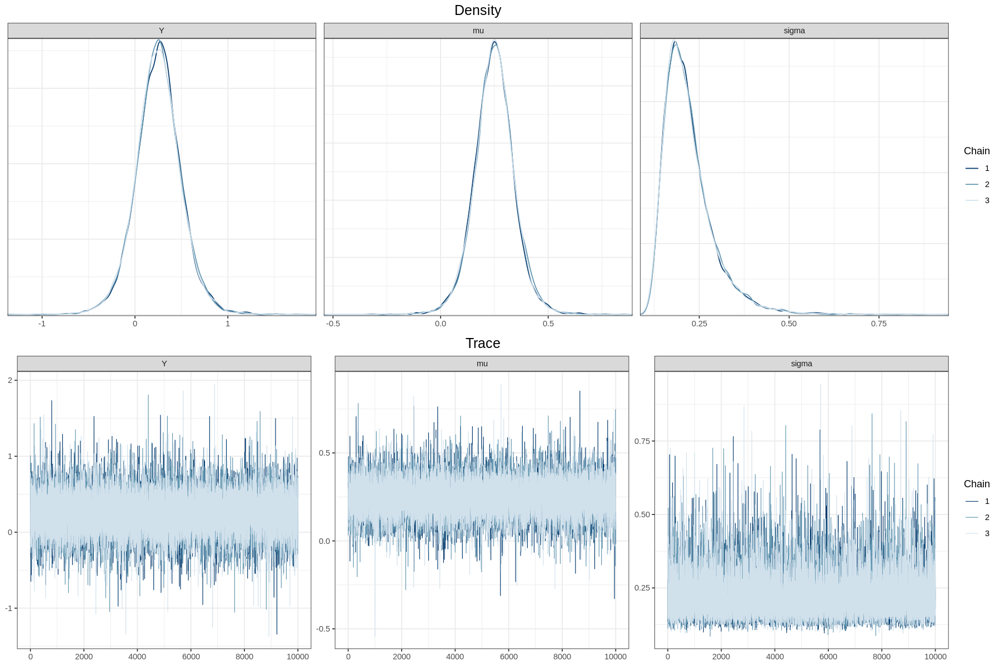

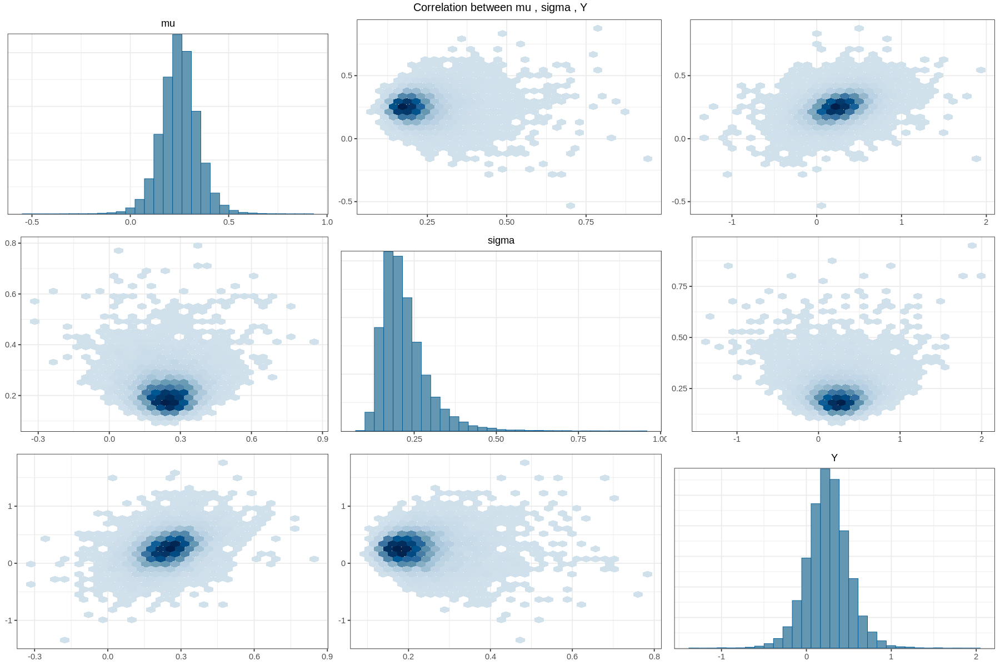

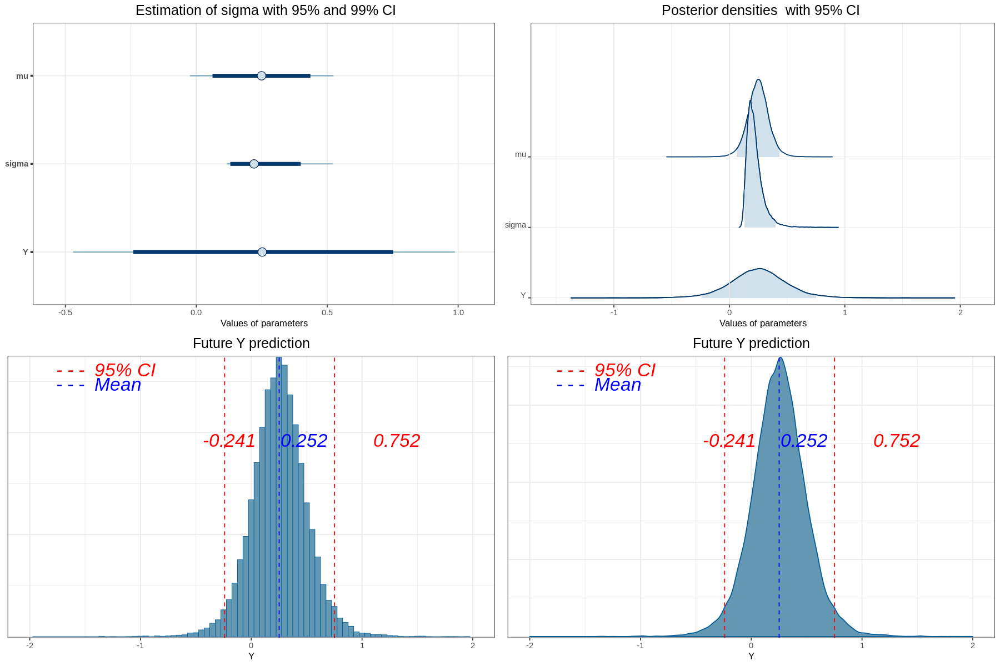

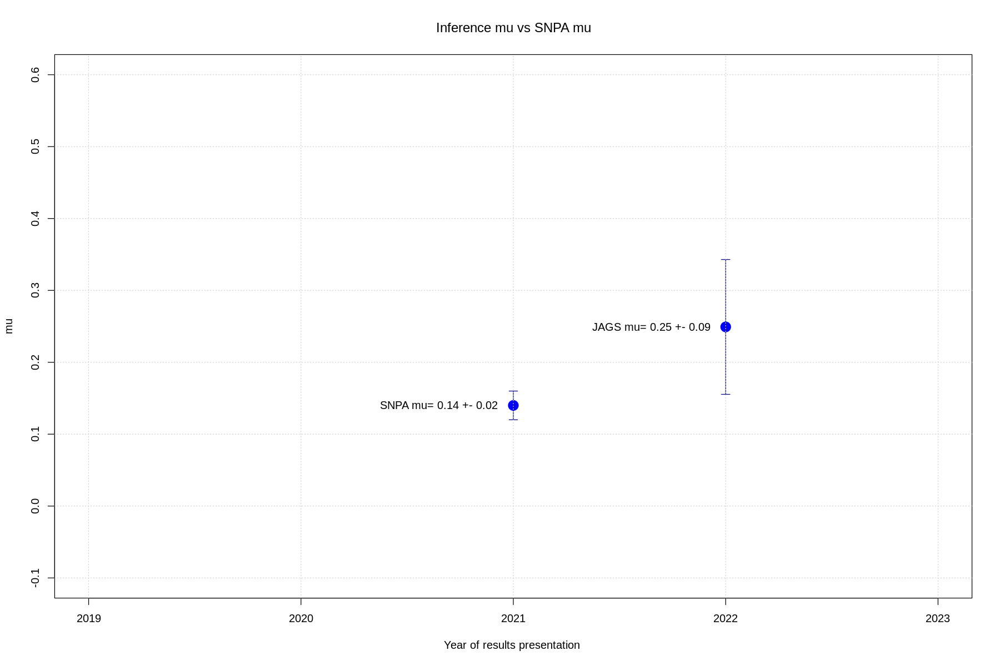

In [36]:
jags_max_min(df2p_3,columns=c("Min_Temperature_diff"),0.14,0.02)

## DISCUSSION ABOUT MCMC RESULTS


From the MCMC inference  we obtained:
- $ \Delta T_{average} =  0.26 \pm   0.04  \frac{°C}{4Y}$ 
- $ \Delta T_{max} =  0.3 \pm   0.1 \frac{°C}{4Y} $ 
- $ \Delta T_{min} =  0.25 \pm   0.09 \frac{°C}{4Y} $ 

We can also se that the inference value of $\mu$ for the difference between average temperature is not compatible with the SNPA's one (it is higher) while the $ \mu $ for the difference between max/min temperature is compatible (it is also higher but within the errorbars)

As regarded the  prevision for the average temperature increasing computed by JAGS, it is  $ \Delta T_{average-prev} =  0.26 \pm   0.1 \frac{°C}{4Y} $  while the SNPA's are $ 0.08 \ \frac{°C}{4Y} $ in the RCP4.5 model and $0.16 \ \frac{°C}{4Y} $  in the RCP8.5 model.
So the inference prevision is higher as the inferenced  $ \mu $ as-well compared to SNPA's results.\
There could be  several explanation for this, for example:
- our dataset are different from the SNPA's ones
- they analysed data from all over the country while ours are just from a few cities
- their amount of data is different from ours
- they analysed the data in a different way


Although these differences, there is a worrying increasing of the temperature over the years.

## FORECAST PREVISION

In order to make another future prevision about the difference between the average temperature we decided to perform a Forecast prevision.

The R package forecast provides methods and tools for displaying and analysing univariate time series forecasts including exponential smoothing via state space models and automatic ARIMA modelling.

The ARIMA is the equivalent for "linear regression" or "classical model" in time series where data is not-stationary. In particular it is based on 3 parameters:
-  $p$,  that represents the number of inputs (time data) used to predict the next values
-  $q$ , that represents the order of the moving-average model
- $d$, that represent the number of times the data have had past values subtracted

In this prediction we set $p=3, \ q=0, \ d=1$. The decision of these 3 values is based on the lowest AICc value in the ARIMA fit.

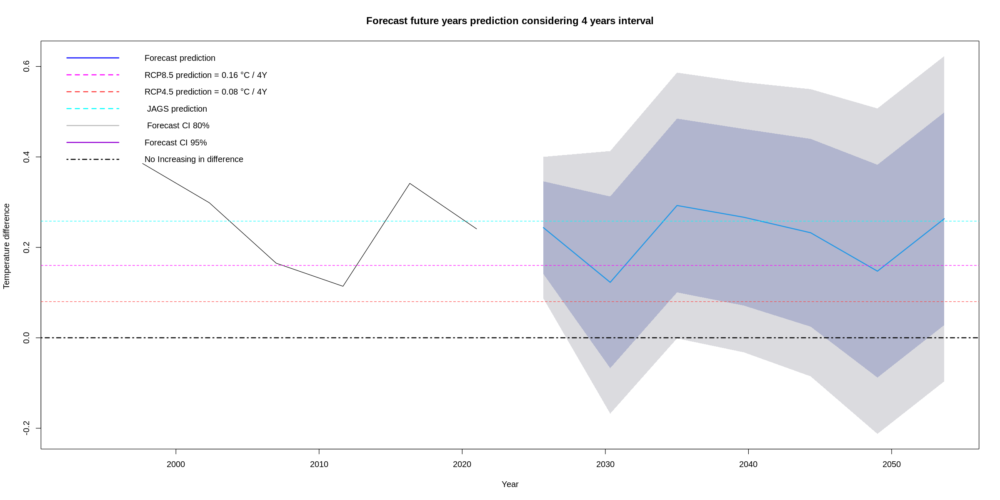

In [37]:
forecast_<- function(df21,columns,mean_f) 
    {
    #plot settings
    options(repr.plot.width = 20, repr.plot.height =10)
    
    #get time series as ts object
    difference_monthly<-ts(df21[,columns],start=c(1993),frequency=0.21425)
  
    #using arima to fit 
    fit_ARIMA<-Arima(difference_monthly,order=c(3,0,1))

    
    #using forecast to forecast
    fcast<-forecast(fit_ARIMA,h=7)

    
    #plot
    plot(fcast,
         type="l",
         ylab="Temperature difference ",
         xlab="Year",
    main="Forecast future years prediction considering 4 years interval")
    abline(h=0.08,col="brown1",lty=2)
    abline(h=0.16,col="magenta",lty=2)
    abline(h=0,col="black",lty=4,lwd=2)
     abline(h=mean_f,col="cyan",lty=2)

    legend(x = "topleft",
       col = c("blue", "magenta","brown1","cyan","grey","darkviolet","black"),
       lty = c(1,2,2,2,1,1,4),
       lwd = c(2,2,2,2,2,2,2),
       cex=1,
       bty="n",
       legend = c('Forecast prediction', 'RCP8.5 prediction = 0.16 °C / 4Y ', "RCP4.5 prediction = 0.08 °C / 4Y ", " JAGS prediction"," Forecast CI 80%","Forecast CI 95%","No Increasing in difference"))

    
    
   }

forecast_(df2p_3,columns=c("Means_measure_diff"),0.258)


As shown in the graphs the Forecast prediction is not stationary but it's always above 0.0 $\frac{°C}{4Y}$.

In particular it fluctuates around the JAGS prediction and for some years it is includeded between the 2 SNPA's predictions.

## CONCLUSIONS OF PART 2

So in this part we have:
- performed some MCMC simulations and  inferred how much the average, max and min temperatures increased in the last 28 years and showhn that there is an increase.
- we noticed that our inference is greater than the SNPA's results and we tried to find some explanation to justify it
- performed some prediction about the future increase as with JAGS as with Forecast and compared it with SNPA's predictions.

# ANALYSIS OF PRECIPITATIONS

## FORECAST EXPLAINED USING PRECIPITATION DATA

In [5]:
Precip <- read.xlsx("./Dati/Cavanis/Cavanis_precipitazioni_1900_2021_mod.xlsx", skipEmptyRows = FALSE)
Precip = as_tibble(Precip)
Precip$data <- as.Date("1899-12-31") + Precip$data
Precip<-data.frame("Date"=Precip$data, "Rainfall"=Precip$P12)
Precip$Year = lubridate::year(Precip$Date)
Precip$Month = lubridate::month(Precip$Date)
Precip$Week = lubridate::week(Precip$Date)
Precip$Day_number=lubridate::yday(Precip$Date)
Precip <- head(Precip, -1)

Precip_pre <- Precip[Precip$Year <= 2000,]   #Dataframe containing precipitations data before 2000
Precip_post <- Precip[Precip$Year > 2000,]   #Dataframe containing precipitations data between 2001 and 2021

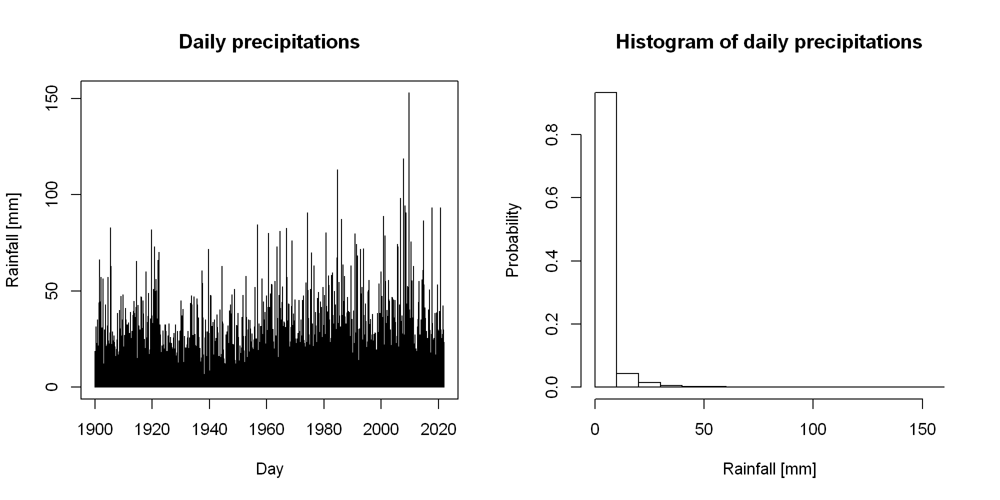

In [6]:
hist_info <- hist(Precip$Rainfall, plot = FALSE)                # Store output of hist function
hist_info$density <- hist_info$counts / sum(hist_info$counts)   # Compute density values

options(repr.plot.width=10, repr.plot.height=5, repr.plot.res = 200)
layout(matrix(c(1,2), nrow = 1, ncol = 2, byrow = TRUE))
plot(Precip$Date, Precip$Rainfall, type='l', xlab="Day", ylab="Rainfall [mm]", main='Daily precipitations')
plot(hist_info, freq = FALSE, xlab="Rainfall [mm]", ylab="Probability", main='Histogram of daily precipitations')

In [7]:
#Monthly sum of precipitations
Precip_ms <- aggregate(cbind(Precip$Rainfall), by=list("Month"=Precip$Month, "Year"=Precip$Year), FUN="sum")
colnames(Precip_ms)[3] <- c("Rainfall_month_sum")
Precip_ms$Date = paste(Precip_ms$Month, "/", Precip_ms$Year)
Precip_ms$Date = format(lubridate::parse_date_time(Precip_ms$Date, orders = c("m / Y")), "%m-%Y")
Precip_ms_pre <- Precip_ms[Precip_ms$Year <= 2000,]
Precip_ms_post <- Precip_ms[Precip_ms$Year > 2000,]

#Monthly average of precipitations
Precip_ma = aggregate(cbind(Precip$Rainfall), by=list("Month"=Precip$Month, "Year"=Precip$Year), FUN="mean")
colnames(Precip_ma)[3] <- c("Rainfall_month_average")
Precip_ma$Date = paste(Precip_ma$Month, "/", Precip_ma$Year)
Precip_ma$Date = format(lubridate::parse_date_time(Precip_ma$Date, orders = c("m / Y")), "%m-%Y")
Precip_ma_pre <- Precip_ma[Precip_ma$Year <= 2000,]
Precip_ma_post <- Precip_ma[Precip_ma$Year > 2000,]

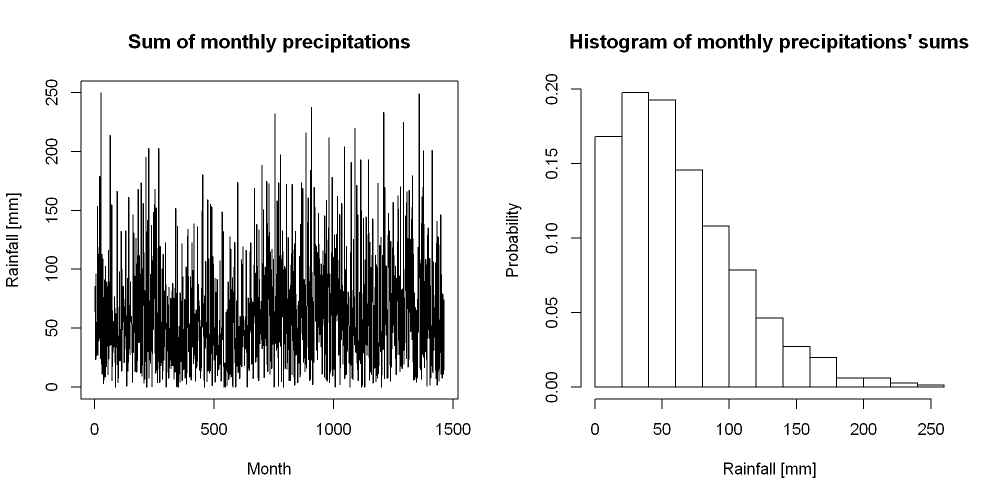

In [8]:
hist_info_ms <- hist(Precip_ms$Rainfall_month_sum, plot = FALSE)         # Store output of hist function
hist_info_ms$density <- hist_info_ms$counts / sum(hist_info_ms$counts)   # Compute density values

options(repr.plot.width=10, repr.plot.height=5, repr.plot.res = 200)
layout(matrix(c(1,2), nrow = 1, ncol = 2, byrow = TRUE))
plot(seq(1, length(Precip_ms$Rainfall_month_sum)), Precip_ms$Rainfall_month_sum, type='l', xlab="Month", ylab="Rainfall [mm]", 
     main='Sum of monthly precipitations')
plot(hist_info_ms, freq = FALSE, xlab="Rainfall [mm]", ylab="Probability", main='Histogram of monthly precipitations\' sums') 

In [9]:
#Yearly sum of precipitations
Precip_ys <- aggregate(cbind(Precip$Rainfall), by=list("Year"=Precip$Year), FUN="sum")
colnames(Precip_ys)[2] <- c("Rainfall_year_sum")
Precip_ys_pre <- Precip_ys[Precip_ys$Year <= 2000,]
Precip_ys_post <- Precip_ys[Precip_ys$Year > 2000,]

#Yearly average of precipitations
Precip_ya = aggregate(cbind(Precip$Rainfall), by=list("Year"=Precip$Year), FUN="mean")
colnames(Precip_ya)[2] <- c("Rainfall_year_average")
Precip_ya_pre <- Precip_ya[Precip_ya$Year <= 2000,]
Precip_ya_post <- Precip_ya[Precip_ya$Year > 2000,]

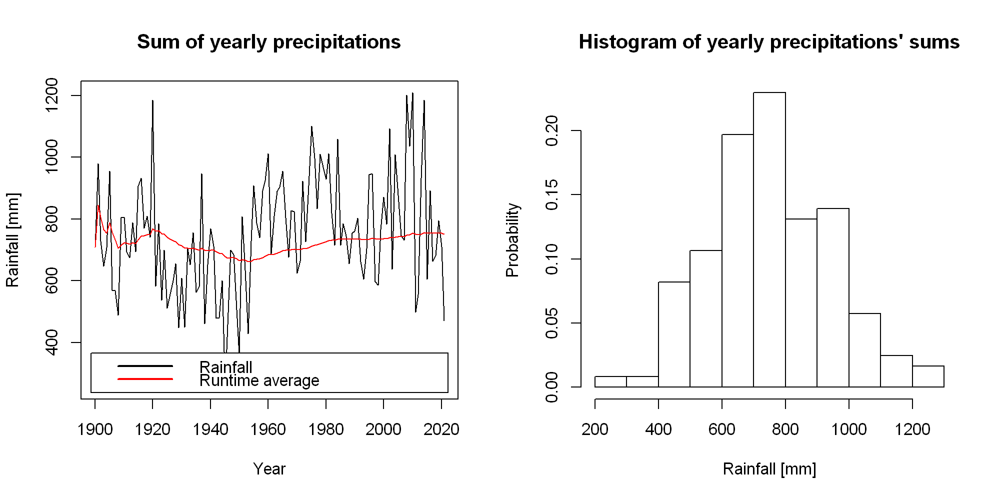

In [10]:
runtime_means <- c(Precip_ys$Rainfall_year_sum[1])
for (j in seq(2, length(Precip_ys$Rainfall_year_sum))) {
    runtime_means <- c(runtime_means, mean(Precip_ys$Rainfall_year_sum[1:j]))
}

hist_info_ys <- hist(Precip_ys$Rainfall_year_sum, plot = FALSE)          # Store output of hist function
hist_info_ys$density <- hist_info_ys$counts / sum(hist_info_ys$counts)   # Compute density values

options(repr.plot.width=10, repr.plot.height=5, repr.plot.res = 200)
layout(matrix(c(1,2), nrow = 1, ncol = 2, byrow = TRUE))
plot(Precip_ys$Year, Precip_ys$Rainfall_year_sum, type='l', xlab="Year", ylab="Rainfall [mm]", 
     main='Sum of yearly precipitations')
lines(Precip_ys$Year, runtime_means, col='red')
legend(x = "bottom", legend = c("Rainfall", "Runtime average"), lty = c(1, 1), col = c('black', 'red'), lwd = 2, 
       inset = 0.02)
plot(hist_info_ys, freq = FALSE, xlab="Rainfall [mm]", ylab="Probability", main='Histogram of yearly precipitations\' sums')   

From above plots, yearly sum of precipitations seems to be a non seasonal time series (the seasonal component may instead appear if we considered, for example, monthly sum of precipitations), thus not repeating itself periodically with a similar pattern.
Moreover it could be considered as stationary since its runtime mean remains more or less constant over time.  

A not seasonal time series consists of a fluctuating component and a trend component, which is interesting to estimate in order, for example, to investigate wether every year it rain less than the year before. 

We first use a smoothing function that calculates the simple moving average (SMA) of the timeseries, to remove the noisy part expliciting the main trend of the data. 

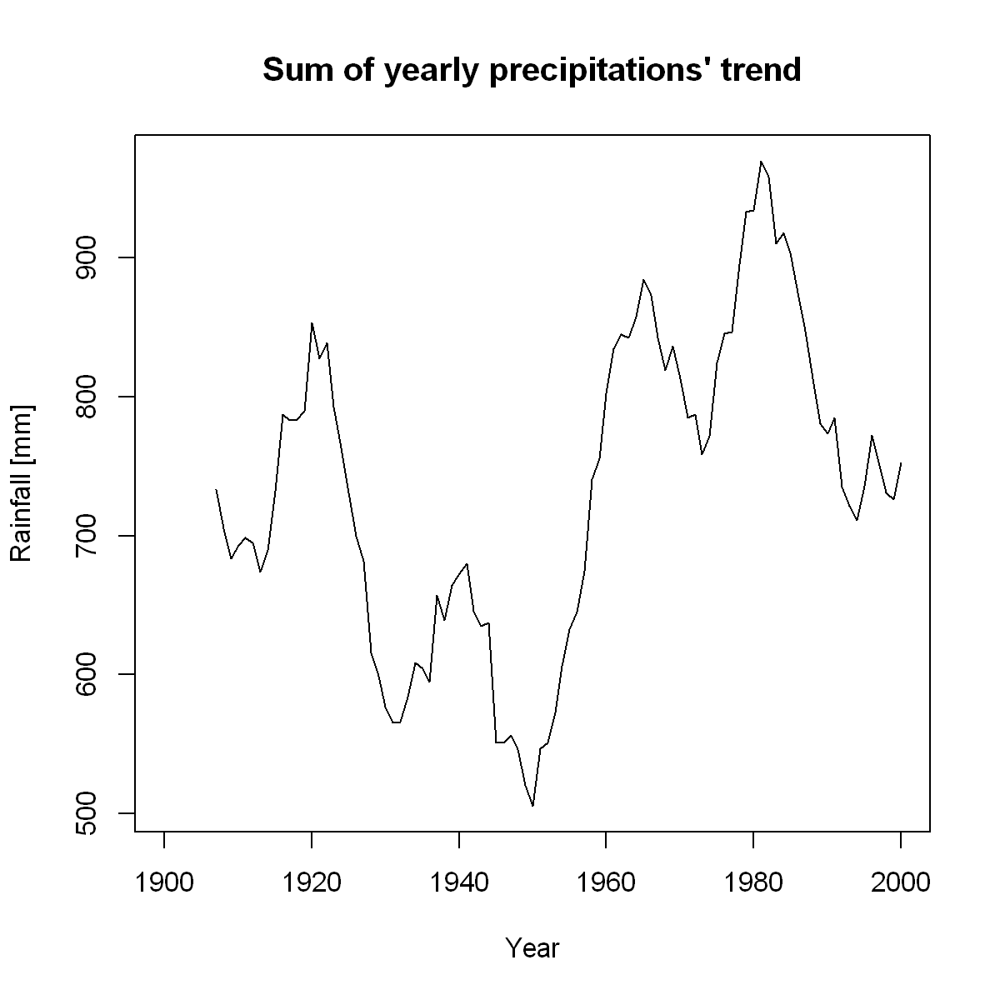

In [11]:
Precseries <- ts(Precip_ys_pre$Rainfall_year_sum, start=c(1900))

Precip_SMA6 <- SMA(Precseries, n=8)

options(repr.plot.width=6, repr.plot.height=6, repr.plot.res = 200)
plot.ts(Precip_SMA6, xlab="Year", ylab="Rainfall [mm]", main='Sum of yearly precipitations\' trend')

### SIMPLE EXPONENTIAL SMOOTHING ASSUMING NO TREND

Holt-Winters algorithm is a time series forecasting method that allows to make forecasts on areas of interest. In particular, this algorithm uses the so called simple exponential smoothing; a technique that, accepts different input parameters, depending on the characteristics of the time series. 

$\alpha$ is a smoothing parameter. Its value lies between 0 and 1. When alpha is closer to 0 then we talk about a slow learning process, since the algorithm is giving more weight to the historical data. Instead, if the value of alpha is closer to 1 then we talk about fast learning, since the algorithm is giving the recent observations or data more weight.

$\beta$ is a trend parameter. Higher beta means the trend slope is more dependent on recent trend slopes. 

$\gamma$ is the seasonal component and can be omitted when, as in our case we do not deal with seasonal time series. In general higher gamma puts more weight on the most recent seasonal cycles.

In [12]:
Precforecast <- HoltWinters(Precseries, beta=FALSE, gamma=FALSE, l.start=Precseries[1])
Precforecast

Holt-Winters exponential smoothing without trend and without seasonal component.

Call:
HoltWinters(x = Precseries, beta = FALSE, gamma = FALSE, l.start = Precseries[1])

Smoothing parameters:
 alpha: 0.2441226
 beta : FALSE
 gamma: FALSE

Coefficients:
      [,1]
a 763.4168

In [13]:
head(Precforecast$fitted)

,xhat,level
1901,708.8000,708.8000
1902,774.8840,774.8840
1903,763.6094,763.6094
1904,735.2645,735.2645
1905,728.4621,728.4621
1906,783.8628,783.8628


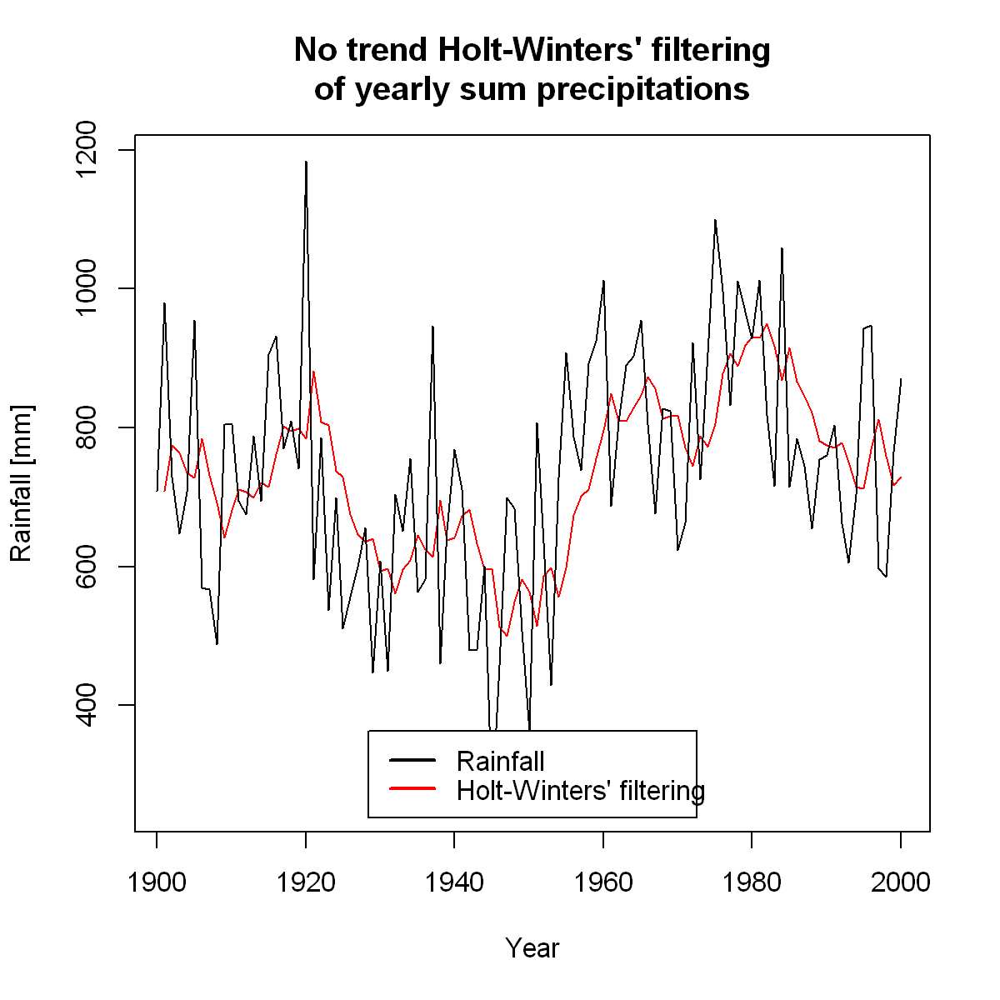

In [14]:
options(repr.plot.width=6, repr.plot.height=6, repr.plot.res = 200)
plot(Precforecast, xlab="Year", ylab="Rainfall [mm]", main='No trend Holt-Winters\' filtering\nof yearly sum precipitations')
legend(x = "bottom", legend = c("Rainfall", "Holt-Winters\' filtering"), lty = c(1, 1), col = c('black', 'red'), lwd = 2, 
       inset = 0.02)

In [15]:
cat("Sum of the squared differences between observed and predicted values: ", Precforecast$SSE)

Sum of the squared differences between observed and predicted values:  2434393

The forecast.HoltWinters() function gives the forecast for given nuber of years and 80% and 95% prediction intervals for the forecast.

In [16]:
Precforecast2 <- forecast:::forecast.HoltWinters(Precforecast, h=21)
Precforecast2

     Point Forecast    Lo 80     Hi 80    Lo 95    Hi 95
2001       763.4168 562.4755  964.3581 456.1036 1070.730
2002       763.4168 556.5745  970.2591 447.0788 1079.755
2003       763.4168 550.8373  975.9964 438.3045 1088.529
2004       763.4168 545.2509  981.5828 429.7608 1097.073
2005       763.4168 539.8039  987.0297 421.4305 1105.403
2006       763.4168 534.4866  992.3470 413.2983 1113.535
2007       763.4168 529.2900  997.5436 405.3508 1121.483
2008       763.4168 524.2063 1002.6274 397.5758 1129.258
2009       763.4168 519.2283 1007.6053 389.9628 1136.871
2010       763.4168 514.3499 1012.4838 382.5018 1144.332
2011       763.4168 509.5651 1017.2685 375.1842 1151.649
2012       763.4168 504.8690 1021.9647 368.0020 1158.832
2013       763.4168 500.2566 1026.5771 360.9479 1165.886
2014       763.4168 495.7236 1031.1100 354.0154 1172.818
2015       763.4168 491.2662 1035.5675 347.1983 1179.635
2016       763.4168 486.8806 1039.9531 340.4911 1186.343
2017       763.4168 482.5634 10

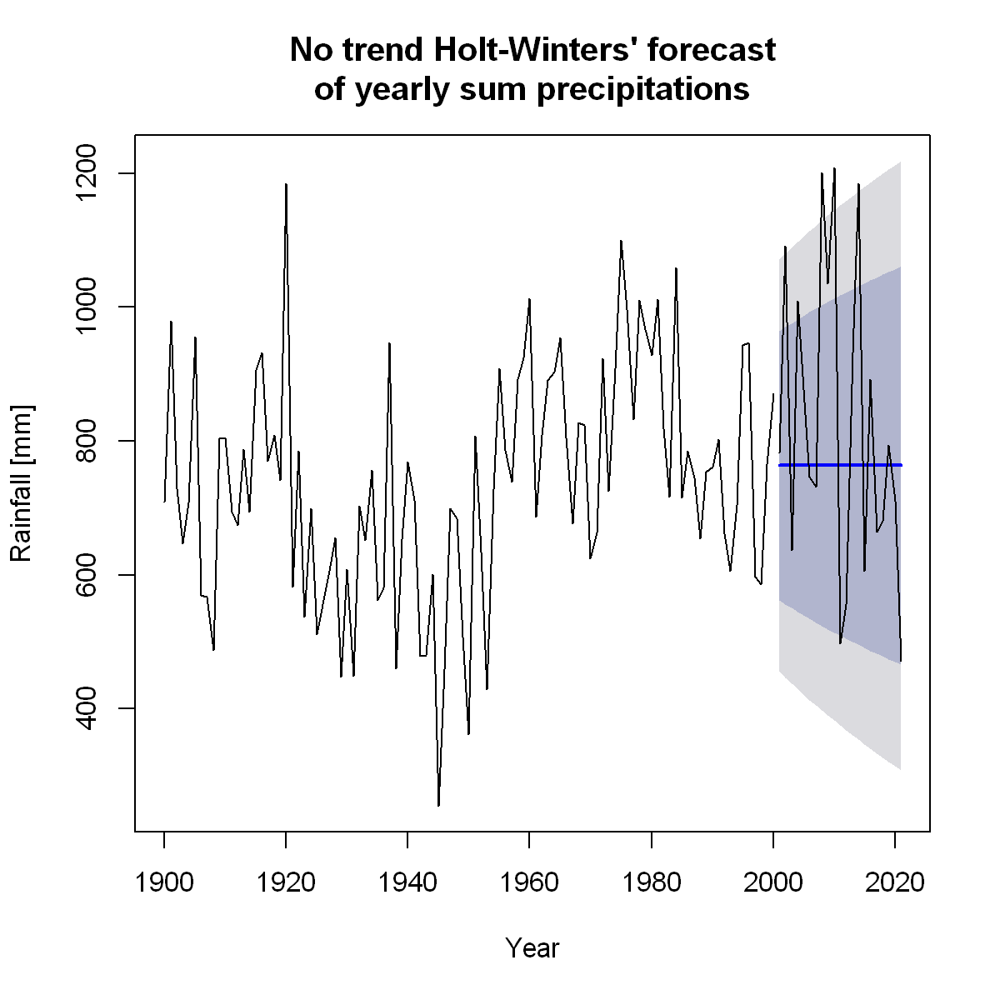

In [17]:
options(repr.plot.width=6, repr.plot.height=6, repr.plot.res = 200)
forecast:::plot.forecast(Precforecast2, xlab="Year", ylab="Rainfall [mm]", 
                         main='No trend Holt-Winters\' forecast\nof yearly sum precipitations')
lines(Precip_ys_post)

### SIMPLE EXPONENTIAL SMOOTHING ASSUMING TREND

In [18]:
Precforecast_t <- HoltWinters(Precseries, gamma=FALSE, l.start=Precseries[1])
Precforecast_t

Holt-Winters exponential smoothing with trend and without seasonal component.

Call:
HoltWinters(x = Precseries, gamma = FALSE, l.start = Precseries[1])

Smoothing parameters:
 alpha: 0.4182805
 beta : 0.4603783
 gamma: FALSE

Coefficients:
       [,1]
a 764.29534
b  13.97835

In [19]:
head(Precforecast_t$fitted)

,xhat,level,trend
1902,979.5000,708.8000,270.70000
1903,1096.9994,874.5953,222.40413
1904,1044.8278,908.9826,135.84527
1905,974.5561,903.6884,70.86772
1906,1033.7224,966.5435,67.17889
1907,817.1488,839.4217,-22.27290


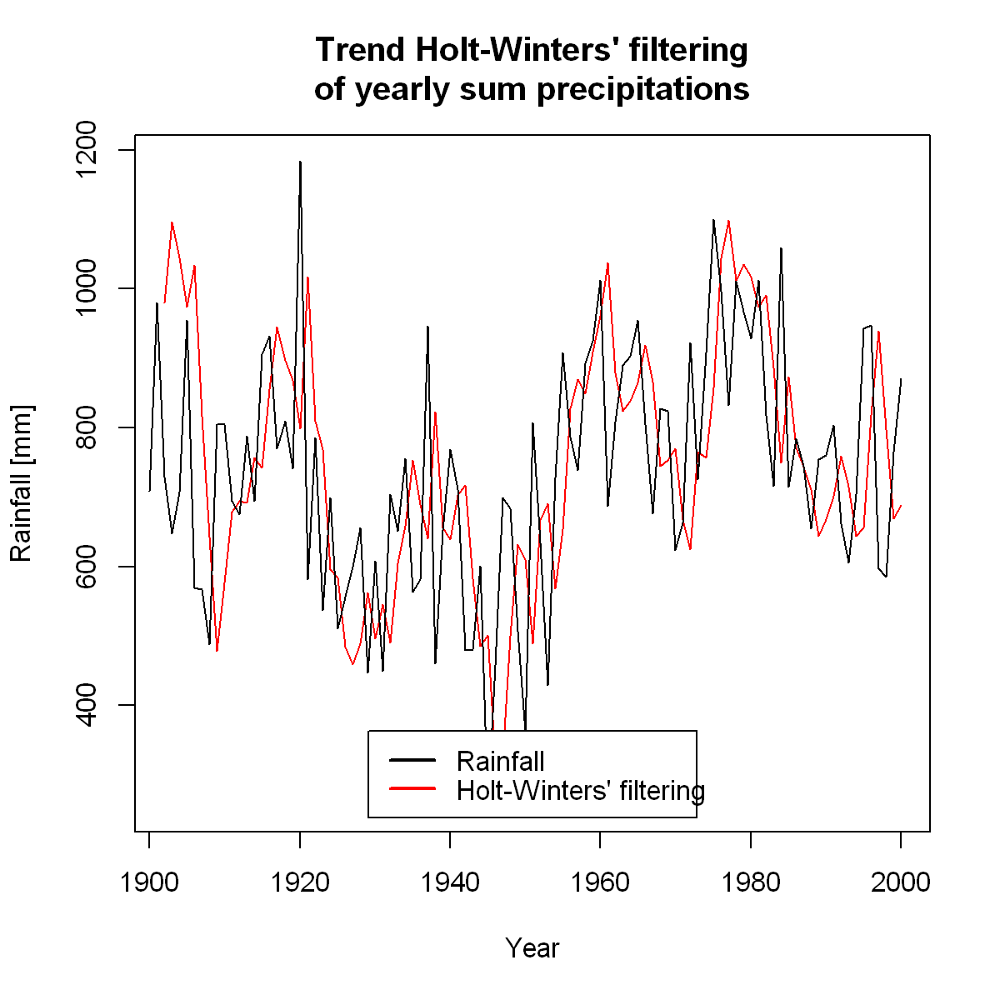

In [20]:
options(repr.plot.width=6, repr.plot.height=6, repr.plot.res = 200)
plot(Precforecast_t, xlab="Year", ylab="Rainfall [mm]", main='Trend Holt-Winters\' filtering\nof yearly sum precipitations')
legend(x = "bottom", legend = c("Rainfall", "Holt-Winters\' filtering"), lty = c(1, 1), col = c('black', 'red'), lwd = 2, 
       inset = 0.02)

In [21]:
cat("Sum of the squared differences between observed and predicted values: ", Precforecast_t$SSE)

Sum of the squared differences between observed and predicted values:  3509562

In [22]:
Precforecast2_t <- forecast:::forecast.HoltWinters(Precforecast_t, h=21)
Precforecast2_t

     Point Forecast       Lo 80    Hi 80       Lo 95    Hi 95
2001       778.2737   536.37369 1020.174   408.31957 1148.228
2002       792.2520   508.79159 1075.712   358.73669 1225.767
2003       806.2304   462.54415 1149.917   280.60765 1331.853
2004       820.2087   400.48671 1239.931   178.29930 1462.118
2005       834.1871   325.43504 1342.939    56.11798 1612.256
2006       848.1654   239.52252 1456.808   -82.67357 1779.004
2007       862.1438   144.25869 1580.029  -235.76672 1960.054
2008       876.1221    40.71395 1711.530  -401.52443 2153.769
2009       890.1005   -70.33143 1850.532  -578.75337 2358.954
2010       904.0788  -188.28862 1996.446  -766.55301 2574.711
2011       918.0572  -312.69794 2148.812  -964.22033 2800.335
2012       932.0355  -443.18946 2307.260 -1171.18959 3035.261
2013       946.0139  -579.45761 2471.485 -1386.99342 3279.021
2014       959.9922  -721.24433 2641.229 -1611.23720 3531.222
2015       973.9706  -868.32769 2816.269 -1843.58146 3791.523
2016    

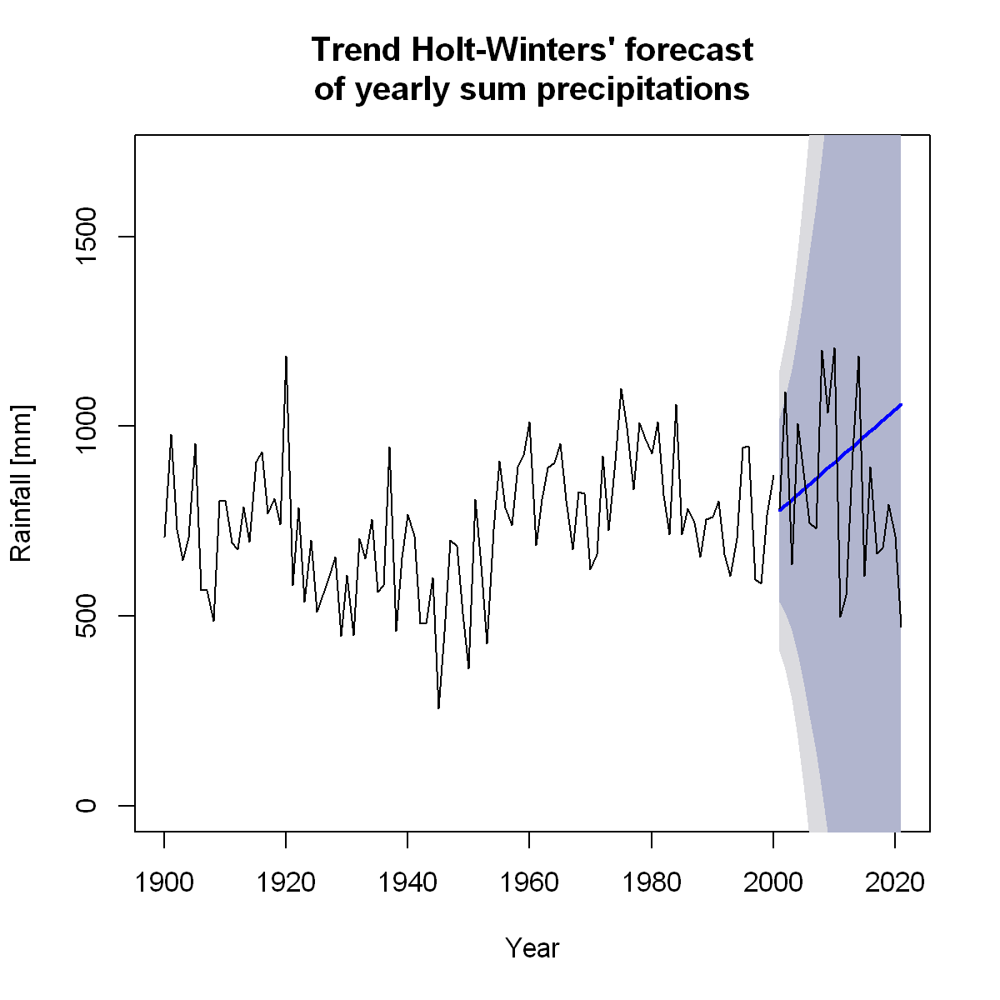

In [23]:
options(repr.plot.width=6, repr.plot.height=6, repr.plot.res = 200)
forecast:::plot.forecast(Precforecast2_t, ylim=c(0, 1700), xlab="Year", ylab="Rainfall [mm]", 
                         main='Trend Holt-Winters\' forecast\nof yearly sum precipitations')
lines(Precip_ys_post)

### ARIMA MODELS

Simple exponential smoothing is a useful method for making forecasts and does not make any assumption on the correlations between successive values of the timeseries. However, in order to make reliable predictions, it requires that the forecast errors are uncorrelated and nomally distributed with zero mean and constant variance.

ARIMA (Autoregressive Integrated Moving Average) models instead include an explicit statistical model for the irregular component of a time series, that allows for non-zero autocorrelations in the irregular component. ARIMA models are defined only for stationary timeseries, that we approximately have. In order to get a perfectly stationary timeseries, we can difference it.

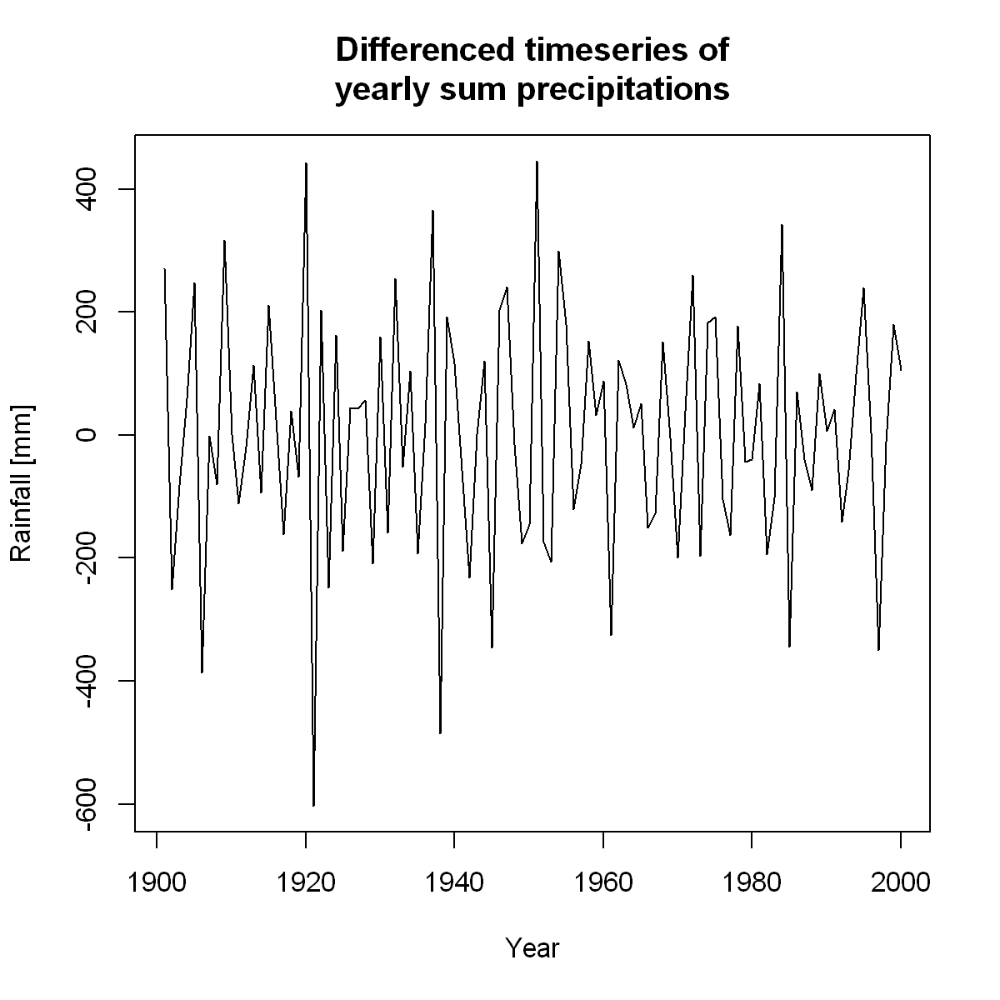

In [24]:
Precdiff <- diff(Precseries, differences=1)
plot.ts(Precdiff, xlab="Year", ylab="Rainfall [mm]", 
                         main='Differenced timeseries of\nyearly sum precipitations')

ARIMA accept as inputs 3 parameters:

- $p$ that represents the number of time data inputs that are used in order to predict the next values;
- $q$ that represents the order of the moving average model;
- $d$ that represent the number of times the data have been differenced.

After differencing the timeseries in order to get it approximately stationary, we have thus to choose candidate values for the two remaining parameters that we have to give in input to ARIMA. In our case $d = 1$ and in order to select some candidates for the remaining parameters, it is necessary to analyze the autocorrelation of the timeseries. 

A function in the forecast library selects automatically the optimal input parameters and returns the output parameters representing the predictive model for making forecasts on future values our precipitations time series. 

In [25]:
Precseriesarima <- auto.arima(Precseries) # fit an ARIMA(3,1,0) model
Precseriesarima

Series: Precseries 
ARIMA(3,1,0) 

Coefficients:
          ar1      ar2      ar3
      -0.7428  -0.6248  -0.3950
s.e.   0.0925   0.1019   0.0927

sigma^2 estimated as 22870:  log likelihood=-642.77
AIC=1293.54   AICc=1293.96   BIC=1303.96

In [26]:
Precforecast_arima <- forecast:::forecast.Arima(Precseriesarima, h=21)
Precforecast_arima

     Point Forecast    Lo 80     Hi 80    Lo 95     Hi 95
2001       684.5696 490.7622  878.3770 388.1667  980.9725
2002       685.8474 485.7337  885.9611 379.7999  991.8949
2003       759.3770 556.1063  962.6477 448.5012 1070.2528
2004       777.3642 565.5363  989.1922 453.4013 1101.3271
2005       717.5542 479.9875  955.1208 354.2273 1080.8810
2006       721.6986 476.0276  967.3696 345.9773 1097.4199
2007       748.8862 496.7845 1000.9879 363.3299 1134.4425
2008       749.7267 488.0351 1011.4182 349.5040 1149.9493
2009       730.4775 456.3608 1004.5941 311.2522 1149.7027
2010       733.5117 451.3283 1015.6951 301.9495 1165.0739
2011       742.9533 453.3048 1032.6019 299.9742 1185.9325
2012       741.6476 443.3797 1039.9155 285.4862 1197.8090
2013       735.5195 428.2949 1042.7441 265.6601 1205.3790
2014       737.1579 422.3207 1051.9952 255.6559 1218.6600
2015       740.2857 418.0709 1062.5005 247.5008 1233.0706
2016       739.3592 409.4590 1069.2595 234.8203 1243.8982
2017       737

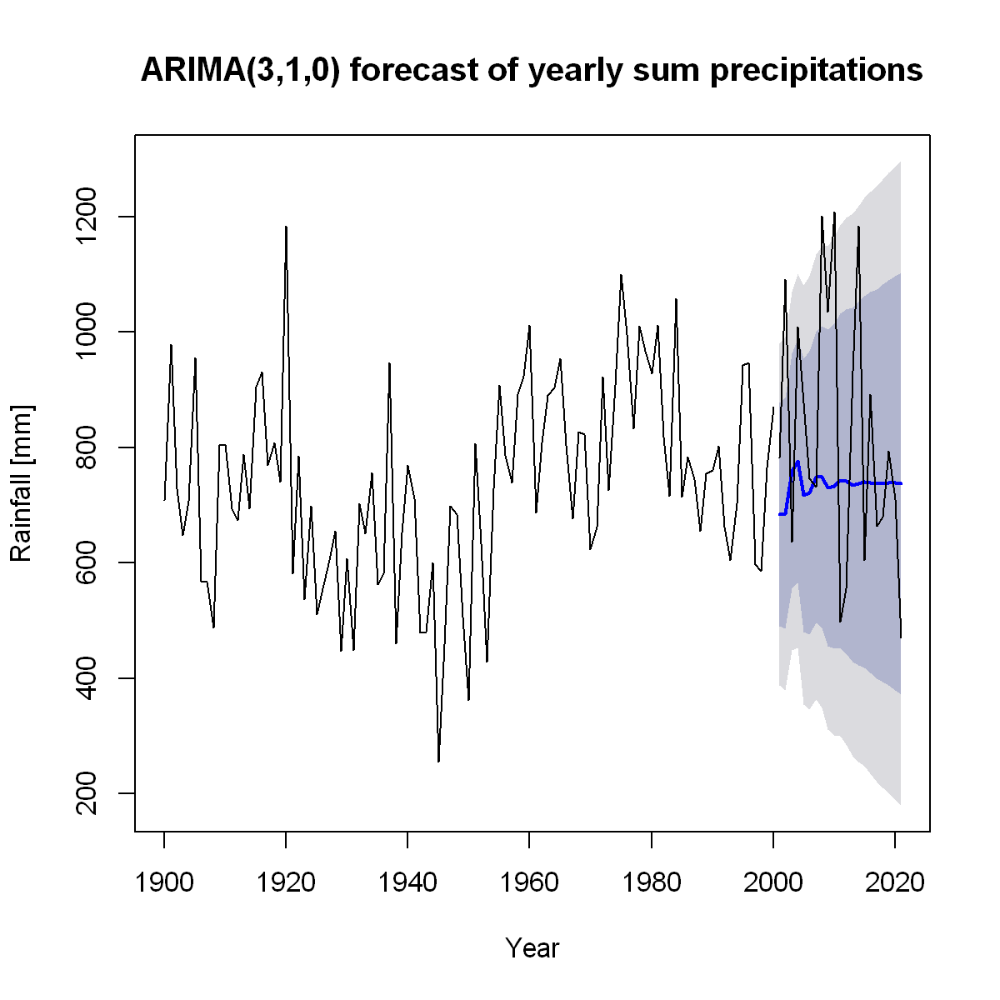

In [27]:
options(repr.plot.width=6, repr.plot.height=6, repr.plot.res = 200)
forecast:::plot.forecast(Precforecast_arima, xlab="Year", ylab="Rainfall [mm]", 
                         main='ARIMA(3,1,0) forecast of yearly sum precipitations')
lines(Precip_ys_post)

## STUDY OF INTENSE EVENTS

The main goal of this part is to analyze the properties of the dataset, with a particular attention to the most intense precipitations, in order to check what is the behaviour of the intense precipitation events with the passing of the years.

In [28]:
zero_precip <- Precip[Precip$Rainfall == 0,]
#zero_precip
strong_precip <- Precip[Precip$Rainfall >= 25,]
#strong_precip

N_zero <- zero_precip %>% group_by(Year) %>% tally()
#N_events
N_strong <- strong_precip %>% group_by(Year) %>% tally()
#N_strong

averaged_years <- 5

N_zero_ave <- data.frame("Years"=seq(1900+averaged_years, 2021+averaged_years, by = averaged_years), 
                                 "average_N"=colMeans(matrix(N_zero$n, nrow=averaged_years)))
N_zero_ave <- head(N_zero_ave, -1)
#head(N_zero_ave)

N_strong_ave <- data.frame("Years"=seq(1900+averaged_years, 2021+averaged_years, by = averaged_years), 
                                 "average_N"=colMeans(matrix(N_strong$n, nrow=averaged_years)))
N_strong_ave <- head(N_strong_ave, -1)
#head(N_strong_ave)

Warning message in matrix(N_zero$n, nrow = averaged_years):
"data length [122] is not a sub-multiple or multiple of the number of rows [5]"
Warning message in matrix(N_strong$n, nrow = averaged_years):
"data length [122] is not a sub-multiple or multiple of the number of rows [5]"


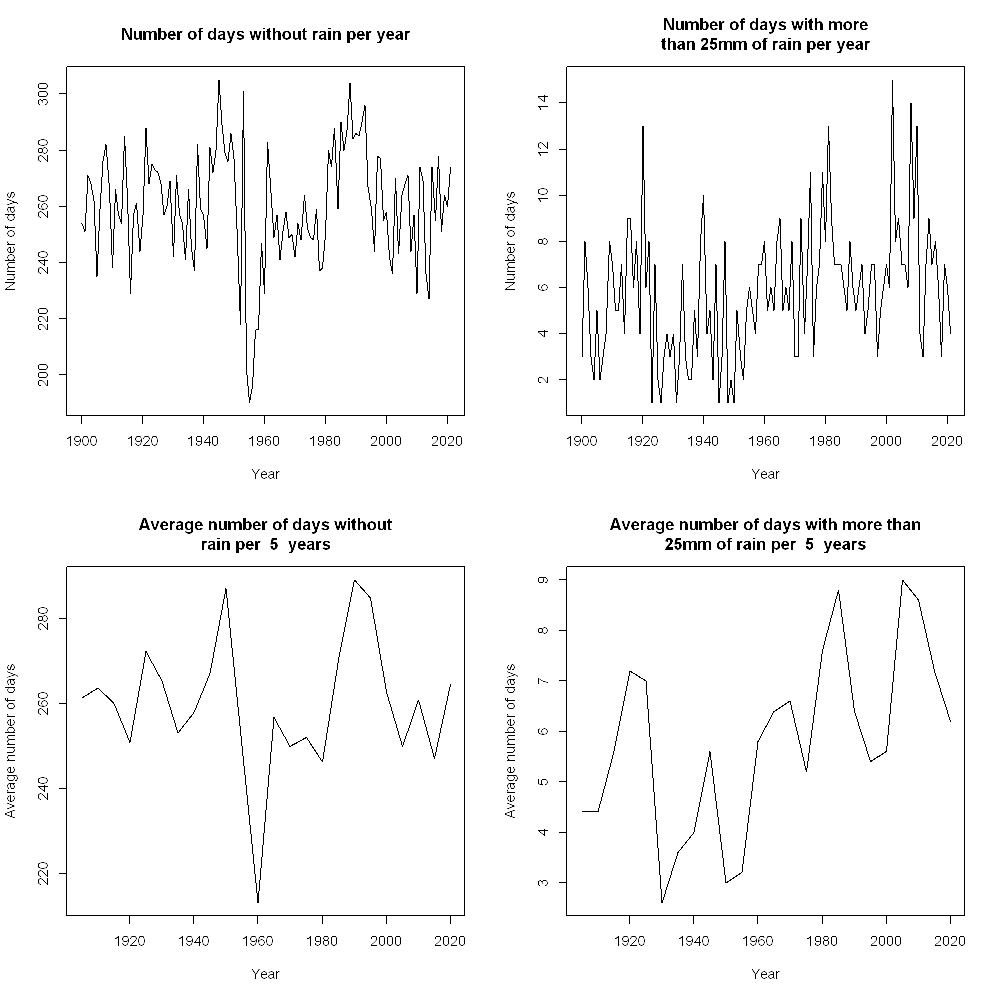

In [29]:
options(repr.plot.width=10, repr.plot.height=10, repr.plot.res = 200)
layout(matrix(c(1,2,3,4), nrow = 2, ncol = 2, byrow = TRUE))
plot(N_zero$Year, N_zero$n, type='l', xlab="Year", ylab="Number of days", 
     main='Number of days without rain per year')
plot(N_strong$Year, N_strong$n, type='l', xlab="Year", ylab="Number of days", 
     main='Number of days with more\nthan 25mm of rain per year')
plot(N_zero_ave$Years, N_zero_ave$average_N, type='l', xlab="Year", ylab="Average number of days", 
     main=paste('Average number of days without\nrain per ', averaged_years, ' years'))
plot(N_strong_ave$Years, N_strong_ave$average_N, type='l', xlab="Year", ylab="Average number of days", 
     main=paste('Average number of days with more than\n25mm of rain per ', averaged_years, ' years'))

Warning message in matrix(Intense_events$Rainfall_year_max, nrow = averaged_years):
"data length [122] is not a sub-multiple or multiple of the number of rows [5]"


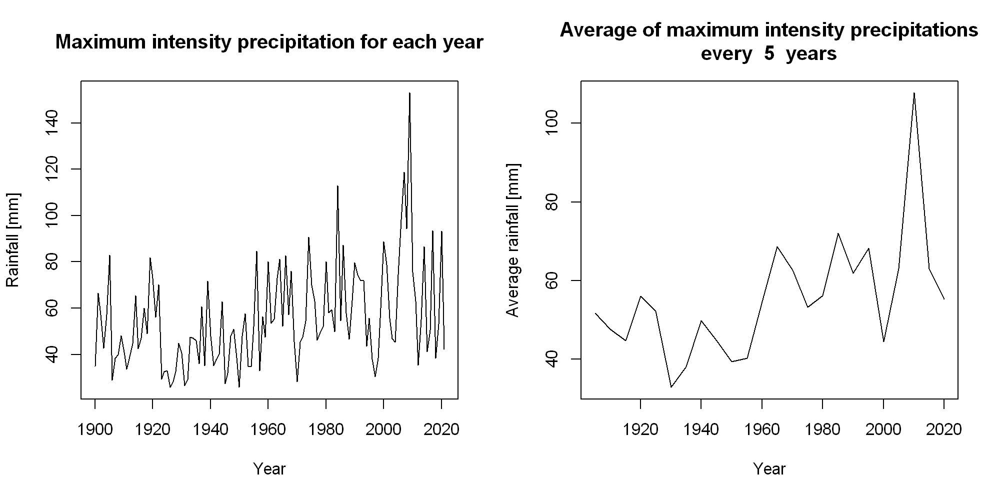

In [30]:
Intense_events <- aggregate(Precip$Rainfall, list("Year"=Precip$Year), FUN='max')
colnames(Intense_events)[2] <- c("Rainfall_year_max")
#head(Intense_events)

averaged_years <- 5
Intense_events_ave <- data.frame("Years"=seq(1900+averaged_years, 2021+averaged_years, by = averaged_years), 
                                 "average_N"=colMeans(matrix(Intense_events$Rainfall_year_max, nrow=averaged_years)))
Intense_events_ave <- head(Intense_events_ave, -1)
#head(Intense_events_ave)

options(repr.plot.width=10, repr.plot.height=5, repr.plot.res = 200)
layout(matrix(c(1,2), nrow = 1, ncol = 2, byrow = TRUE))
plot(Intense_events$Year, Intense_events$Rainfall_year_max, type='l', xlab="Year", ylab="Rainfall [mm]", 
     main='Maximum intensity precipitation for each year')
plot(Intense_events_ave$Years, Intense_events_ave$average_N, type='l', xlab="Year", ylab="Average rainfall [mm]", 
     main=paste('Average of maximum intensity precipitations\nevery ', averaged_years,' years'))

### LINEAR REGRESSION

A Bayesian linear model of the type $y = \alpha + \beta x$ is applied to the data representing the average of maximum precipitations for time windows of five years, in order to evidence a possible trend.

In [31]:
P_data <- with(Intense_events_ave, list(Years = Years, average_N = average_N, N = length(Years)))

In [33]:
bayesian_linear_regression_jags<-function(data)
{ 
    #Model
    mod <- function()
    {

        tau <- 1 / (sigma*sigma) #Precision (1 / variance) - parameter required by R2JAGS model
        # Likelihood: Gaussian distribution around means which are linearly distributed
        for (i in 1:N)
        {
            average_N[i] ~ dnorm(mu[i], tau) 
            mu[i] <- alpha + beta * Years[i] 
        }
        # Priors:
        alpha ~ dnorm(-416, 150) # intercept 
        beta ~ dnorm(0.24, 0.1) # slope 

        sigma ~ dunif(0,5) # standard deviation

    }

    #Initial guess on the parameters  
    init_values <- function()
    {
        list(alpha = -416, beta = 0.24, sigma = 1)   
    }
    params <- c("alpha", "beta", "sigma")

    #MCMC
    set.seed(123)
    fit <- jags(data = data, inits = init_values, parameters.to.save = params, model.file = mod,
                n.chains = 3, n.iter = 12000, n.burnin = 2000, n.thin = 10, DIC = T, quiet=T)

    print(fit)
    
    return(fit)
}

lin_fit <- bayesian_linear_regression_jags(P_data)

Inference for Bugs model at "C:/Users/Sebastiano/AppData/Local/Temp/RtmpUpmoU6/model32b06e96b2f.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
          mu.vect sd.vect     2.5%      25%      50%      75%    97.5%  Rhat
alpha    -416.000   0.082 -416.163 -416.055 -415.999 -415.945 -415.839 1.001
beta        0.240   0.001    0.239    0.240    0.240    0.241    0.241 1.001
sigma       4.960   0.039    4.854    4.945    4.972    4.988    4.999 1.002
deviance  271.159   2.515  268.417  269.378  270.477  272.246  277.973 1.001
         n.eff
alpha     3000
beta      3000
sigma     3000
deviance  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 3.2 and DIC = 274.3
DIC is an estimate of expected predictive error (lower deviance is better).


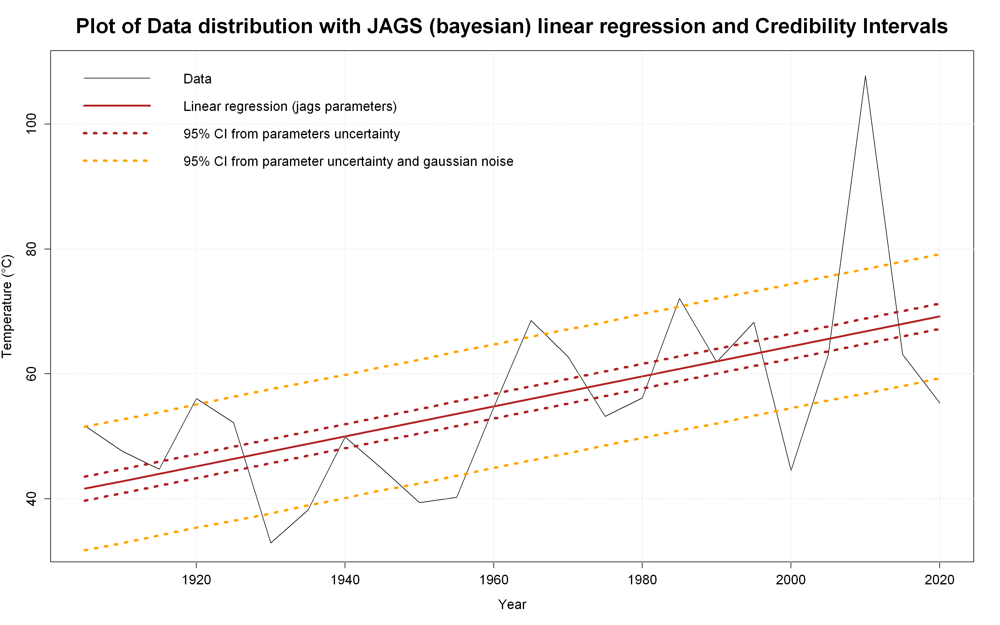

In [35]:
plot_annual_means_with_linear_fit_function<-function(data, fit)

{
    alpha_mcmc<-(fit$BUGSoutput)$mean$alpha[[1]]
    beta_mcmc<-(fit$BUGSoutput)$mean$beta[[1]]

    #Create a new sequence of predictor values (xi)
    nvalues <- 24
    Year_new <- seq(min(data$Years), max(data$Years), length.out = nvalues)
    #Calculate the expected value of temperature for each of the new year values (yi)
    #using the mean posterior values of the model parameters alpha and beta :
    pred_mean_mean <- alpha_mcmc + Year_new * beta_mcmc


    # Determines the upper and lower bounds of this 95% credible interval for each of the 100 years/temperatures:
    niter_cumul <-length(fit$BUGSoutput$sims.list$beta)
    pred_mean_dist <- matrix(NA, nrow = niter_cumul, ncol = nvalues)
    #pred_mean_dist
    alpha_values_mcmc<-fit$BUGSoutput$sims.list$alpha
    beta_values_mcmc<-fit$BUGSoutput$sims.list$beta

    for (i in 1:nrow(pred_mean_dist))
    {  
        pred_mean_dist[i,] <-  alpha_values_mcmc[i]+ Year_new * beta_values_mcmc[i]
        
    }


    credible_lower <- apply(pred_mean_dist, MARGIN = 2, quantile, prob = 0.025)
    credible_upper <- apply(pred_mean_dist, MARGIN = 2, quantile, prob = 0.975)

    
    #95% CI total
    #(due to uncertainty on parameters values AND the gaussian distribution of the y values around the mean (non-zero sigma))

    nsampl<-24
    mcmc <- as.mcmc(fit)
    mcmc_comb <- as.mcmc(rbind(mcmc[[1]], mcmc[[2]], mcmc[[3]]))
    mcmc_comb_rep <- do.call(rbind, rep(list(mcmc_comb), nsampl)) # replication

    # Draw random values for all parameter combinations (rows) and body length values (columns):
    pred_data_dist <- matrix(NA, nrow = nrow(mcmc_comb_rep), ncol = nvalues)
    for (i in 1:nrow(pred_data_dist))
    {
        norm_disp <- rnorm(nvalues, mean = 0, sd = mcmc_comb_rep[i, "sigma"])
        pred_data_dist[i,] <- mcmc_comb_rep[i,"alpha"] + Year_new * mcmc_comb_rep[i,"beta"] + norm_disp
    }

    # Calculate quantiles:
    uncertain_lower <- apply(pred_data_dist, MARGIN = 2, quantile, prob = 0.025)
    uncertain_upper <- apply(pred_data_dist, MARGIN = 2, quantile, prob = 0.975)


    options(repr.plot.width=16, repr.plot.height=10)
    plot(average_N ~ Years, data = data, 
         type="l",
         main = "Plot of Data distribution with JAGS (bayesian) linear regression and Credibility Intervals",
         xlab = "Year",
         ylab = "Temperature (°C)",
         cex.main = 2, cex.lab = 1.3, cex.axis=1.3,
         ylim=c(min(data$average_N), max(data$average_N)+1)
        )

    lines(Year_new, pred_mean_mean, lwd=3,col= "firebrick")
    lines(Year_new, credible_lower, lty = "dotted", lwd=4, col = "firebrick")
    lines(Year_new, credible_upper, lty = "dotted", lwd=4, col="firebrick")
    lines(Year_new, uncertain_lower, lty = "dotted", lwd=4, col = "orange")
    lines(Year_new, uncertain_upper, lty = "dotted", lwd=4, col = "orange")
    grid()
    legend("topleft",
       legend=c("Data", 
                "Linear regression (jags parameters)",
                "95% CI from parameters uncertainty",
                "95% CI from parameter uncertainty and gaussian noise"),
       col=c("black", "firebrick", "firebrick", "orange"),
       lty=c(1,1,3,3),lwd=c(1,3,4,4),cex=1.3 ,
       bty = "n")

    
    return(list(credible_lower,credible_upper))
    
}

trend_plot <-plot_annual_means_with_linear_fit_function(P_data, lin_fit)

## CONCLUSION OF PART 3

In this part we better specified the types of analysis that can be made with the forecast library and the conditions on which we can apply forecast algorithms, exploiting the data on precipitations and verifying the quality of previsions on a "masked" part of the dataset. 

Furthermore we analyzed the most extreme events registered yearly, between 1900 and 2021, showing that the averages of maximum precipitations across 5 years of time are well represented by a linear relation, for which the parameters have been computed through a Markov chain Monte Carlo symulation.  

# FINAL CONCLUSION

We analyzed all the datasets of interest, finding out that in all the locations temperature rises.
In particular, we noticed that the environment of the location affects the amount of increase: in Auronzo (mountain) the average increase is lower than in the other sites (plain and seaside). 
We can hypotize that the morfology of the environment can somehow mitigate the effect: in all the examined locations (except Auronzo) the mean annual temperature growth is higher than the Italy reference value (SNPA).

By analyzing the trend of the most intense events of precipitations we saw that a possible linear trend can describe the data.

# APPENDIX 1

The main results for the temperature trend analysis for the wheather stations of Auronzo, Castelfranco and Roverchiara are shown.

## AURONZO

In [ ]:
file<-"./Dati_temp_progetto/Auronzo.csv"
df<-import_data(file)

### PART 1

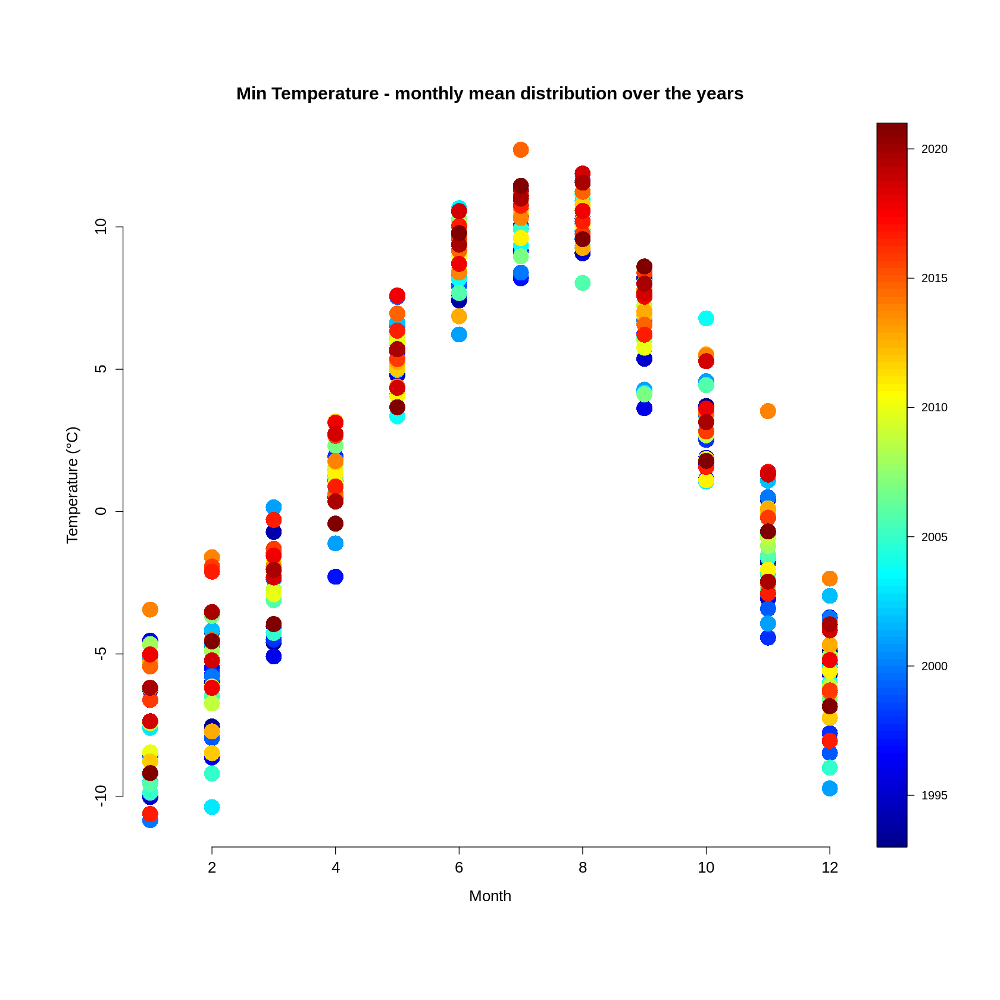

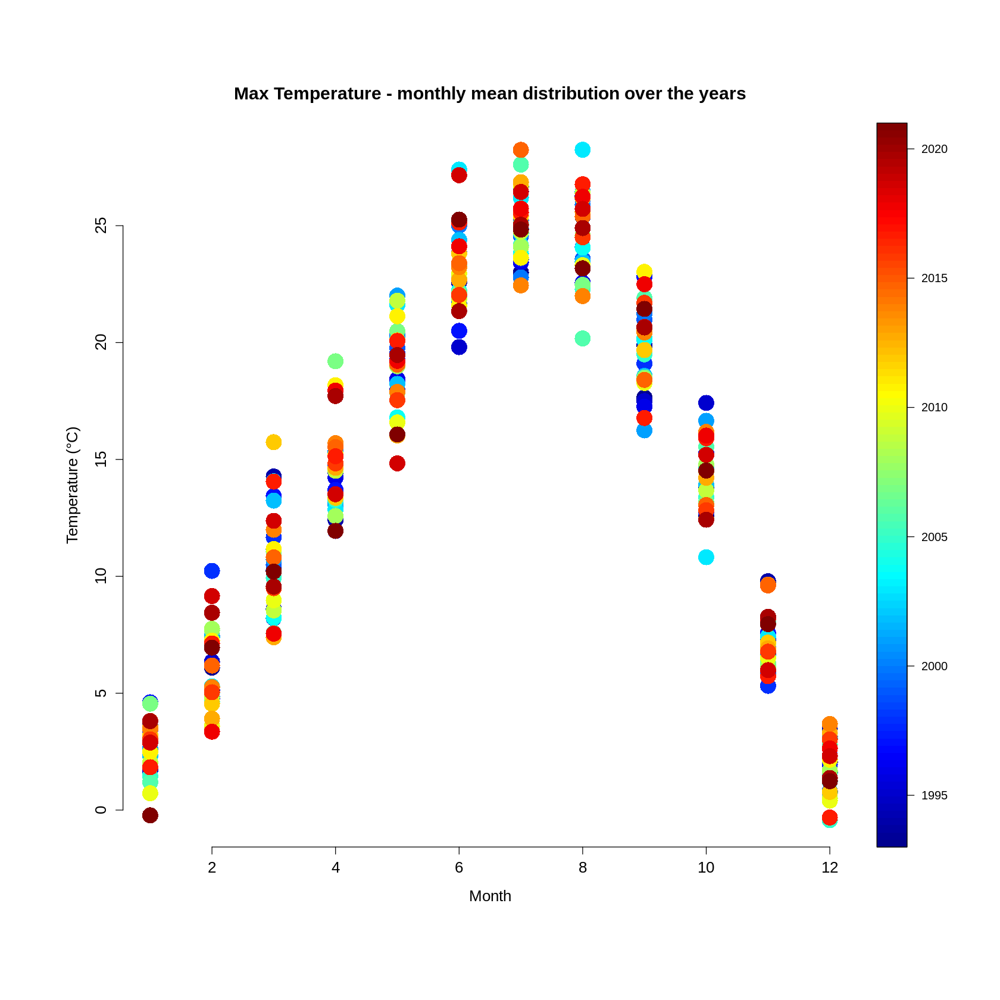

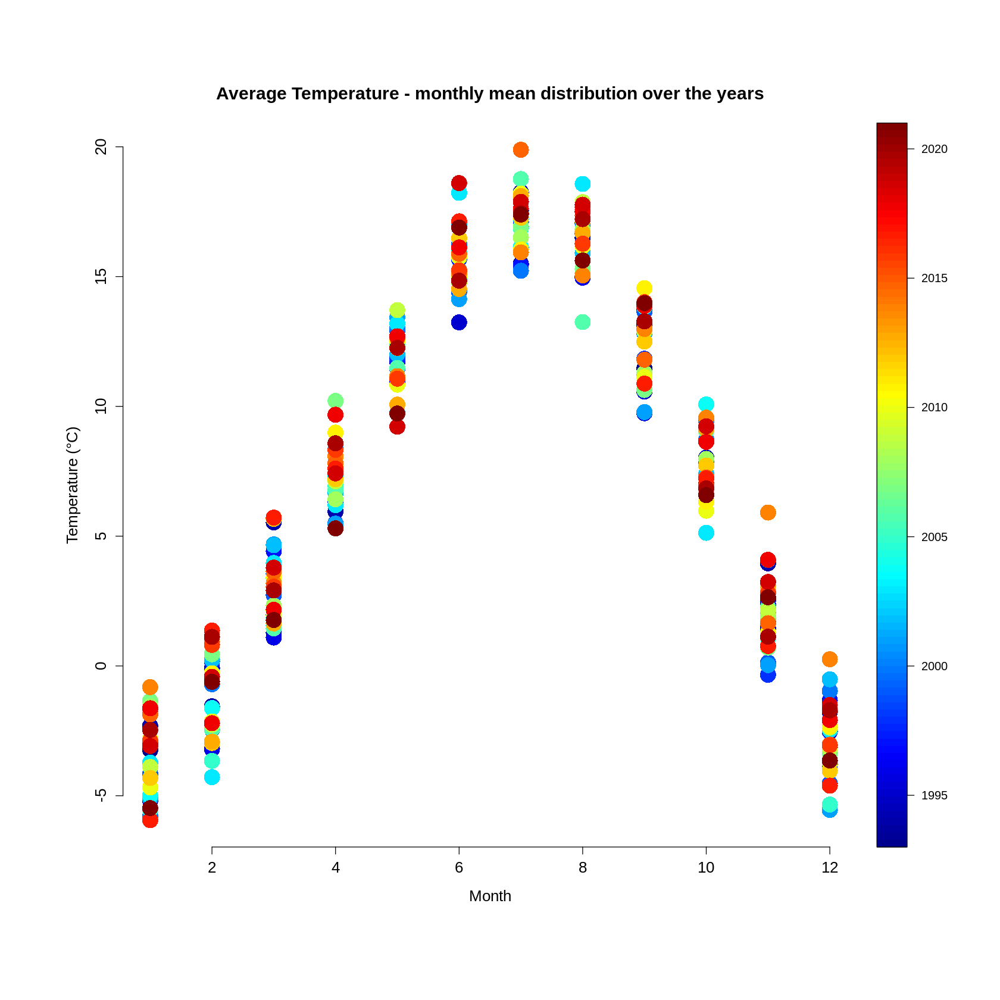

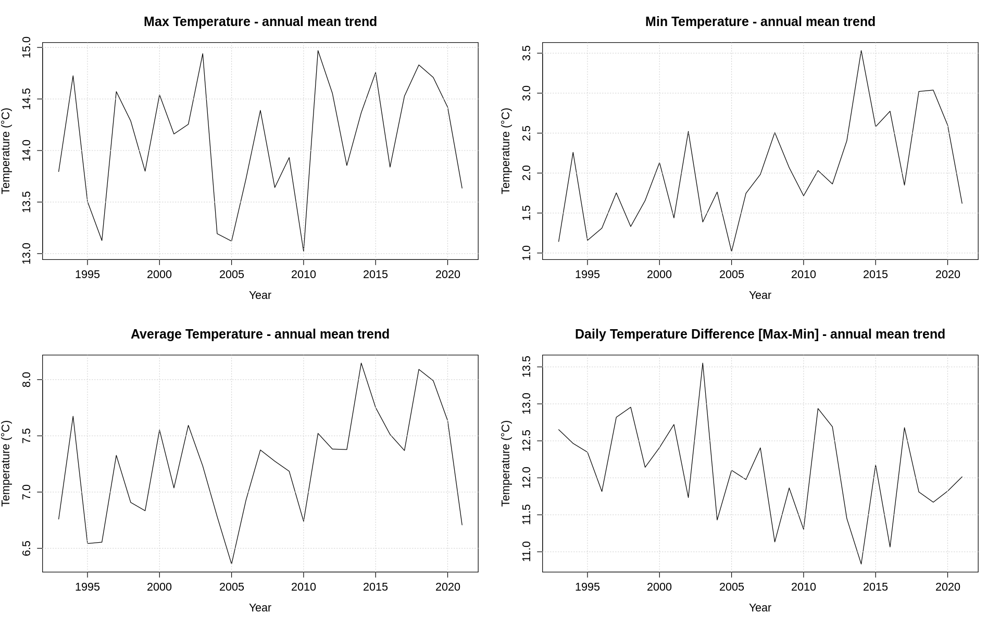

In [41]:
file<-"./Dati_temp_progetto/Auronzo.csv"
df<-import_data(file)
aggregated<-aggregate_data(df)

df1<-aggregated[[1]]
df2<-aggregated[[2]]

preliminary_plots1(df1)
preliminary_plots2(df2)



BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b38ae18282.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%  97.5%  Rhat n.eff
alpha    -33.168  16.818 -66.412 -44.435 -33.067 -22.123  0.060 1.001  2800
beta       0.020   0.008   0.004   0.015   0.020   0.026  0.037 1.001  2800
sigma      0.447   0.064   0.341   0.401   0.440   0.483  0.595 1.001  3000
deviance  33.805   2.755  30.622  31.791  33.112  35.084 40.832 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 3.8 and DIC = 37.6
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = alpha)


Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3885a161f.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha      7.247   0.093  7.061  7.184  7.248  7.308  7.429 1.001  3000
sigma      0.498   0.072  0.381  0.447  0.491  0.540  0.661 1.001  3000
deviance  40.202   2.213 38.047 38.607 39.533 41.028 46.311 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.4 and DIC = 42.7
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 6.19503e-06 
Likelihood linear = 9.761726e-06 
Frequentist likelihood ratio (linear/constant) =  1.58 

Linear model is more suitable than constant!
HYPOTESI

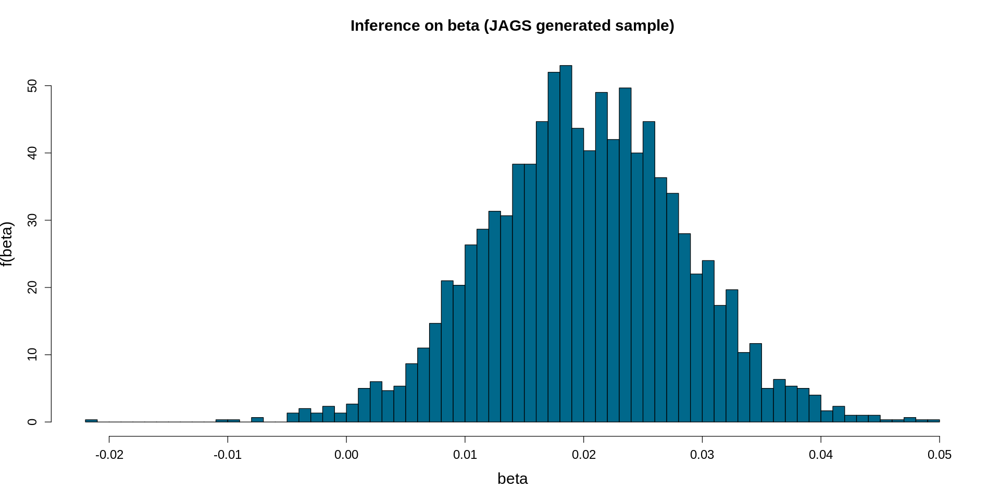

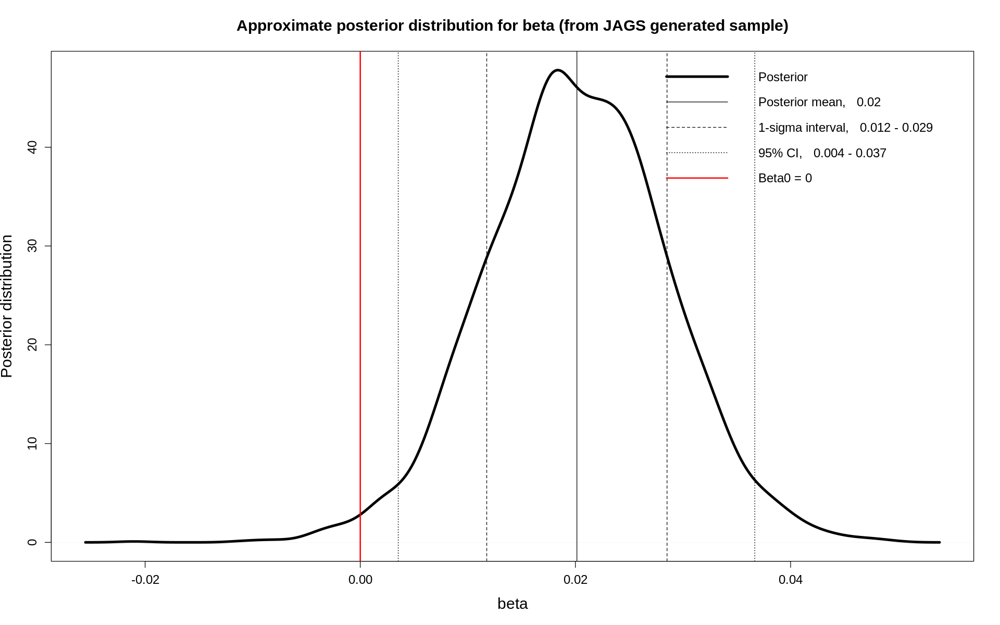

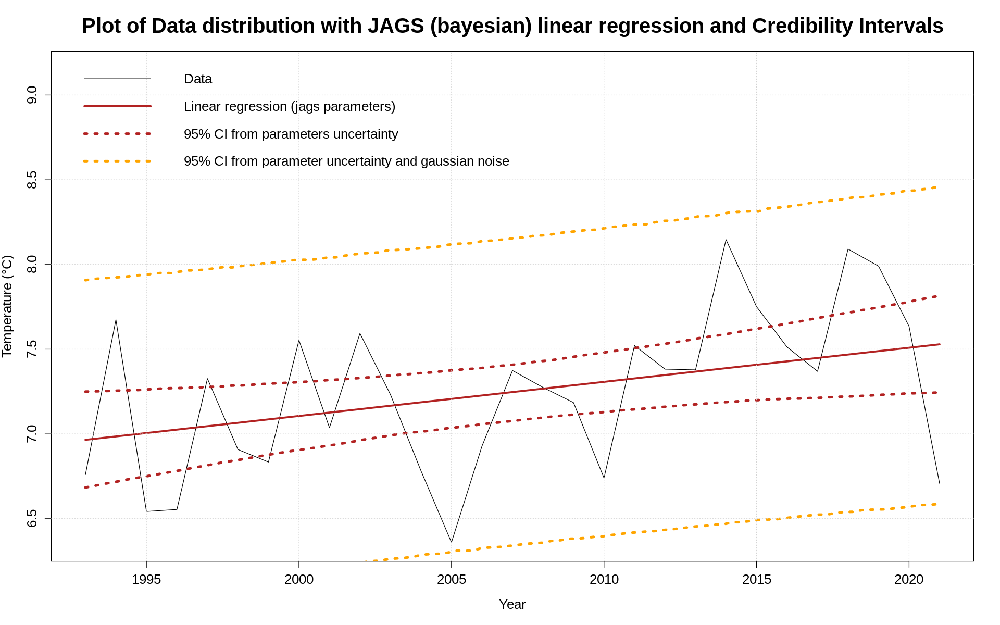

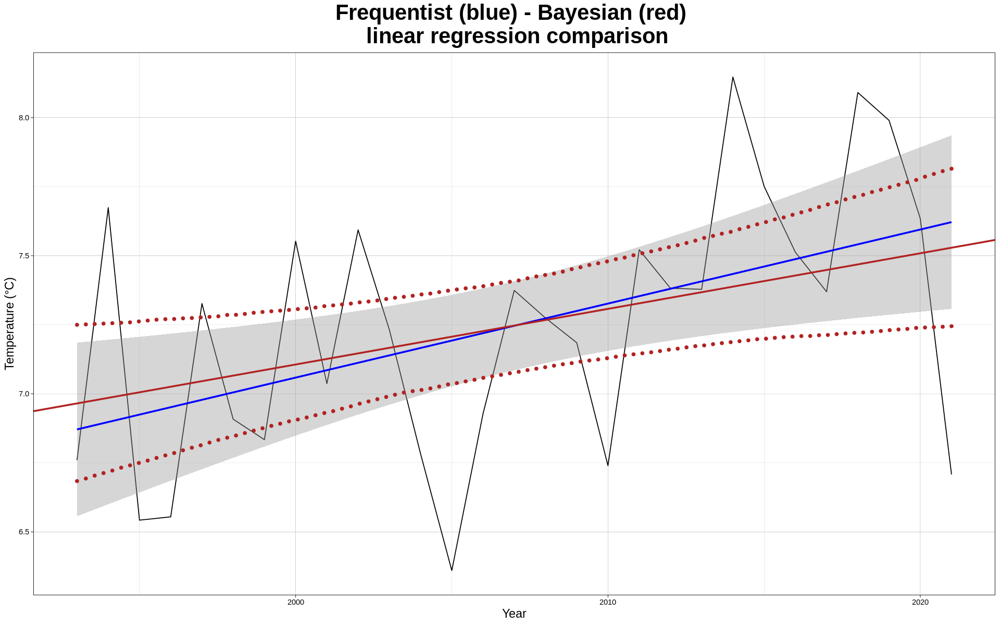

In [42]:
#Average
dataf <- df2[,c("Year", "Mean_Average_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3850736d2e.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -55.814  20.304 -95.544 -69.130 -56.506 -43.119 -14.199 1.001  3000
beta       0.029   0.010   0.008   0.022   0.029   0.035   0.049 1.001  3000
sigma      0.552   0.079   0.424   0.496   0.543   0.600   0.727 1.001  2700
deviance  46.027   3.328  41.634  43.567  45.358  47.733  54.576 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 5.5 and DIC = 51.6
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = al

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3846736245.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha      2.003   0.123  1.764  1.920  2.004  2.084  2.244 1.001  3000
sigma      0.662   0.093  0.506  0.598  0.652  0.717  0.869 1.001  3000
deviance  56.678   2.175 54.577 55.128 55.988 57.582 62.654 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.4 and DIC = 59.0
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 4.638374e-06 
Likelihood linear = 7.474272e-06 
Frequentist likelihood ratio (linear/constant) =  1.61 

Linear model is more suitable than constant!
HYPOTE

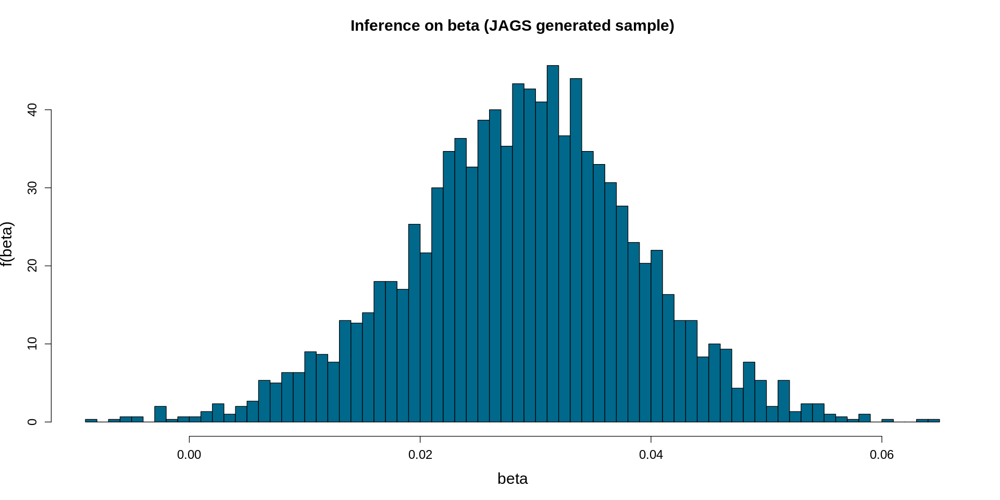

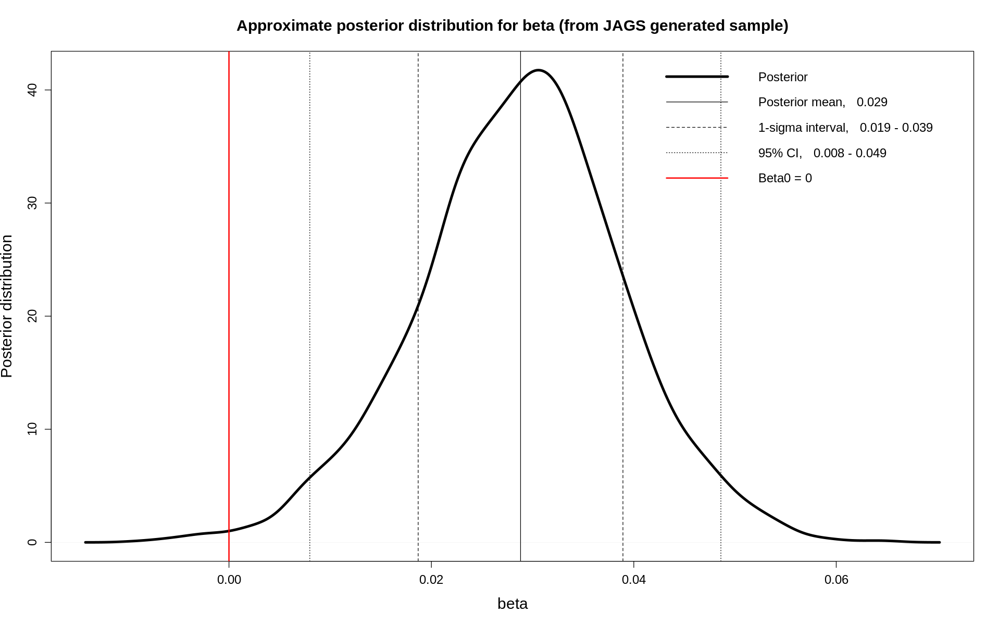

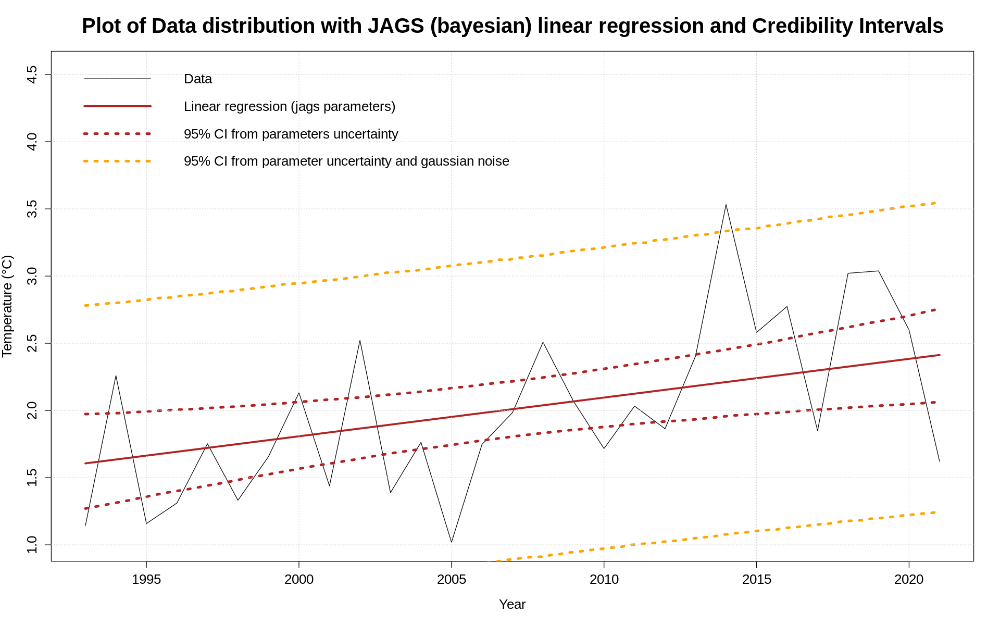

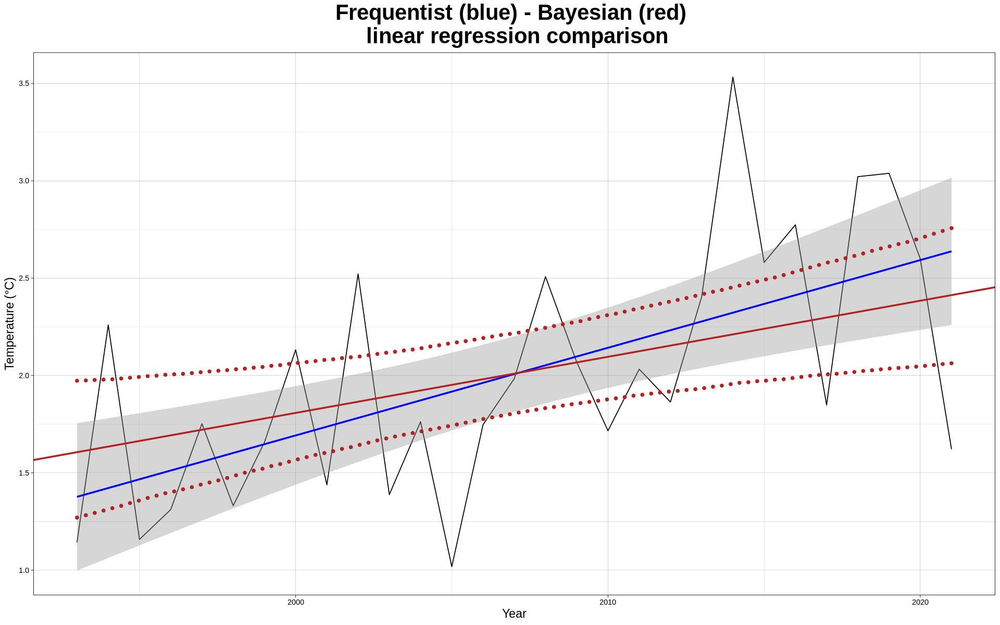

In [43]:
#Min
dataf <- df2[,c("Year", "Mean_Min_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3841847b2a.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%    50%    75%  97.5%  Rhat n.eff
alpha     -9.028  20.059 -49.012 -22.072 -8.975  4.590 30.144 1.002  1100
beta       0.012   0.010  -0.008   0.005  0.012  0.018  0.031 1.002  1100
sigma      0.601   0.084   0.462   0.542  0.593  0.651  0.792 1.001  3000
deviance  51.287   2.328  48.679  49.581 50.669 52.310 57.311 1.002  1700

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.7 and DIC = 54.0
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = alpha)


Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b385887e246.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     14.111   0.113 13.890 14.035 14.110 14.185 14.328 1.001  3000
sigma      0.609   0.087  0.464  0.549  0.599  0.659  0.804 1.001  2300
deviance  51.990   2.195 49.906 50.453 51.316 52.882 57.864 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.4 and DIC = 54.4
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 4.645811e-06 
Likelihood linear = 6.11948e-06 
Frequentist likelihood ratio (linear/constant) =  1.32 

Linear model is more suitable than constant!
HYPOTES

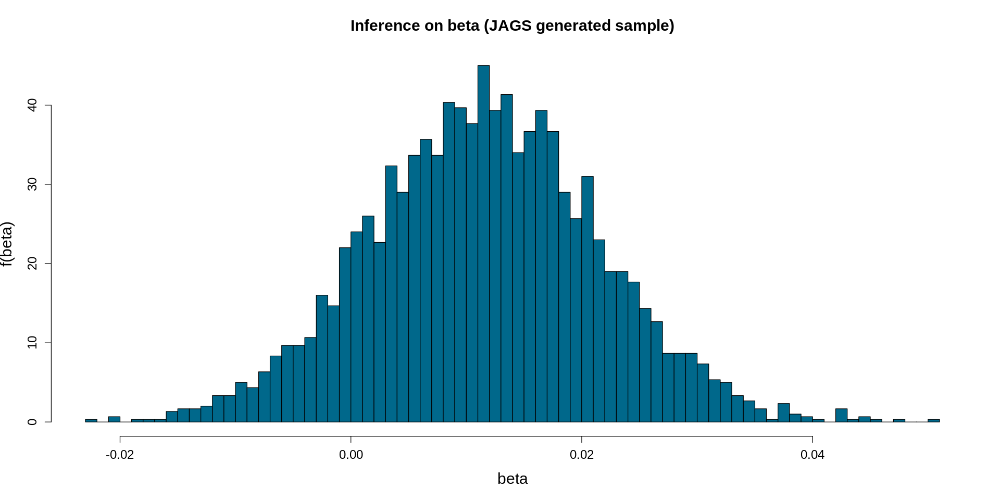

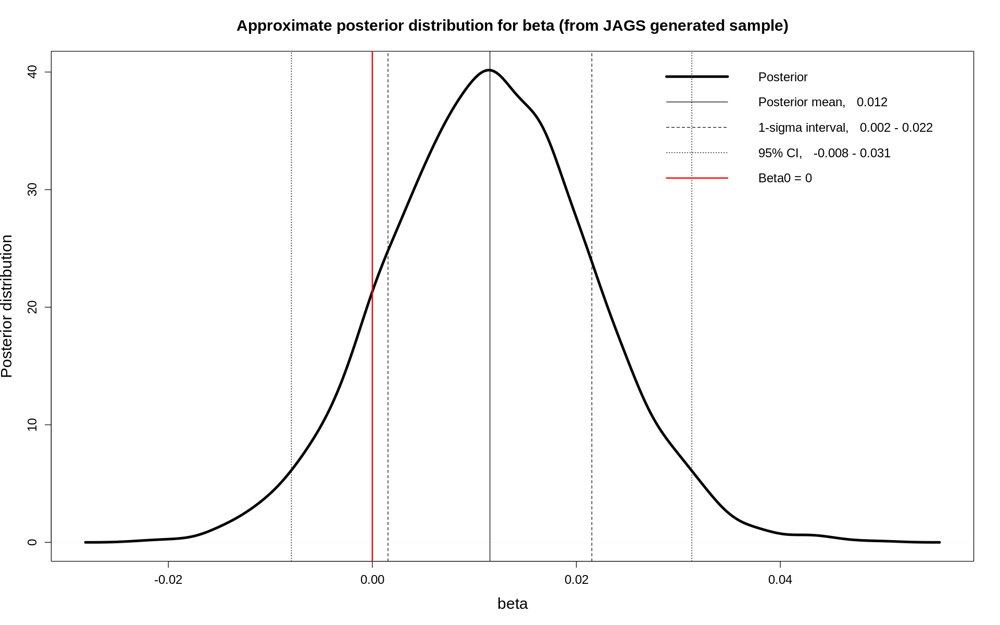

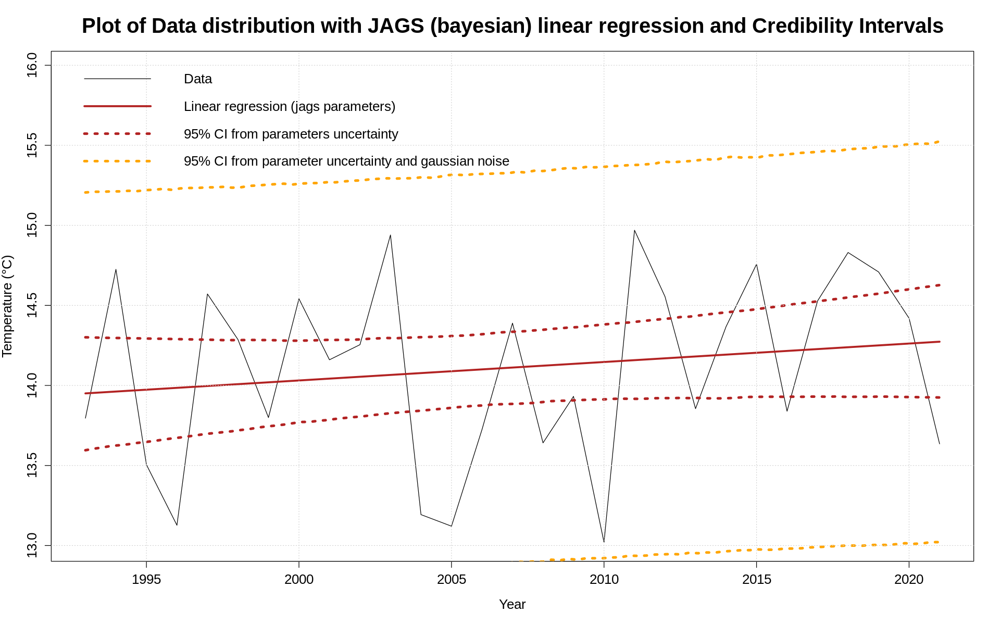

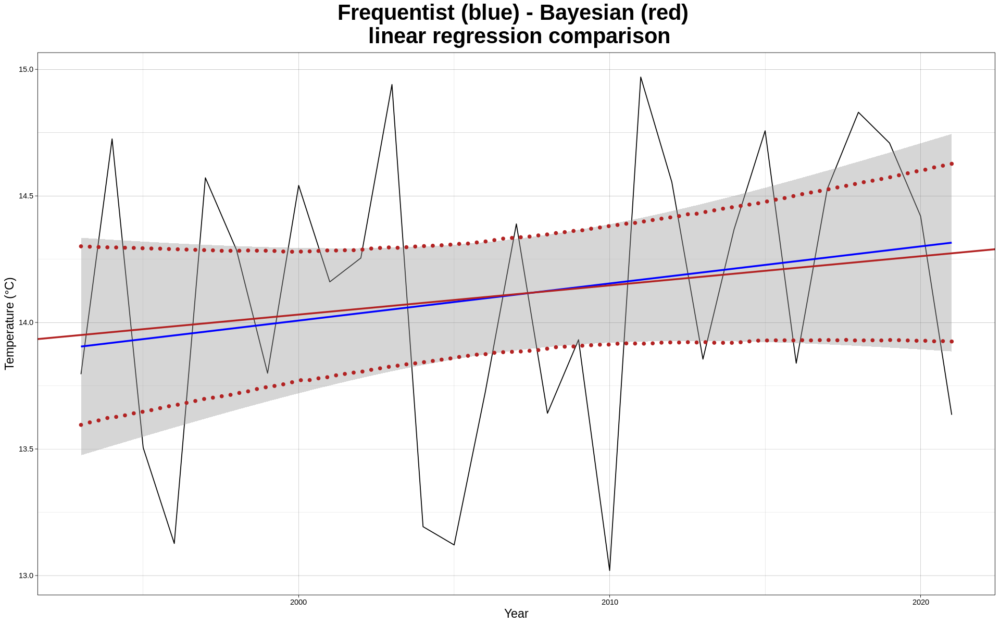

In [44]:
#Max
dataf <- df2[,c("Year", "Mean_Max_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)

### PART 2

Warning message:
“Factor `period` contains implicit NA, consider using `forcats::fct_explicit_na`”

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean      SD  Naive SE Time-series SE
Y     0.1479 0.24770 0.0014301      0.0014303
mu    0.1484 0.09424 0.0005441      0.0005508
sigma 0.2202 0.07025 0.0004056      0.0004633

2. Quantiles for each variable:

          2.5%       25%    50%    75%  97.5%
Y     -0.34641 -0.003398 0.1489 0.2984 0.6407
mu    -0.03969  0.091114 0.1484 0.2055 0.3377
sigma  0.12961  0.172504 0.2060 0.2509 0.3942



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


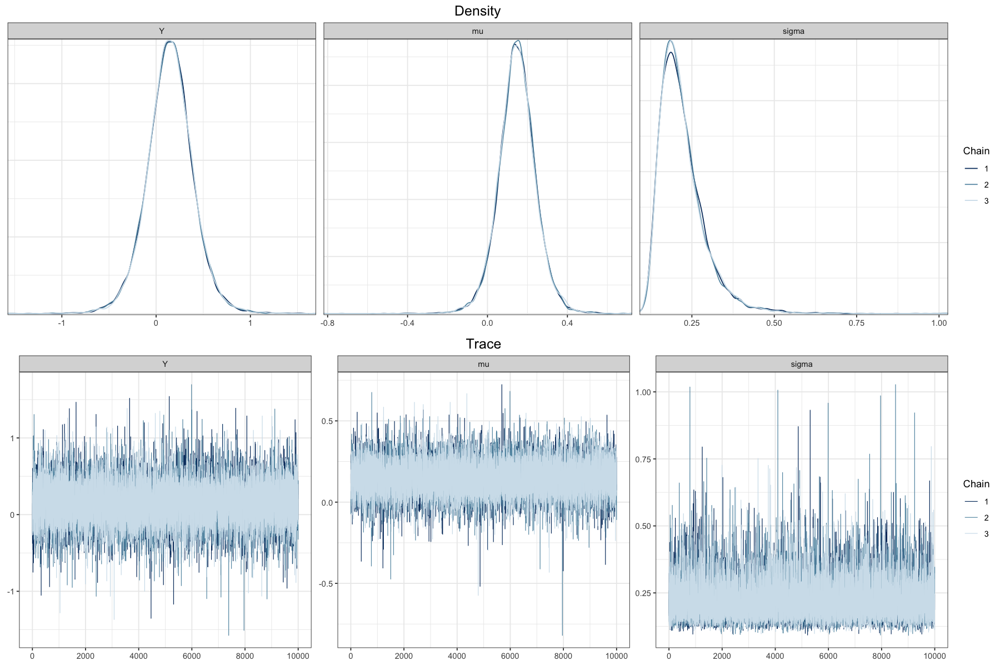

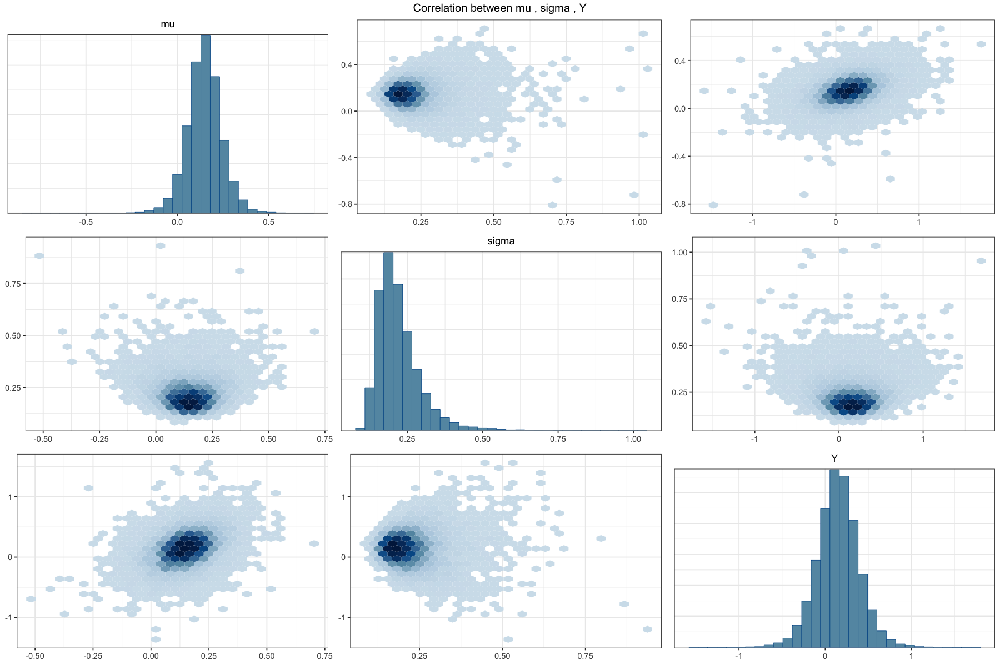

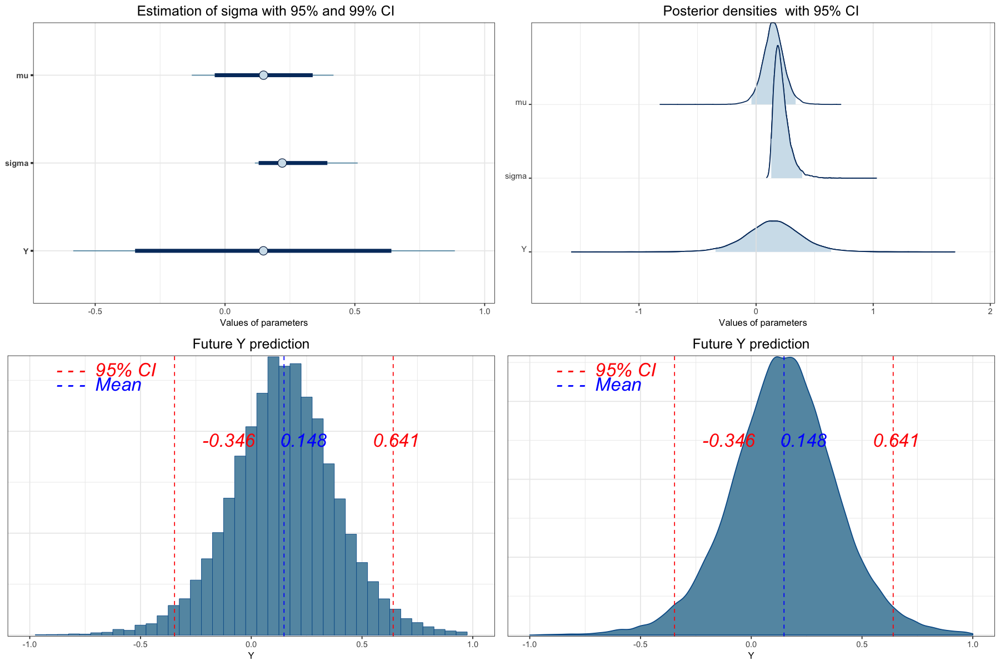

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD  Naive SE Time-series SE
Y     0.1391 0.3998 0.0023080      0.0023080
mu    0.1373 0.1516 0.0008752      0.0008752
sigma 0.3537 0.1137 0.0006566      0.0007641

2. Quantiles for each variable:

         2.5%      25%    50%    75%  97.5%
Y     -0.6522 -0.10613 0.1390 0.3787 0.9439
mu    -0.1630  0.04514 0.1366 0.2297 0.4369
sigma  0.2071  0.27590 0.3304 0.4036 0.6403



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


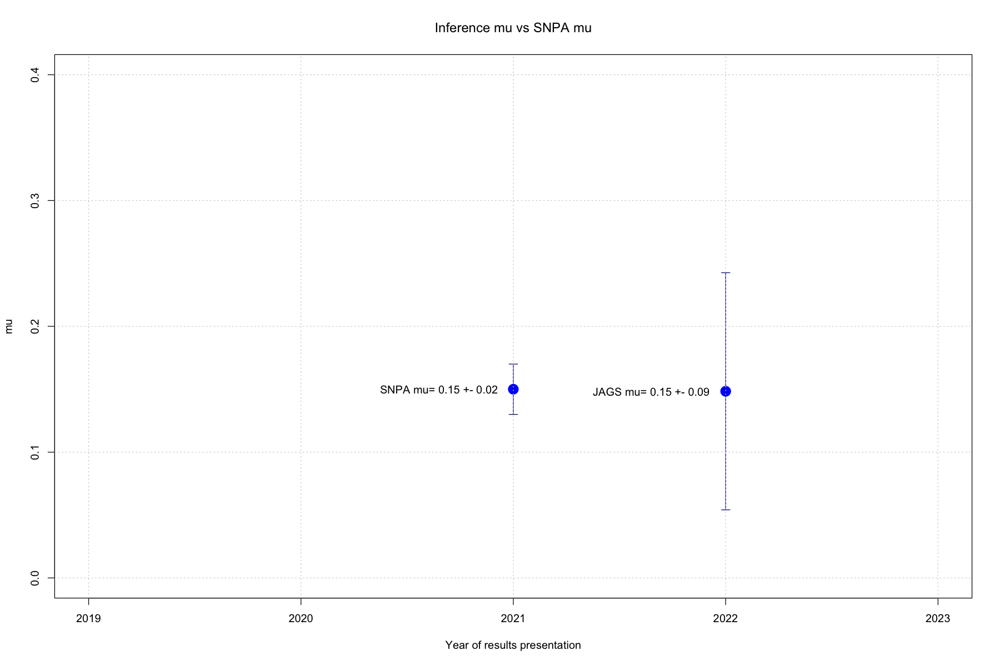

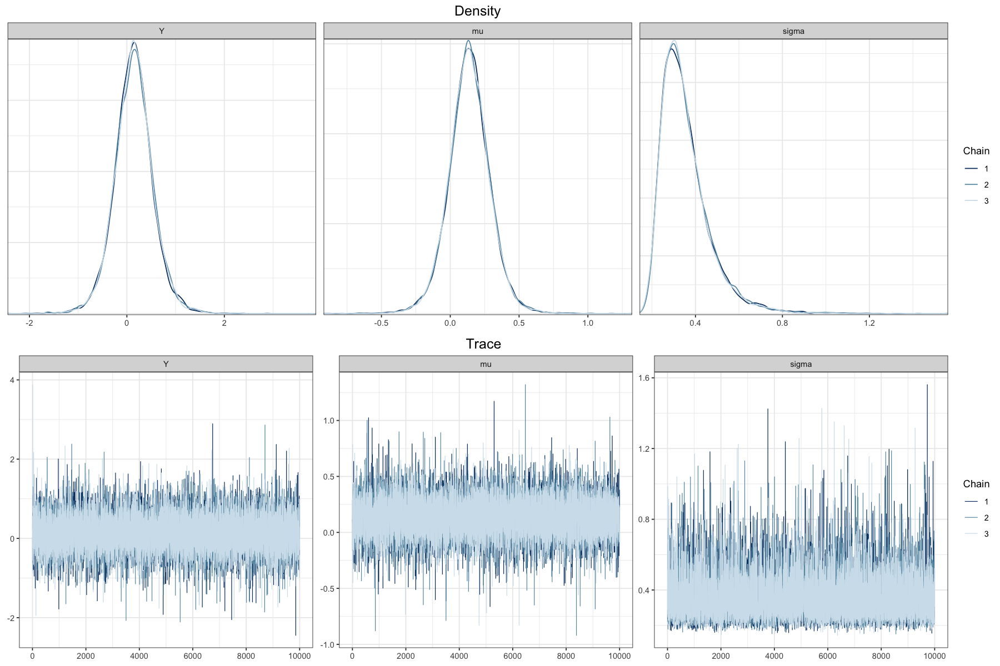

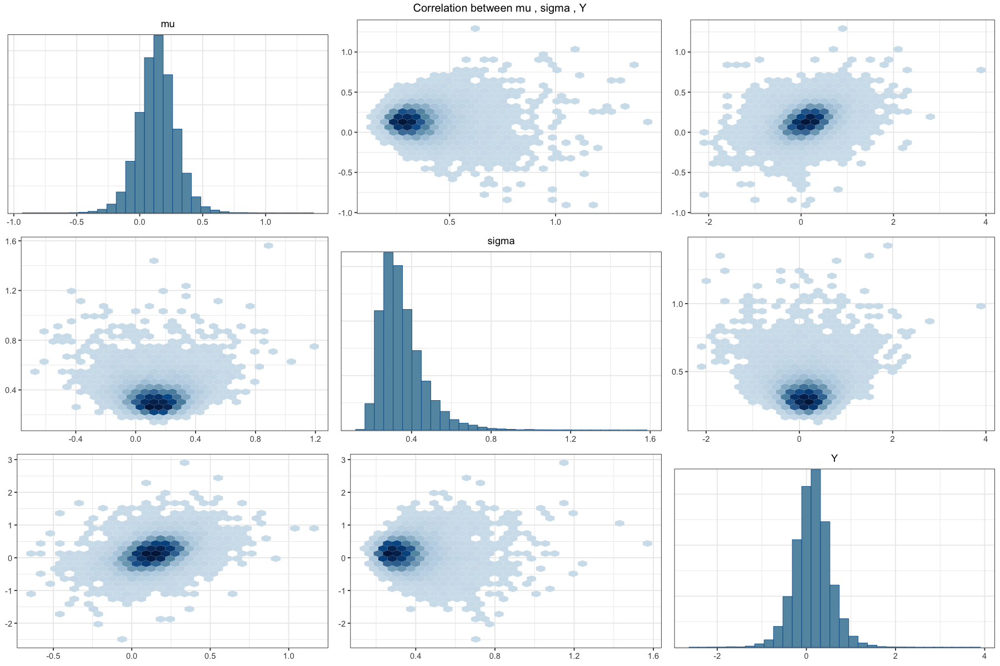

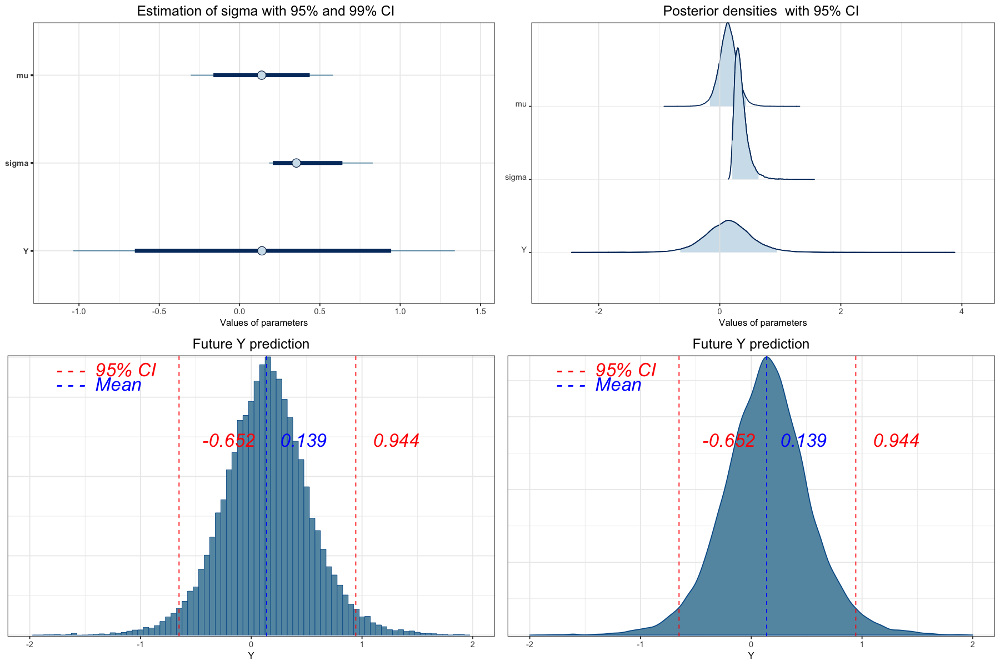

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD  Naive SE Time-series SE
Y     0.1926 0.4099 0.0023665      0.0023787
mu    0.1928 0.1537 0.0008874      0.0008874
sigma 0.3583 0.1156 0.0006672      0.0008106

2. Quantiles for each variable:

         2.5%      25%    50%    75%  97.5%
Y     -0.6270 -0.05138 0.1935 0.4344 1.0231
mu    -0.1164  0.10049 0.1930 0.2855 0.4998
sigma  0.2101  0.28001 0.3345 0.4081 0.6497



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


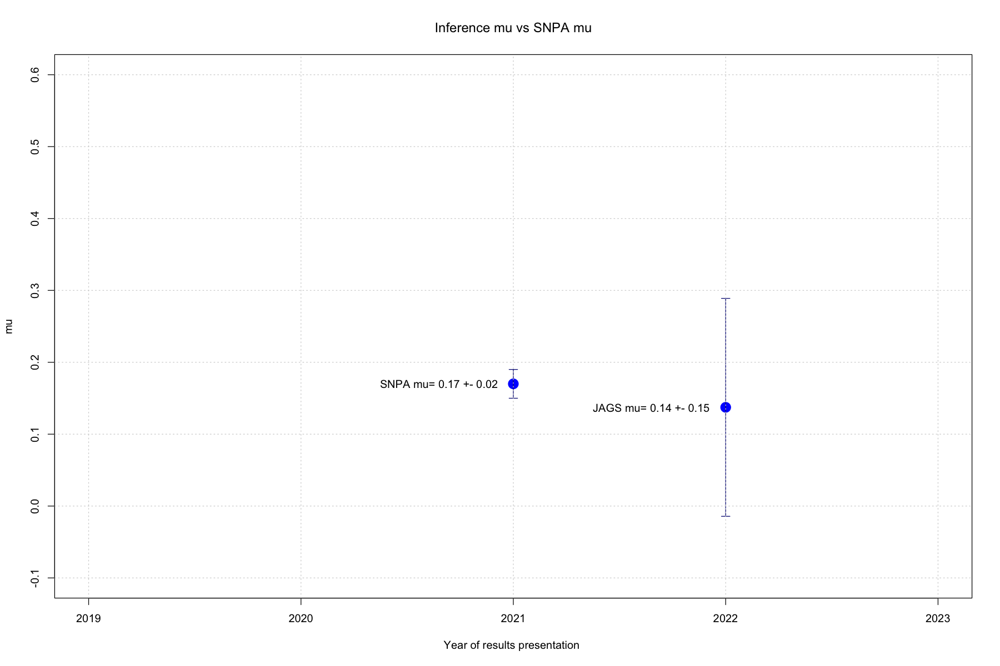

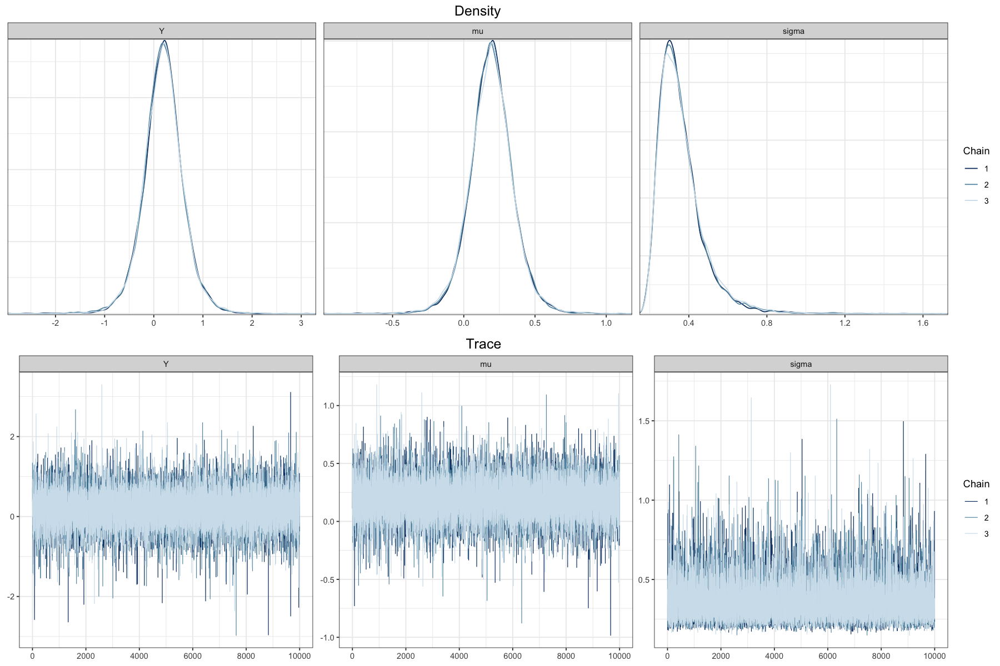

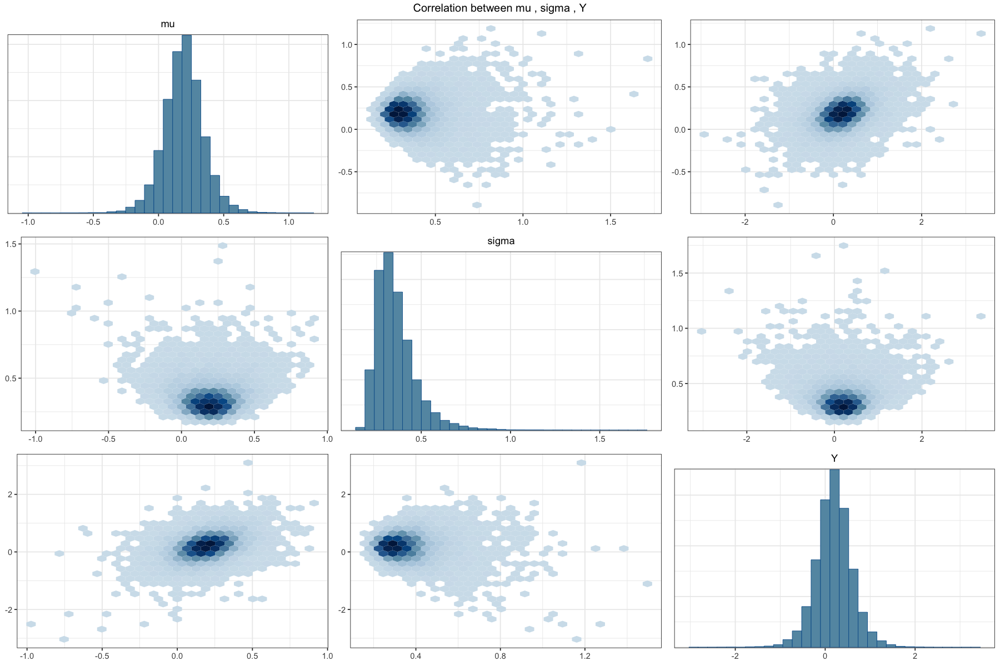

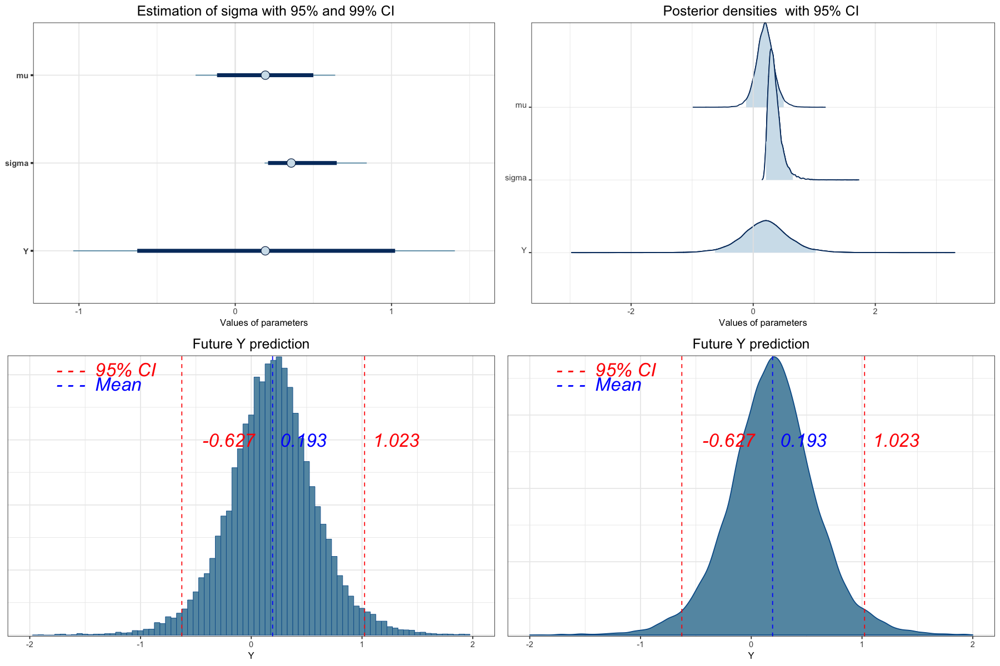

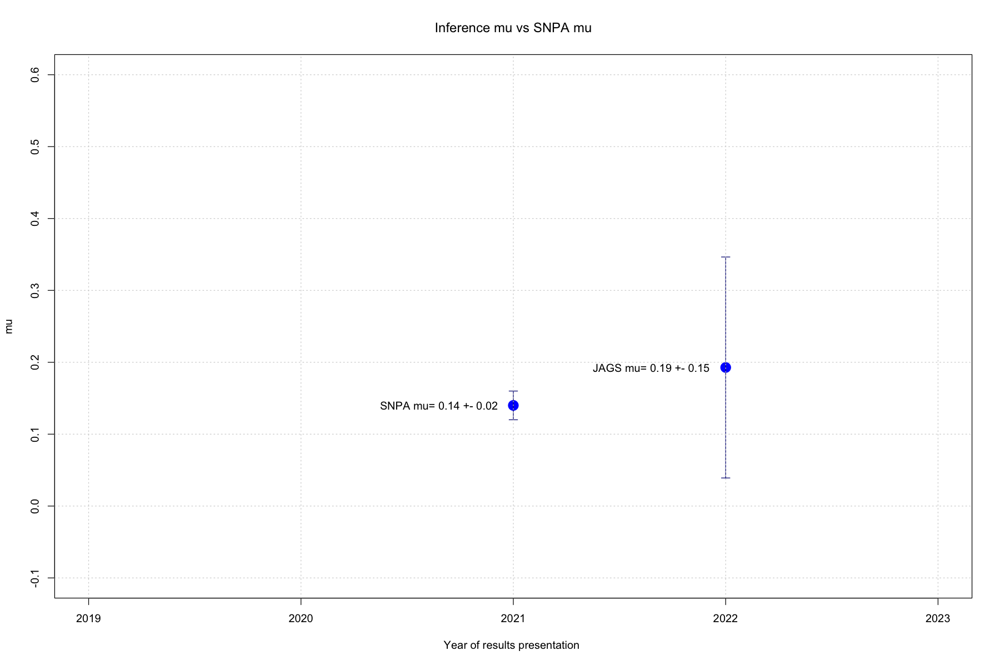

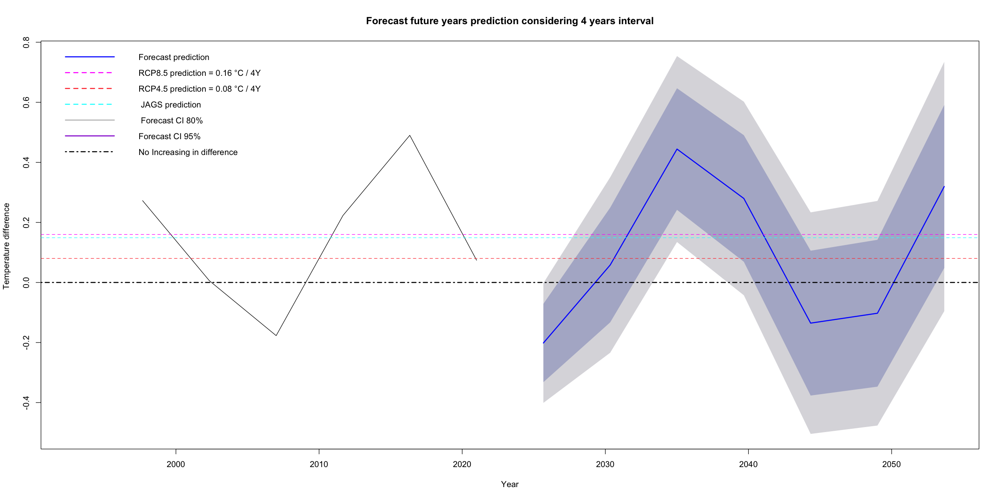

In [24]:
#create the dataframe
file<-"./Dati_temp_progetto/Auronzo.csv"
dfa<-import_data(file)


aggregateda<-aggregate_data(dfa)

dfa<-aggregateda[[1]]
df2a<-aggregateda[[2]]


df2a_3<-four_years1(df2a)

jags_mean(df2a_3,columns=c("Means_measure_diff"),0.15,0.02)
jags_max_min(df2a_3,columns=c("Max_Temperature_diff"),0.17,0.02)
jags_max_min(df2a_3,columns=c("Min_Temperature_diff"),0.14,0.02)
forecast_(df2a_3,columns=c("Means_measure_diff"),0.149)



### CASTELFRANCO VENETO

### PART 1

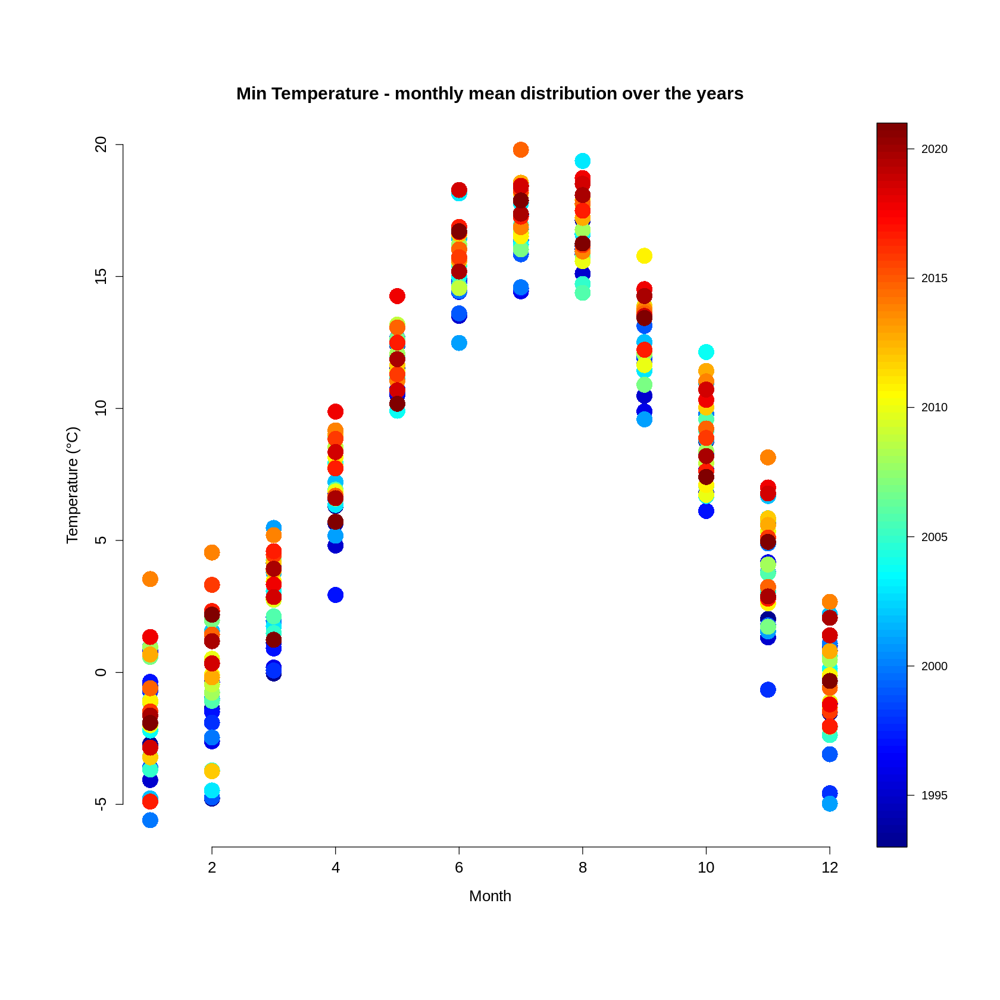

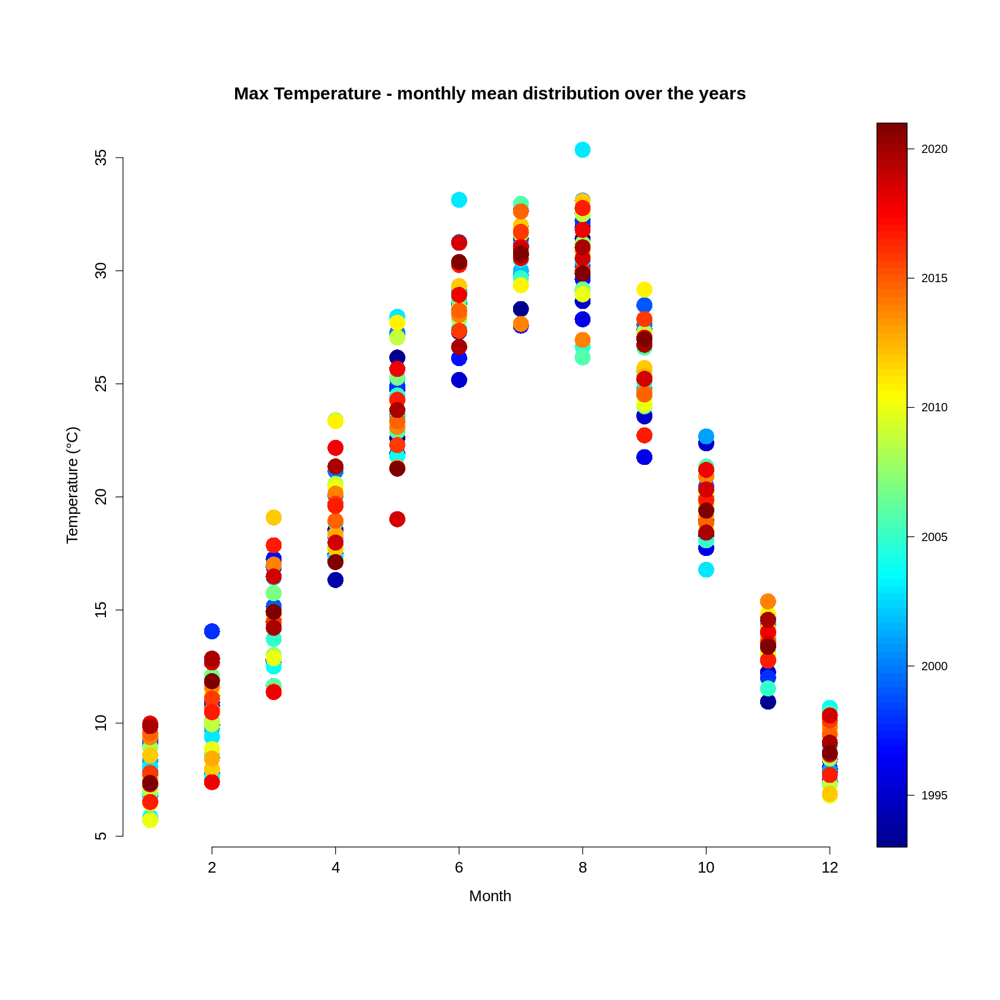

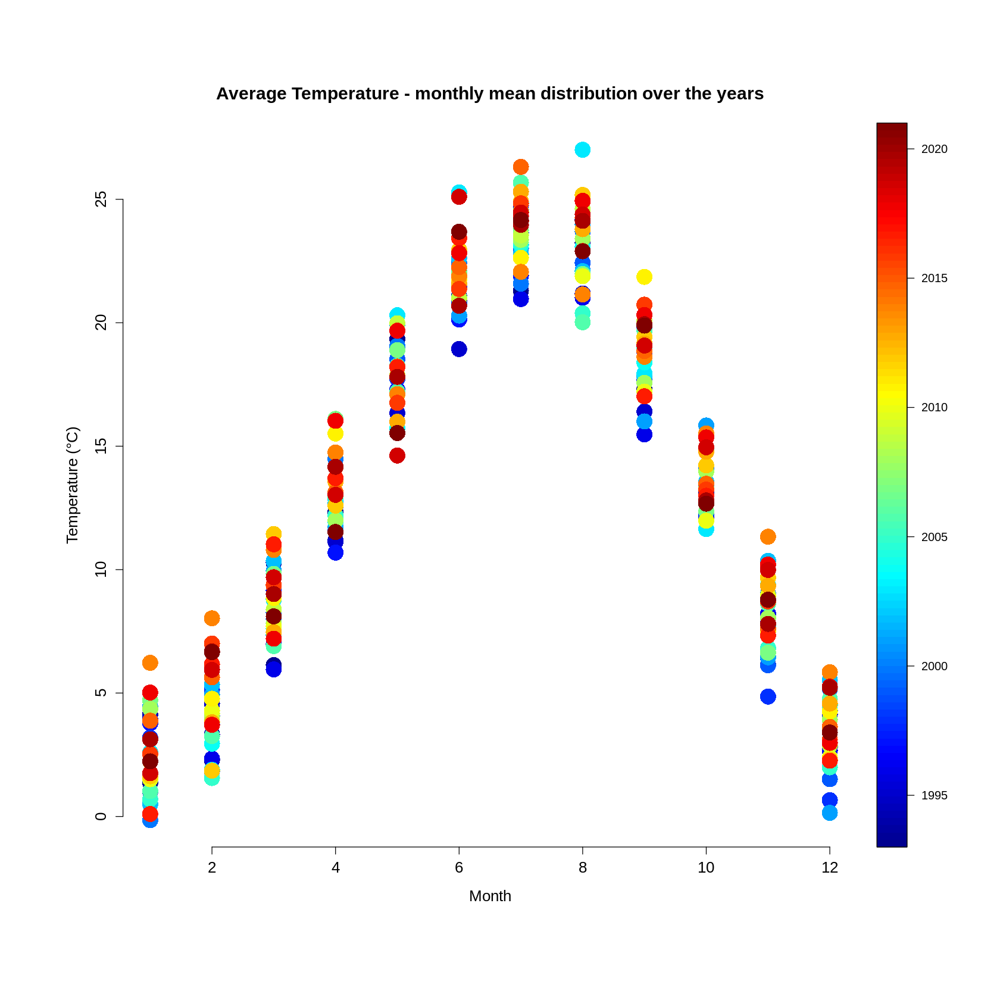

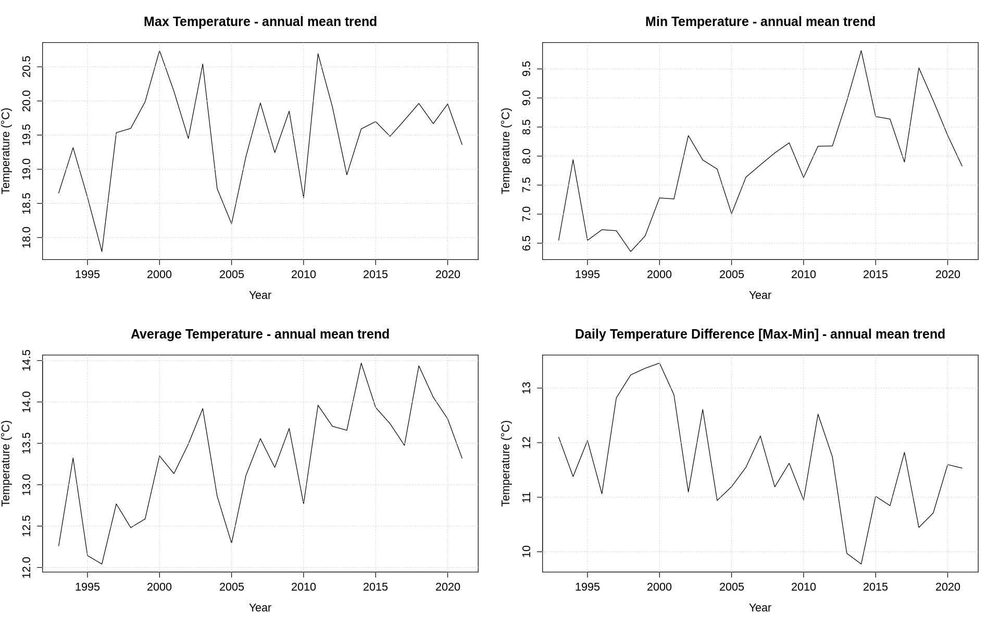

In [46]:
file<-"./Dati_temp_progetto/Castelfranco_Veneto.csv"
df<-import_data(file)
aggregated<-aggregate_data(df)

df1<-aggregated[[1]]
df2<-aggregated[[2]]

preliminary_plots1(df1)
preliminary_plots2(df2)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b38300050ef.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -65.443  19.262 -101.03 -78.278 -65.976 -53.216 -25.907 1.002  1700
beta       0.039   0.010    0.02   0.033   0.039   0.046   0.057 1.002  1600
sigma      0.515   0.079    0.39   0.458   0.505   0.560   0.696 1.001  3000
deviance  42.377   3.655   37.43  39.692  41.647  44.250  51.499 1.002  1300

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 6.7 and DIC = 49.1
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = al

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b381236193a.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     13.292   0.131 13.035 13.206 13.291 13.379 13.552 1.001  2900
sigma      0.701   0.100  0.537  0.632  0.691  0.755  0.931 1.001  3000
deviance  60.044   2.289 57.925 58.486 59.329 60.850 66.061 1.005  1100

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.6 and DIC = 62.7
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 4.29521e-06 
Likelihood linear = 7.0402e-06 
Frequentist likelihood ratio (linear/constant) =  1.64 

Linear model is more suitable than constant!
HYPOTESIS

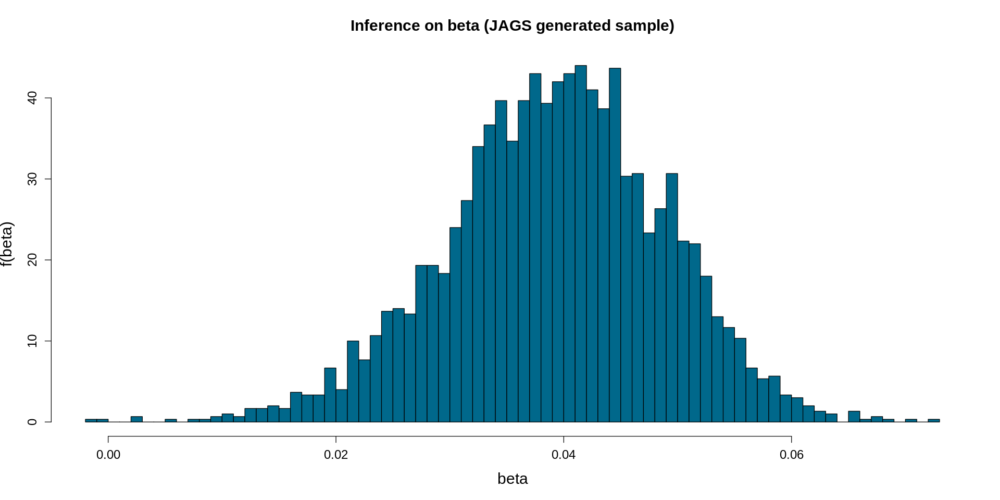

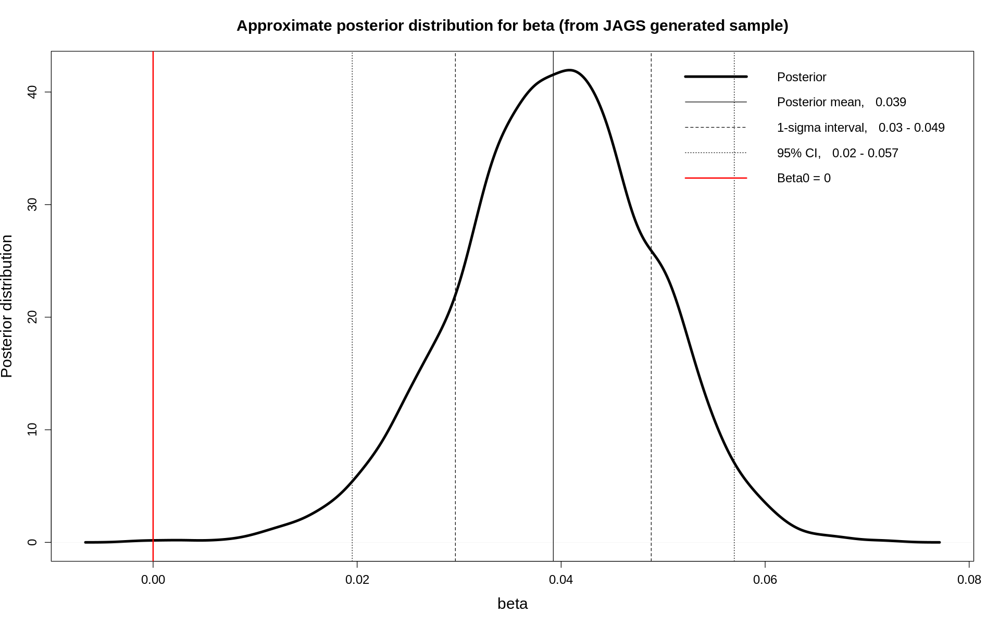

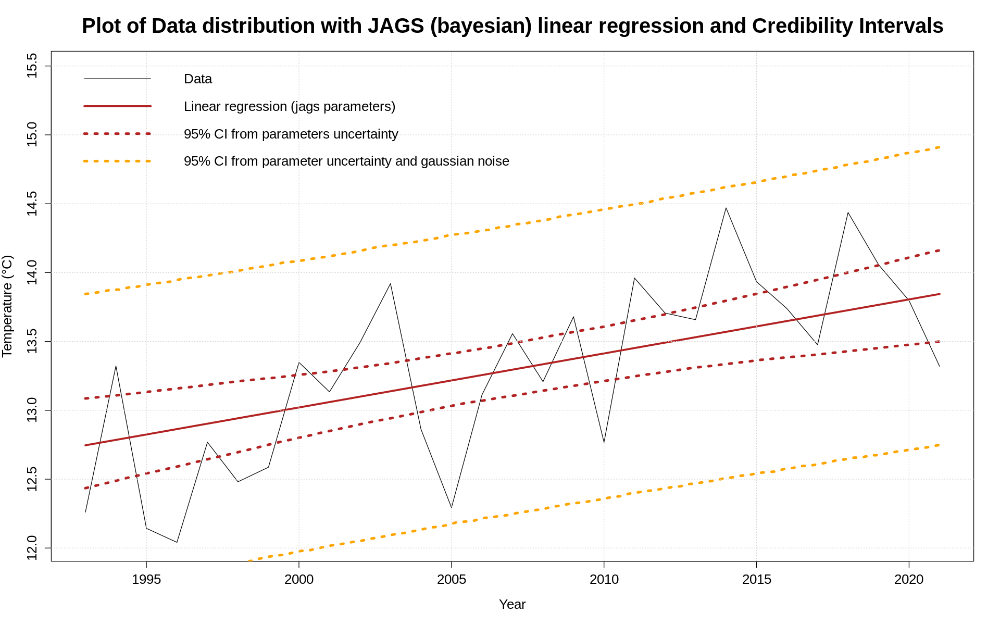

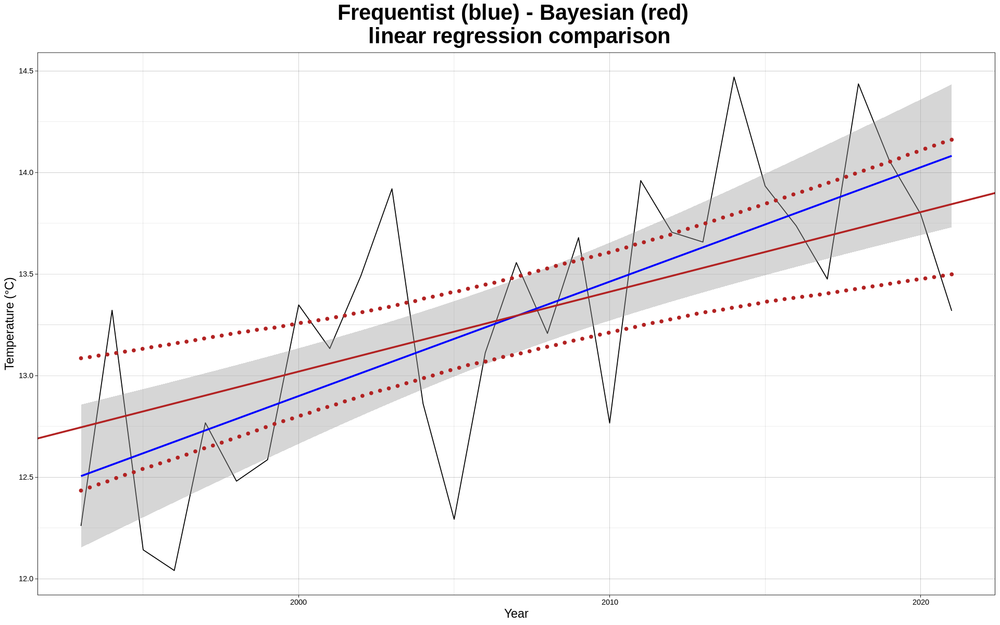

In [47]:
#Average
dataf <- df2[,c("Year", "Mean_Average_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3810c7d7b0.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect     2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -78.564  24.719 -124.406 -95.610 -78.730 -62.244 -28.784 1.001  3000
beta       0.043   0.012    0.018   0.035   0.043   0.052   0.066 1.001  3000
sigma      0.699   0.112    0.522   0.621   0.686   0.762   0.966 1.001  3000
deviance  59.852   4.725   52.330  56.289  59.439  62.763  70.572 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 11.2 and DIC = 71.0
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperatur

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b386fc3d764.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha      7.844   0.175  7.506  7.731  7.846  7.961  8.179 1.001  2500
sigma      0.938   0.133  0.719  0.842  0.923  1.019  1.228 1.002  1500
deviance  77.011   2.108 74.899 75.484 76.391 77.906 82.342 1.003   890

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.2 and DIC = 79.2
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 3.097268e-06 
Likelihood linear = 5.264265e-06 
Frequentist likelihood ratio (linear/constant) =  1.7 

Linear model is more suitable than constant!
HYPOTES

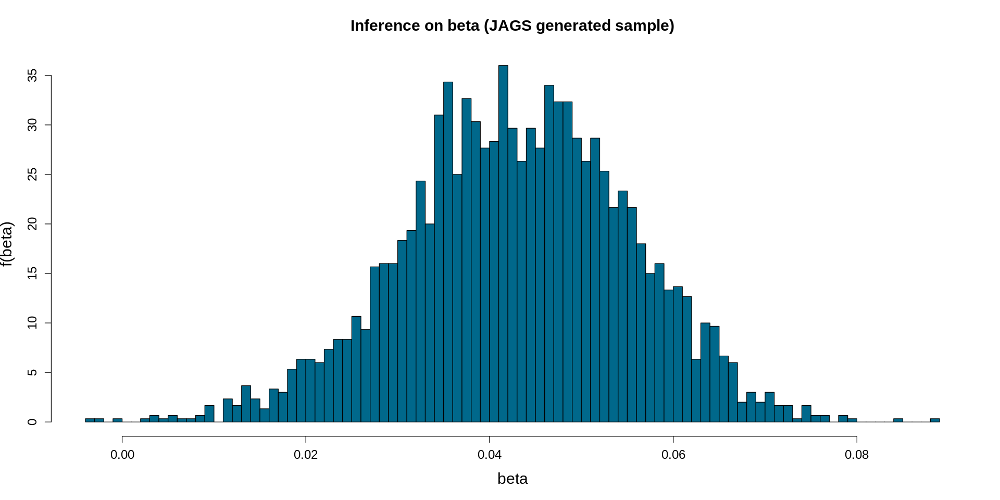

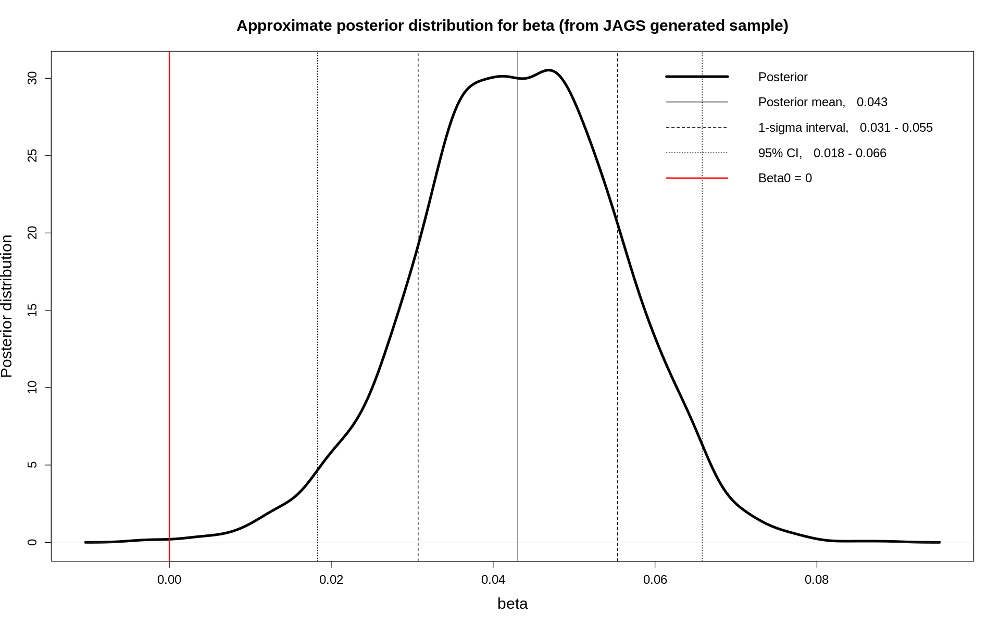

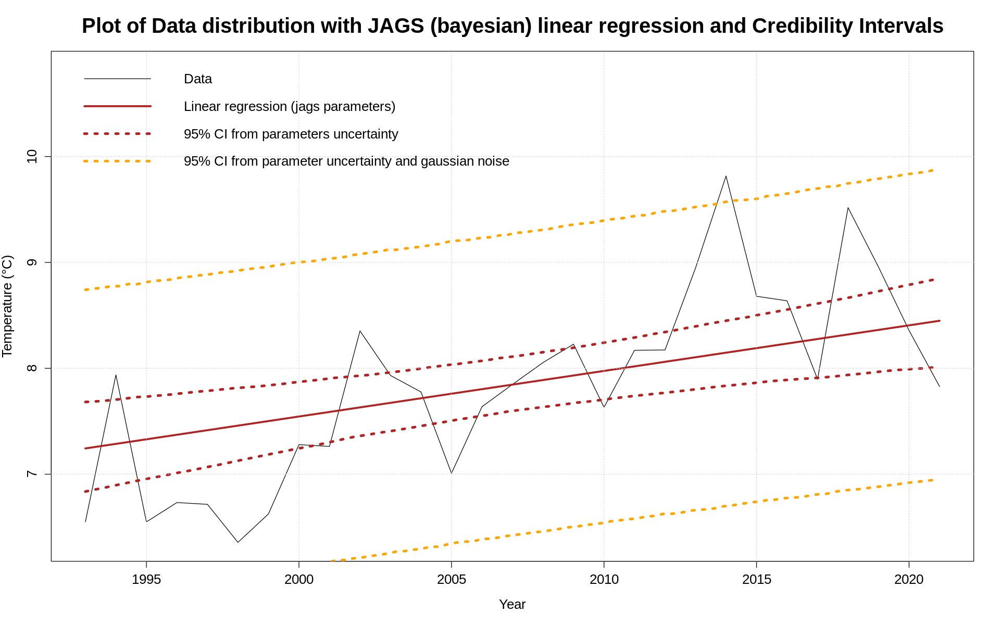

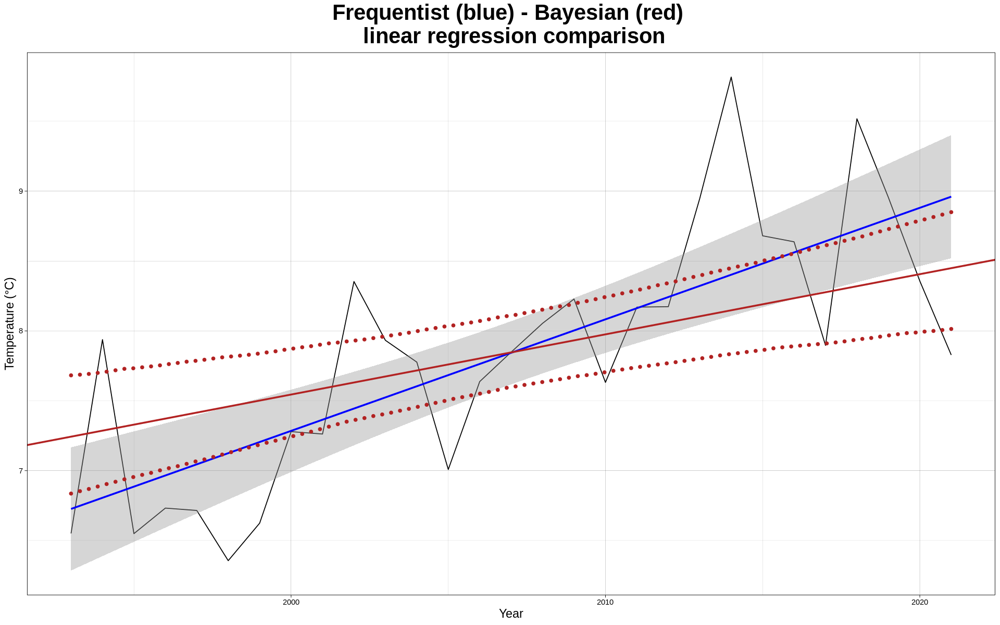

In [48]:
#Min
dataf <- df2[,c("Year", "Mean_Min_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b38191e6939.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%    75%  97.5%  Rhat n.eff
alpha    -11.998  21.875 -53.571 -26.690 -12.505  3.400 30.002 1.001  3000
beta       0.016   0.011  -0.005   0.008   0.016  0.023  0.036 1.001  3000
sigma      0.723   0.102   0.557   0.653   0.711  0.782  0.965 1.001  3000
deviance  61.734   2.389  59.105  60.011  61.068 62.764 68.256 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.9 and DIC = 64.6
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = alpha)


Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3810934889.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     19.483   0.141 19.201 19.390 19.484 19.575 19.756 1.001  3000
sigma      0.737   0.102  0.572  0.665  0.726  0.794  0.962 1.001  3000
deviance  63.141   2.214 61.049 61.572 62.440 63.979 69.326 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.5 and DIC = 65.6
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 3.761521e-06 
Likelihood linear = 5.335729e-06 
Frequentist likelihood ratio (linear/constant) =  1.42 

Linear model is more suitable than constant!
HYPOTE

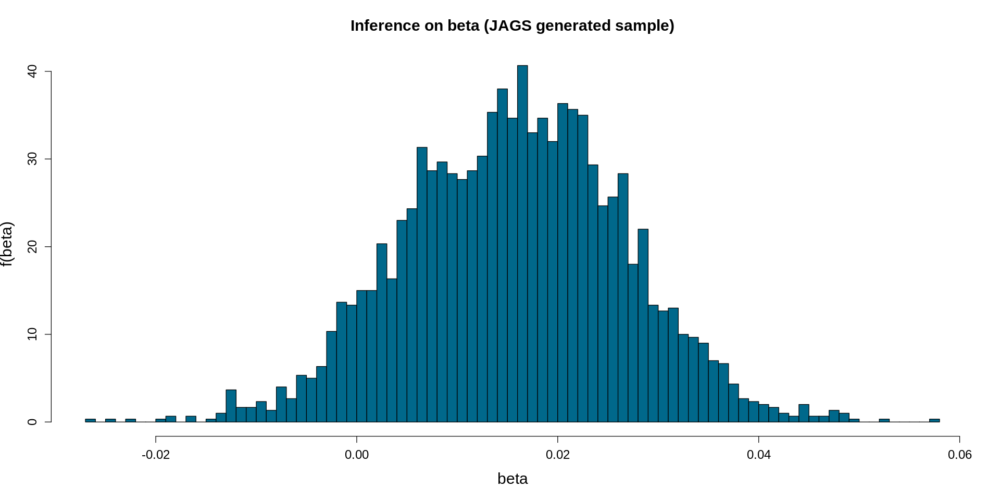

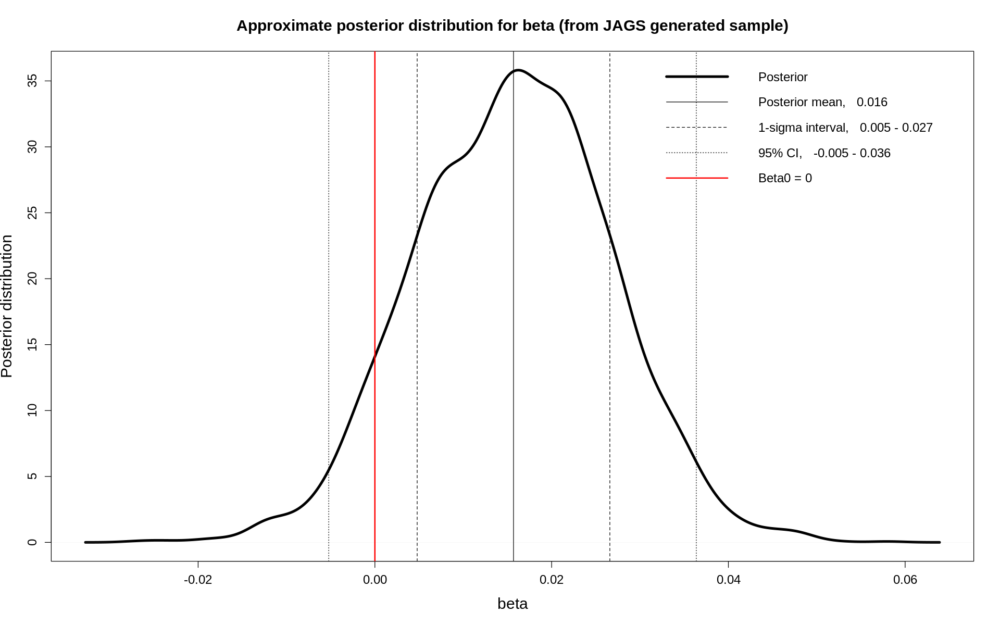

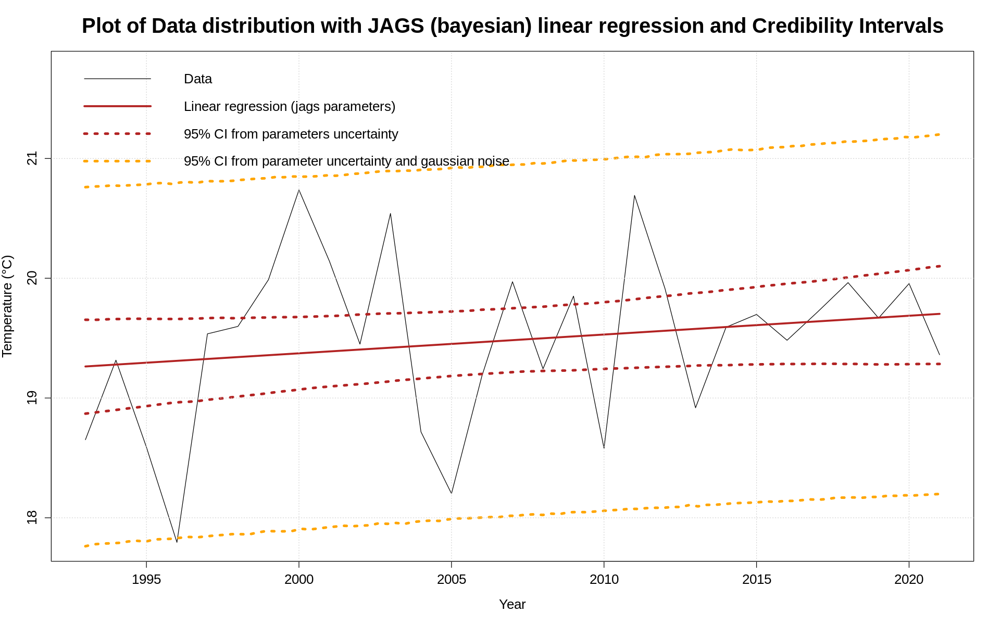

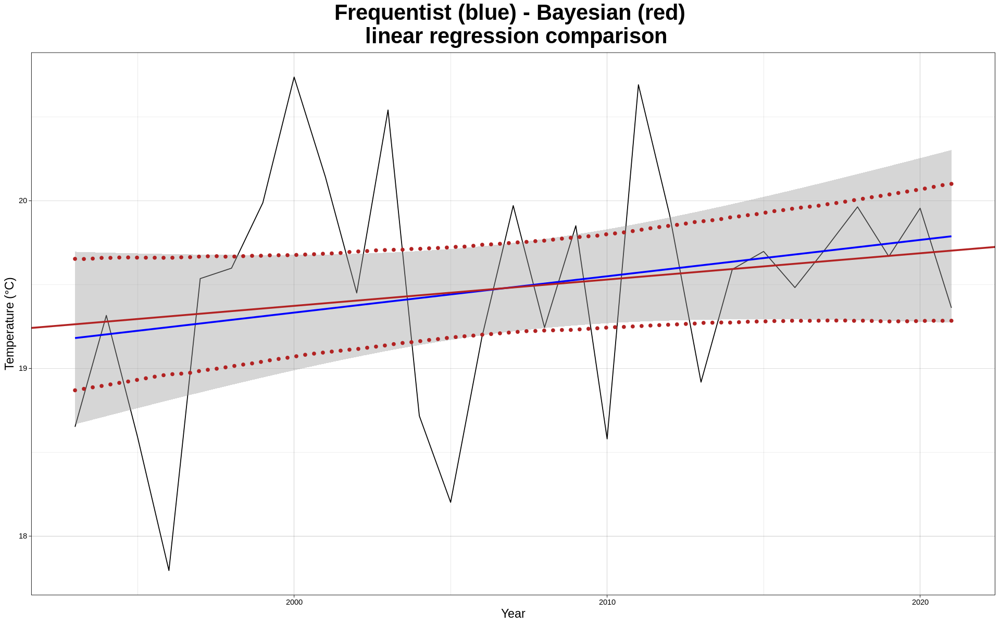

In [49]:
#Max
dataf <- df2[,c("Year", "Mean_Max_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)

### PART 2

Warning message:
“Factor `period` contains implicit NA, consider using `forcats::fct_explicit_na`”

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD  Naive SE Time-series SE
Y     0.2502 0.3654 0.0021095      0.0021229
mu    0.2501 0.1384 0.0007991      0.0007875
sigma 0.3218 0.1041 0.0006008      0.0007075

2. Quantiles for each variable:

          2.5%     25%    50%    75%  97.5%
Y     -0.47692 0.03084 0.2511 0.4677 0.9838
mu    -0.02895 0.16700 0.2498 0.3350 0.5267
sigma  0.18837 0.25127 0.3002 0.3667 0.5854



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


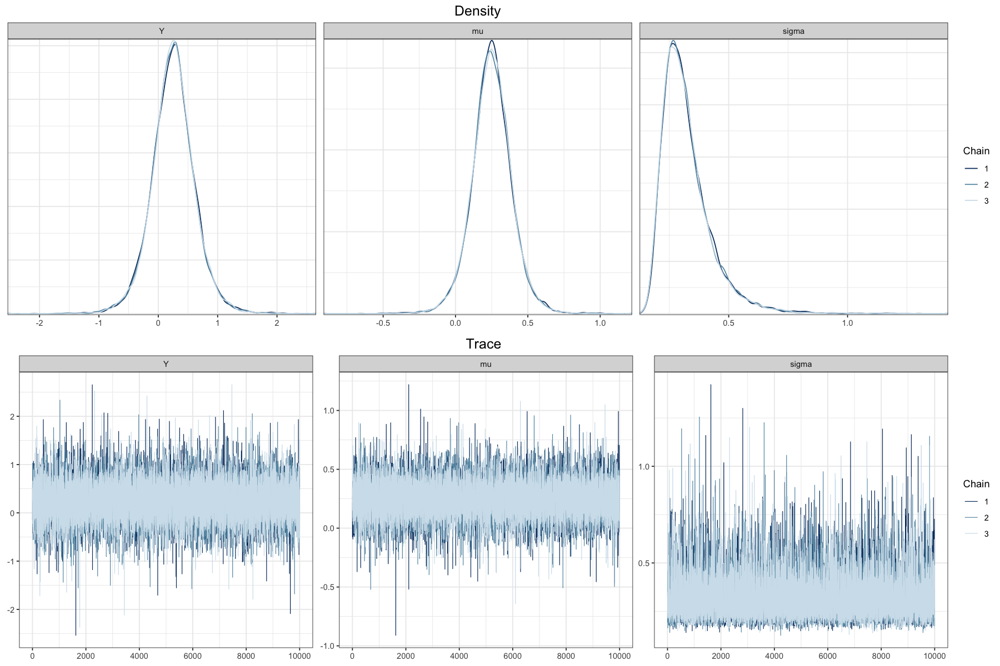

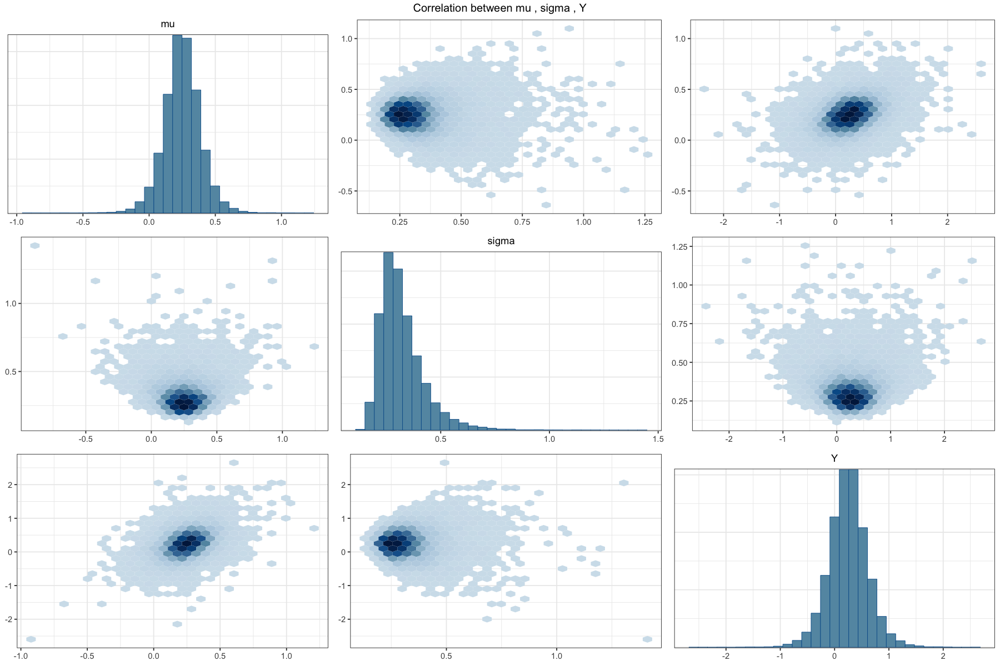

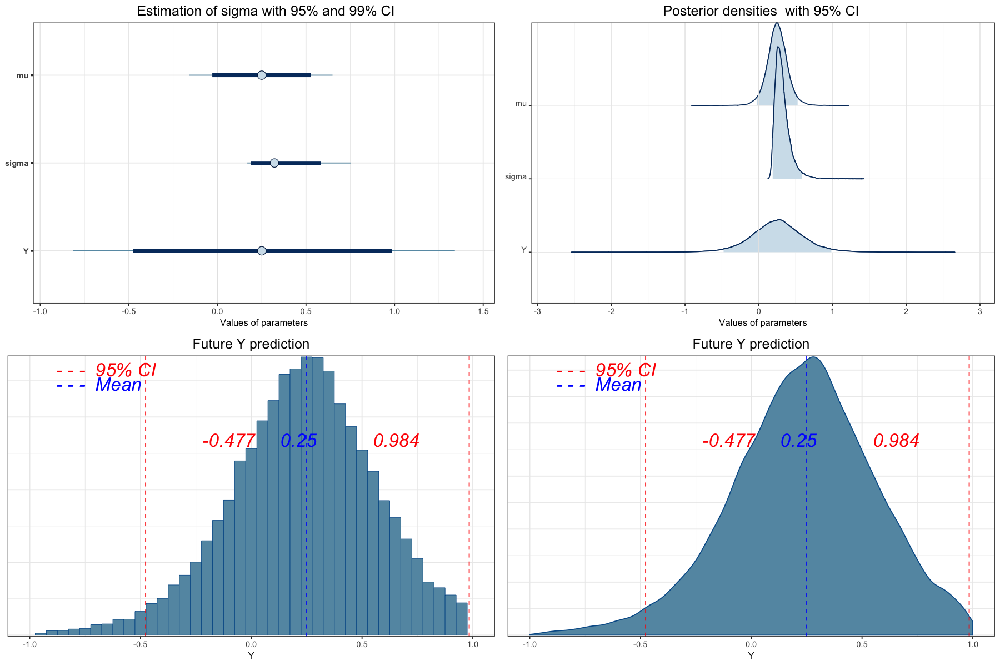

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD Naive SE Time-series SE
Y     0.2062 0.7991 0.004614       0.004614
mu    0.2039 0.2990 0.001726       0.001726
sigma 0.6960 0.2243 0.001295       0.001533

2. Quantiles for each variable:

         2.5%      25%    50%    75%  97.5%
Y     -1.3812 -0.27325 0.2012 0.6845 1.8011
mu    -0.3982  0.02588 0.2028 0.3824 0.8007
sigma  0.4076  0.54279 0.6512 0.7925 1.2472



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


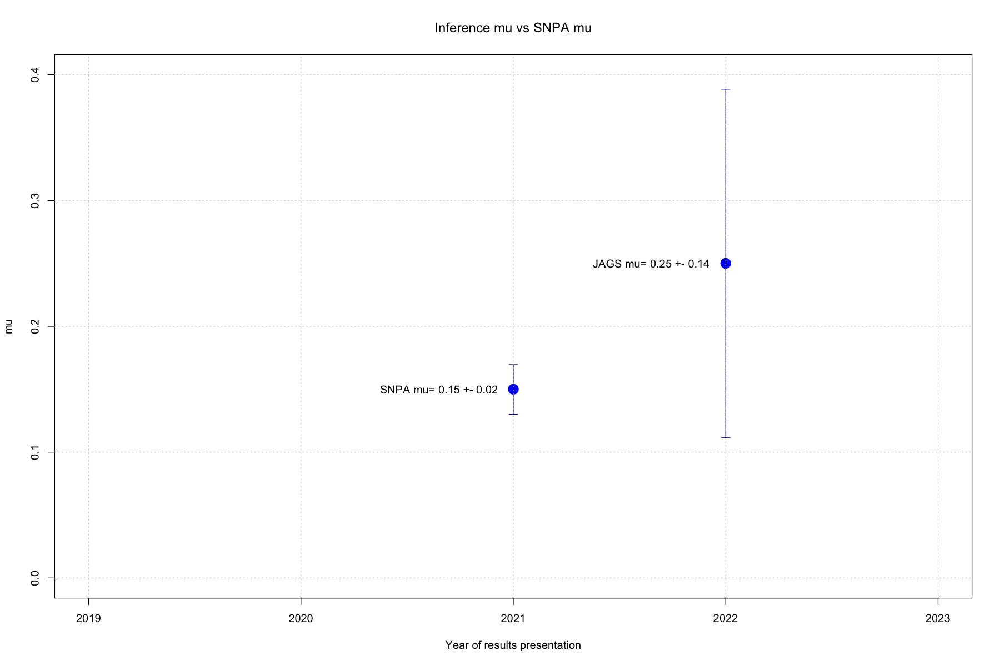

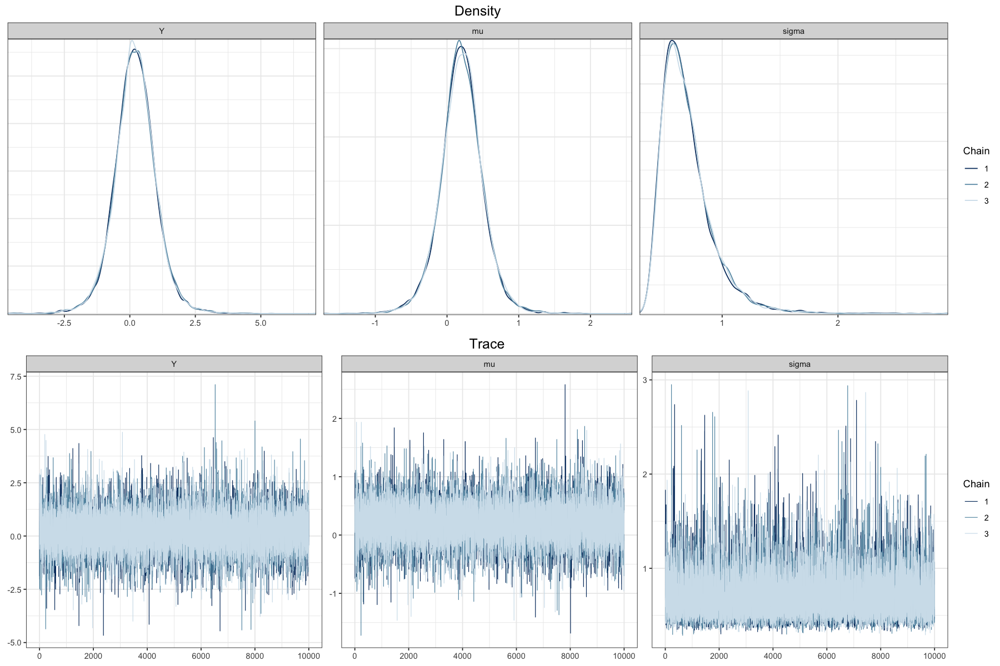

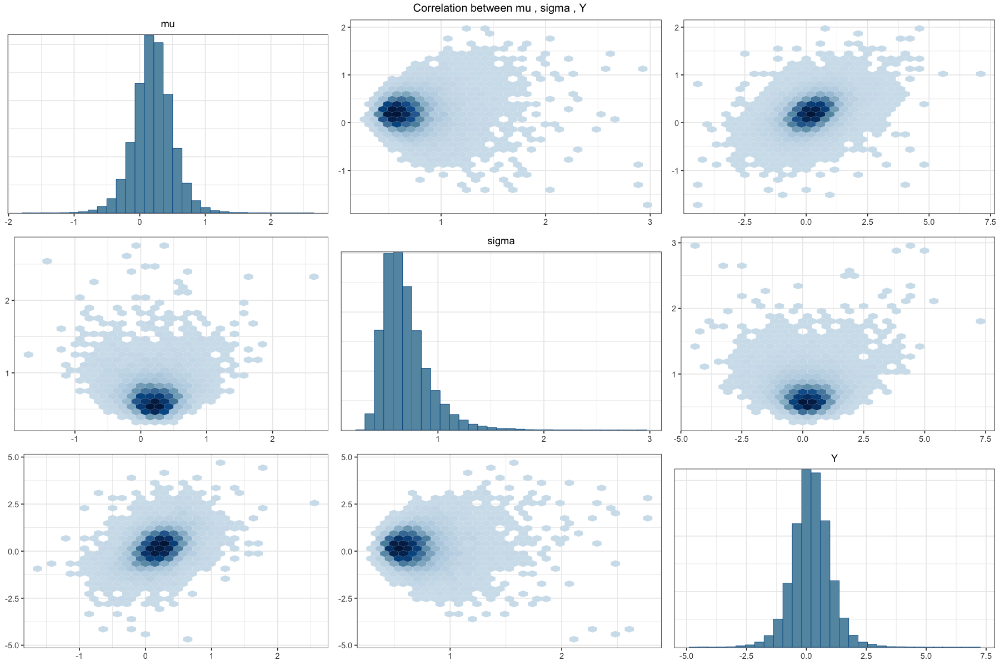

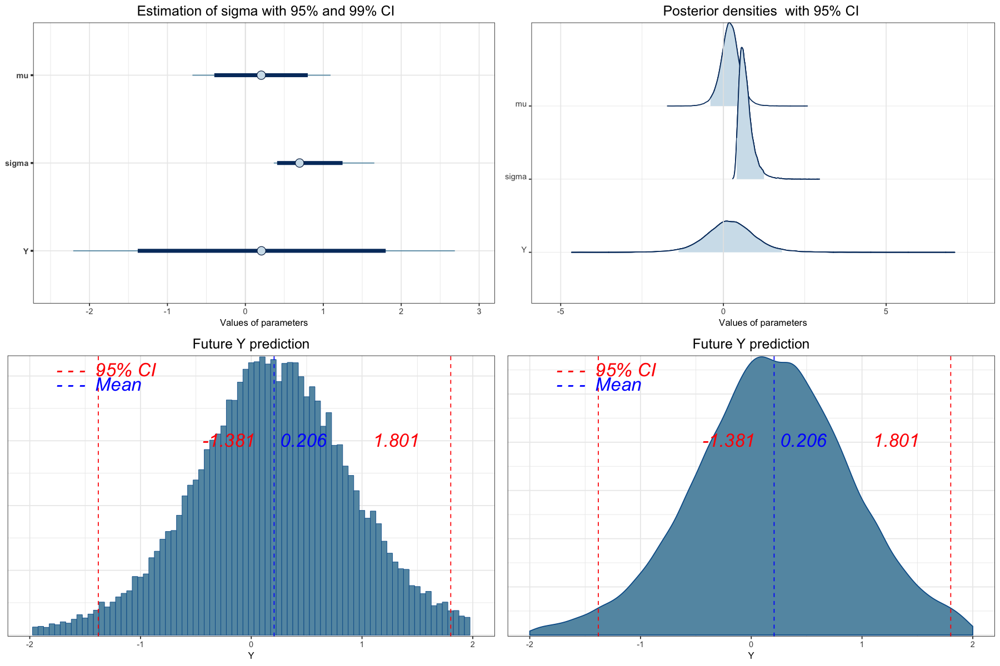

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD Naive SE Time-series SE
Y     0.2867 0.6850 0.003955       0.003955
mu    0.2889 0.2575 0.001486       0.001486
sigma 0.5974 0.1917 0.001107       0.001300

2. Quantiles for each variable:

         2.5%     25%    50%    75%  97.5%
Y     -1.0937 -0.1239 0.2860 0.7016 1.6484
mu    -0.2311  0.1339 0.2876 0.4428 0.7998
sigma  0.3512  0.4680 0.5577 0.6797 1.0781



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


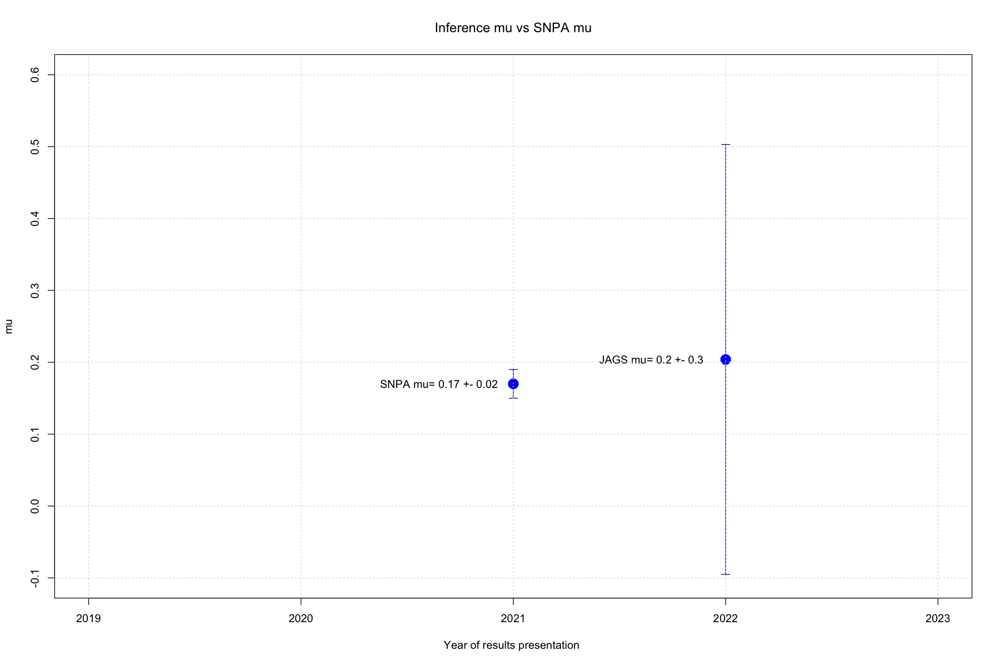

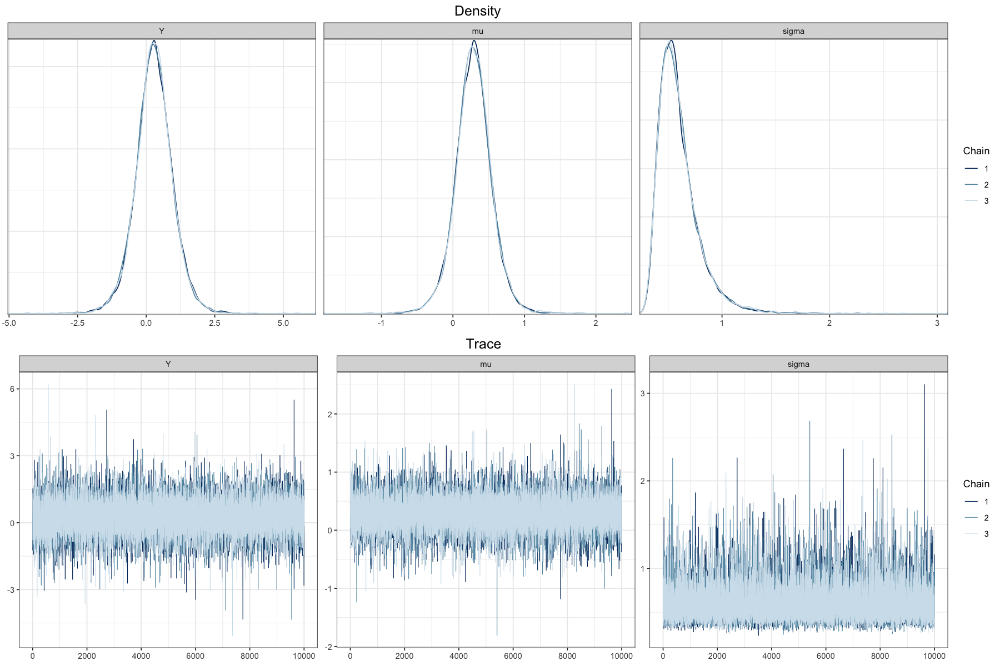

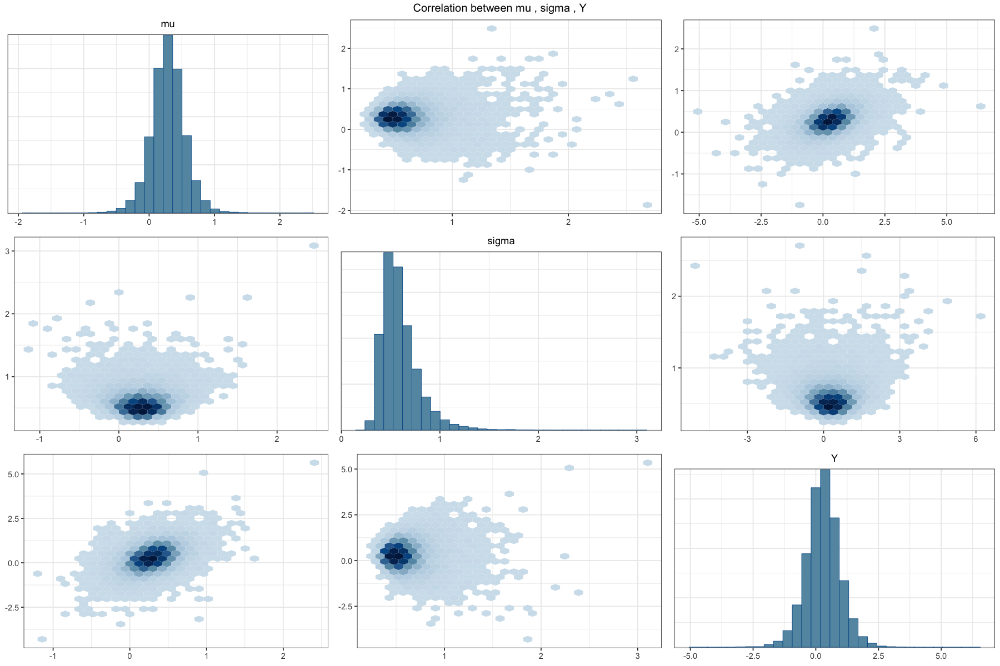

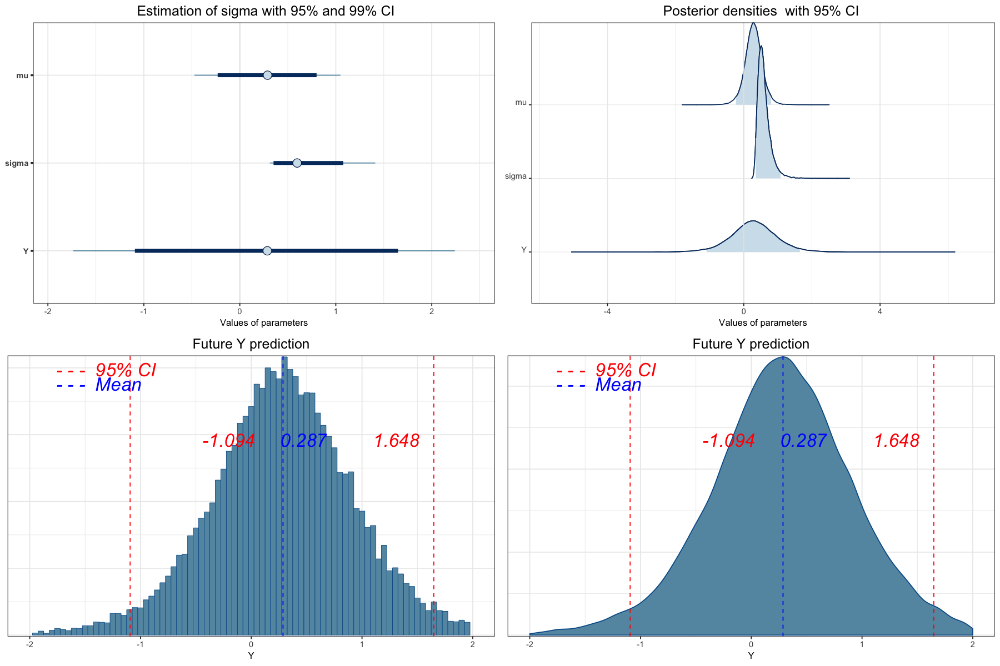

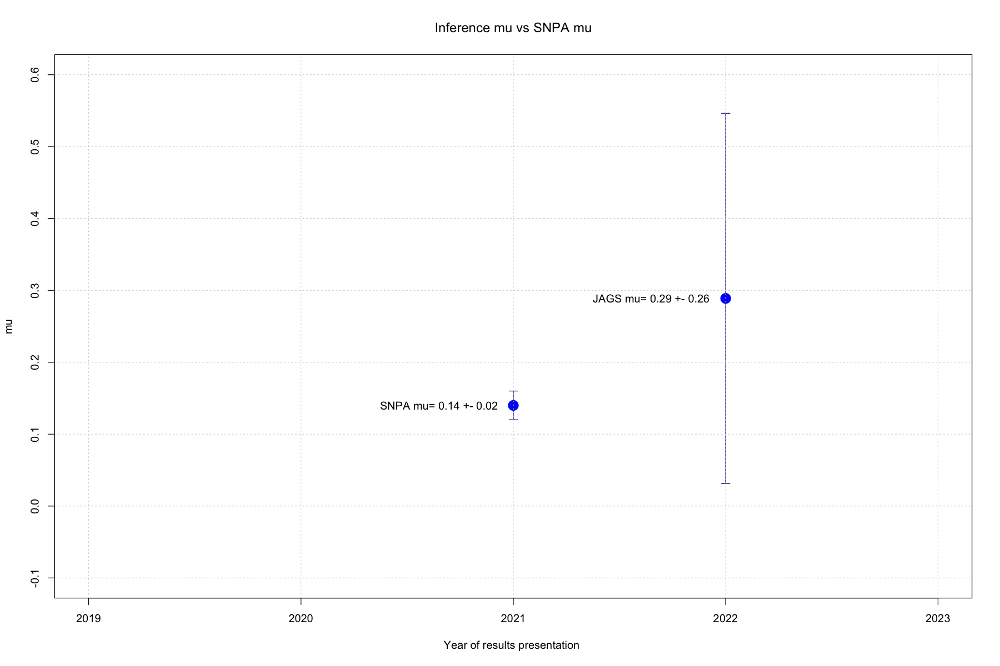

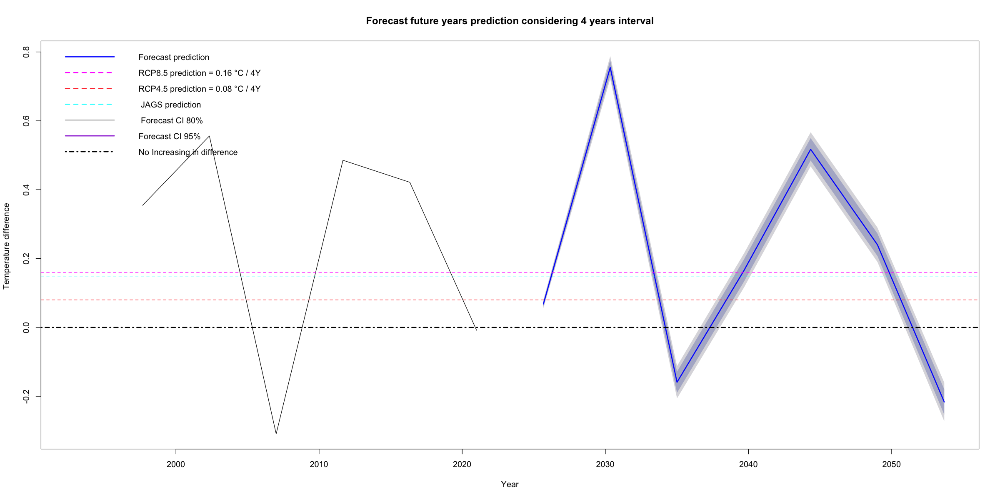

In [25]:
#create the dataframe
file<-"./Dati_temp_progetto/Castelfranco_Veneto.csv"
dfc<-import_data(file)


aggregatedc<-aggregate_data(dfc)

dfc<-aggregatedc[[1]]
df2c<-aggregatedc[[2]]


df2c_3<-four_years1(df2c)

jags_mean(df2c_3,columns=c("Means_measure_diff"),0.15,0.02)
jags_max_min(df2c_3,columns=c("Max_Temperature_diff"),0.17,0.02)
jags_max_min(df2c_3,columns=c("Min_Temperature_diff"),0.14,0.02)
forecast_(df2c_3,columns=c("Means_measure_diff"),0.149)

### ROVERCHIARA

### PART 1

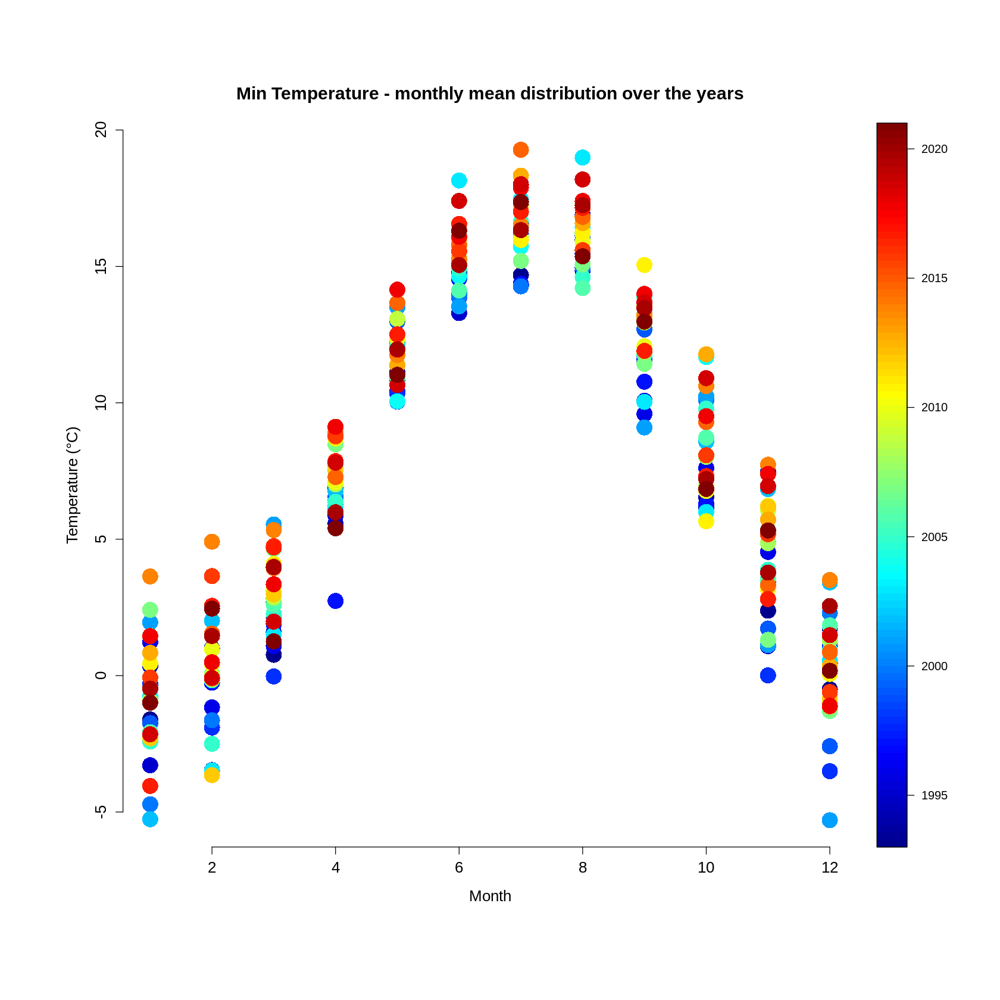

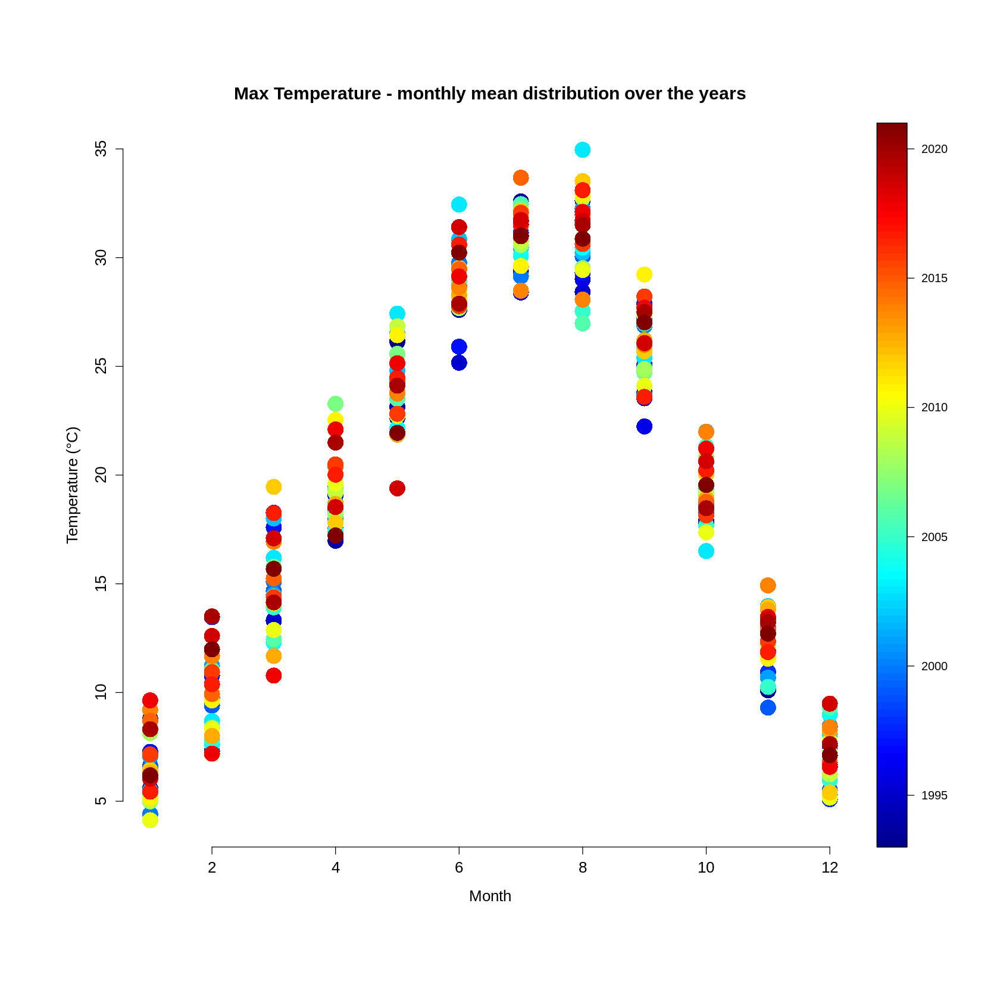

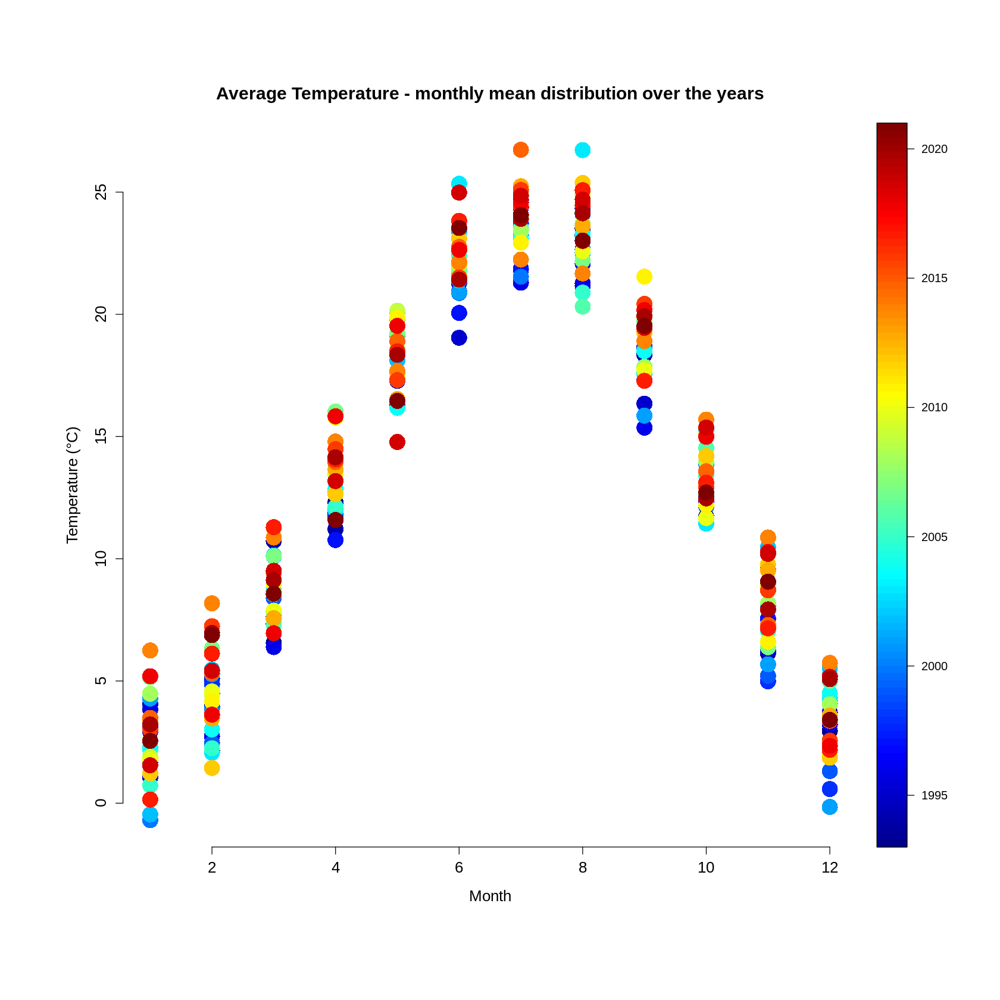

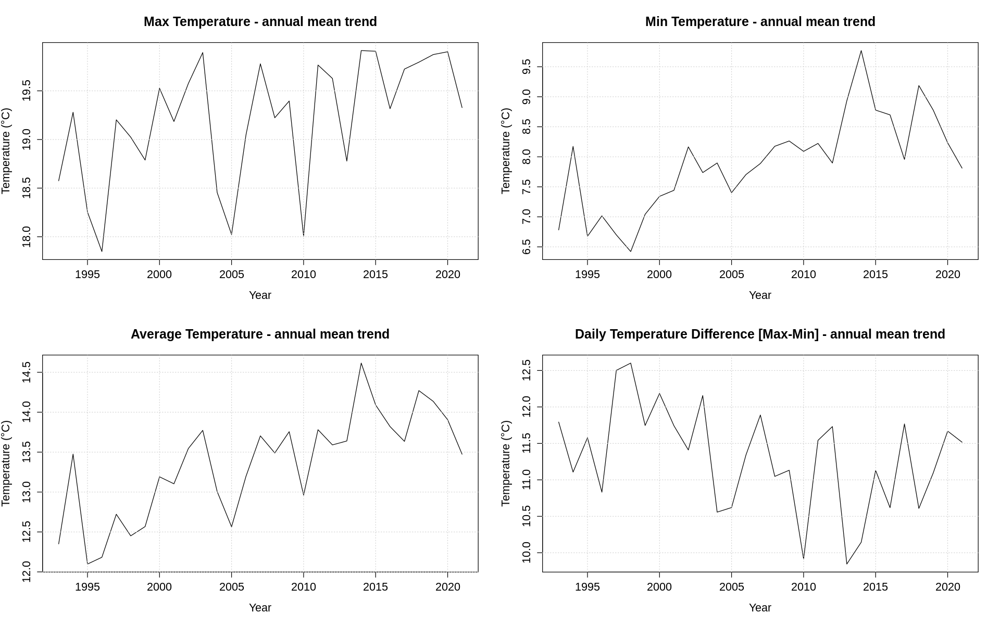

In [50]:
file<-"./Dati_temp_progetto/Roverchiara.csv"
df<-import_data(file)
aggregated<-aggregate_data(df)

df1<-aggregated[[1]]
df2<-aggregated[[2]]

preliminary_plots1(df1)
preliminary_plots2(df2)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3821c1a37b.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect     2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -72.200  18.411 -106.642 -84.609 -72.716 -60.800 -34.225 1.001  3000
beta       0.043   0.009    0.024   0.037   0.043   0.049   0.060 1.001  3000
sigma      0.469   0.070    0.357   0.420   0.462   0.509   0.631 1.001  3000
deviance  36.597   3.837   31.543  33.668  35.811  38.695  45.784 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 7.4 and DIC = 44.0
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b38fdba8b2.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     13.345   0.128 13.085 13.260 13.345 13.430 13.599 1.001  3000
sigma      0.684   0.097  0.527  0.614  0.671  0.742  0.905 1.001  3000
deviance  58.489   2.141 56.377 56.964 57.830 59.308 64.134 1.004   980

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.3 and DIC = 60.8
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 4.666294e-06 
Likelihood linear = 8.973445e-06 
Frequentist likelihood ratio (linear/constant) =  1.92 

Linear model is more suitable than constant!
HYPOTES

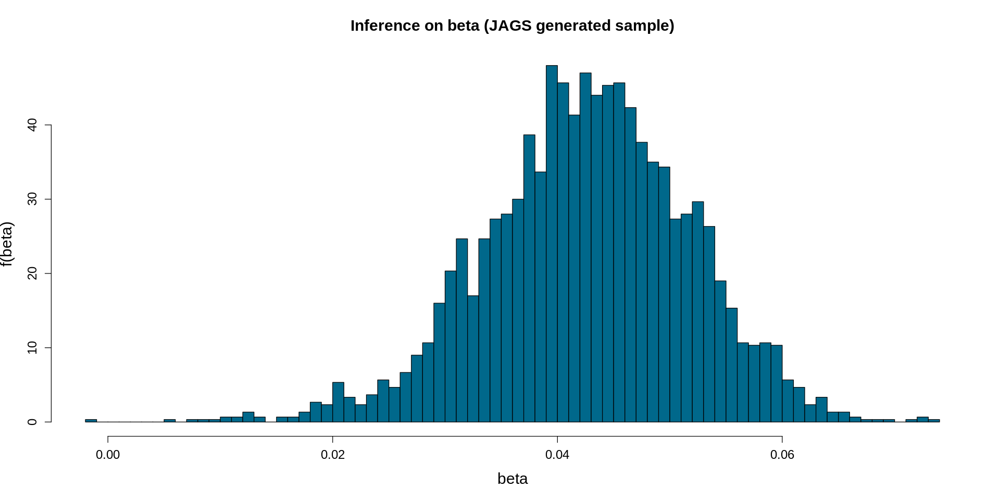

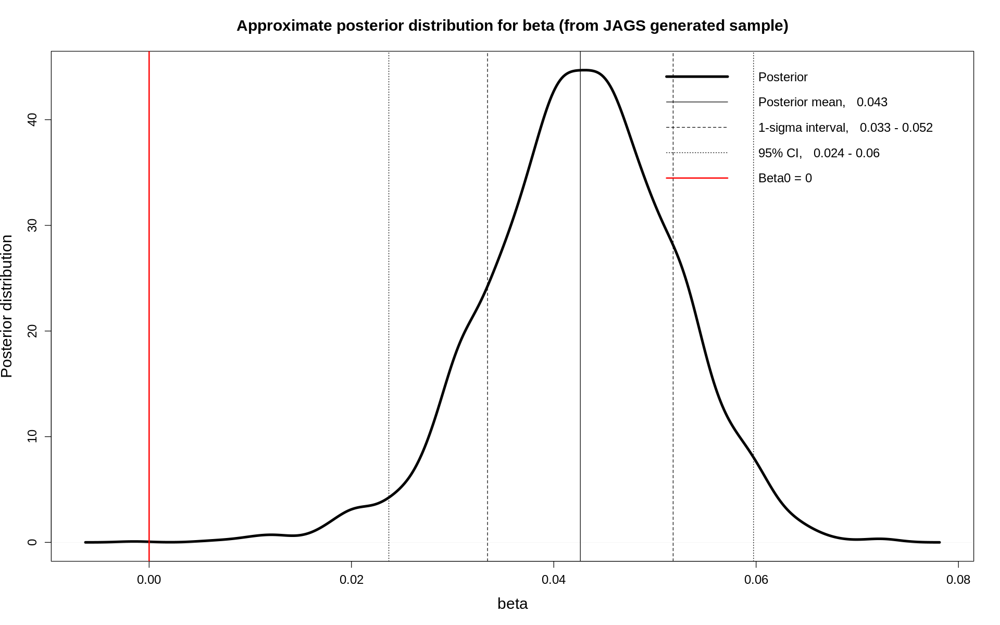

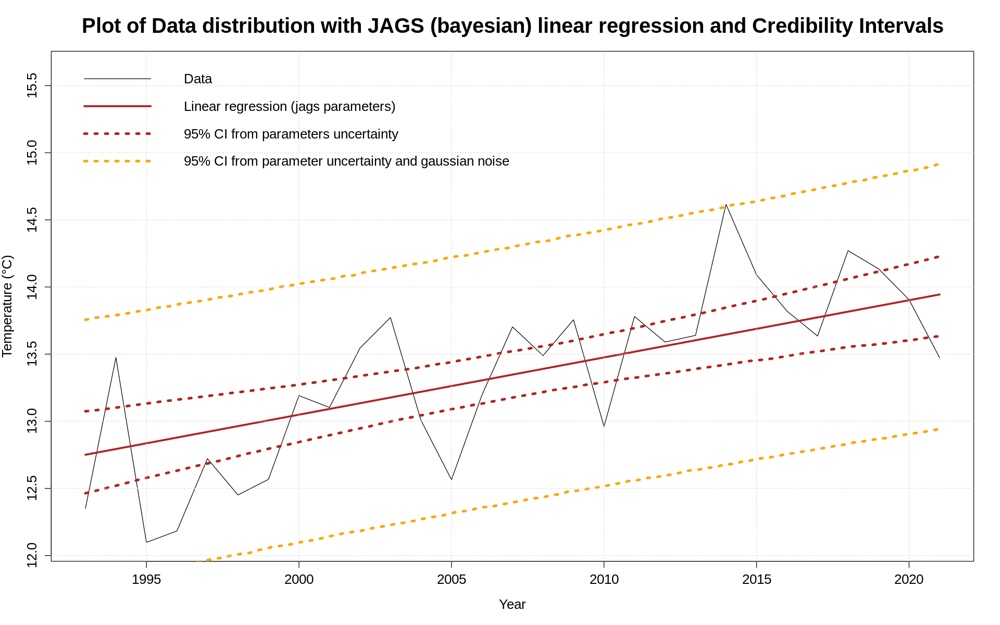

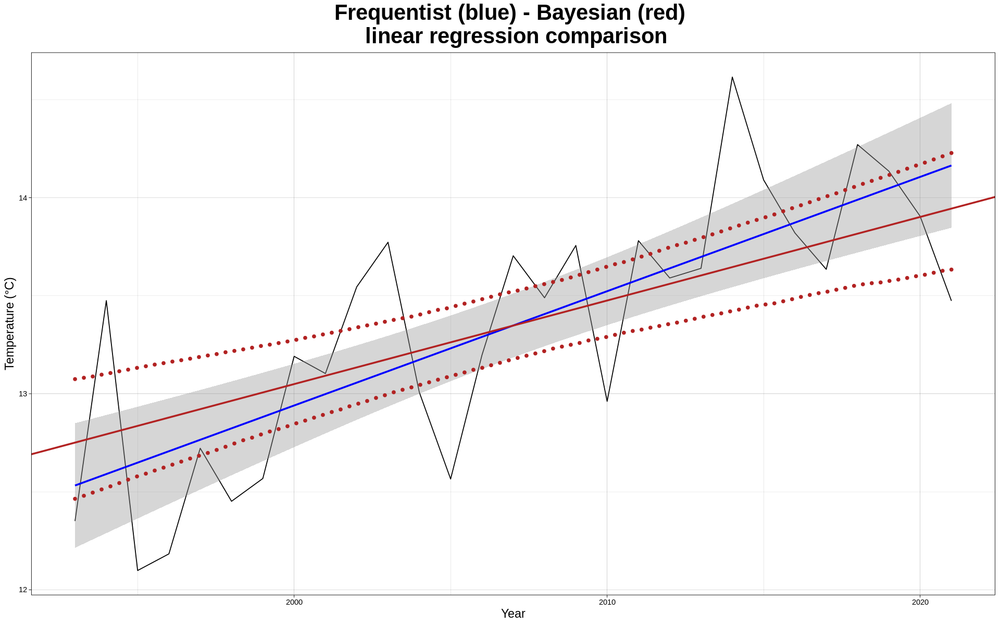

In [51]:
#Average
dataf <- df2[,c("Year", "Mean_Average_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b3879a2185d.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect     2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -74.696  22.837 -117.108 -90.064 -75.425 -60.089 -27.144 1.001  3000
beta       0.041   0.011    0.017   0.034   0.042   0.049   0.062 1.001  3000
sigma      0.622   0.099    0.468   0.552   0.610   0.678   0.858 1.001  3000
deviance  52.915   4.452   46.264  49.529  52.271  55.589  63.091 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 9.9 and DIC = 62.8
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b385640e727.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha      7.902   0.156  7.602  7.797  7.901  8.005  8.217 1.003   970
sigma      0.833   0.117  0.636  0.751  0.822  0.904  1.094 1.002  1900
deviance  70.182   2.078 68.087 68.669 69.538 71.136 75.563 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.2 and DIC = 72.3
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 3.448847e-06 
Likelihood linear = 6.679719e-06 
Frequentist likelihood ratio (linear/constant) =  1.94 

Linear model is more suitable than constant!
HYPOTE

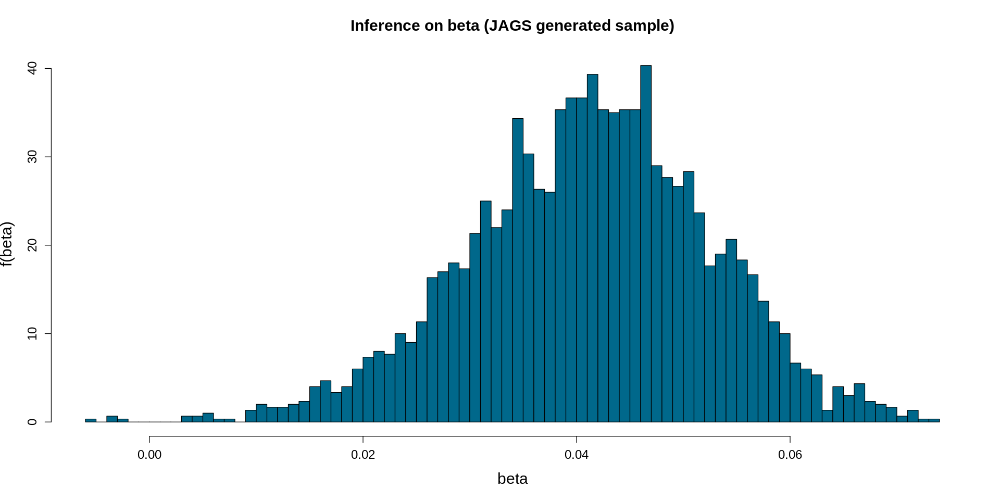

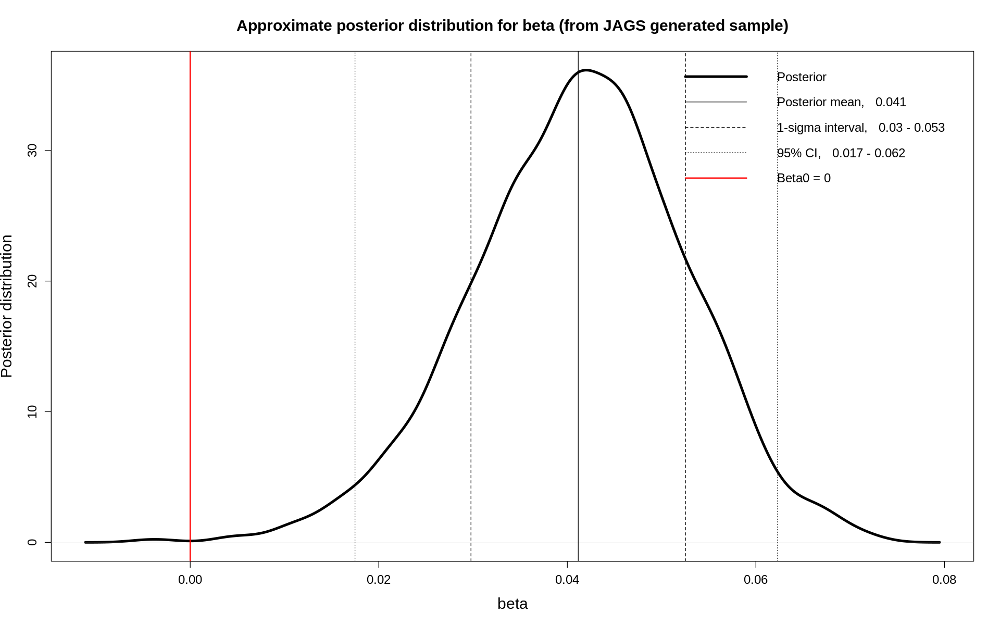

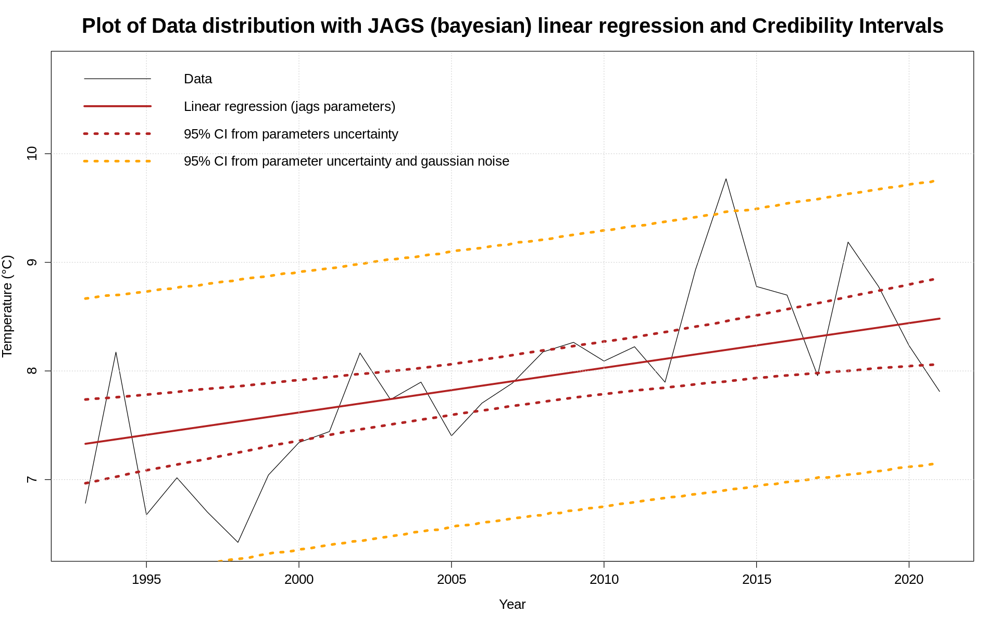

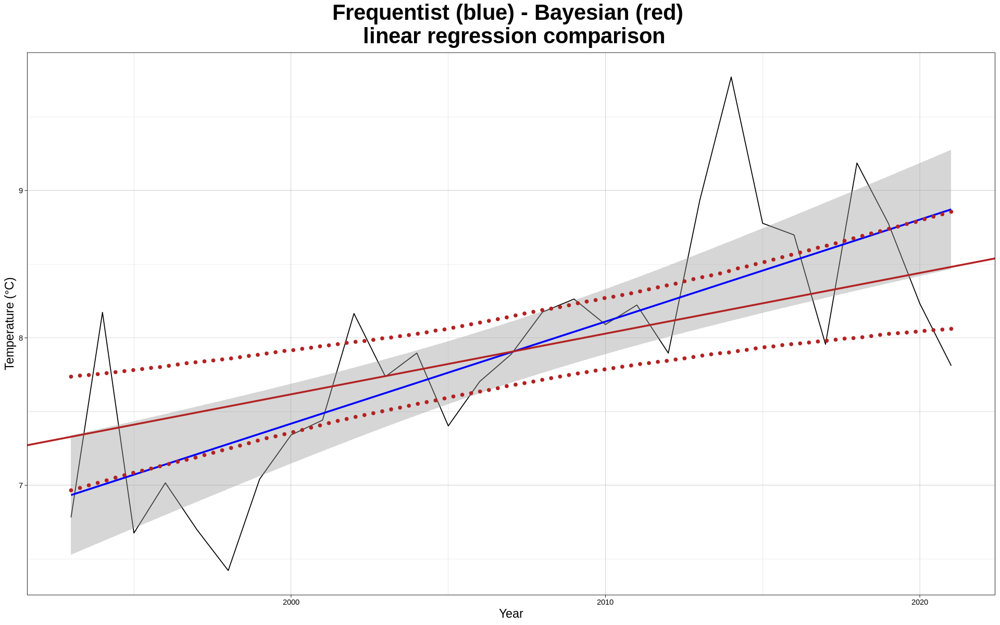

In [52]:
#Min
dataf <- df2[,c("Year", "Mean_Min_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b385776c5da.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%  97.5%  Rhat n.eff
alpha    -35.077  20.117 -74.087 -48.542 -35.471 -21.868  5.910 1.003   860
beta       0.027   0.010   0.007   0.020   0.027   0.034  0.046 1.003   860
sigma      0.578   0.085   0.443   0.518   0.568   0.627  0.771 1.001  3000
deviance  49.120   2.786  45.719  46.979  48.436  50.611 56.301 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 3.9 and DIC = 53.0
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = alpha)


Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpxtGy3m/model6b385d02d6d0.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     19.207   0.123 18.974 19.126 19.202 19.289 19.455 1.001  3000
sigma      0.660   0.094  0.503  0.594  0.649  0.714  0.879 1.001  3000
deviance  56.635   2.156 54.526 55.068 55.974 57.522 62.270 1.002  1900

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.3 and DIC = 59.0
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 4.314045e-06 
Likelihood linear = 6.177449e-06 
Frequentist likelihood ratio (linear/constant) =  1.43 

Linear model is more suitable than constant!
HYPOTE

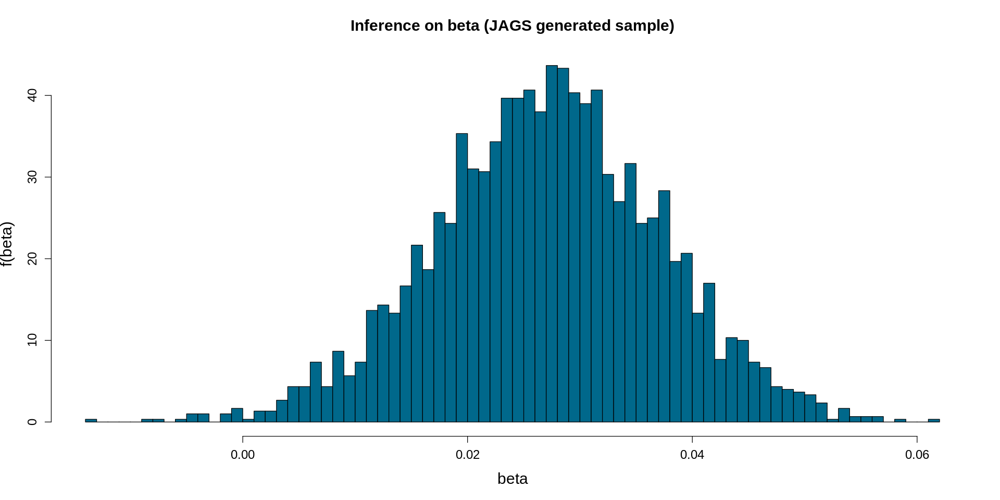

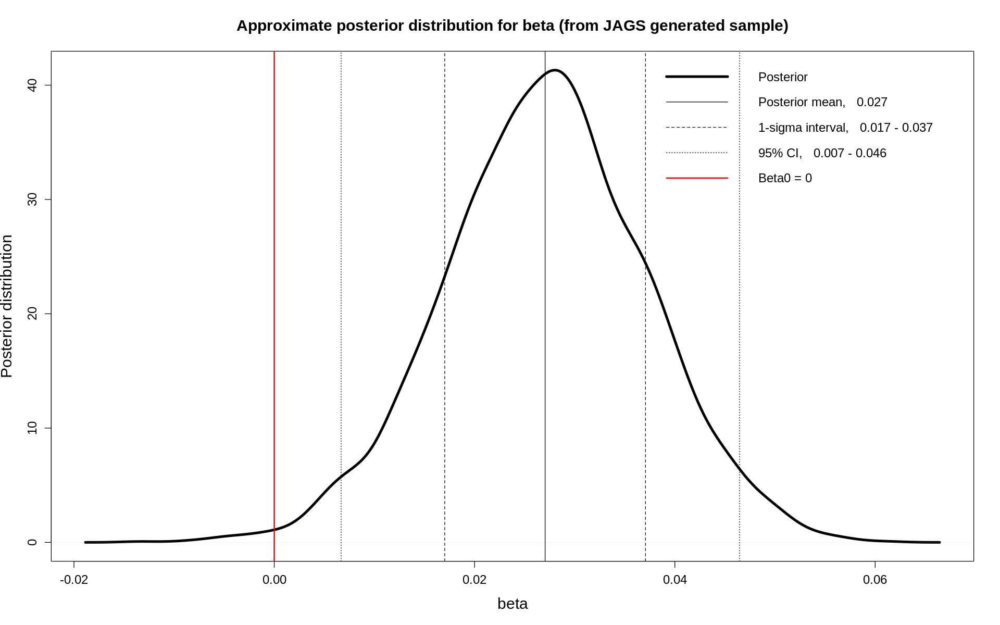

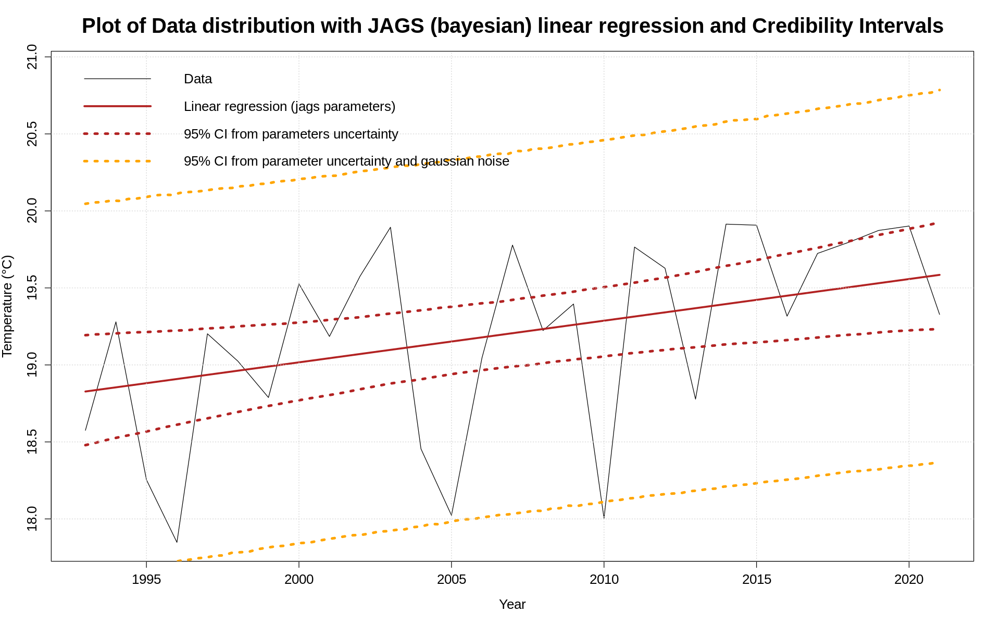

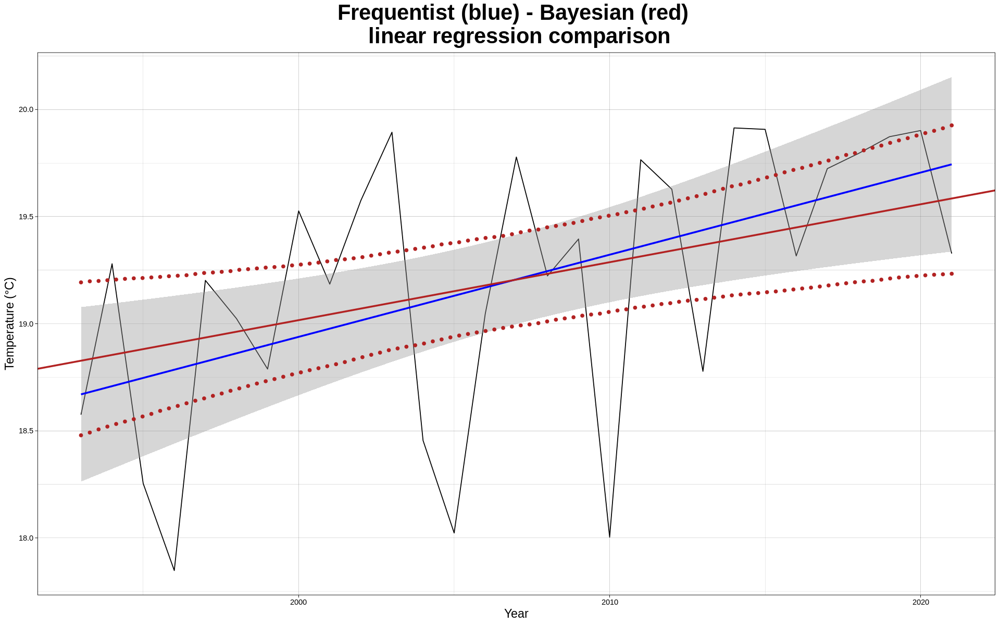

In [53]:
#Max
dataf <- df2[,c("Year", "Mean_Max_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)

### PART 2

Warning message:
“Factor `period` contains implicit NA, consider using `forcats::fct_explicit_na`”

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean      SD  Naive SE Time-series SE
Y     0.2453 0.32308 0.0018653      0.0018725
mu    0.2431 0.12183 0.0007034      0.0007076
sigma 0.2838 0.09153 0.0005284      0.0006255

2. Quantiles for each variable:

            2.5%     25%    50%    75%  97.5%
Y     -0.4002935 0.05146 0.2451 0.4382 0.8918
mu    -0.0002578 0.16986 0.2435 0.3159 0.4856
sigma  0.1663605 0.22161 0.2653 0.3232 0.5162



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


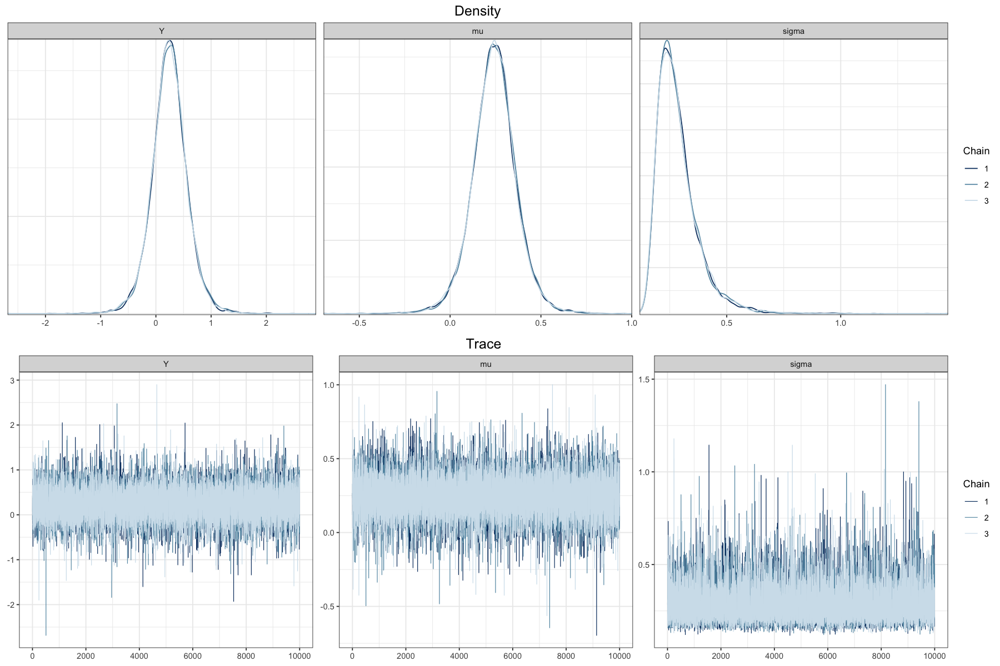

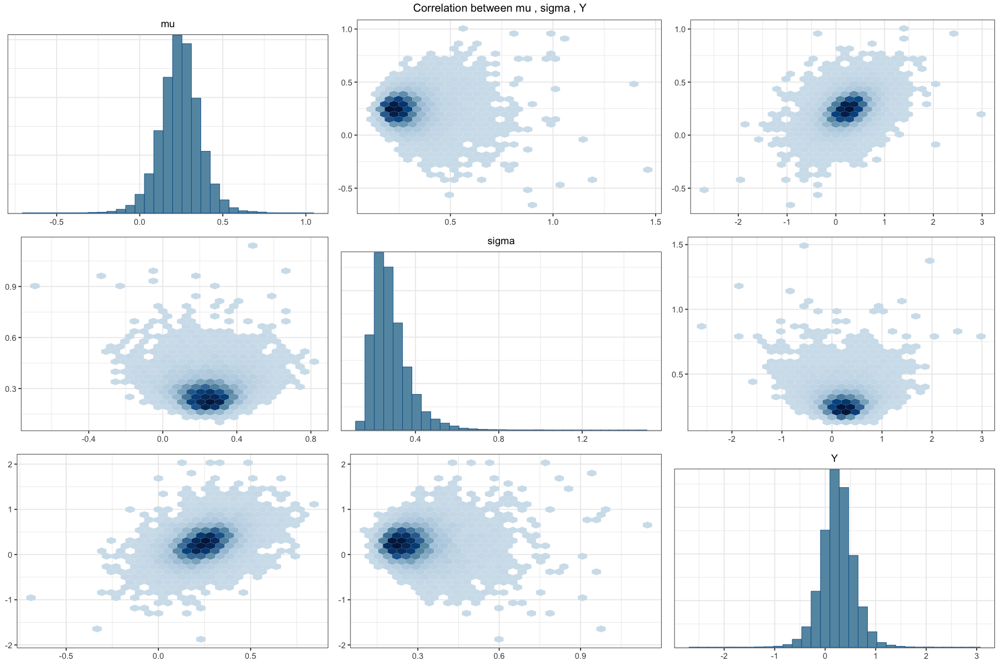

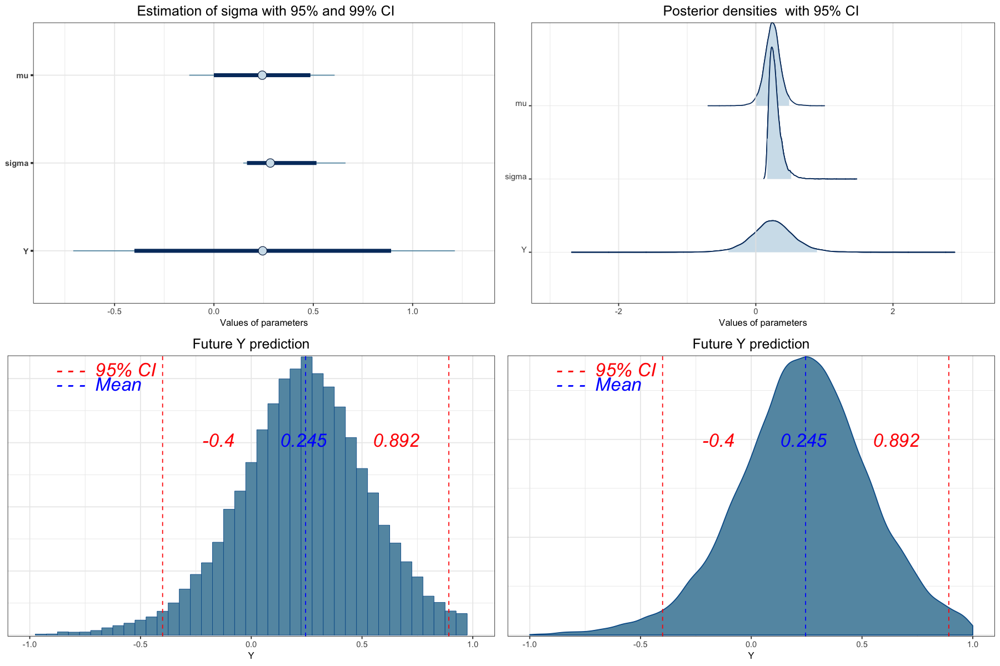

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean      SD  Naive SE Time-series SE
Y     0.2234 0.32168 0.0018572      0.0018478
mu    0.2223 0.12170 0.0007026      0.0006993
sigma 0.2821 0.09207 0.0005316      0.0006635

2. Quantiles for each variable:

          2.5%     25%    50%    75%  97.5%
Y     -0.41076 0.03161 0.2235 0.4158 0.8668
mu    -0.02154 0.14866 0.2226 0.2957 0.4635
sigma  0.16639 0.22102 0.2633 0.3216 0.5055



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


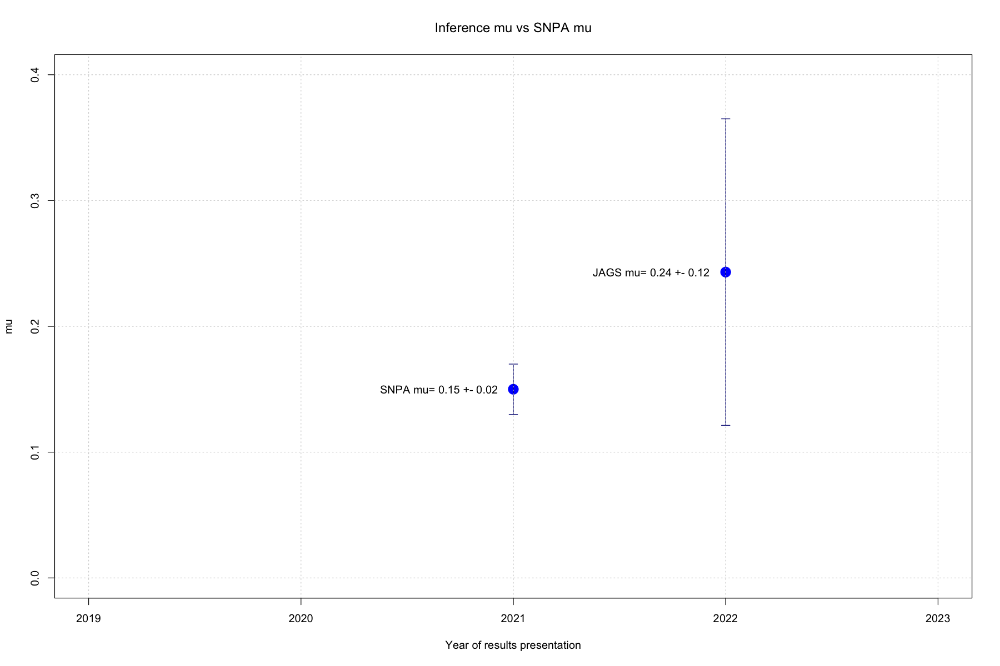

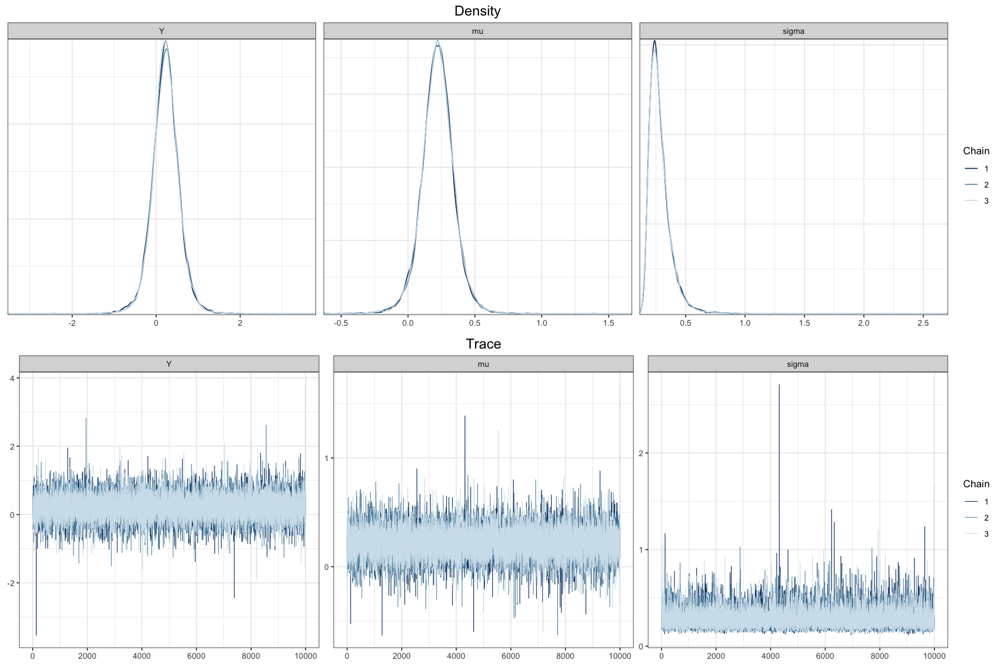

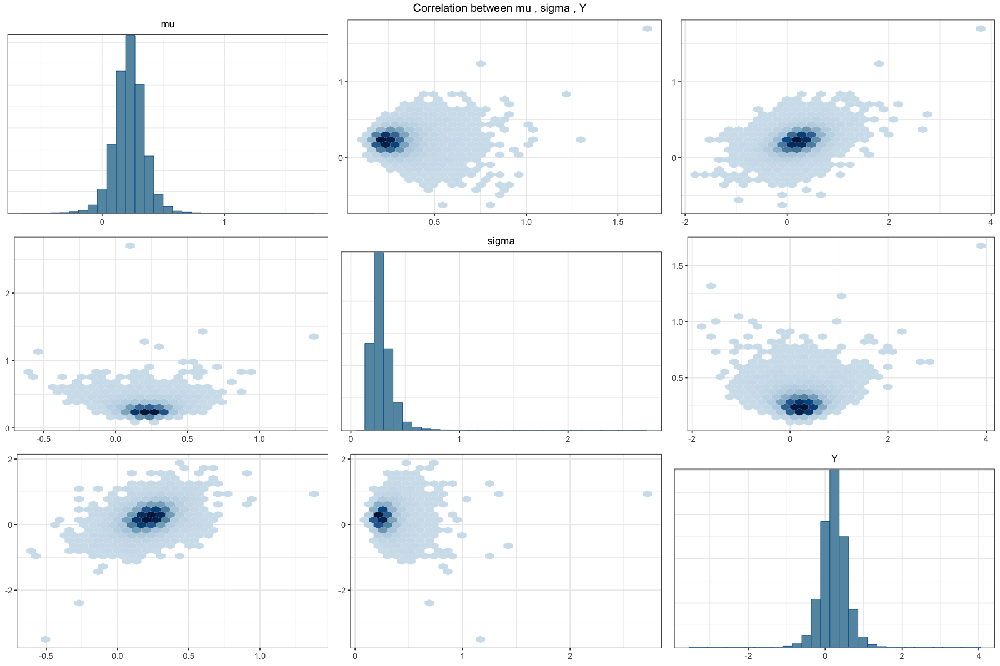

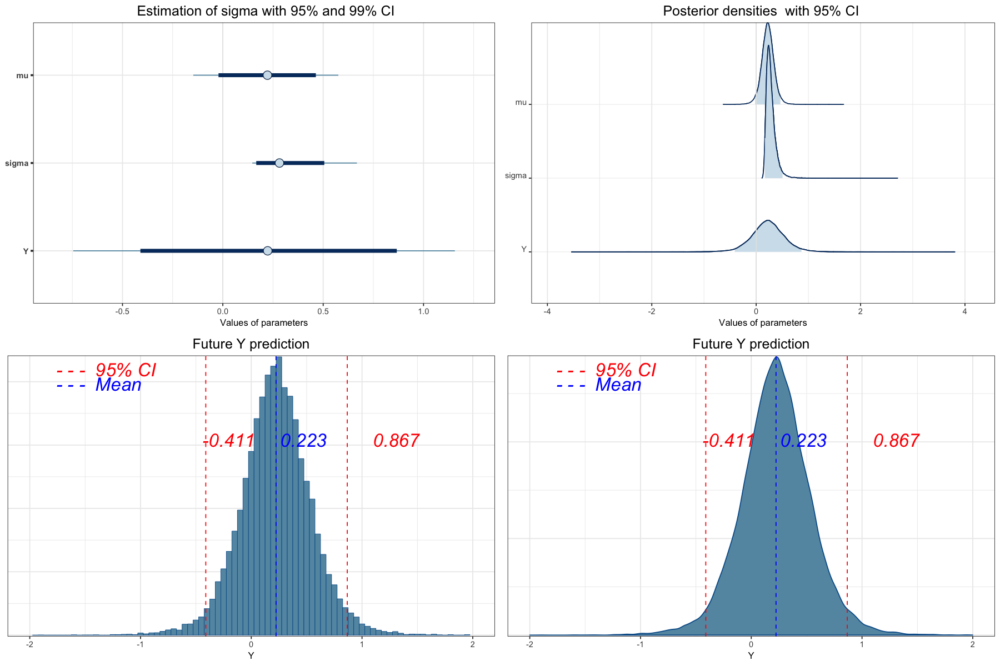

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD Naive SE Time-series SE
Y     0.2302 0.6605 0.003813       0.003823
mu    0.2261 0.2482 0.001433       0.001433
sigma 0.5788 0.1874 0.001082       0.001273

2. Quantiles for each variable:

         2.5%      25%    50%    75%  97.5%
Y     -1.0815 -0.16850 0.2325 0.6270 1.5586
mu    -0.2815  0.07779 0.2288 0.3746 0.7224
sigma  0.3408  0.45154 0.5394 0.6591 1.0446



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.


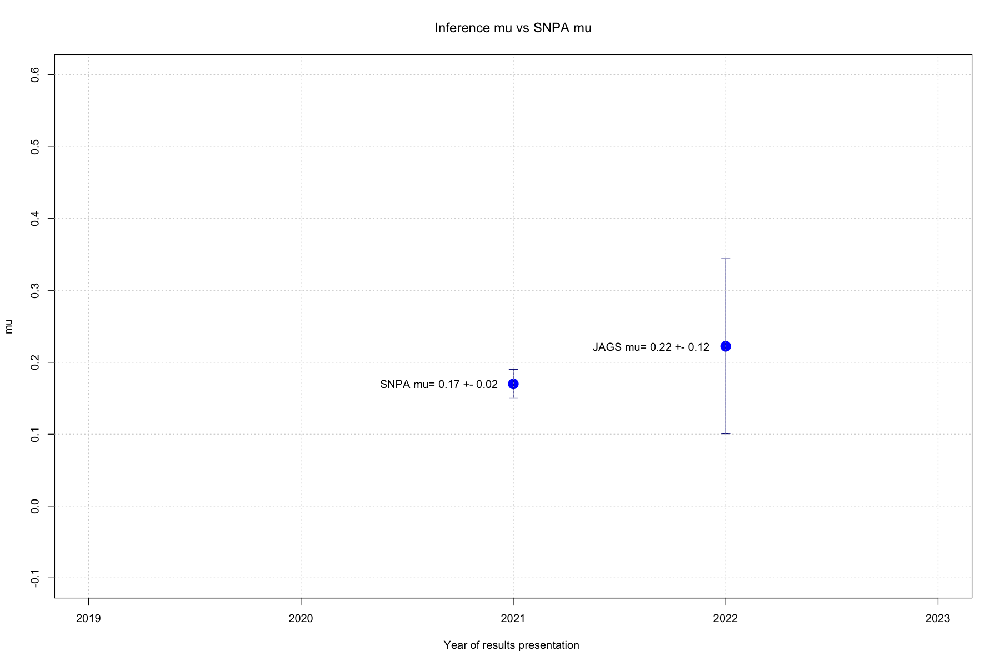

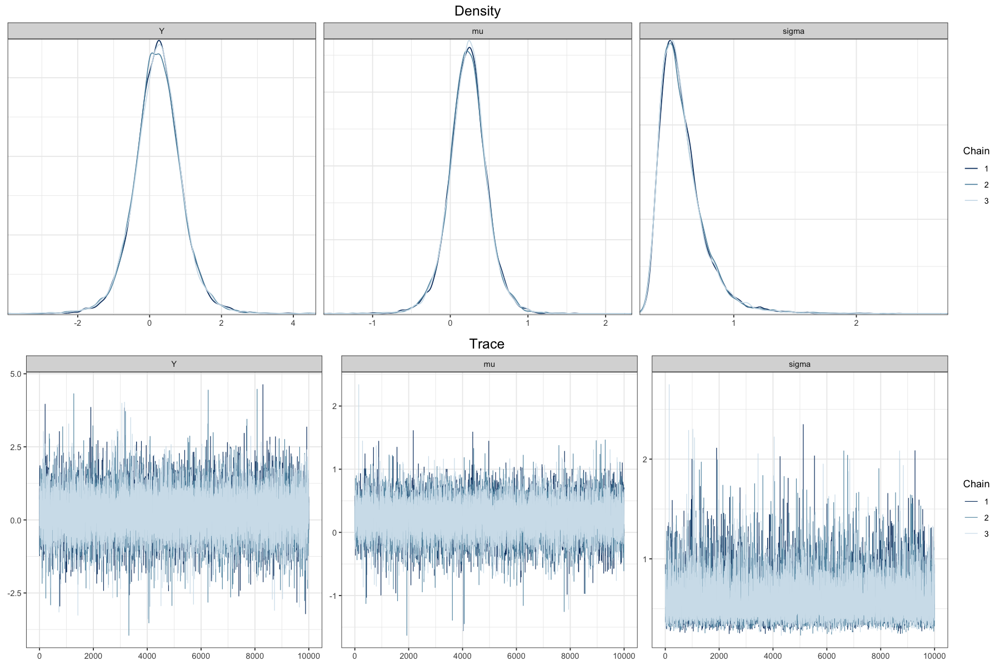

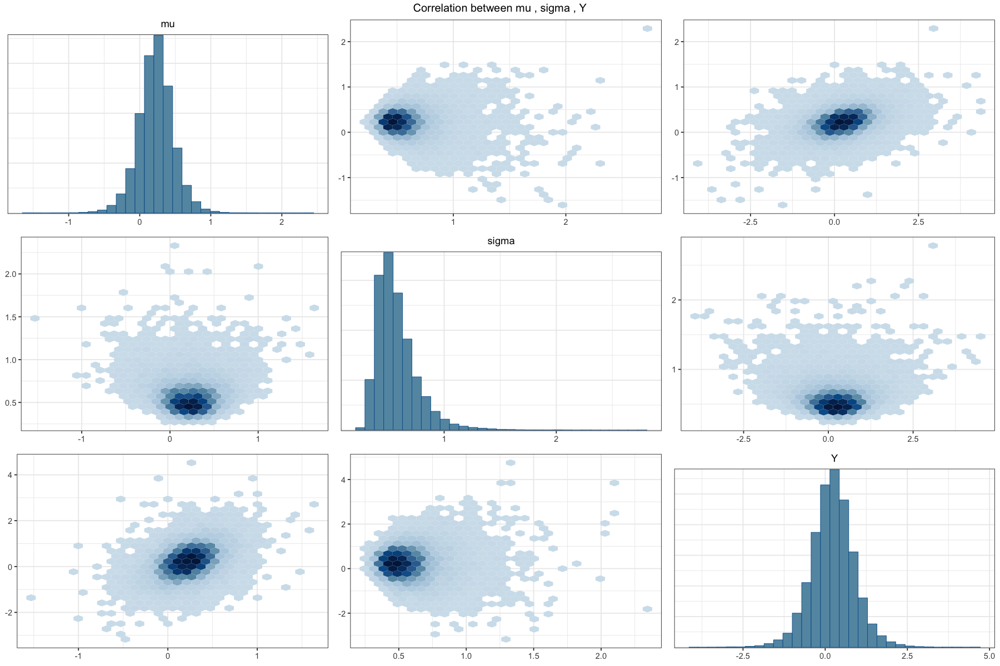

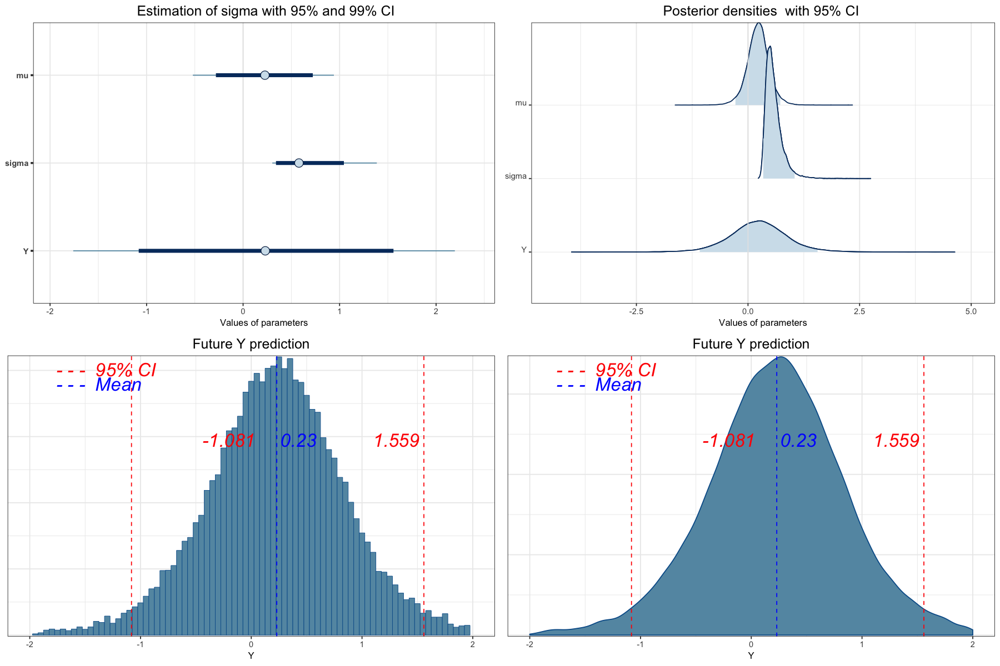

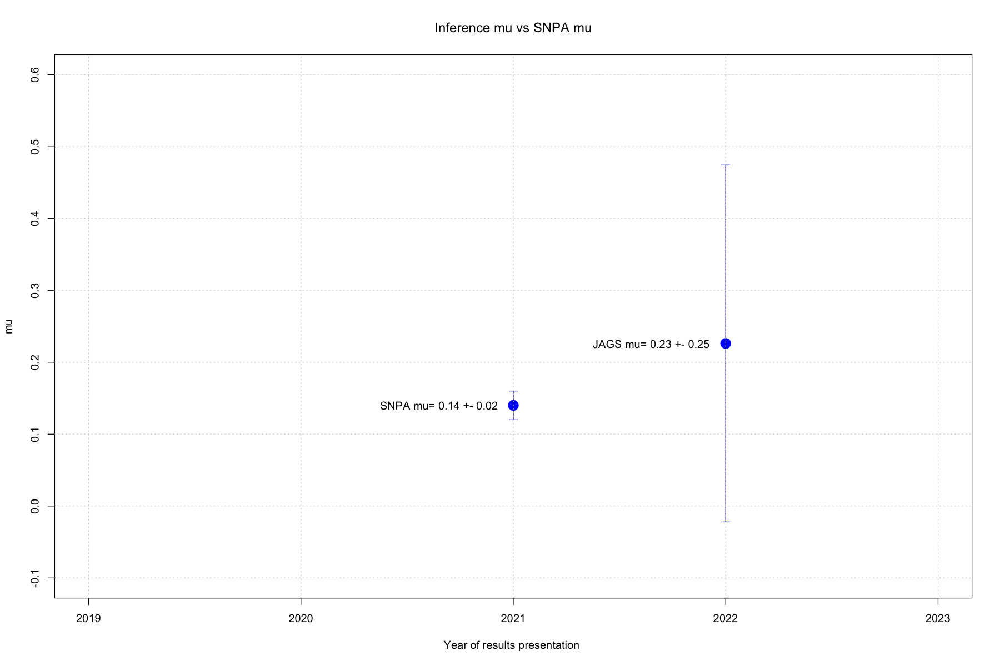

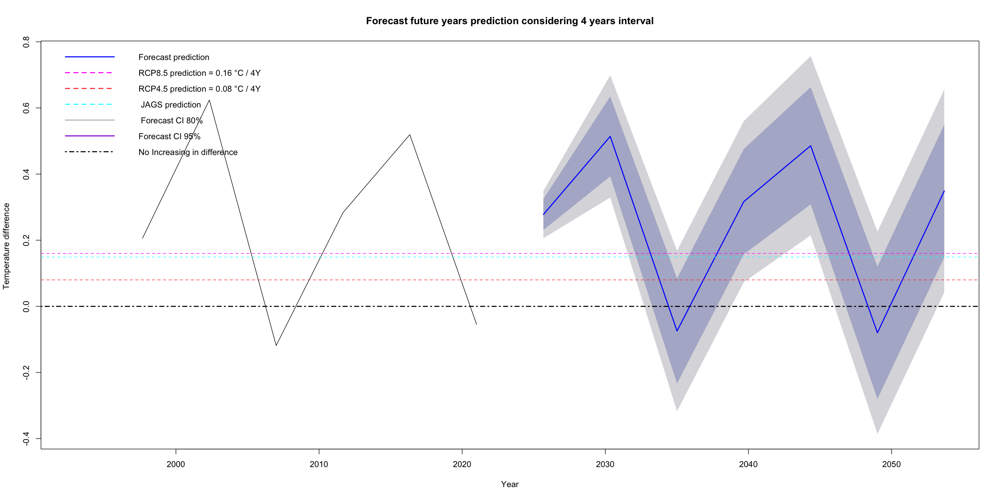

In [26]:
#create the dataframe
file<-"./Dati_temp_progetto/Roverchiara.csv"
dfr<-import_data(file)


aggregatedr<-aggregate_data(dfr)

dfr<-aggregatedr[[1]]
df2r<-aggregatedr[[2]]


df2r_3<-four_years1(df2r)

jags_mean(df2r_3,columns=c("Means_measure_diff"),0.15,0.02)
jags_max_min(df2r_3,columns=c("Max_Temperature_diff"),0.17,0.02)
jags_max_min(df2r_3,columns=c("Min_Temperature_diff"),0.14,0.02)
forecast_(df2r_3,columns=c("Means_measure_diff"),0.149)


# APPENDIX 2: GLOBAL CONSIDERATIONS

We perform now an average among the data from the various considered stations. The above exposed analysis is repeated on these data, in order to obtain global information about the temperature trends in Veneto.

In [38]:
import_data<-function(filename, name)
{ 
    df<- read.csv(filename)
    df$date <- as.Date(df$date)
    df<-subset(df, date >= as.Date('1993-01-01') & date <= as.Date('2021-12-31'))
    
    df<-data.frame(Date=df$date, "Max_Temperature"=df$TMAX, "Min_Temperature"=df$TMIN, "Mean_Temperature"=df$TMED)
  
    return(df)
}

df_list <- list(import_data("./Dati_temp_progetto/Auronzo.csv", "Auronzo"), 
                import_data("./Dati_temp_progetto/Castelfranco_Veneto.csv"), 
                import_data("./Dati_temp_progetto/Porto_Tolle.csv"), 
                import_data("./Dati_temp_progetto/Roverchiara.csv"))
df_list <- df_list %>% reduce(full_join, by='Date')

df_list <- df_list %>% rowwise() %>% mutate(Avg_Max_Temperature = mean(c(Max_Temperature.x,Max_Temperature.y,Max_Temperature.x.x,Max_Temperature.y.y)))
df_list <- df_list %>% rowwise() %>% mutate(Avg_Min_Temperature = mean(c(Min_Temperature.x,Min_Temperature.y,Min_Temperature.x.x,Min_Temperature.y.y)))
df_list <- df_list %>% rowwise() %>% mutate(Avg_Mean_Temperature = mean(c(Mean_Temperature.x,Mean_Temperature.y,Mean_Temperature.x.x,Mean_Temperature.y.y)))



df_list$Year = lubridate::year(df_list$Date)
df_list$Month = lubridate::month(df_list$Date)
df_list$Week = lubridate::week(df_list$Date)


#Dataframe with only global averages
global_avg<-df_list[,14:19]
head(global_avg)


Avg_Max_Temperature,Avg_Min_Temperature,Avg_Mean_Temperature,Year,Month,Week
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3.225,-6.150,-2.271100,1993,1,1
-1.175,-7.925,-4.554175,1993,1,1
1.025,-5.050,-1.743225,1993,1,1
1.300,-7.275,-3.441650,1993,1,1
2.625,-9.650,-4.746350,1993,1,1
5.550,-9.675,-2.784625,1993,1,1


In [39]:
#Aggregate data: annual mean
global_avg2<-aggregate( .~Year, data=global_avg, mean)
global_avg2<-data.frame("Year"=global_avg2$Year,
                    "Mean_Max_Temperature"=global_avg2$Avg_Max_Temperature,
                    "Mean_Min_Temperature"=global_avg2$Avg_Min_Temperature,
                    "Mean_Average_Temperature"=global_avg2$Avg_Mean_Temperature
                    )
head(global_avg2)

,Year,Mean_Max_Temperature,Mean_Min_Temperature,Mean_Average_Temperature
,<dbl>,<dbl>,<dbl>,<dbl>
1,1993,17.14095,5.558459,10.97108
2,1994,17.99651,7.027134,12.15104
3,1995,17.02815,5.697751,10.93764
4,1996,16.56039,5.950002,10.96750
5,1997,17.94548,6.028844,11.60970
6,1998,17.84068,5.673481,11.31424


### PART 1


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e39b7dd60.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -62.556  17.665 -95.472 -74.529 -63.582 -50.952 -25.689 1.002  1500
beta       0.037   0.009   0.019   0.031   0.038   0.043   0.054 1.002  1800
sigma      0.446   0.066   0.337   0.399   0.439   0.484   0.591 1.002  1700
deviance  33.786   3.406  29.375  31.191  33.008  35.671  42.452 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 5.8 and DIC = 39.6
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = al

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e300d069f.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     11.974   0.114 11.748 11.899 11.976 12.052 12.189 1.001  3000
sigma      0.614   0.087  0.472  0.552  0.606  0.666  0.807 1.001  3000
deviance  52.273   2.076 50.193 50.747 51.653 53.160 57.574 1.004  2300

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.2 and DIC = 54.4
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 5.05725e-06 
Likelihood linear = 9.601178e-06 
Frequentist likelihood ratio (linear/constant) =  1.9 

Linear model is more suitable than constant!
HYPOTESI

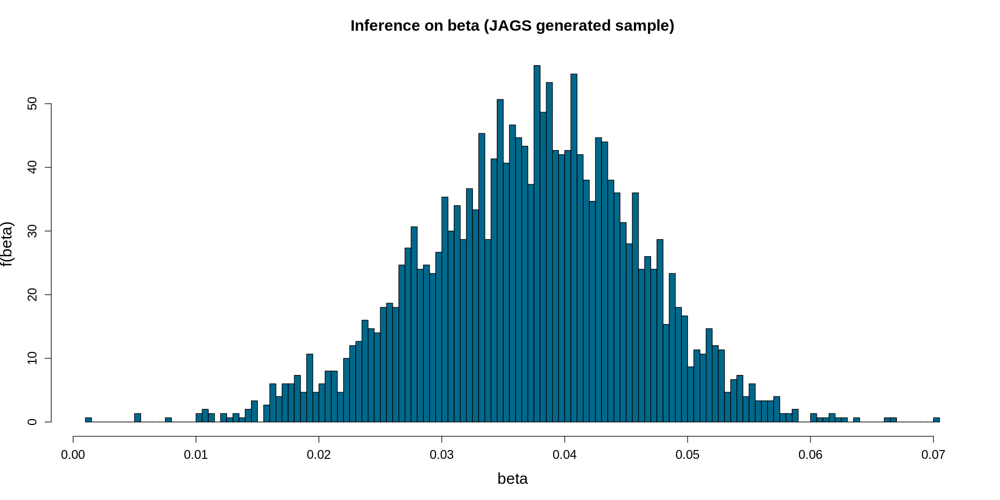

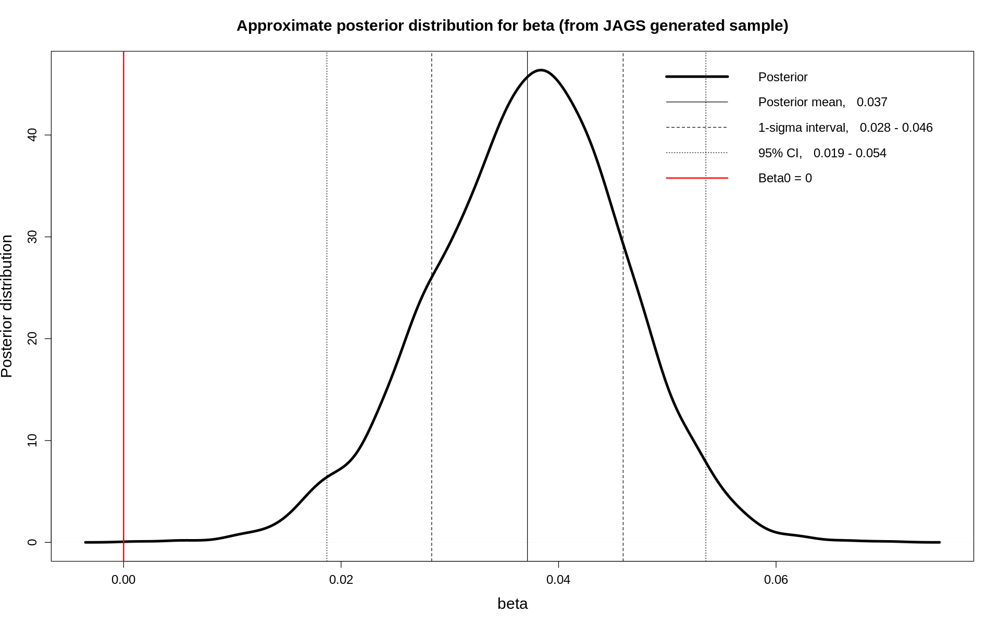

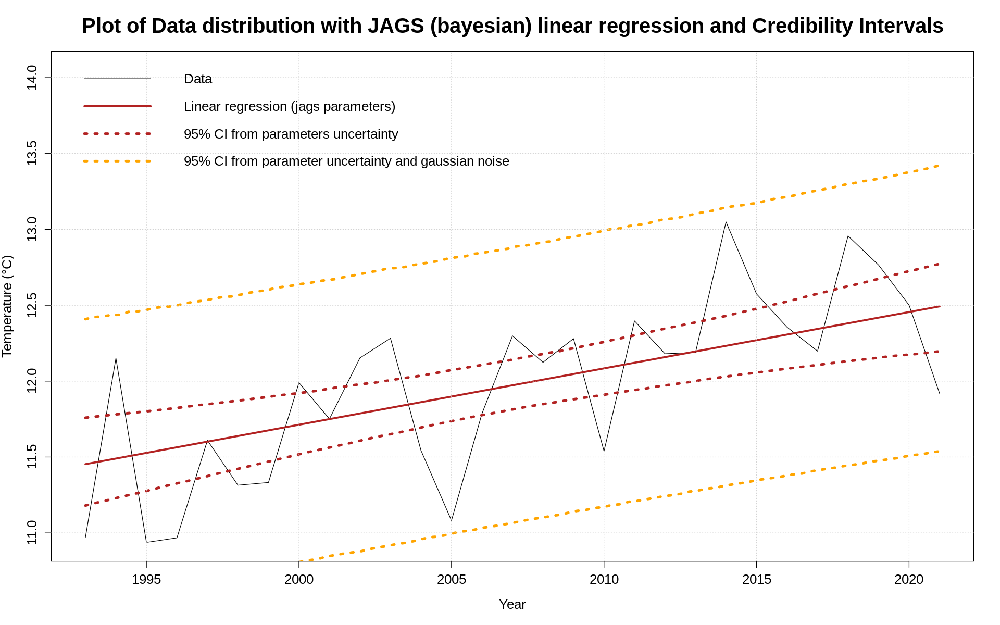

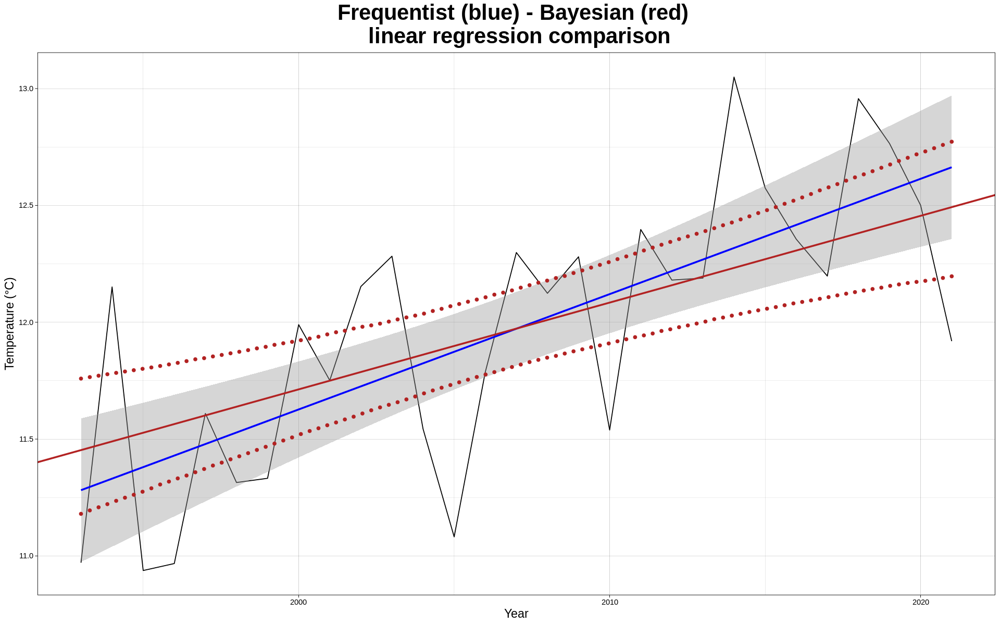

In [40]:
#Average
dataf <- global_avg2[,c("Year", "Mean_Average_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e791bddc9.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect     2.5%     25%     50%     75%   97.5%  Rhat n.eff
alpha    -75.086  20.925 -113.925 -89.168 -75.928 -61.333 -31.787 1.004   650
beta       0.041   0.010    0.019   0.034   0.041   0.048   0.060 1.004   650
sigma      0.555   0.085    0.419   0.495   0.545   0.603   0.751 1.002  1500
deviance  46.263   4.065   40.465  43.141  45.542  48.653  55.838 1.005   440

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 8.2 and DIC = 54.5
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature

Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e55656374.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha      6.794   0.144  6.507  6.696  6.793  6.888  7.070 1.002  1400
sigma      0.760   0.108  0.587  0.682  0.749  0.824  0.993 1.001  3000
deviance  64.776   2.154 62.632 63.234 64.153 65.639 70.396 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.3 and DIC = 67.1
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 3.890455e-06 
Likelihood linear = 7.550019e-06 
Frequentist likelihood ratio (linear/constant) =  1.94 

Linear model is more suitable than constant!
HYPOTE

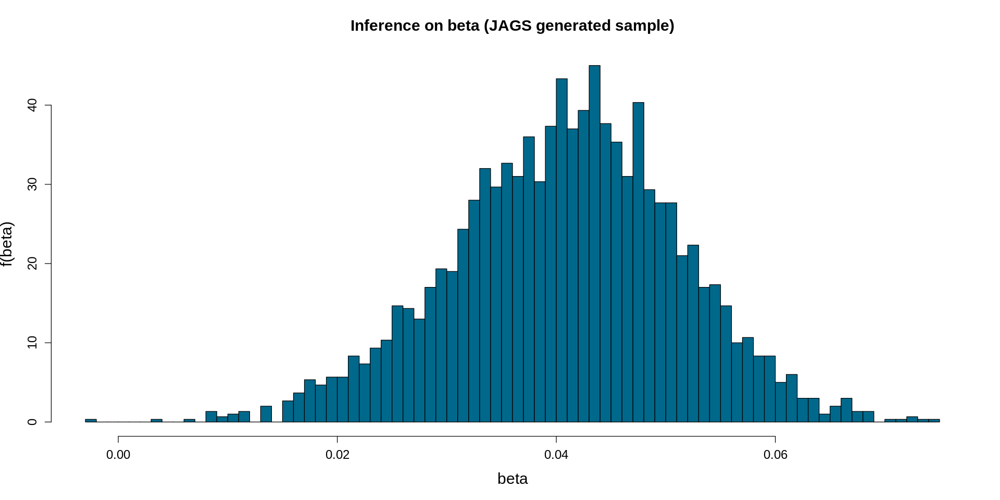

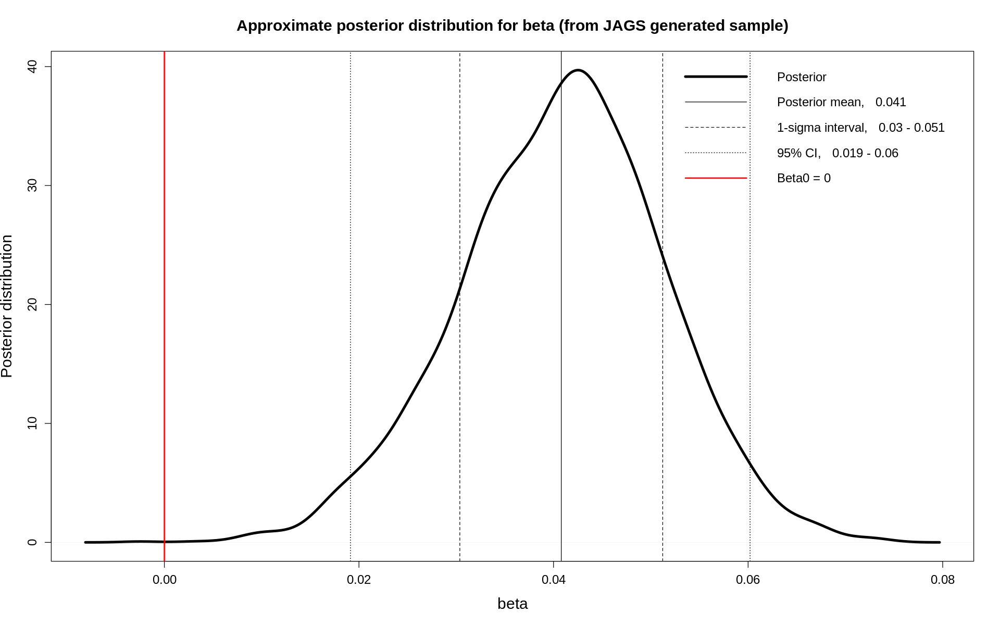

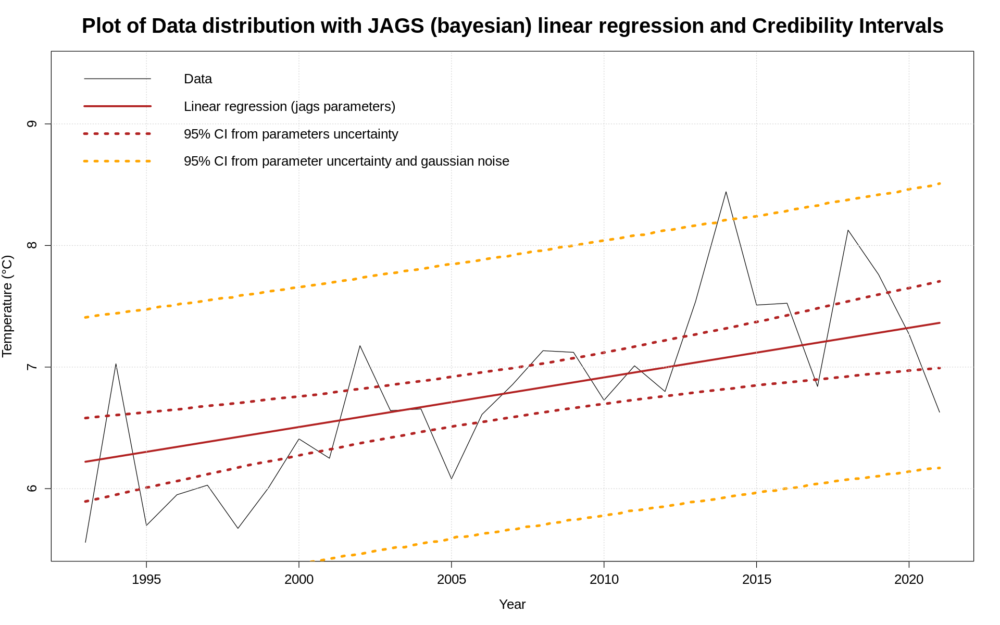

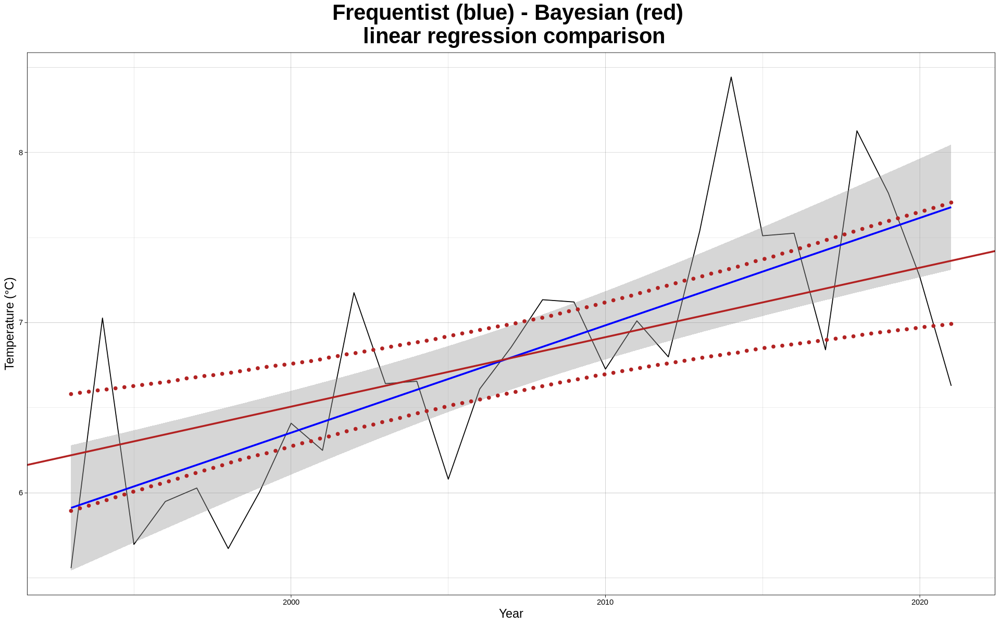

In [41]:
#Min
dataf <- global_avg2[,c("Year", "Mean_Min_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)


BAYESIAN LINEAR REGRESSION WITH JAGS (Temperature = alpha +beta*Year)
Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e4fcfe45c.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect    2.5%     25%     50%     75%  97.5%  Rhat n.eff
alpha    -31.089  20.139 -68.788 -44.828 -31.399 -18.048 10.834 1.001  3000
beta       0.024   0.010   0.004   0.018   0.025   0.031  0.043 1.001  3000
sigma      0.573   0.081   0.436   0.516   0.565   0.622  0.757 1.004   650
deviance  48.383   2.644  45.220  46.460  47.776  49.630 55.128 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 3.5 and DIC = 51.9
DIC is an estimate of expected predictive error (lower deviance is better).

BAYESIAN CONSTANT REGRESSION WITH JAGS (Temperature = alpha)


Warning message in jags.model(model.file, data = data, inits = init.values, n.chains = n.chains, :
“Unused variable "Year" in data”


Inference for Bugs model at "/tmp/RtmpRb2Dcr/model118e73f0912f.txt", fit using jags,
 3 chains, each with 12000 iterations (first 2000 discarded), n.thin = 10
 n.sims = 3000 iterations saved
         mu.vect sd.vect   2.5%    25%    50%    75%  97.5%  Rhat n.eff
alpha     17.903   0.118 17.675 17.824 17.902 17.983 18.134 1.001  3000
sigma      0.636   0.091  0.485  0.572  0.626  0.689  0.847 1.001  3000
deviance  54.490   2.077 52.362 52.974 53.843 55.403 59.909 1.001  3000

For each parameter, n.eff is a crude measure of effective sample size,
and Rhat is the potential scale reduction factor (at convergence, Rhat=1).

DIC info (using the rule, pD = var(deviance)/2)
pD = 2.2 and DIC = 56.6
DIC is an estimate of expected predictive error (lower deviance is better).

MODEL COMPARISON: SUITABILITY OF LINEAR MODEL
Likelihood constant = 4.526645e-06 
Likelihood linear = 6.947738e-06 
Frequentist likelihood ratio (linear/constant) =  1.53 

Linear model is more suitable than constant!
HYPOTE

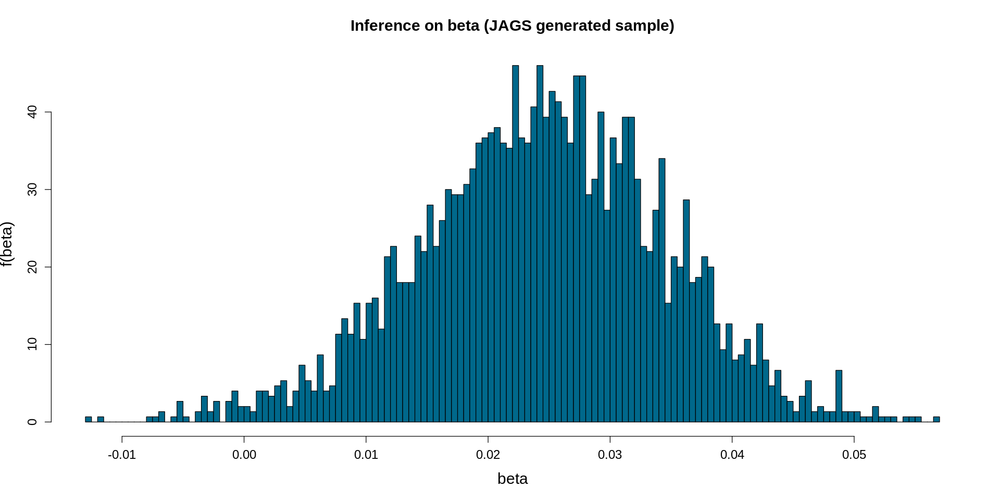

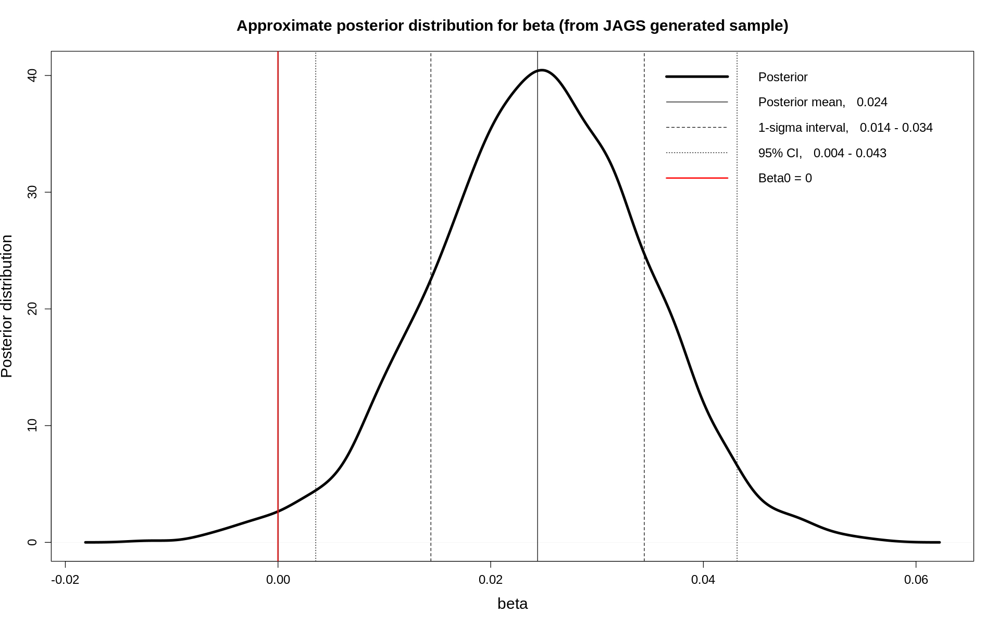

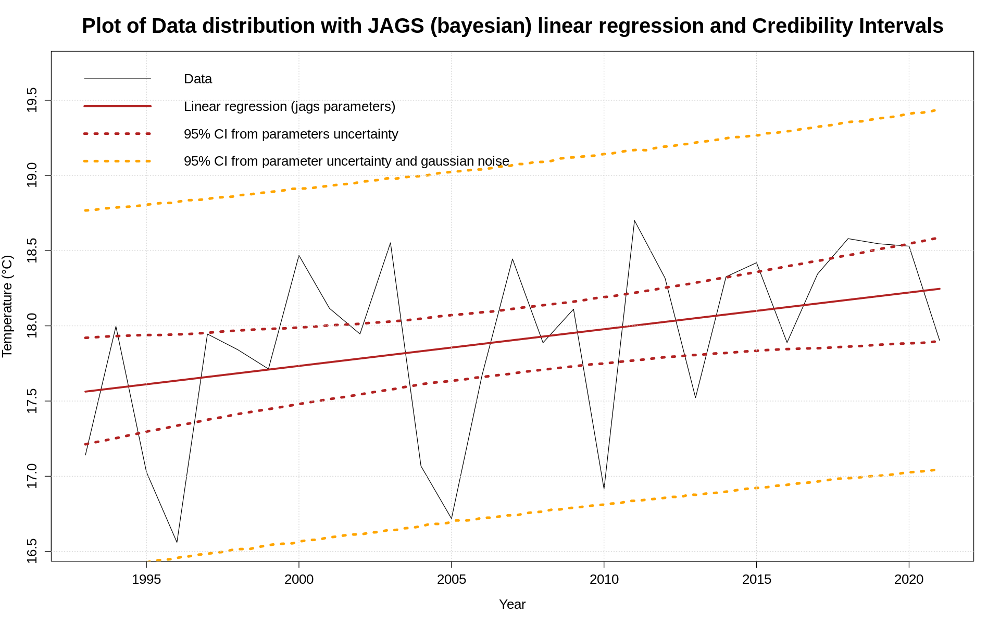

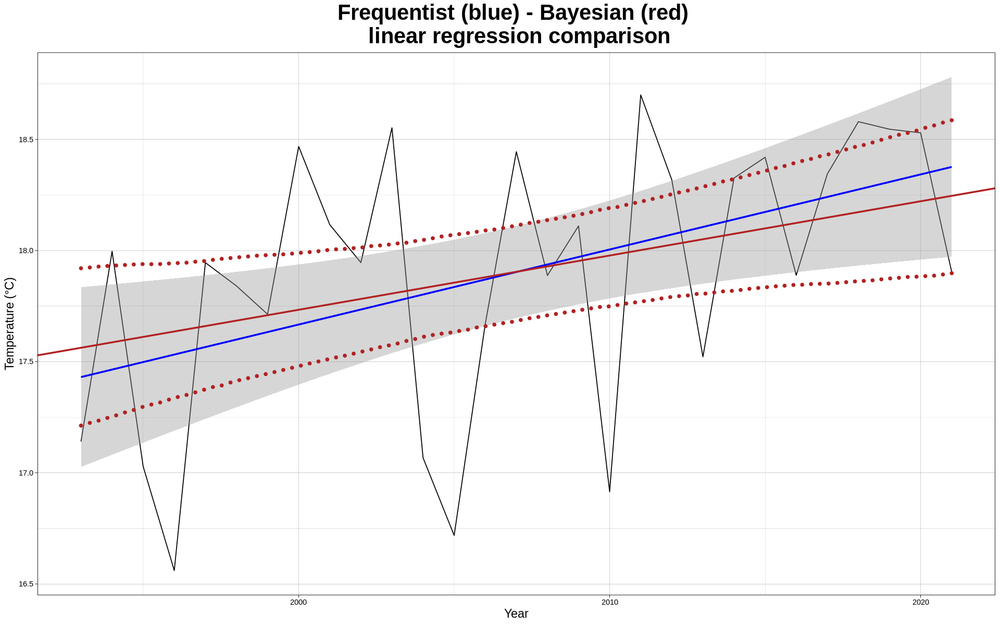

In [42]:
#Max
dataf <- global_avg2[,c("Year", "Mean_Max_Temperature")]
names(dataf)<-c("Year", "Temp")
complete_analysis_annual_means_trend(dataf)

## PART 2

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean      SD  Naive SE Time-series SE
Y     0.2234 0.22483 0.0012980      0.0012979
mu    0.2248 0.08401 0.0004850      0.0004784
sigma 0.1972 0.06372 0.0003679      0.0004304

2. Quantiles for each variable:

          2.5%     25%    50%    75%  97.5%
Y     -0.22846 0.09069 0.2237 0.3589 0.6735
mu     0.05457 0.17493 0.2249 0.2756 0.3913
sigma  0.11550 0.15435 0.1842 0.2249 0.3556



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.



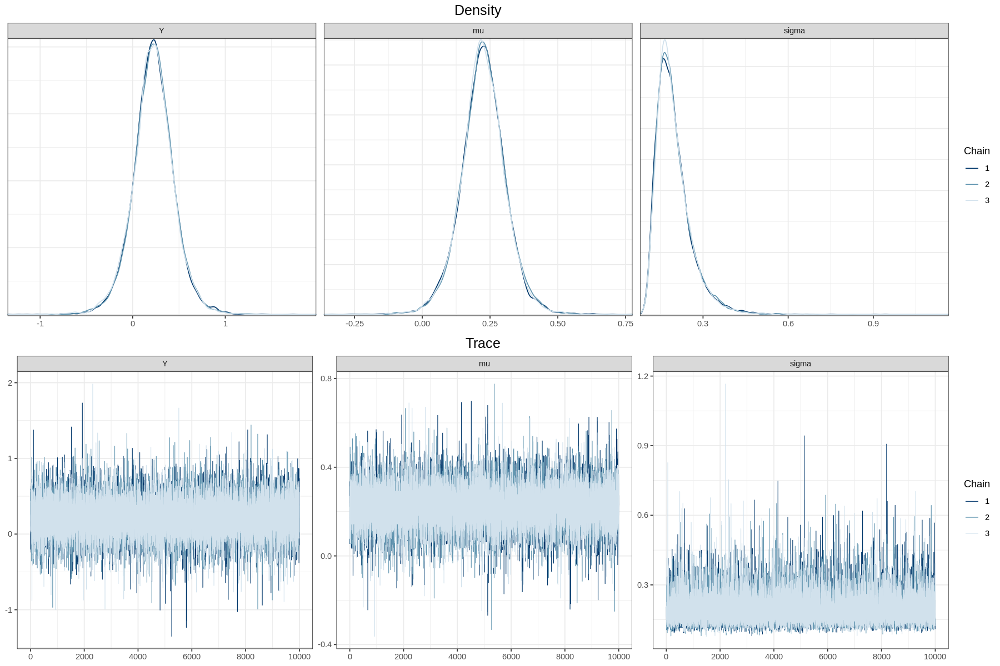

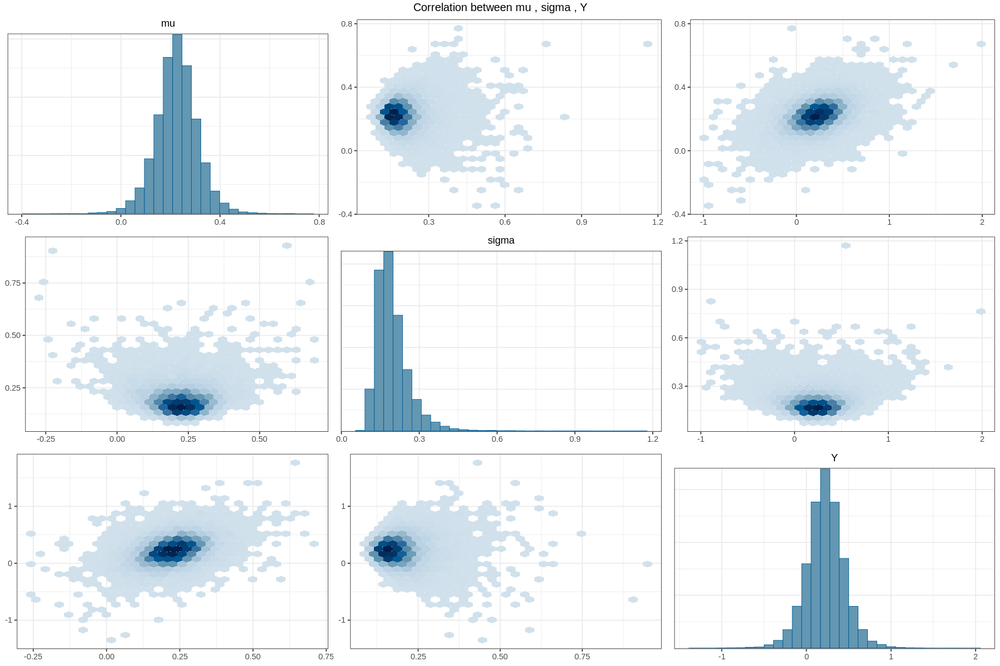

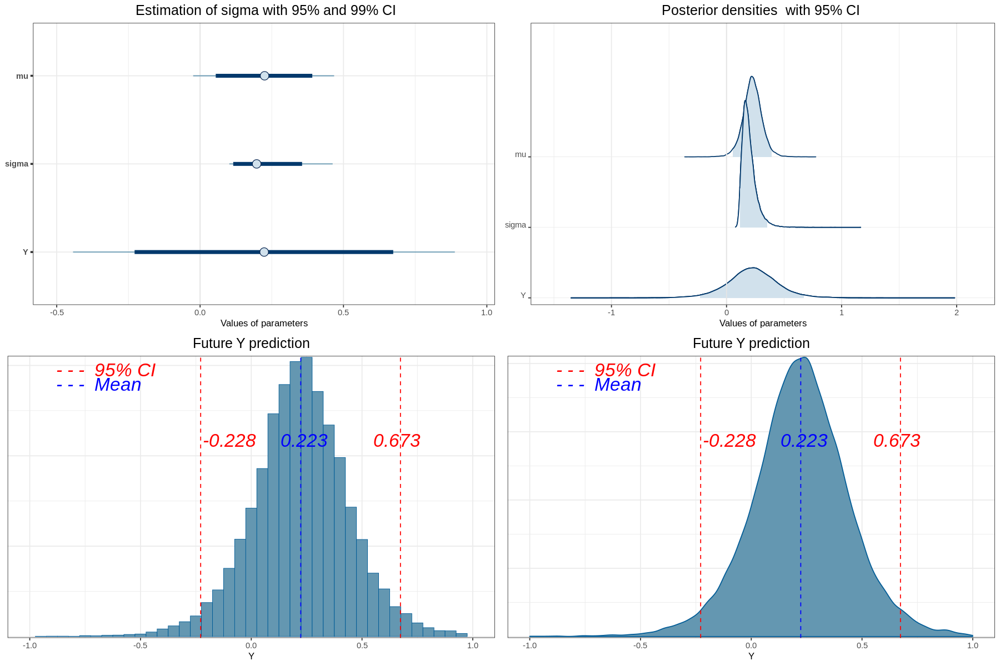

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD  Naive SE Time-series SE
Y     0.2199 0.4200 0.0024250      0.0024249
mu    0.2197 0.1585 0.0009150      0.0009150
sigma 0.3680 0.1195 0.0006897      0.0008051

2. Quantiles for each variable:

          2.5%      25%    50%    75%  97.5%
Y     -0.63093 -0.02962 0.2219 0.4660 1.0639
mu    -0.09365  0.12424 0.2192 0.3158 0.5386
sigma  0.21563  0.28752 0.3439 0.4190 0.6627



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.



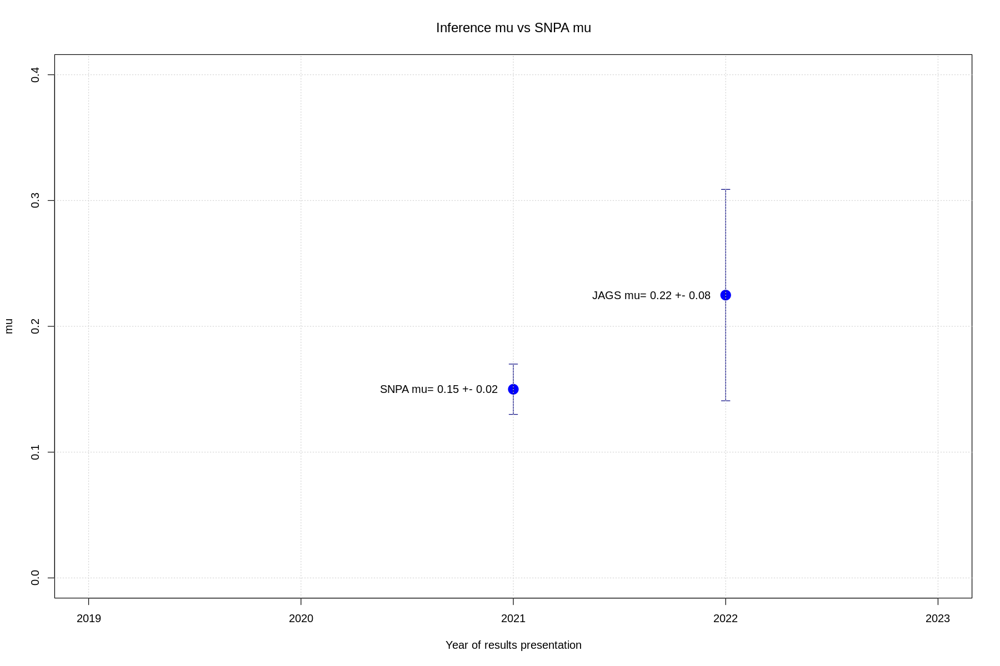

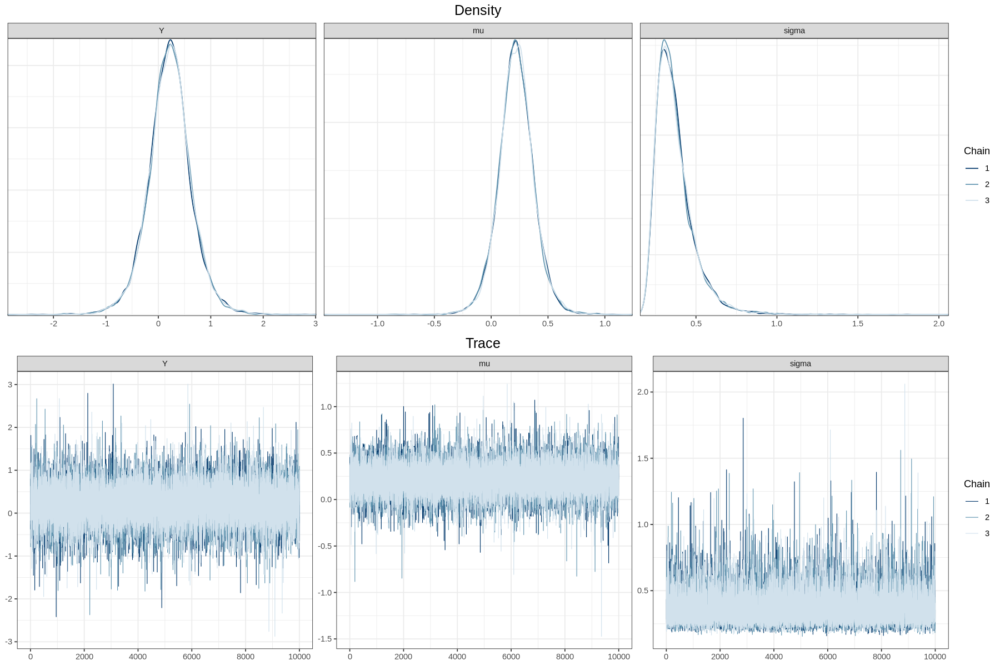

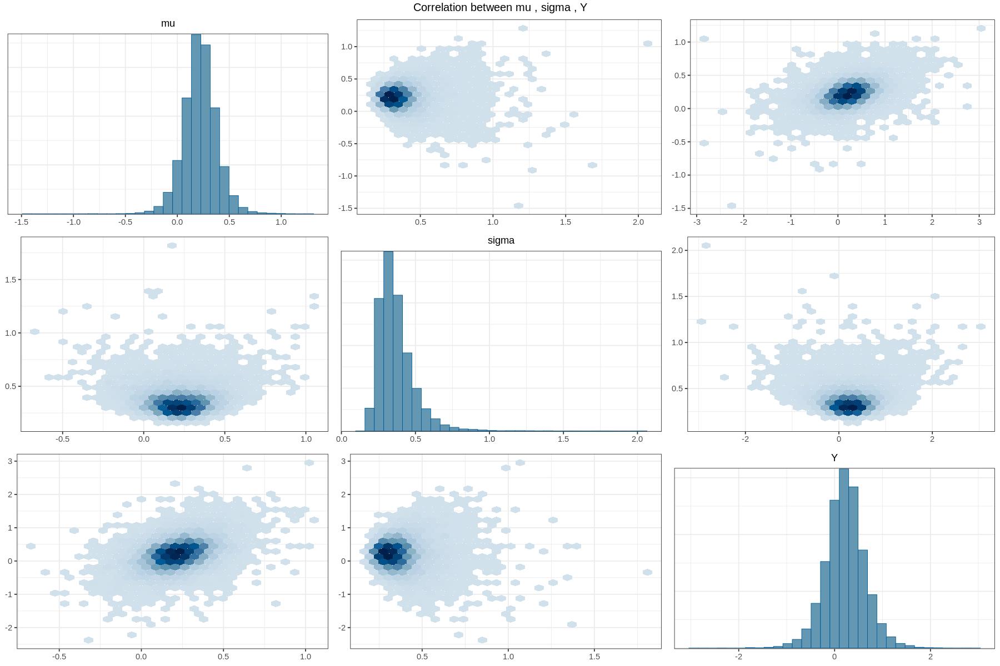

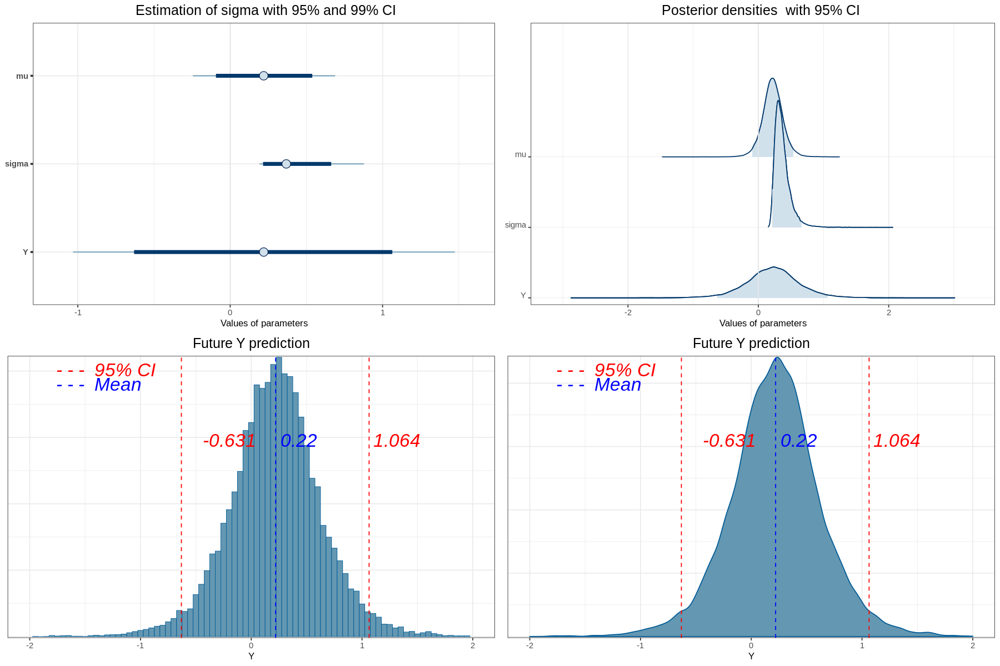

JAGS results: 

Iterations = 10001:20000
Thinning interval = 1 
Number of chains = 3 
Sample size per chain = 10000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

        Mean     SD  Naive SE Time-series SE
Y     0.2420 0.4571 0.0026392      0.0026543
mu    0.2398 0.1744 0.0010066      0.0009935
sigma 0.4053 0.1300 0.0007504      0.0008773

2. Quantiles for each variable:

         2.5%      25%    50%    75%  97.5%
Y     -0.6726 -0.03669 0.2415 0.5226 1.1554
mu    -0.1082  0.13438 0.2394 0.3459 0.5875
sigma  0.2388  0.31678 0.3787 0.4627 0.7329



Scale for 'x' is already present. Adding another scale for 'x', which will
replace the existing scale.



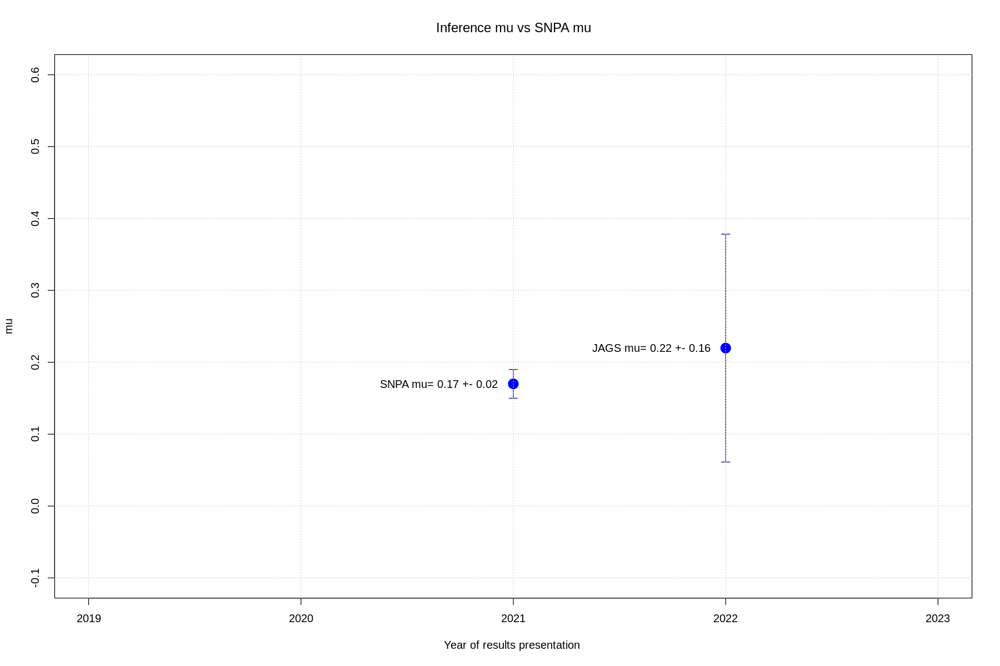

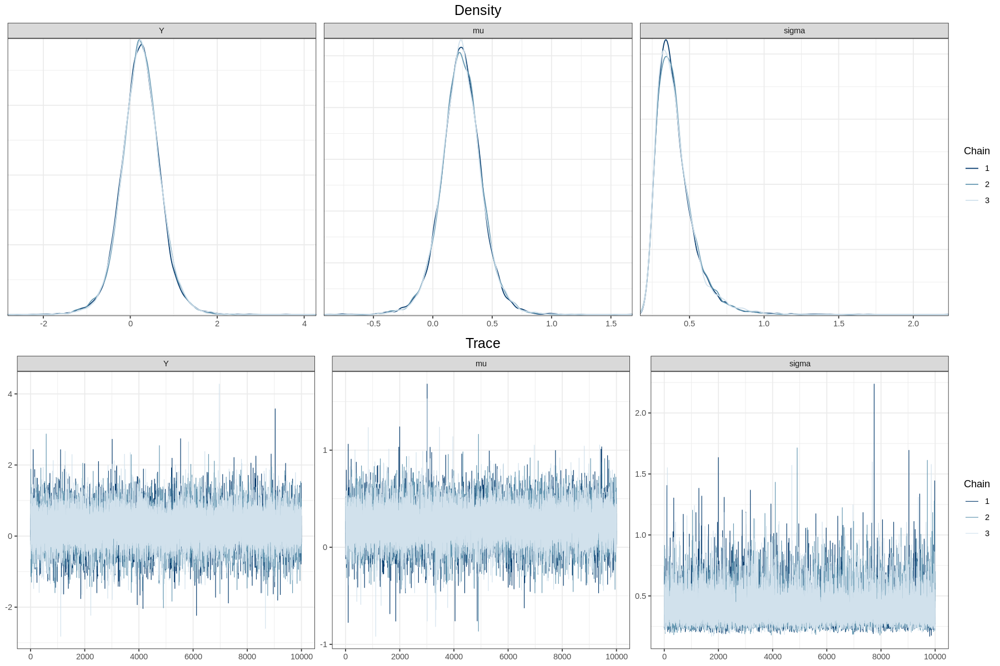

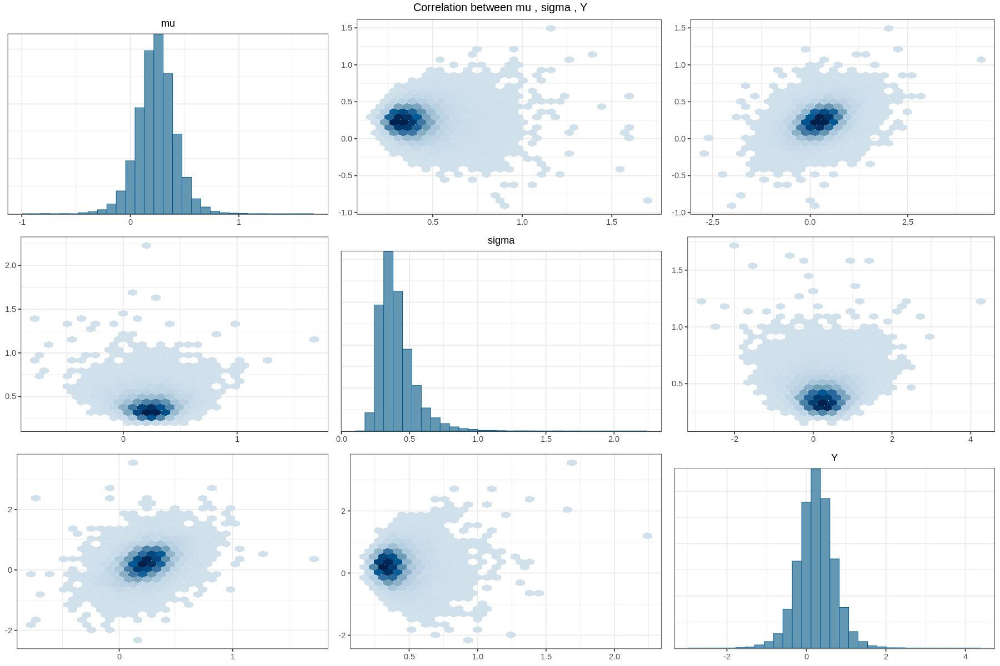

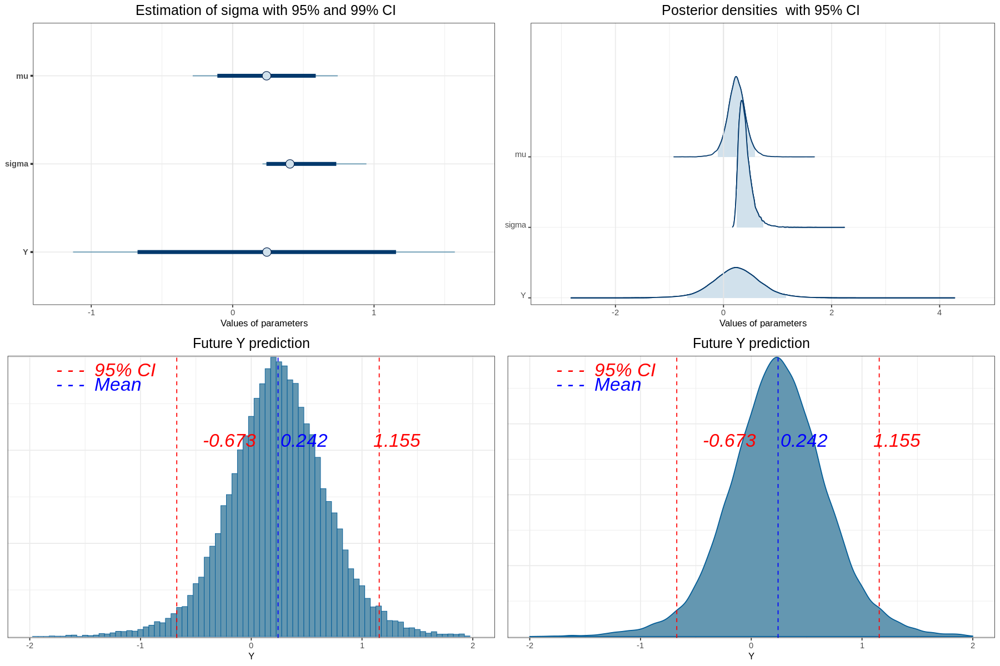

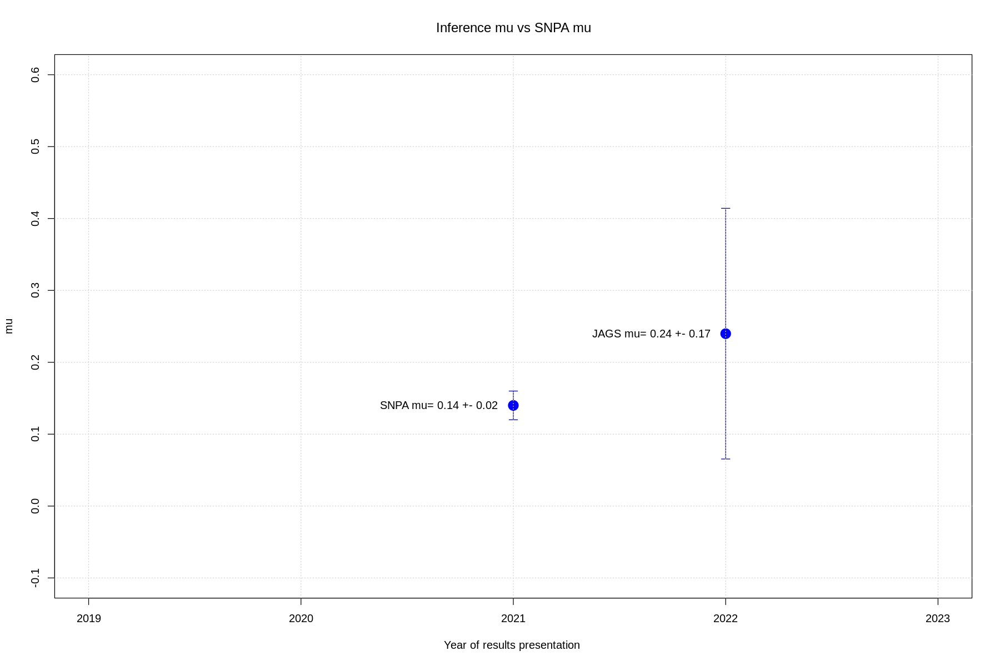

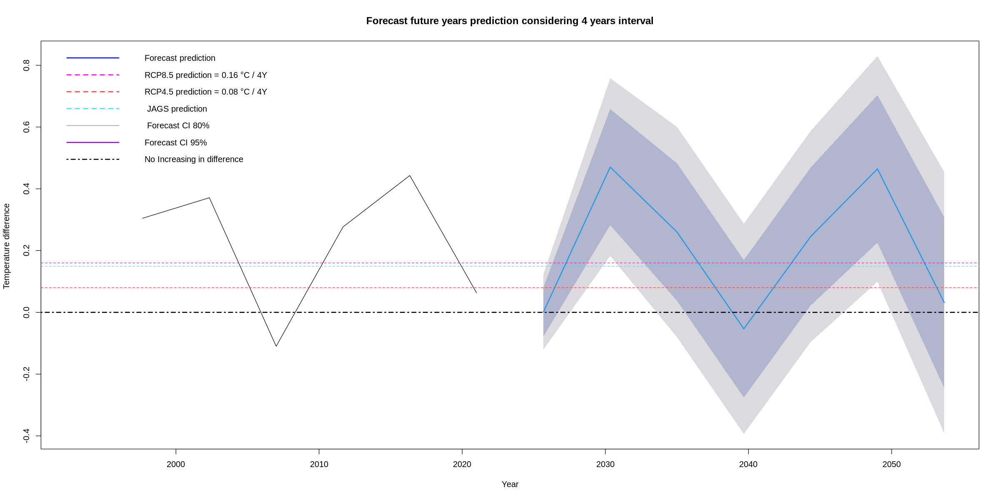

In [43]:
df2g_3<-four_years1(global_avg2)

jags_mean(df2g_3,columns=c("Means_measure_diff"),0.15,0.02)
jags_max_min(df2g_3,columns=c("Max_Temperature_diff"),0.17,0.02)
jags_max_min(df2g_3,columns=c("Min_Temperature_diff"),0.14,0.02)
forecast_(df2g_3,columns=c("Means_measure_diff"),0.149)

## FINAL PLOT WITH ALL RESULTS

## PLOT WITH DIFFERENCE BETWEEN AVERAGE TEMPERATURES FOR ALL STATIONS

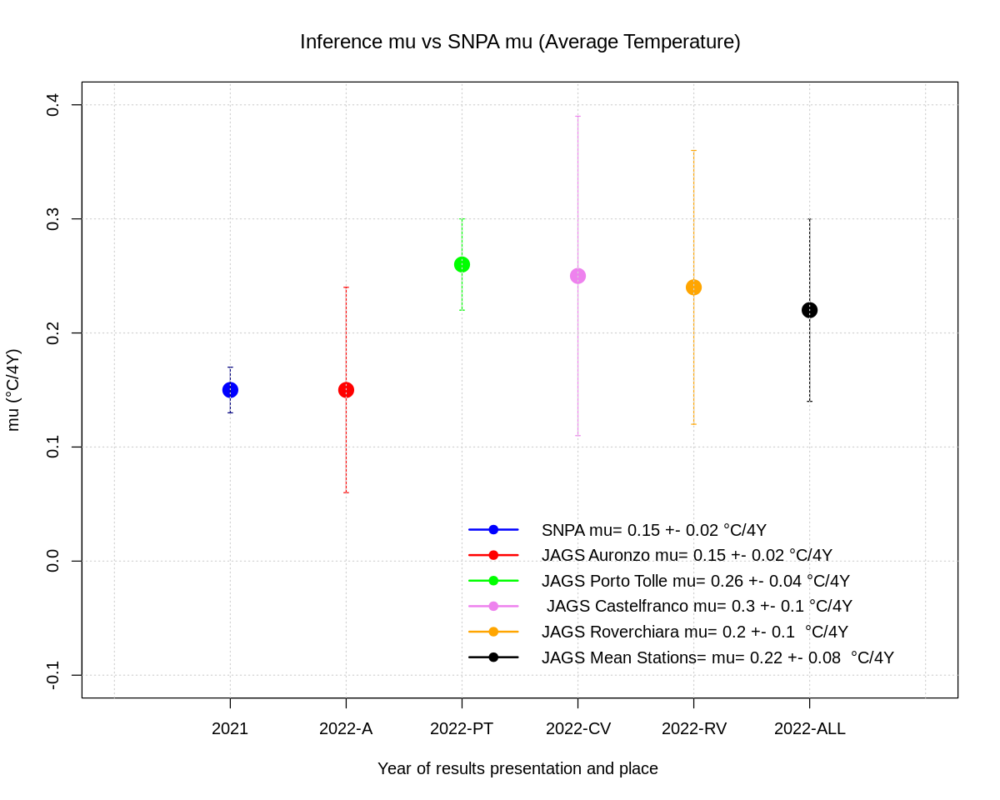

In [44]:
final_plot_mean<-function(psnpa,ssnpa,pa,sa,pp,sp,pc,sc,pr,sr,pg,sg){
    
    options(repr.plot.width=10, repr.plot.height=8)
    #plot to compare result
    x<-c(1)
    y<-c(psnpa)
    x1<-2
    y1<-pa
    x2<-3
    y2<-pp
    x3<-4
    y3<-pc
    x4<-5
    y4<-pr
    x5<-6
    y5<-pg
    sd<-c(ssnpa,sa,sp,sc,sr,sg)
    
   plot (x,
         y,
         xlim=c(0,7),
         ylim=c(-0.1,0.4),
        pch=19,
        cex=2,
        font.main = 1,
         ylab="mu (°C/4Y)",
         xlab="Year of results presentation and place ",
         col="blue",
         main="Inference mu vs SNPA mu (Average Temperature)",
         xaxt = "n")
    lines(x1,y1,type="p",pch=19,col="red",cex=2)
        lines(x2,y2,type="p",pch=19,col="green",cex=2)
    lines(x3,y3,type="p",pch=19,col="violet",cex=2)
    lines(x4,y4,type="p",pch=19,col="orange",cex=2)
      lines(x5,y5,type="p",pch=19,col="black",cex=2)
   axis(1, at = c(1, 2,3,4,5,6),
     labels = c("2021", "2022-A","2022-PT","2022-CV","2022-RV","2022-ALL"))
   segments(x,y-ssnpa,x,y+ssnpa,col="navy")
    segments(x1,y1-sa,x1,y1+sa,col="red")
    segments(x2,y2-sp,x2,y2+sp,col="green")
    segments(x3,y3-sc,x3,y3+sc,col="violet")
    segments(x4,y4-sr,x4,y4+sr,col="orange")
     segments(x5,y5-sg,x5,y5+sg,col="black")
   epsilon <- 0.02
   segments(x-epsilon,y-ssnpa,x+epsilon,y-ssnpa,col="navy")
   segments(x-epsilon,y+ssnpa,x+epsilon,y+ssnpa,col="navy")
   segments(x1-epsilon,y1-sa,x1+epsilon,y1-sa,col="red")
   segments(x1-epsilon,y1+sa,x1+epsilon,y1+sa,col="red")
   segments(x2-epsilon,y2-sp,x2+epsilon,y2-sp,col="green")
   segments(x2-epsilon,y2+sp,x2+epsilon,y2+sp,col="green")
   segments(x3-epsilon,y3-sc,x3+epsilon,y3-sc,col="violet")
   segments(x3-epsilon,y3+sc,x3+epsilon,y3+sc,col="violet")
   segments(x4-epsilon,y4-sr,x4+epsilon,y4-sr,col="orange")
   segments(x4-epsilon,y4+sr,x4+epsilon,y4+sr,col="orange")
       segments(x5-epsilon,y5-sg,x5+epsilon,y5-sg,col="black")
   segments(x5-epsilon,y5+sg,x5+epsilon,y5+sg,col="black")
      grid()
    
    legend(x = 3,
           y=0.05,
       
       col = c("blue", "red","green","violet","orange","black"),
       pch = c(19,19,19,19,19,19),
       lwd = c(2,2,2,2,2,2),
       cex=1,
       bty="n",
       legend = c('SNPA mu= 0.15 +- 0.02 °C/4Y ', 'JAGS Auronzo mu= 0.15 +- 0.02 °C/4Y', "JAGS Porto Tolle mu= 0.26 +- 0.04 °C/4Y", " JAGS Castelfranco mu= 0.3 +- 0.1 °C/4Y","JAGS Roverchiara mu= 0.2 +- 0.1  °C/4Y","JAGS Mean Stations= mu= 0.22 +- 0.08  °C/4Y"))
   
}

final_plot_mean(0.15,0.02,0.15,0.09,0.26,0.04,0.25,0.14,0.24,0.12,0.22,0.08)

## PLOT WITH DIFFERENCE BETWEEN MAX TEMPERATURES FOR ALL STATIONS

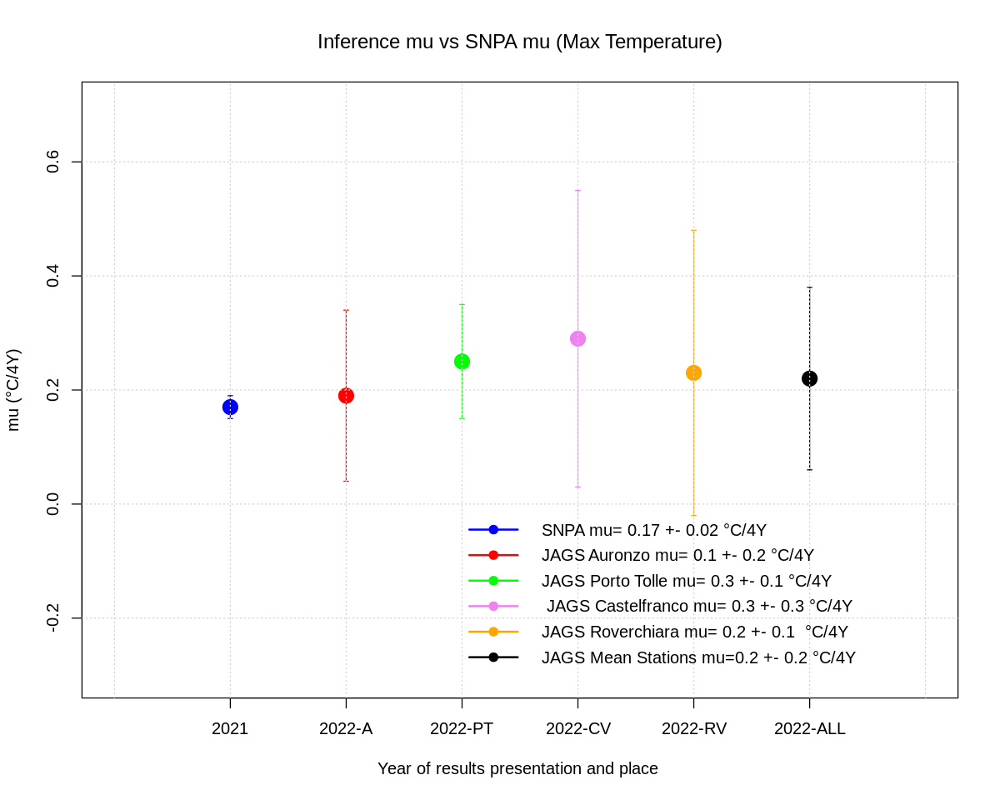

In [45]:
final_plot_max<-function(psnpa,ssnpa,pa,sa,pp,sp,pc,sc,pr,sr,pg,sg){
    
    options(repr.plot.width=10, repr.plot.height=8)
    #plot to compare result
    x<-c(1)
    y<-c(psnpa)
    x1<-2
    y1<-pa
    x2<-3
    y2<-pp
    x3<-4
    y3<-pc
    x4<-5
    y4<-pr
    x5<-6
    y5<-pg
    sd<-c(ssnpa,sa,sp,sc,sr,sg)
    
   plot (x,
         y,
         xlim=c(0,7),
         ylim=c(-0.3,0.7),
        pch=19,
        cex=2,
        font.main = 1,
         ylab="mu (°C/4Y)",
         xlab="Year of results presentation and place ",
         col="blue",
         main="Inference mu vs SNPA mu (Max Temperature)",
         xaxt = "n")
    lines(x1,y1,type="p",pch=19,col="red",cex=2)
        lines(x2,y2,type="p",pch=19,col="green",cex=2)
    lines(x3,y3,type="p",pch=19,col="violet",cex=2)
    lines(x4,y4,type="p",pch=19,col="orange",cex=2)
      lines(x5,y5,type="p",pch=19,col="black",cex=2)
   axis(1, at = c(1, 2,3,4,5,6),
     labels = c("2021", "2022-A","2022-PT","2022-CV","2022-RV","2022-ALL"))
   segments(x,y-ssnpa,x,y+ssnpa,col="navy")
    segments(x1,y1-sa,x1,y1+sa,col="red")
    segments(x2,y2-sp,x2,y2+sp,col="green")
    segments(x3,y3-sc,x3,y3+sc,col="violet")
    segments(x4,y4-sr,x4,y4+sr,col="orange")
     segments(x5,y5-sg,x5,y5+sg,col="black")
   epsilon <- 0.02
   segments(x-epsilon,y-ssnpa,x+epsilon,y-ssnpa,col="navy")
   segments(x-epsilon,y+ssnpa,x+epsilon,y+ssnpa,col="navy")
   segments(x1-epsilon,y1-sa,x1+epsilon,y1-sa,col="red")
   segments(x1-epsilon,y1+sa,x1+epsilon,y1+sa,col="red")
   segments(x2-epsilon,y2-sp,x2+epsilon,y2-sp,col="green")
   segments(x2-epsilon,y2+sp,x2+epsilon,y2+sp,col="green")
   segments(x3-epsilon,y3-sc,x3+epsilon,y3-sc,col="violet")
   segments(x3-epsilon,y3+sc,x3+epsilon,y3+sc,col="violet")
   segments(x4-epsilon,y4-sr,x4+epsilon,y4-sr,col="orange")
   segments(x4-epsilon,y4+sr,x4+epsilon,y4+sr,col="orange")
       segments(x5-epsilon,y5-sg,x5+epsilon,y5-sg,col="black")
   segments(x5-epsilon,y5+sg,x5+epsilon,y5+sg,col="black")
      grid()
    
    legend(x = 3,
           y=0,
       
       col = c("blue", "red","green","violet","orange","black"),
       pch = c(19,19,19,19,19,19),
       lwd = c(2,2,2,2,2,2),
       cex=1,
       bty="n",
       legend = c('SNPA mu= 0.17 +- 0.02 °C/4Y ', 'JAGS Auronzo mu= 0.1 +- 0.2 °C/4Y', "JAGS Porto Tolle mu= 0.3 +- 0.1 °C/4Y", " JAGS Castelfranco mu= 0.3 +- 0.3 °C/4Y","JAGS Roverchiara mu= 0.2 +- 0.1  °C/4Y","JAGS Mean Stations mu=0.2 +- 0.2 °C/4Y"))
   
}

final_plot_max(0.17,0.02,0.19,0.15,0.25,0.1,0.29,0.26,0.23,0.25,0.22,0.16)

## PLOT WITH DIFFERENCE BETWEEN MIN TEMPERATURES FOR ALL STATIONS

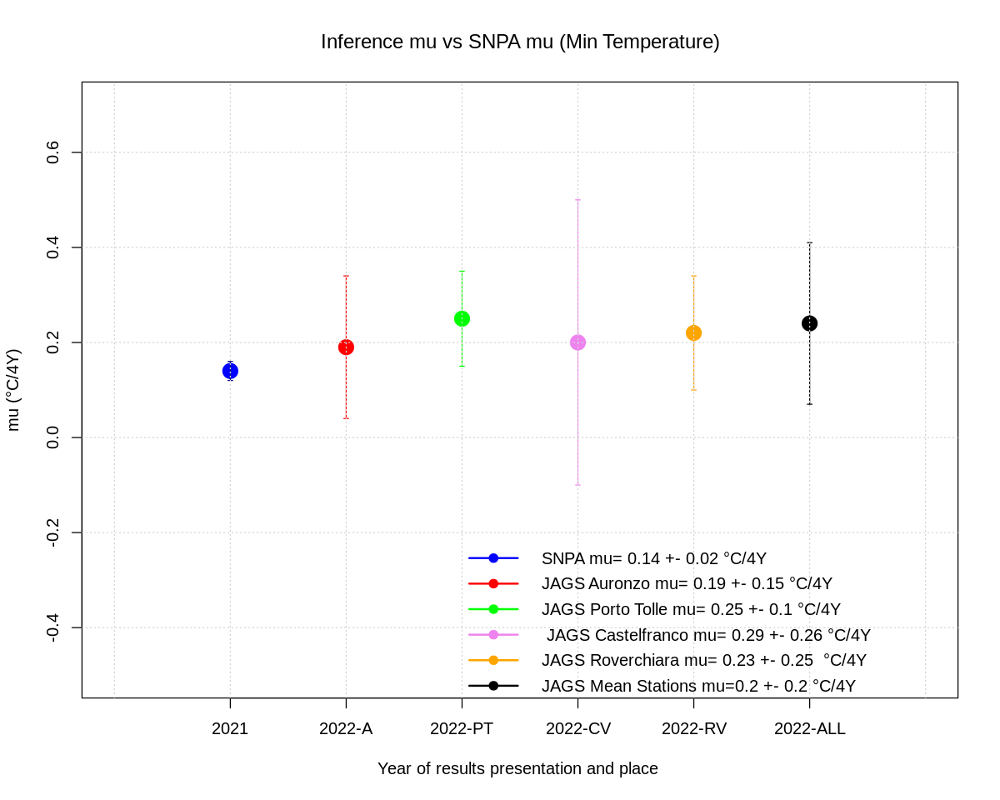

In [46]:
final_plot_min<-function(psnpa,ssnpa,pa,sa,pp,sp,pc,sc,pr,sr,pg,sg){
    
    options(repr.plot.width=10, repr.plot.height=8)
    #plot to compare result
    x<-c(1)
    y<-c(psnpa)
    x1<-2
    y1<-pa
    x2<-3
    y2<-pp
    x3<-4
    y3<-pc
    x4<-5
    y4<-pr
    x5<-6
    y5<-pg
    sd<-c(ssnpa,sa,sp,sc,sr,sg)
    
   plot (x,
         y,
         xlim=c(0,7),
         ylim=c(-0.5,0.7),
        pch=19,
        cex=2,
        font.main = 1,
         ylab="mu (°C/4Y)",
         xlab="Year of results presentation and place ",
         col="blue",
         main="Inference mu vs SNPA mu (Min Temperature)",
         xaxt = "n")
    lines(x1,y1,type="p",pch=19,col="red",cex=2)
        lines(x2,y2,type="p",pch=19,col="green",cex=2)
    lines(x3,y3,type="p",pch=19,col="violet",cex=2)
    lines(x4,y4,type="p",pch=19,col="orange",cex=2)
      lines(x5,y5,type="p",pch=19,col="black",cex=2)
   axis(1, at = c(1, 2,3,4,5,6),
     labels = c("2021", "2022-A","2022-PT","2022-CV","2022-RV","2022-ALL"))
   segments(x,y-ssnpa,x,y+ssnpa,col="navy")
    segments(x1,y1-sa,x1,y1+sa,col="red")
    segments(x2,y2-sp,x2,y2+sp,col="green")
    segments(x3,y3-sc,x3,y3+sc,col="violet")
    segments(x4,y4-sr,x4,y4+sr,col="orange")
     segments(x5,y5-sg,x5,y5+sg,col="black")
   epsilon <- 0.02
   segments(x-epsilon,y-ssnpa,x+epsilon,y-ssnpa,col="navy")
   segments(x-epsilon,y+ssnpa,x+epsilon,y+ssnpa,col="navy")
   segments(x1-epsilon,y1-sa,x1+epsilon,y1-sa,col="red")
   segments(x1-epsilon,y1+sa,x1+epsilon,y1+sa,col="red")
   segments(x2-epsilon,y2-sp,x2+epsilon,y2-sp,col="green")
   segments(x2-epsilon,y2+sp,x2+epsilon,y2+sp,col="green")
   segments(x3-epsilon,y3-sc,x3+epsilon,y3-sc,col="violet")
   segments(x3-epsilon,y3+sc,x3+epsilon,y3+sc,col="violet")
   segments(x4-epsilon,y4-sr,x4+epsilon,y4-sr,col="orange")
   segments(x4-epsilon,y4+sr,x4+epsilon,y4+sr,col="orange")
       segments(x5-epsilon,y5-sg,x5+epsilon,y5-sg,col="black")
   segments(x5-epsilon,y5+sg,x5+epsilon,y5+sg,col="black")
      grid()
    
    legend(x = 3,
           y=-0.2,
       
       col = c("blue", "red","green","violet","orange","black"),
       pch = c(19,19,19,19,19,19),
       lwd = c(2,2,2,2,2,2),
       cex=1,
       bty="n",
       legend = c('SNPA mu= 0.14 +- 0.02 °C/4Y ', 'JAGS Auronzo mu= 0.19 +- 0.15 °C/4Y', "JAGS Porto Tolle mu= 0.25 +- 0.1 °C/4Y", " JAGS Castelfranco mu= 0.29 +- 0.26 °C/4Y","JAGS Roverchiara mu= 0.23 +- 0.25  °C/4Y","JAGS Mean Stations mu=0.2 +- 0.2 °C/4Y"))
   
}

final_plot_min(0.14,0.02,0.19,0.15,0.25,0.1,0.2,0.3,0.22,0.12,0.24,0.17)